In [87]:
import numpy as np
import pandas as pd

import tensorflow as tf
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Flatten, Dense, Dropout, Activation, Input, Bidirectional,SimpleRNN, Embedding, Conv1D, LSTM, MaxPooling1D, GlobalMaxPooling1D, Dropout
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split


from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_selection import chi2
from IPython.display import display
from sklearn.model_selection import train_test_split



from nltk.stem import PorterStemmer
import re
import nltk
nltk.download('stopwords')
nltk.download('punkt')
from nltk.corpus import stopwords

import matplotlib.pyplot as plt
import seaborn as sns

print(tf.__version__)


2.12.0


[nltk_data] Downloading package stopwords to
[nltk_data]     /home/hsibitenda/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /home/hsibitenda/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [88]:
#from google.colab import drive
#drive.mount('/content/drive')

In [219]:
# df = pd.read_csv('D:/senego/dataafrica/socialcons_clean2.csv')
# df = pd.read_csv('D:/senego/dataafrica/socialcons_clean2.csv')
#df = pd.read_csv('C:/Users/Administrator/OneDrive/Documents/africa/dataafrica/socialcons_clean.csv', encoding = "UTF-8")
# df=pd.read_csv('D:/senego/dataafrica/analysis/new_dataset2_aspects.csv')
#df=pd.read_csv('/content/drive/MyDrive/Colab Notebooks/new_dataset2_aspects.csv')
# df = pd.read_csv('/home/hsibitenda/scratch/harriet/trends/new_dataset2_aspects.csv')
df=pd.read_csv('/home/hsibitenda/scratch/harriet/sentiment_sentall_llama32new.csv')

df=df.astype(str)
df.columns

Index(['Unnamed: 0.2', 'Unnamed: 0', 'textid', 'Date', 'Views', 'sourcetype',
       'alltext', 'Text_emt', 'Text_emj', 'Text_langue', 'Text_translate',
       'Text_langue2', 'Text_lower', 'Text_punct', 'Text_tags', 'Text_chat',
       'Text_spell', 'Text_langue3', 'Text_translate2', 'Text_token',
       'Text_stop', 'Text_stem', 'Text_lemma', 'berttopic2', 'cluster_id2',
       'llama2_labelone10', 'cluster_labelone10', 'cluster_id',
       'llama2_labelone', 'cluster_labelone', 'Unnamed: 0.1', 'Text_lemma2',
       'Bertscore_Labels', 'Final_Labels', 'Predicted_Categories3', 'polarity',
       'subjectivity', 'Textblob', 'VADER', 'neg', 'neu', 'pos', 'compound',
       'BERT', 'Sentiment_Score', 'Sentiwordnet', 'llama3_sentiment',
       'Emotion', 'Emotional_Polarity', 'Common_Sentiment32', 'Sentiment2',
       'Predicted_Labels', 'Sentiment2_prediction', 'Sentiment2_roberta',
       'Predicted_Labels_roberta', 'Predicted_Sentiment_finetunned',
       'mapped_initial_label', 'finet

In [220]:
df.shape

(22036, 62)

In [221]:
df.columns

Index(['Unnamed: 0.2', 'Unnamed: 0', 'textid', 'Date', 'Views', 'sourcetype',
       'alltext', 'Text_emt', 'Text_emj', 'Text_langue', 'Text_translate',
       'Text_langue2', 'Text_lower', 'Text_punct', 'Text_tags', 'Text_chat',
       'Text_spell', 'Text_langue3', 'Text_translate2', 'Text_token',
       'Text_stop', 'Text_stem', 'Text_lemma', 'berttopic2', 'cluster_id2',
       'llama2_labelone10', 'cluster_labelone10', 'cluster_id',
       'llama2_labelone', 'cluster_labelone', 'Unnamed: 0.1', 'Text_lemma2',
       'Bertscore_Labels', 'Final_Labels', 'Predicted_Categories3', 'polarity',
       'subjectivity', 'Textblob', 'VADER', 'neg', 'neu', 'pos', 'compound',
       'BERT', 'Sentiment_Score', 'Sentiwordnet', 'llama3_sentiment',
       'Emotion', 'Emotional_Polarity', 'Common_Sentiment32', 'Sentiment2',
       'Predicted_Labels', 'Sentiment2_prediction', 'Sentiment2_roberta',
       'Predicted_Labels_roberta', 'Predicted_Sentiment_finetunned',
       'mapped_initial_label', 'finet

In [222]:
df['Date']

0                       2021-08-24
1        2019-08-22 12:41:52+00:00
2        2020-06-05 08:01:33+00:00
3        2020-09-15 03:04:00+00:00
4        2021-08-13 16:05:04+00:00
                   ...            
22031                   2021-08-24
22032                   2021-08-24
22033                   2021-08-24
22034                   2021-08-24
22035                   2021-08-24
Name: Date, Length: 22036, dtype: object

**Extract year and month**

In [223]:
# # import pandas as pd

# # Assuming 'Date_Extracted' is in a non-datetime format (e.g., string)
# # Convert it to a datetime data type
# df['Date_Extracted'] = pd.to_datetime(df['Date'])

# # Now you can use .dt accessor for datetime operations
# df['year-month'] = df['Date_Extracted'].dt.to_period('M')
# df['Date (by month)'] = [month.to_timestamp() for month in df['year-month']]
import spacy

# Load spaCy model
nlp = spacy.load('en_core_web_sm')

# Function to extract dates using spaCy
def extract_dates(text):
    doc = nlp(text)
    dates = [ent.text for ent in doc.ents if ent.label_ == 'DATE']
    if dates:
        try:
            # Attempt to convert the first recognized date entity to datetime
            return pd.to_datetime(dates[0], errors='coerce')
        except ValueError:
            return pd.NaT
    else:
        return pd.NaT

# Apply the function to extract and convert dates
df['Date_Extracted'] = df['Date'].apply(extract_dates)

# Extract year from the 'Date_Extracted' column and convert to int, safely handling NaT
df['Year_Extracted'] = df['Date_Extracted'].dt.year.astype('Int64')

# Convert the datetime to a period (month)
df['year-month'] = df['Date_Extracted'].dt.to_period('M')

# Convert periods back to timestamps, ensuring no NaT types
df['Date (by month)'] = df['year-month'].apply(lambda x: x.to_timestamp() if pd.notna(x) else pd.NaT)

# Display the DataFrame with the new columns
print(df[['Date', 'Date_Extracted', 'Year_Extracted', 'year-month', 'Date (by month)']])

                            Date Date_Extracted  Year_Extracted year-month  \
0                     2021-08-24     2021-08-24            2021    2021-08   
1      2019-08-22 12:41:52+00:00     2019-08-22            2019    2019-08   
2      2020-06-05 08:01:33+00:00     2020-06-05            2020    2020-06   
3      2020-09-15 03:04:00+00:00     2020-09-15            2020    2020-09   
4      2021-08-13 16:05:04+00:00     2021-08-13            2021    2021-08   
...                          ...            ...             ...        ...   
22031                 2021-08-24     2021-08-24            2021    2021-08   
22032                 2021-08-24     2021-08-24            2021    2021-08   
22033                 2021-08-24     2021-08-24            2021    2021-08   
22034                 2021-08-24     2021-08-24            2021    2021-08   
22035                 2021-08-24     2021-08-24            2021    2021-08   

      Date (by month)  
0          2021-08-01  
1          2019

In [224]:
df['Date_Extracted'].value_counts()

Date_Extracted
2022-08-24    1528
2020-08-24    1264
2021-08-24    1216
2019-08-24     836
2018-08-24     642
              ... 
2007-08-24       1
2018-11-07       1
1996-05-16       1
2019-12-31       1
2018-06-04       1
Name: count, Length: 1684, dtype: int64

**Set year and month as Pandas Index**

In [225]:
df = df.set_index('Date (by month)')

In [226]:
# topic_number = 10

# topic_label = " ".join(topics[topic_number][:4])

# trump_df[topic_label].plot(style='.', title=f'Trump Tweets By Topic: \n{topic_label.title()}')

In [227]:

df.columns

Index(['Unnamed: 0.2', 'Unnamed: 0', 'textid', 'Date', 'Views', 'sourcetype',
       'alltext', 'Text_emt', 'Text_emj', 'Text_langue', 'Text_translate',
       'Text_langue2', 'Text_lower', 'Text_punct', 'Text_tags', 'Text_chat',
       'Text_spell', 'Text_langue3', 'Text_translate2', 'Text_token',
       'Text_stop', 'Text_stem', 'Text_lemma', 'berttopic2', 'cluster_id2',
       'llama2_labelone10', 'cluster_labelone10', 'cluster_id',
       'llama2_labelone', 'cluster_labelone', 'Unnamed: 0.1', 'Text_lemma2',
       'Bertscore_Labels', 'Final_Labels', 'Predicted_Categories3', 'polarity',
       'subjectivity', 'Textblob', 'VADER', 'neg', 'neu', 'pos', 'compound',
       'BERT', 'Sentiment_Score', 'Sentiwordnet', 'llama3_sentiment',
       'Emotion', 'Emotional_Polarity', 'Common_Sentiment32', 'Sentiment2',
       'Predicted_Labels', 'Sentiment2_prediction', 'Sentiment2_roberta',
       'Predicted_Labels_roberta', 'Predicted_Sentiment_finetunned',
       'mapped_initial_label', 'finet

In [228]:
df['Year_Extracted'] 

Date (by month)
2021-08-01    2021
2019-08-01    2019
2020-06-01    2020
2020-09-01    2020
2021-08-01    2021
              ... 
2021-08-01    2021
2021-08-01    2021
2021-08-01    2021
2021-08-01    2021
2021-08-01    2021
Name: Year_Extracted, Length: 22036, dtype: Int64

/tmp/ipykernel_897567/1631715149.py:18: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



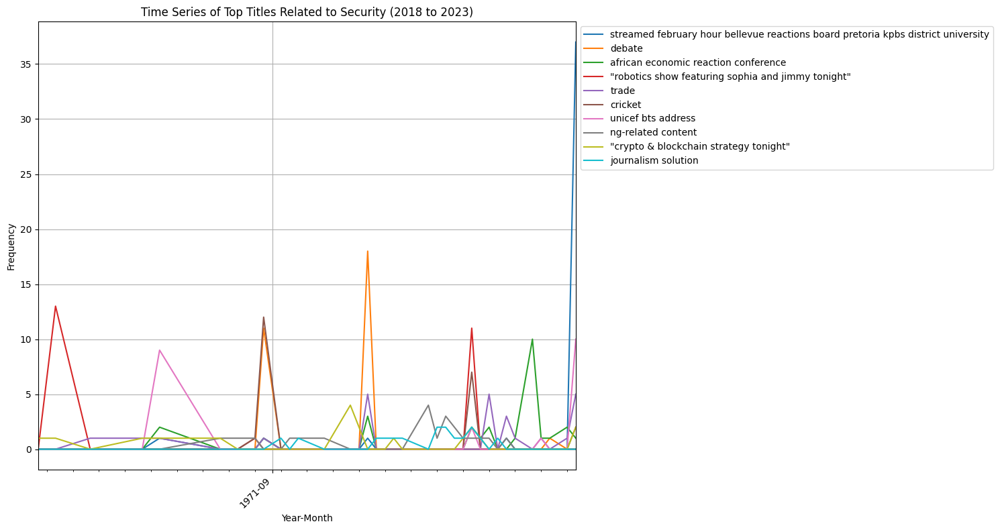

In [229]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates  # For date formatting

# Assuming the DataFrame 'df' has 'Date_Extracted' and 'cleaned_theme' as mentioned

# Define start and end dates for the filter
start_date = pd.Timestamp('2018-01-01')
end_date = pd.Timestamp('2023-12-31')

# Filter to include only entries from 2018 to the end of 2023
df = df[(df['Date_Extracted'] >= start_date) & (df['Date_Extracted'] <= end_date)]

# Further filter for 'security' theme
security_df = df[df['cleaned_theme'] == 'security']

# Ensure 'Date_Extracted' is used to create 'year-month' column
security_df['year-month'] = security_df['Date_Extracted'].dt.to_period('M')

# Group by 'year-month'
grouped = security_df.groupby('year-month')

# Prepare frequency dictionary
titles_freq = {month: group['llama2_labelone'].value_counts().to_dict() for month, group in grouped}

# Top titles based on frequency
top_titles = security_df['llama2_labelone'].value_counts().head(10).index.tolist()

# Create a figure and axis
fig, ax = plt.subplots(figsize=(15, 8))  # Larger figure size for clarity

# Plot each top title time series
for title in top_titles:
    title_freq_series = pd.Series(
        {month: titles_freq.get(month, {}).get(title, 0) for month in sorted(titles_freq)}
    )
    title_freq_series.plot(ax=ax, label=title)

# Set x-ticks and labels for each unique year-month, starting from 2018 to 2023
timestamps = [pd.Timestamp(str(month)) for month in sorted(titles_freq)]
ax.set_xticks(timestamps)
ax.set_xticklabels([ts.strftime('%Y-%m') for ts in timestamps], rotation=45, ha='right')

# X-axis format and interval adjustment
ax.xaxis.set_major_locator(mdates.MonthLocator(interval=3))  # Setting interval to every 3 months for clarity
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))

# Labeling and title
plt.xlabel('Year-Month')
plt.ylabel('Frequency')
plt.title('Time Series of Top Titles Related to Security (2018 to 2023)')
plt.grid(True)

# Legend positioning
ax.legend(loc='upper left', bbox_to_anchor=(1, 1))

plt.tight_layout()  # Adjust layout to make room for legend
plt.show()


In [230]:
df.columns

Index(['Unnamed: 0.2', 'Unnamed: 0', 'textid', 'Date', 'Views', 'sourcetype',
       'alltext', 'Text_emt', 'Text_emj', 'Text_langue', 'Text_translate',
       'Text_langue2', 'Text_lower', 'Text_punct', 'Text_tags', 'Text_chat',
       'Text_spell', 'Text_langue3', 'Text_translate2', 'Text_token',
       'Text_stop', 'Text_stem', 'Text_lemma', 'berttopic2', 'cluster_id2',
       'llama2_labelone10', 'cluster_labelone10', 'cluster_id',
       'llama2_labelone', 'cluster_labelone', 'Unnamed: 0.1', 'Text_lemma2',
       'Bertscore_Labels', 'Final_Labels', 'Predicted_Categories3', 'polarity',
       'subjectivity', 'Textblob', 'VADER', 'neg', 'neu', 'pos', 'compound',
       'BERT', 'Sentiment_Score', 'Sentiwordnet', 'llama3_sentiment',
       'Emotion', 'Emotional_Polarity', 'Common_Sentiment32', 'Sentiment2',
       'Predicted_Labels', 'Sentiment2_prediction', 'Sentiment2_roberta',
       'Predicted_Labels_roberta', 'Predicted_Sentiment_finetunned',
       'mapped_initial_label', 'finet

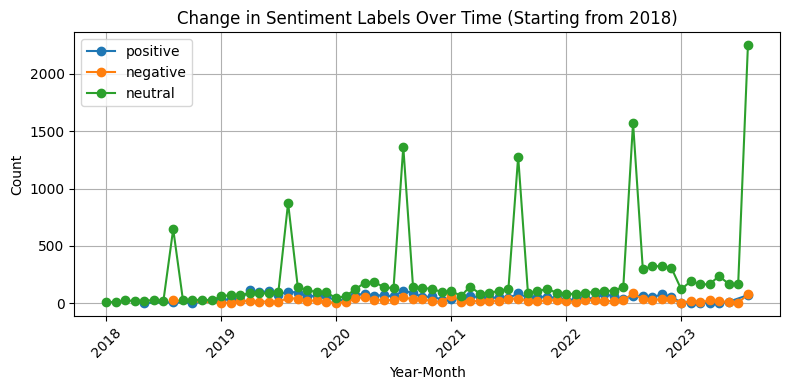

In [231]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder

# Assuming you have a DataFrame named 'df' with the provided columns
# If not, load your DataFrame here

# Ensure that the 'year-month' column is consistently in string format
df['year-month'] = df['year-month'].astype(str)

# Convert the 'year-month' column to datetime format and set it as the index
df['year-month'] = pd.to_datetime(df['year-month'], format='%Y-%m')

# Filter the DataFrame to include only rows from January 2018 onwards
df = df[df['year-month'] >= '2018-01-01']

# Create a label encoder to convert sentiment categories to numerical values
label_encoder = LabelEncoder()

# Encode the 'Sentiment_vad' column and store it in a new column 'Sentiment_encoded'
df['Sentiment_encoded'] = label_encoder.fit_transform(df['llama3_sentiment'])

# Separate the DataFrame into three DataFrames for each sentiment label
positive_df = df[df['Sentiment_encoded'] == label_encoder.transform(['positive'])[0]]
negative_df = df[df['Sentiment_encoded'] == label_encoder.transform(['negative'])[0]]
neutral_df = df[df['Sentiment_encoded'] == label_encoder.transform(['neutral'])[0]]

# Group the DataFrames by 'year-month' and calculate the count of each sentiment label for each month
positive_sentiment = positive_df.groupby(positive_df.index)['Sentiment_encoded'].count()
negative_sentiment = negative_df.groupby(negative_df.index)['Sentiment_encoded'].count()
neutral_sentiment = neutral_df.groupby(neutral_df.index)['Sentiment_encoded'].count()

# Create separate line plots for each sentiment label
plt.figure(figsize=(8, 4))
plt.plot(positive_sentiment.index, positive_sentiment.values, label='positive', marker='o', linestyle='-')
plt.plot(negative_sentiment.index, negative_sentiment.values, label='negative', marker='o', linestyle='-')
plt.plot(neutral_sentiment.index, neutral_sentiment.values, label='neutral', marker='o', linestyle='-')
plt.title('Change in Sentiment Labels Over Time (Starting from 2018)')
plt.xlabel('Year-Month')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.grid(True)
plt.legend()

# Show the plot
plt.tight_layout()
plt.show()


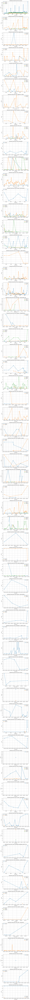

In [102]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder

# Assuming you have a DataFrame named 'df' with the provided columns
# If not, load your DataFrame here

# Convert the 'year-month' column to datetime format (if not already in datetime)
df['year-month'] = pd.to_datetime(df['year-month'], format='%Y-%m')

# Check the unique values in the 'Keysector' column
unique_sectors = df['cleaned_theme'].unique()

# Create a label encoder to convert sentiment categories to numerical values
label_encoder = LabelEncoder()

# Create subplots for each unique 'Keysector' value
fig, axs = plt.subplots(len(unique_sectors), figsize=(8, 4 * len(unique_sectors)))

# Iterate through each unique 'Keysector' value and create subplots
for i, sector in enumerate(unique_sectors):
    # Filter the DataFrame for the current sector
    sector_df = df[df['cleaned_theme'] == sector]

    # Check the unique sentiment values in the filtered DataFrame
    unique_sentiments = sector_df['llama3_sentiment'].unique()

    # Create a dictionary to store the encoded DataFrames for each sentiment label
    encoded_sentiment_data = {}

    # Encode each sentiment label and store it in the dictionary
    for sentiment in unique_sentiments:
        sentiment_encoded = label_encoder.fit_transform(sector_df[sector_df['llama3_sentiment'] == sentiment]['llama3_sentiment'])
        encoded_sentiment_data[sentiment] = sentiment_encoded

    # Group the encoded DataFrames by 'year-month' and calculate the count of each sentiment label for each month
    sentiment_counts = {}
    for sentiment, encoded_data in encoded_sentiment_data.items():
        sentiment_counts[sentiment] = sector_df[sector_df['llama3_sentiment'] == sentiment].groupby('year-month').size()

    # Create separate line plots for each sentiment label in the subplot
    axs[i].set_title(f'Sentiment Counts Over Time in {sector}')
    axs[i].set_xlabel('Year-Month')
    axs[i].set_ylabel('Count')
    axs[i].grid(True)

    for sentiment, counts in sentiment_counts.items():
        axs[i].plot(counts.index, counts.values, label=sentiment, marker='o', linestyle='-')

    axs[i].legend()

# Adjust spacing between subplots
plt.tight_layout()

# Show the subplots
plt.show()


/tmp/ipykernel_723867/722618543.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sector_df['encoded_sentiment'] = LabelEncoder().fit_transform(sector_df['llama3_sentiment'])
/tmp/ipykernel_723867/722618543.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sector_df['year-month'] = sector_df['year-month'].dt.start_time
/tmp/ipykernel_723867/722618543.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instea

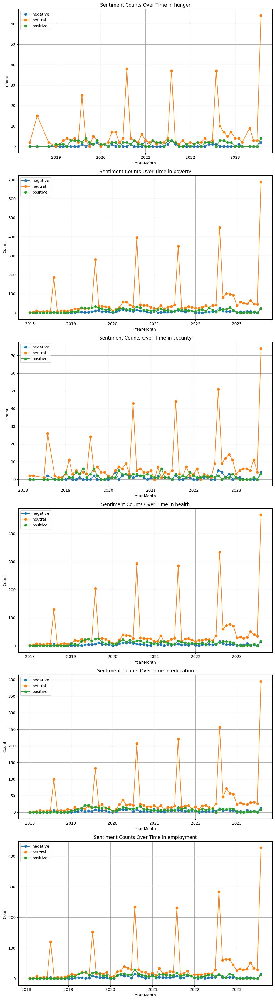

In [14]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder

# Example setup
df['year-month'] = pd.to_datetime(df['year-month']).dt.to_period('M')

# Assuming the DataFrame 'df' and necessary preprocessing is done as previously mentioned
themes = ['hunger', 'poverty', 'security', 'health', 'education', 'employment']

# Create subplots for these themes
fig, axs = plt.subplots(len(themes), figsize=(10, 6 * len(themes)))  # Adjust the figure size accordingly
if len(themes) == 1:
    axs = [axs]

for i, theme in enumerate(themes):
    sector_df = df[df['Predicted_Categories3'].str.contains(theme)]
    sector_df['encoded_sentiment'] = LabelEncoder().fit_transform(sector_df['llama3_sentiment'])

    # Convert period to datetime for plotting
    sector_df['year-month'] = sector_df['year-month'].dt.start_time

    sentiment_counts = sector_df.groupby(['year-month', 'encoded_sentiment']).size().unstack(fill_value=0)
    sentiment_labels = {index: label for index, label in enumerate(LabelEncoder().fit(sector_df['llama3_sentiment']).classes_)}

    axs[i].set_title(f'Sentiment Counts Over Time in {theme}')
    axs[i].set_xlabel('Year-Month')
    axs[i].set_ylabel('Count')
    axs[i].grid(True)

    for sentiment in sentiment_counts.columns:
        axs[i].plot(sentiment_counts.index, sentiment_counts[sentiment], label=sentiment_labels[sentiment], marker='o', linestyle='-')

    axs[i].legend()

plt.tight_layout()
plt.show()


In [ ]:
# sector_df['year-month']

In [ ]:
df.columns

/tmp/ipykernel_2346758/3976805356.py:45: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout(pad=3.0)  # Adjust the padding between subplots


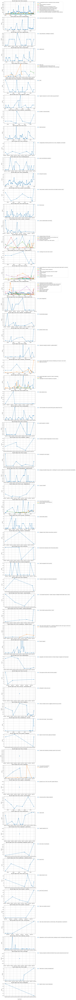

In [26]:
import pandas as pd
import matplotlib.pyplot as plt

# Function to find the top ten common values in a series
def top_10_common_values(series):
    value_counts = series.value_counts()
    top_10_values = value_counts.nlargest(10)
    return top_10_values

# Assuming you have a DataFrame named 'df'
# Check the unique values in the 'cleaned_theme' column
unique_sectors = df['cleaned_theme'].unique()

# Create subplots for each unique 'cleaned_theme' value
fig, axs = plt.subplots(len(unique_sectors), figsize=(8, 4 * len(unique_sectors)))

# Iterate through each unique 'cleaned_theme' value and create subplots
for i, sector in enumerate(unique_sectors):
    # Filter the DataFrame for the current sector
    sector_df = df[df['cleaned_theme'] == sector]

    # Find the top ten common values in the 'llama2_labelone' column for this sector
    top_10_topics = top_10_common_values(sector_df['llama2_labelone'])

    # Group by 'year-month' and count the occurrences of the top topics
    topic_counts = {}
    for topic in top_10_topics.index:
        topic_counts[topic] = sector_df[sector_df['llama2_labelone'] == topic].groupby('year-month').size()

    # Convert PeriodIndex to timestamp before plotting
    axs[i].set_title(f'Top Ten Topics Over Time in {sector}', pad=5)  # Added pad for space
    axs[i].set_xlabel('Year-Month', labelpad=20)  # Increased label padding
    axs[i].set_ylabel('Count')
    axs[i].grid(True)

    for topic, counts in topic_counts.items():
        # Convert the period index to timestamps
        counts.index = counts.index.to_timestamp()
        axs[i].plot(counts.index, counts.values, label=topic, marker='o', linestyle='-')

    # Position the legend outside the plot
    axs[i].legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust spacing between subplots to make room for x-axis labels
plt.tight_layout(pad=3.0)  # Adjust the padding between subplots

# Show the subplots
plt.show()


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


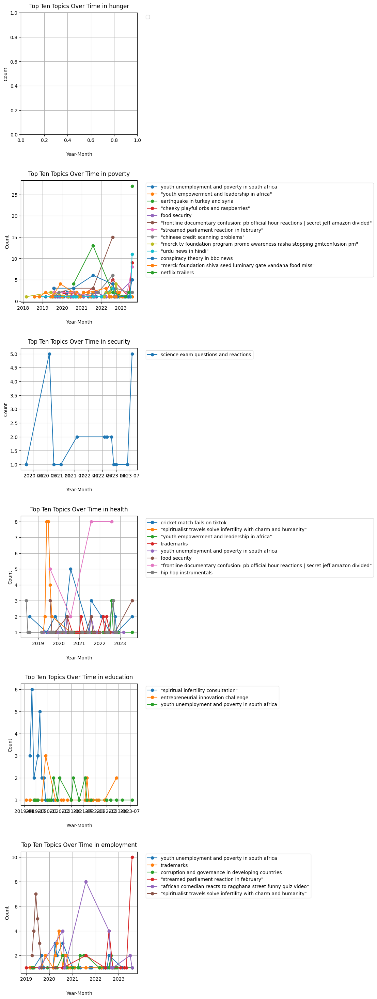

In [30]:
import pandas as pd
import matplotlib.pyplot as plt

# Function to find the top ten common values in a series
def top_10_common_values(series):
    value_counts = series.value_counts()
    # top_10_values = value_counts.nlargest(10)
    top_10_values=value_counts[(value_counts >= 22) & (value_counts <=28)]
    return top_10_values

# Define the list of themes to focus on
themes = ['hunger', 'poverty', 'security', 'health', 'education', 'employment']

# Create subplots for these themes
fig, axs = plt.subplots(len(themes), figsize=(12, 5 * len(themes)))  # Adjust size based on the number of themes

# If there is only one theme, axs may not be an array
if len(themes) == 1:
    axs = [axs]

# Iterate through each theme and create subplots
for i, theme in enumerate(themes):
    # Filter the DataFrame for entries containing the current theme in 'cleaned_theme'
    sector_df = df[df['Predicted_Categories3'].str.contains(theme, na=False)]

    # Find the top ten common values in the 'llama2_labelone' column for this sector
    top_10_topics = top_10_common_values(sector_df['llama2_labelone'])

    # Group by 'year-month' and count the occurrences of the top topics
    topic_counts = {}
    for topic in top_10_topics.index:
        topic_counts[topic] = sector_df[sector_df['llama2_labelone'] == topic].groupby('year-month').size()

    # Convert PeriodIndex to timestamp before plotting
    axs[i].set_title(f'Top Ten Topics Over Time in {theme}', pad=10)
    axs[i].set_xlabel('Year-Month', labelpad=20)
    axs[i].set_ylabel('Count')
    axs[i].grid(True)

    for topic, counts in topic_counts.items():
        # Convert the period index to timestamps for better plotting
        counts.index = counts.index.to_timestamp()
        axs[i].plot(counts.index, counts.values, label=topic, marker='o', linestyle='-')

    # Position the legend outside of the plot
    axs[i].legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust spacing between subplots to make room for x-axis labels and legends
plt.tight_layout(pad=3.0, h_pad=3.0)  # Adjust the padding between and within subplots

# Show the subplots
plt.show()


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


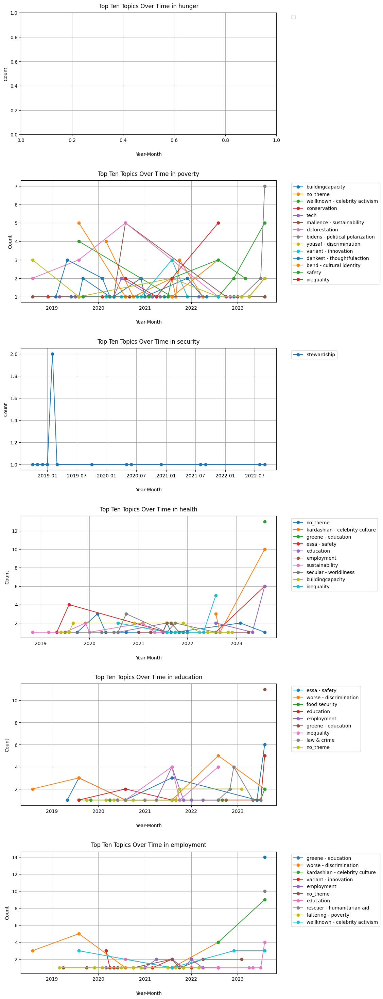

In [31]:
import pandas as pd
import matplotlib.pyplot as plt

# Function to find the top ten common values in a series
def top_10_common_values(series):
    value_counts = series.value_counts()
    # top_10_values = value_counts.nlargest(10)
    top_10_values=value_counts[(value_counts >= 10) & (value_counts <=15)]
    return top_10_values

# Define the list of themes to focus on
themes = ['hunger', 'poverty', 'security', 'health', 'education', 'employment']

# Create subplots for these themes
fig, axs = plt.subplots(len(themes), figsize=(12, 5 * len(themes)))  # Adjust size based on the number of themes

# If there is only one theme, axs may not be an array
if len(themes) == 1:
    axs = [axs]

# Iterate through each theme and create subplots
for i, theme in enumerate(themes):
    # Filter the DataFrame for entries containing the current theme in 'cleaned_theme'
    sector_df = df[df['Predicted_Categories3'].str.contains(theme, na=False)]

    # Find the top ten common values in the 'llama2_labelone' column for this sector
    top_10_topics = top_10_common_values(sector_df['cleaned_theme'])

    # Group by 'year-month' and count the occurrences of the top topics
    topic_counts = {}
    for topic in top_10_topics.index:
        topic_counts[topic] = sector_df[sector_df['cleaned_theme'] == topic].groupby('year-month').size()

    # Convert PeriodIndex to timestamp before plotting
    axs[i].set_title(f'Top Ten Topics Over Time in {theme}', pad=10)
    axs[i].set_xlabel('Year-Month', labelpad=20)
    axs[i].set_ylabel('Count')
    axs[i].grid(True)

    for topic, counts in topic_counts.items():
        # Convert the period index to timestamps for better plotting
        counts.index = counts.index.to_timestamp()
        axs[i].plot(counts.index, counts.values, label=topic, marker='o', linestyle='-')

    # Position the legend outside of the plot
    axs[i].legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust spacing between subplots to make room for x-axis labels and legends
plt.tight_layout(pad=3.0, h_pad=3.0)  # Adjust the padding between and within subplots

# Show the subplots
plt.show()


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


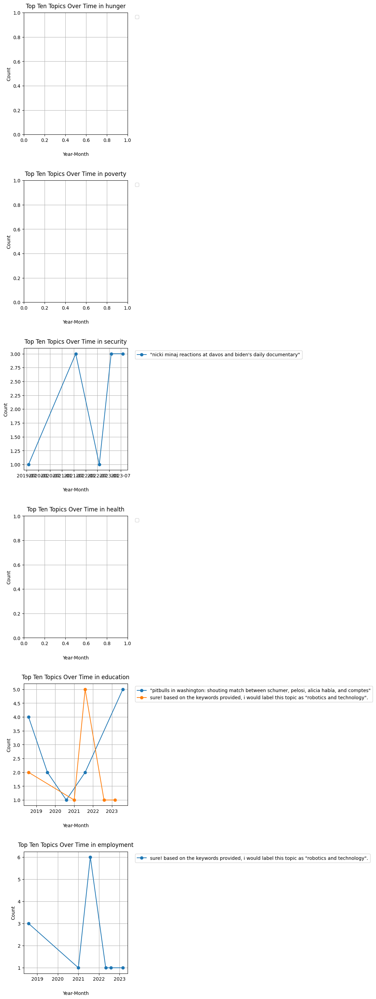

In [34]:
import pandas as pd
import matplotlib.pyplot as plt

# Function to find the top ten common values in a series
def top_10_common_values(series):
    value_counts = series.value_counts()
    # top_10_values = value_counts.nlargest(10)
    top_10_values=value_counts[(value_counts >= 10) & (value_counts <=15)]
    return top_10_values

# Define the list of themes to focus on
themes = ['hunger', 'poverty', 'security', 'health', 'education', 'employment']

# Create subplots for these themes
fig, axs = plt.subplots(len(themes), figsize=(12, 5 * len(themes)))  # Adjust size based on the number of themes

# If there is only one theme, axs may not be an array
if len(themes) == 1:
    axs = [axs]

# Iterate through each theme and create subplots
for i, theme in enumerate(themes):
    # Filter the DataFrame for entries containing the current theme in 'cleaned_theme'
    sector_df = df[df['Predicted_Categories3'].str.contains(theme, na=False)]

    # Find the top ten common values in the 'llama2_labelone' column for this sector
    top_10_topics = top_10_common_values(sector_df['llama2_labelone10'])

    # Group by 'year-month' and count the occurrences of the top topics
    topic_counts = {}
    for topic in top_10_topics.index:
        topic_counts[topic] = sector_df[sector_df['llama2_labelone10'] == topic].groupby('year-month').size()

    # Convert PeriodIndex to timestamp before plotting
    axs[i].set_title(f'Top Ten Topics Over Time in {theme}', pad=10)
    axs[i].set_xlabel('Year-Month', labelpad=20)
    axs[i].set_ylabel('Count')
    axs[i].grid(True)

    for topic, counts in topic_counts.items():
        # Convert the period index to timestamps for better plotting
        counts.index = counts.index.to_timestamp()
        axs[i].plot(counts.index, counts.values, label=topic, marker='o', linestyle='-')

    # Position the legend outside of the plot
    axs[i].legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust spacing between subplots to make room for x-axis labels and legends
plt.tight_layout(pad=3.0, h_pad=3.0)  # Adjust the padding between and within subplots

# Show the subplots
plt.show()


In [ ]:
df.columns

In [39]:
# import pandas as pd
# import matplotlib.pyplot as plt
# from sklearn.preprocessing import LabelEncoder

# # Function to find the top ten common values in a series
# def top_10_common_values(series):
#     value_counts = series.value_counts()
#     # top_10_values = value_counts.nlargest(10)
#     top_10_values=value_counts[(value_counts >= 10) & (value_counts <=30)]

#     return top_10_values

# # Assuming you have a DataFrame named 'df'
# # Check the unique values in the 'cleaned_theme' column
# unique_sectors = df['cleaned_theme'].unique()

# # Create a label encoder to convert sentiment categories to numerical values
# label_encoder = LabelEncoder()

# # Create subplots for each unique 'cleaned_theme' value
# fig, axs = plt.subplots(len(unique_sectors), figsize=(12, 6 * len(unique_sectors)))

# # Iterate through each unique 'cleaned_theme' value and create subplots
# for i, sector in enumerate(unique_sectors):
#     # Filter the DataFrame for the current sector
#     sector_df = df[df['cleaned_theme'] == sector]

#     # Find the top ten common values in the 'llama2_labelone10' column for this sector
#     top_10_names = top_10_common_values(sector_df['llama2_labelone10'])

#     # Create a dictionary to store the encoded DataFrames for each sentiment label
#     encoded_sentiment_data = {}

#     # Encode each sentiment label and store it in the dictionary
#     for sentiment in top_10_names.index:
#         sentiment_encoded = label_encoder.fit_transform(sector_df[sector_df['llama2_labelone10'] == sentiment]['llama2_labelone10'])
#         encoded_sentiment_data[sentiment] = sentiment_encoded

#     # Group the encoded DataFrames by 'year-month' and calculate the count of each sentiment label for each month
#     sentiment_counts = {}
#     for sentiment, encoded_data in encoded_sentiment_data.items():
#         sentiment_counts[sentiment] = sector_df[sector_df['llama2_labelone10'] == sentiment].groupby('year-month').size()

#     # Convert PeriodIndex to timestamp before plotting
#     axs[i].set_title(f'Top Ten Clusters Counts Over Time in {sector}', pad=10)  # Added pad for space
#     axs[i].set_xlabel('Year-Month', labelpad=20)  # Increased label padding
#     axs[i].set_ylabel('Count')
#     axs[i].grid(True)

#     for sentiment, counts in sentiment_counts.items():
#         # Convert PeriodIndex to timestamps before plotting
#         counts.index = counts.index.to_timestamp()
#         axs[i].plot(counts.index, counts.values, label=sentiment, marker='o', linestyle='-')

#     # Position the legend outside the plot
#     axs[i].legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# # Adjust spacing between subplots to make room for x-axis labels
# plt.tight_layout(pad=3.0)  # Adjust the padding between subplots

# # Show the subplots
# plt.show()


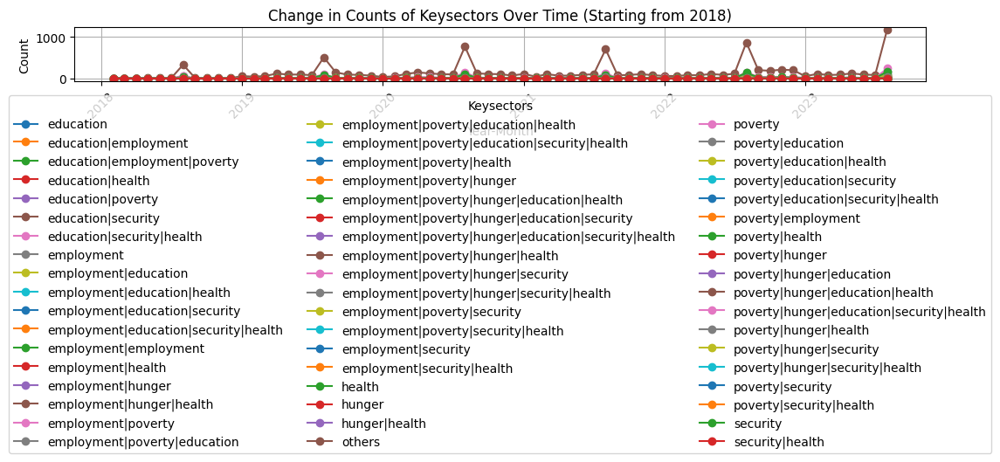

In [53]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming you have a DataFrame named 'df' with the provided columns
# If not, load your DataFrame here

# Ensure that the 'year-month' column is consistently in string format
# df['year-month'] = df['year-month'].astype(str)

# Convert the 'year-month' column to datetime format and set it as the index
# df['year-month'] = pd.to_datetime(df['year-month'], format='%Y-%m-%d')

# Filter the DataFrame to include only rows from January 2018 onwards
df = df[df['year-month'] >= '2018-01-01']

# Group the DataFrame by 'year-month' and 'Keysector' and calculate the count of each 'Keysector' for each month
keysector_counts = df.groupby(['year-month', 'Predicted_Categories3']).size().unstack(fill_value=0)

# Create a line plot to show the counts of each 'Keysector' over time
plt.figure(figsize=(12, 6))
for keysector in keysector_counts.columns:
    plt.plot(keysector_counts.index, keysector_counts[keysector], label=keysector, marker='o', linestyle='-')

plt.title('Change in Counts of Keysectors Over Time (Starting from 2018)')
plt.xlabel('Year-Month')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.grid(True)
# plt.legend()
plt.legend(title='Keysectors', bbox_to_anchor=(0.5, -0.15), loc='upper center', ncol=3)

# Show the plot
plt.tight_layout()
plt.show()


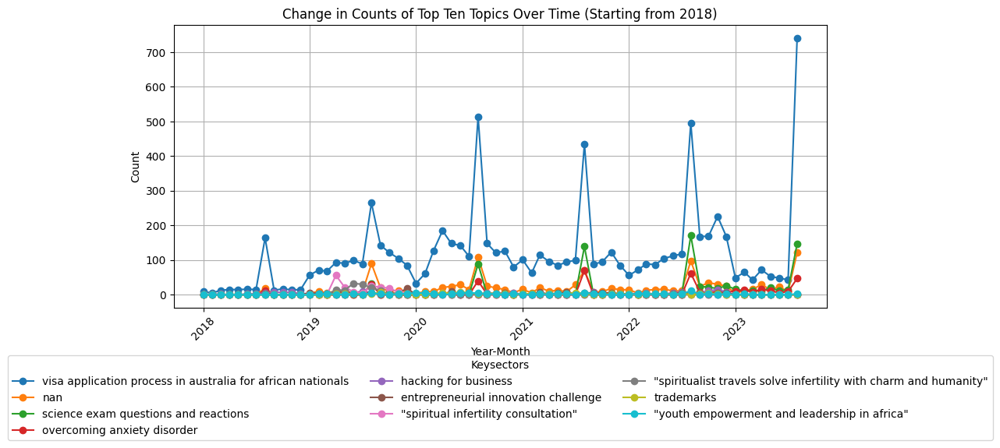

In [233]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming you have a DataFrame named 'df' with the provided columns
# If not, load your DataFrame here

# Ensure that the 'year-month' column is consistently in string format
# Convert the 'year-month' column to datetime format and set it as the index
df['year-month'] = pd.to_datetime(df['year-month'], format='%Y-%m')

# Filter the DataFrame to include only rows from January 2018 onwards
df = df[df['year-month'] >= '2018-01-01']

# Function to find the top ten common values in a series
def top_10_common_values(series):
    value_counts = series.value_counts()
    top_10_values = value_counts.nlargest(10)
    return top_10_values

# Find the top ten common values in the 'llama2_labelone' column
top_10_keysectors = top_10_common_values(df['llama2_labelone'])

# Group the DataFrame by 'year-month' and 'Keysector' and calculate the count of each 'Keysector' for each month
keysector_counts = df.groupby(['year-month', 'llama2_labelone']).size().unstack(fill_value=0)

# Create a line plot to show the counts of the top ten 'Keysectors' over time
plt.figure(figsize=(12, 6))
for keysector in top_10_keysectors.index:
    plt.plot(keysector_counts.index, keysector_counts[keysector], label=keysector, marker='o', linestyle='-')

plt.title('Change in Counts of Top Ten Topics Over Time (Starting from 2018)')
plt.xlabel('Year-Month')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.grid(True)

# Adjust the legend to be below the graph
plt.legend(title='Keysectors', bbox_to_anchor=(0.5, -0.15), loc='upper center', ncol=3)

# Show the plot
plt.tight_layout()
plt.show()


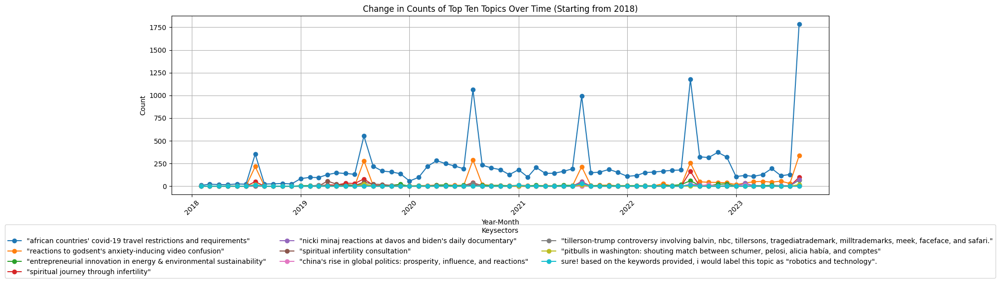

In [56]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming you have a DataFrame named 'df' with the provided columns
# If not, load your DataFrame here

# Ensure that the 'year-month' column is consistently in string format
# df['year-month'] = df['year-month'].astype(str)

# Convert the 'year-month' column to datetime format and set it as the index
# df['year-month'] = pd.to_datetime(df['year-month'], format='%Y-%m-%d')

# Filter the DataFrame to include only rows from January 2018 onwards
df = df[df['year-month'] >= '2018-01-01']

# Function to find the top ten common values in a series
def top_10_common_values(series):
    value_counts = series.value_counts()
    top_10_values = value_counts.nlargest(10)
    return top_10_values

# Find the top ten common values in the 'Keysector' column
top_10_keysectors = top_10_common_values(df['llama2_labelone10'])

# Group the DataFrame by 'year-month' and 'Keysector' and calculate the count of each 'Keysector' for each month
keysector_counts = df.groupby(['year-month', 'llama2_labelone10']).size().unstack(fill_value=0)

# Create a line plot to show the counts of the top ten 'Keysectors' over time
plt.figure(figsize=(19, 6))
for keysector in top_10_keysectors.index:
    plt.plot(keysector_counts.index, keysector_counts[keysector], label=keysector, marker='o', linestyle='-')

plt.title('Change in Counts of Top Ten Topics Over Time (Starting from 2018)')
plt.xlabel('Year-Month')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.grid(True)
# plt.legend()
plt.legend(title='Keysectors', bbox_to_anchor=(0.5, -0.15), loc='upper center', ncol=3)

# Show the plot
plt.tight_layout()
plt.show()


In [12]:
df.columns

Index(['Unnamed: 0.2', 'Unnamed: 0', 'textid', 'Date', 'Views', 'sourcetype',
       'alltext', 'Text_emt', 'Text_emj', 'Text_langue', 'Text_translate',
       'Text_langue2', 'Text_lower', 'Text_punct', 'Text_tags', 'Text_chat',
       'Text_spell', 'Text_langue3', 'Text_translate2', 'Text_token',
       'Text_stop', 'Text_stem', 'Text_lemma', 'berttopic2', 'cluster_id2',
       'llama2_labelone10', 'cluster_labelone10', 'cluster_id',
       'llama2_labelone', 'cluster_labelone', 'Unnamed: 0.1', 'Text_lemma2',
       'Bertscore_Labels', 'Final_Labels', 'Predicted_Categories3', 'polarity',
       'subjectivity', 'Textblob', 'VADER', 'neg', 'neu', 'pos', 'compound',
       'BERT', 'Sentiment_Score', 'Sentiwordnet', 'llama3_sentiment',
       'Emotion', 'Emotional_Polarity', 'Common_Sentiment32', 'Sentiment2',
       'Predicted_Labels', 'Sentiment2_prediction', 'Sentiment2_roberta',
       'Predicted_Labels_roberta', 'Predicted_Sentiment_finetunned',
       'mapped_initial_label', 'finet

### ADF testing for non stationality data with low p-value

In [236]:
df.shape

(19182, 66)

In [237]:
df2=df.copy()
df2.columns

Index(['Unnamed: 0.2', 'Unnamed: 0', 'textid', 'Date', 'Views', 'sourcetype',
       'alltext', 'Text_emt', 'Text_emj', 'Text_langue', 'Text_translate',
       'Text_langue2', 'Text_lower', 'Text_punct', 'Text_tags', 'Text_chat',
       'Text_spell', 'Text_langue3', 'Text_translate2', 'Text_token',
       'Text_stop', 'Text_stem', 'Text_lemma', 'berttopic2', 'cluster_id2',
       'llama2_labelone10', 'cluster_labelone10', 'cluster_id',
       'llama2_labelone', 'cluster_labelone', 'Unnamed: 0.1', 'Text_lemma2',
       'Bertscore_Labels', 'Final_Labels', 'Predicted_Categories3', 'polarity',
       'subjectivity', 'Textblob', 'VADER', 'neg', 'neu', 'pos', 'compound',
       'BERT', 'Sentiment_Score', 'Sentiwordnet', 'llama3_sentiment',
       'Emotion', 'Emotional_Polarity', 'Common_Sentiment32', 'Sentiment2',
       'Predicted_Labels', 'Sentiment2_prediction', 'Sentiment2_roberta',
       'Predicted_Labels_roberta', 'Predicted_Sentiment_finetunned',
       'mapped_initial_label', 'finet

In [238]:
# Ensure 'Date' column is in datetime format
df['Date'] = pd.to_datetime(df['Date_Extracted'])


# Group by 'Keysector' and 'Date' and count the posts
aggr_df = df.groupby(['llama3_sentiment', pd.Grouper(key='Date', freq='M')])['Text_lemma'].count().reset_index()
aggr_df.columns = ['llama3_sentiment', 'Date', 'Posts']
aggr_df.head(5)

,llama3_sentiment,Date,Posts
0,negative,2018-08-31,24
1,negative,2019-01-31,3
2,negative,2019-02-28,4
3,negative,2019-03-31,19
4,negative,2019-04-30,17


In [240]:
# # Convert 'Date' column to datetime if it's not already
# df['Date'] = pd.to_datetime(df['Date'])

# # Filter topics that have a count between 50 and 100
# topic_counts = df['llama2_labelone'].value_counts()
# top_themes = topic_counts[(topic_counts >= 100) & (topic_counts <= 500)].index

# # Filter the DataFrame to include only rows with the selected topics
# filtered_df = df[df['llama2_labelone'].isin(top_themes)]

# # Group by 'llama2_labelone', 'Date', and 'llama3_sentiment', and count the posts
# aggr_df = filtered_df.groupby(['llama2_labelone', pd.Grouper(key='Date', freq='Y'), 'llama3_sentiment'])['Text_lemma'].count().reset_index()
# aggr_df.columns = ['llama2_labelone', 'Date', 'llama3_sentiment', 'Posts']


In [111]:
monthly_os=aggr_df.copy()

In [112]:
monthly_OS=aggr_df.copy()
monthly_OS.head(5)

,llama3_sentiment,Date,Posts
0,negative,2018-08-31,24
1,negative,2019-01-31,3
2,negative,2019-02-28,4
3,negative,2019-03-31,19
4,negative,2019-04-30,17


In [113]:
monthly_OS.shape

(183, 3)

In [114]:
from statsmodels.tsa.stattools import adfuller
import pandas as pd

# Assuming 'monthly_OS' is your time series data in the DataFrame
# You may want to select a specific column from your DataFrame, e.g., monthly_os['Posts']

print('Results of Dickey-Fuller Test:')
dftest = adfuller(monthly_os['Posts'], autolag='AIC')
dfoutput = pd.Series(dftest[0:4], index=['Test Statistic', 'p-value', '#Lags Used', 'Number of Observations Used'])

# Print the results
print(dfoutput)


Results of Dickey-Fuller Test:
Test Statistic                  -1.186979
p-value                          0.679172
#Lags Used                      11.000000
Number of Observations Used    171.000000
dtype: float64


The Dickey-Fuller test (often referred to as the Augmented Dickey-Fuller or ADF test) is used to determine whether a time series is stationary, meaning that its statistical properties like mean, variance, and autocorrelation are constant over time. Here’s how to interpret the results:

1. Test Statistic: -1.186979
The test statistic is the calculated value from the Dickey-Fuller test. In general, the more negative this value is, the stronger the evidence against the null hypothesis (which states that the time series has a unit root and is therefore non-stationary).
2. p-value: 0.679172
The p-value represents the probability of observing the test statistic, or something more extreme, assuming that the null hypothesis is true. A common threshold for rejecting the null hypothesis is a p-value below 0.05 or 0.01.
In this case, the p-value is 0.679172, which is much higher than 0.05. This indicates that there is not enough evidence to reject the null hypothesis. Therefore, we conclude that the time series is likely non-stationary.
3. #Lags Used: 11
This indicates the number of lagged difference terms that were included in the test to account for any autocorrelation in the data. Including lags helps improve the accuracy of the test.
4. Number of Observations Used: 171
This is the number of observations (data points) used in the test after accounting for the lags. The number of observations affects the reliability of the test results.
Summary Interpretation:
The Dickey-Fuller test results suggest that the time series being analyzed is non-stationary. The p-value of 0.679172 is quite high, indicating that we cannot reject the null hypothesis of a unit root, meaning the time series likely has a trend or varying mean over time. This non-stationarity implies that the series may need differencing or other transformations to make it stationary before applying certain statistical models like ARIMA.













In [115]:
# Assuming 'Value' is the column you want to calculate rolling statistics for
moving_avg = monthly_OS['Posts'].rolling(12).mean()
moving_std = monthly_OS['Posts'].rolling(12).std()


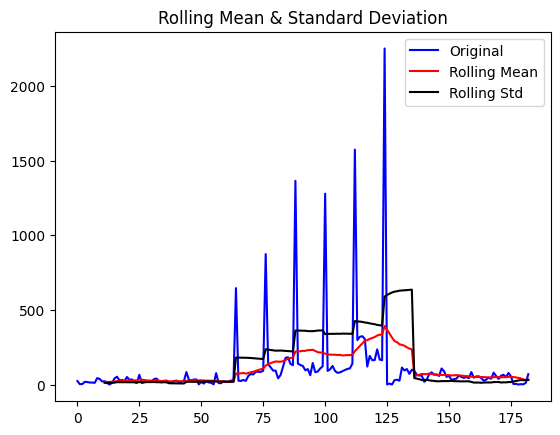

In [116]:
#Plot rolling statistics:
orig = plt.plot(monthly_OS['Posts'], color='blue',label='Original')
mean = plt.plot(moving_avg, color='red', label='Rolling Mean')
std = plt.plot(moving_std, color='black', label = 'Rolling Std')
plt.legend(loc='best')
plt.title('Rolling Mean & Standard Deviation')
plt.show(block=False)

In [117]:
from statsmodels.tsa.stattools import adfuller
import pandas as pd

# Assuming 'monthly_OS' contains the DataFrame with 'Posts' column
print('Results of Dickey-Fuller Test:')
dftest = adfuller(monthly_OS['Posts'], autolag='AIC')
dfoutput = pd.Series(dftest[0:4], index=['Test Statistic', 'p-value', '#Lags Used', 'Number of Observations Used'])

for key, value in dftest[4].items():
    dfoutput['Critical Value (%s)' % key] = value
print(dfoutput)

Results of Dickey-Fuller Test:
Test Statistic                  -1.186979
p-value                          0.679172
#Lags Used                      11.000000
Number of Observations Used    171.000000
Critical Value (1%)             -3.469181
Critical Value (5%)             -2.878595
Critical Value (10%)            -2.575863
dtype: float64


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning: The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result
  v = v.dt.to_pydatetime()


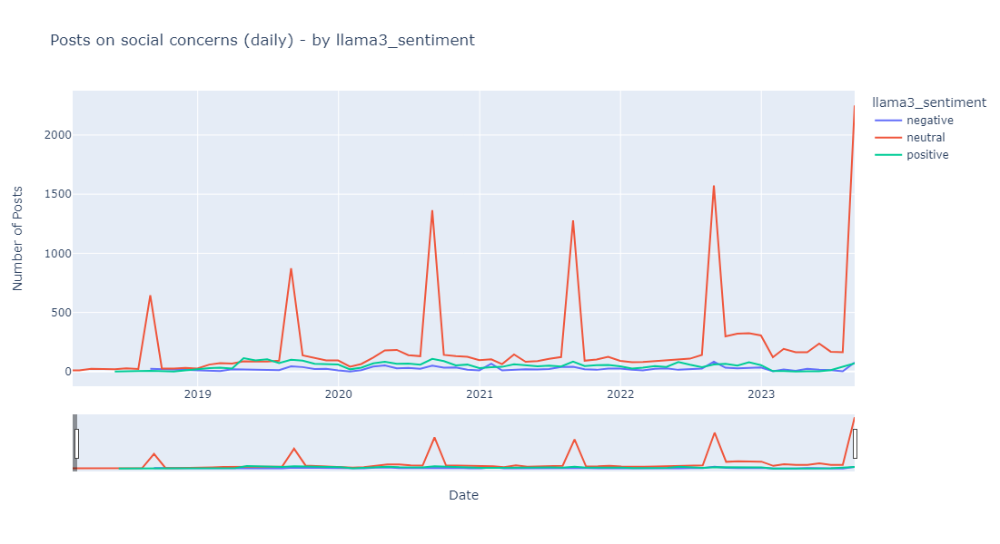

In [31]:

import plotly.express as px

# Convert 'Date' column to datetime
aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])

# Create subplots for all 'Keysector' titles
fig = px.line(aggr_df, x='Date', y='Posts', color='llama3_sentiment',
              title='Posts on social concerns (daily) - by llama3_sentiment')
fig.update_xaxes(title_text='Date')
fig.update_yaxes(title_text='Number of Posts')

# Add a legend label
fig.update_layout(legend_title_text='llama3_sentiment')

# To make subplots, use facet_col
fig.update_layout(xaxis_rangeslider_visible=True, showlegend=True)
fig.update_xaxes(rangeslider=dict(visible=True))
fig.update_layout(height=600, width=800, title_text='Posts on social concerns (daily) - by llama3_sentiment')
fig.show()



/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



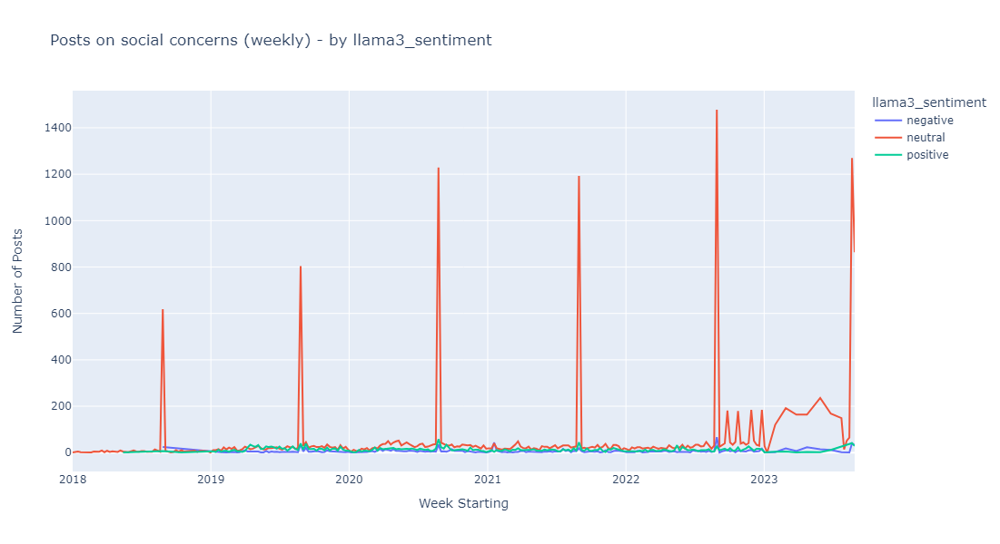

In [32]:
import plotly.express as px

# Ensure 'Date' column is in datetime format
df['Date'] = pd.to_datetime(df['Date'])

# Group by 'Keysector' and 'Date' and count the posts
aggr_df = df.groupby(['llama3_sentiment', pd.Grouper(key='Date', freq='W-MON')])['Text_lemma'].count().reset_index()
aggr_df.columns = ['llama3_sentiment', 'Date', 'Posts']

# Create subplots for all 'Keysector' titles
fig = px.line(aggr_df, x='Date', y='Posts', color='llama3_sentiment',
              title='Posts on social concerns (weekly) - by llama3_sentiment',
              labels={'Date': 'Week Starting'})
fig.update_yaxes(title_text='Number of Posts')

# Add a legend label
fig.update_layout(legend_title_text='llama3_sentiment')

# To make subplots, use facet_col
fig.update_layout(showlegend=True)
fig.update_layout(height=600, width=800, title_text='Posts on social concerns (weekly) - by llama3_sentiment')
fig.show()


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



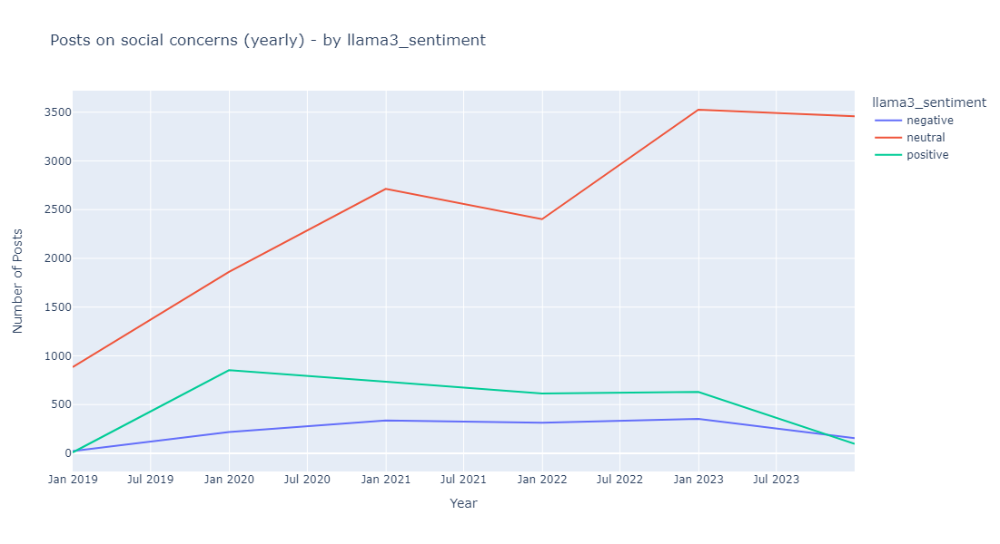

In [34]:
import plotly.express as px

# Ensure 'Date' column is in datetime format
df['Date'] = pd.to_datetime(df['Date'])

# Group by 'Keysector' and 'Date' and count the posts
aggr_df = df.groupby(['llama3_sentiment',  pd.Grouper(key='Date', freq='Y')])['Text_lemma'].count().reset_index()
aggr_df.columns = ['llama3_sentiment', 'Date', 'Posts']

# Create subplots for all 'Keysector' titles
fig = px.line(aggr_df, x='Date', y='Posts', color='llama3_sentiment',
              title='Posts on social concerns (yearly) - by llama3_sentiment',
              labels={'Date': 'Year'})
fig.update_yaxes(title_text='Number of Posts')

# Add a legend label
fig.update_layout(legend_title_text='llama3_sentiment')

# To make subplots, use facet_col
fig.update_layout(showlegend=True)
fig.update_layout(height=600, width=800, title_text='Posts on social concerns (yearly) - by llama3_sentiment')
fig.show()


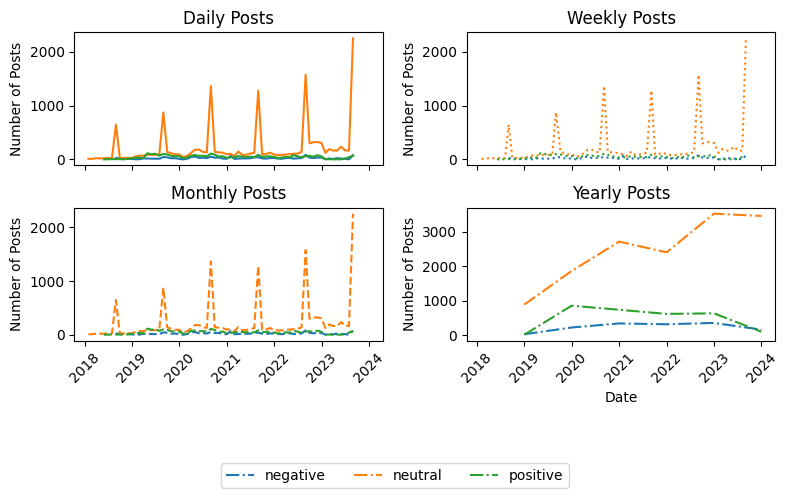

In [25]:
import pandas as pd
import matplotlib.pyplot as plt
aggr_df=monthly_OS.copy()
# Convert 'Date' column to datetime
aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])

# Resample data for daily, weekly, monthly, and yearly frequencies based on 'llama3_sentiment'
aggr_df.set_index('Date', inplace=True)

# Grouping and summing posts for different time intervals
daily_data = aggr_df.groupby([pd.Grouper(freq='D'), 'llama3_sentiment'])['Posts'].sum().reset_index()
weekly_data = aggr_df.groupby([pd.Grouper(freq='W'), 'llama3_sentiment'])['Posts'].sum().reset_index()
monthly_data = aggr_df.groupby([pd.Grouper(freq='M'), 'llama3_sentiment'])['Posts'].sum().reset_index()
yearly_data = aggr_df.groupby([pd.Grouper(freq='Y'), 'llama3_sentiment'])['Posts'].sum().reset_index()

# Create subplots with 2 rows and 2 columns
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(8, 5), sharex=True)

# Flatten the axes array to iterate over it easily
axes = axes.flatten()

# List of unique sentiments to plot
sentiments = aggr_df['llama3_sentiment'].unique()

# Plot Daily data on the first subplot
for sentiment in sentiments:
    daily_sentiment_data = daily_data[daily_data['llama3_sentiment'] == sentiment]
    axes[0].plot(daily_sentiment_data['Date'], daily_sentiment_data['Posts'], label=f'{sentiment} - Daily', linestyle='solid')

axes[0].set_title('Daily Posts')
axes[0].set_ylabel('Number of Posts')

# Plot Weekly data on the second subplot
for sentiment in sentiments:
    weekly_sentiment_data = weekly_data[weekly_data['llama3_sentiment'] == sentiment]
    axes[1].plot(weekly_sentiment_data['Date'], weekly_sentiment_data['Posts'], label=f'{sentiment} - Weekly', linestyle='dotted')

axes[1].set_title('Weekly Posts')
axes[1].set_ylabel('Number of Posts')

# Plot Monthly data on the third subplot
for sentiment in sentiments:
    monthly_sentiment_data = monthly_data[monthly_data['llama3_sentiment'] == sentiment]
    axes[2].plot(monthly_sentiment_data['Date'], monthly_sentiment_data['Posts'], label=f'{sentiment} - Monthly', linestyle='--')

axes[2].set_title('Monthly Posts')
axes[2].set_ylabel('Number of Posts')

# Plot Yearly data on the fourth subplot
for sentiment in sentiments:
    yearly_sentiment_data = yearly_data[yearly_data['llama3_sentiment'] == sentiment]
    axes[3].plot(yearly_sentiment_data['Date'], yearly_sentiment_data['Posts'], label=f'{sentiment} - Yearly', linestyle='-.')

axes[3].set_title('Yearly Posts')
axes[3].set_ylabel('Number of Posts')
axes[3].set_xlabel('Date')

# Rotate x-axis labels for all plots
for ax in axes:
    ax.tick_params(axis='x', rotation=45)

# Place the legend outside at the bottom, across the whole figure
handles, labels = axes[3].get_legend_handles_labels()  # Collect legend elements
# Remove ' - Yearly' from the labels
labels = [label.replace(' - Yearly', '') for label in labels]

# Add the legend to the bottom
fig.legend(handles, labels, loc='lower center', bbox_to_anchor=(0.5, -0.0001), ncol=3)

# Adjust layout to fit everything properly and leave space for the legend at the bottom
plt.tight_layout(rect=[0, 0.15, 1, 1])  # Adjust rect to leave more space for the legend

# Show the plot
plt.show()


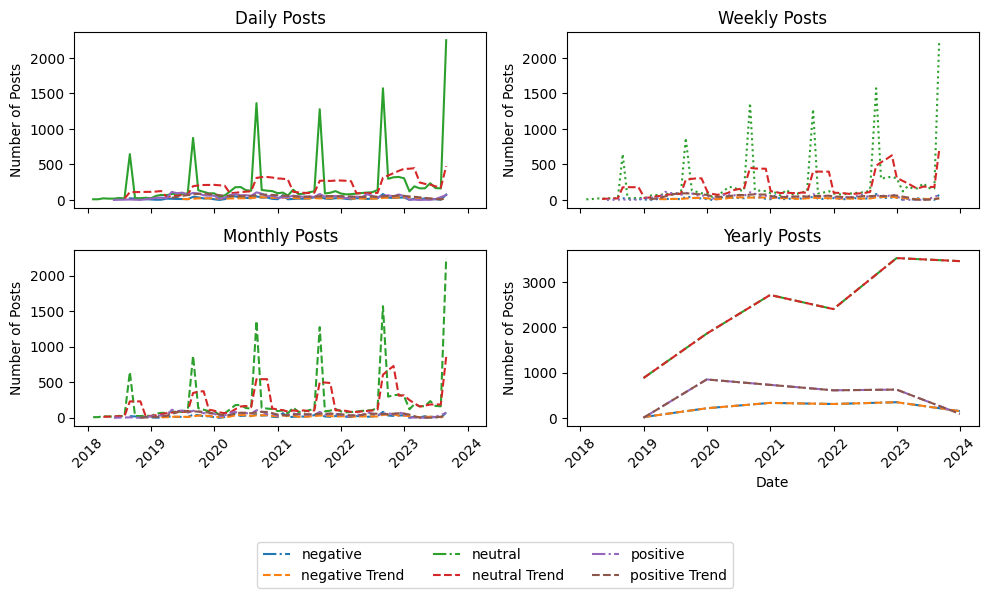

In [109]:
import pandas as pd
import matplotlib.pyplot as plt

aggr_df = monthly_OS.copy()
# Convert 'Date' column to datetime
aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])

# Resample data for daily, weekly, monthly, and yearly frequencies based on 'llama3_sentiment'
aggr_df.set_index('Date', inplace=True)

# Grouping and summing posts for different time intervals
daily_data = aggr_df.groupby([pd.Grouper(freq='D'), 'llama3_sentiment'])['Posts'].sum().reset_index()
weekly_data = aggr_df.groupby([pd.Grouper(freq='W'), 'llama3_sentiment'])['Posts'].sum().reset_index()
monthly_data = aggr_df.groupby([pd.Grouper(freq='M'), 'llama3_sentiment'])['Posts'].sum().reset_index()
yearly_data = aggr_df.groupby([pd.Grouper(freq='Y'), 'llama3_sentiment'])['Posts'].sum().reset_index()

# Define a function to calculate the rolling mean (trendline)
def calculate_trend(data, window=7):
    return data.rolling(window=window).mean()

# Create subplots with 2 rows and 2 columns
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(10, 6), sharex=True)

# Flatten the axes array to iterate over it easily
axes = axes.flatten()

# List of unique sentiments to plot
sentiments = aggr_df['llama3_sentiment'].unique()

# Plot Daily data on the first subplot
for sentiment in sentiments:
    daily_sentiment_data = daily_data[daily_data['llama3_sentiment'] == sentiment]
    trend = calculate_trend(daily_sentiment_data['Posts'], window=7)  # Weekly trend
    axes[0].plot(daily_sentiment_data['Date'], daily_sentiment_data['Posts'], label=f'{sentiment}', linestyle='solid')
    axes[0].plot(daily_sentiment_data['Date'], trend, label=f'{sentiment} Trend', linestyle='dashed')

axes[0].set_title('Daily Posts')
axes[0].set_ylabel('Number of Posts')

# Plot Weekly data on the second subplot
for sentiment in sentiments:
    weekly_sentiment_data = weekly_data[weekly_data['llama3_sentiment'] == sentiment]
    trend = calculate_trend(weekly_sentiment_data['Posts'], window=4)  # 4-week trend
    axes[1].plot(weekly_sentiment_data['Date'], weekly_sentiment_data['Posts'], label=f'{sentiment}', linestyle='dotted')
    axes[1].plot(weekly_sentiment_data['Date'], trend, label=f'{sentiment} Trend', linestyle='dashed')

axes[1].set_title('Weekly Posts')
axes[1].set_ylabel('Number of Posts')

# Plot Monthly data on the third subplot
for sentiment in sentiments:
    monthly_sentiment_data = monthly_data[monthly_data['llama3_sentiment'] == sentiment]
    trend = calculate_trend(monthly_sentiment_data['Posts'], window=3)  # 3-month trend
    axes[2].plot(monthly_sentiment_data['Date'], monthly_sentiment_data['Posts'], label=f'{sentiment}', linestyle='--')
    axes[2].plot(monthly_sentiment_data['Date'], trend, label=f'{sentiment} Trend', linestyle='dashed')

axes[2].set_title('Monthly Posts')
axes[2].set_ylabel('Number of Posts')

# Plot Yearly data on the fourth subplot
for sentiment in sentiments:
    yearly_sentiment_data = yearly_data[yearly_data['llama3_sentiment'] == sentiment]
    trend = calculate_trend(yearly_sentiment_data['Posts'], window=1)  # 1-year trend
    axes[3].plot(yearly_sentiment_data['Date'], yearly_sentiment_data['Posts'], label=f'{sentiment}', linestyle='-.')
    axes[3].plot(yearly_sentiment_data['Date'], trend, label=f'{sentiment} Trend', linestyle='dashed')

axes[3].set_title('Yearly Posts')
axes[3].set_ylabel('Number of Posts')
axes[3].set_xlabel('Date')

# Rotate x-axis labels for all plots
for ax in axes:
    ax.tick_params(axis='x', rotation=45)

# Collect unique handles and labels for the legend
handles, labels = axes[3].get_legend_handles_labels()

# Filter out duplicates (keep only one label for each sentiment and its trend)
unique_labels = {}
unique_handles = []

for handle, label in zip(handles, labels):
    if label not in unique_labels:
        unique_labels[label] = handle
        unique_handles.append(handle)

# Add the legend to the bottom
fig.legend(unique_handles, unique_labels.keys(), loc='lower center', bbox_to_anchor=(0.5, -0.0001), ncol=3)

# Adjust layout to fit everything properly and leave space for the legend at the bottom
plt.tight_layout(rect=[0, 0.15, 1, 1])  # Adjust rect to leave more space for the legend

# Show the plot
plt.show()


In [ ]:
# # Group by 'cleaned_theme', 'Date', and 'llama3_sentiment' and count the posts
# aggr_df = filtered_df.groupby(['cleaned_theme', pd.Grouper(key='Date', freq='M'), 'llama3_sentiment'])['Text_lemma'].count().reset_index()
# aggr_df.columns = ['cleaned_theme', 'Date', 'llama3_sentiment', 'Posts']

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



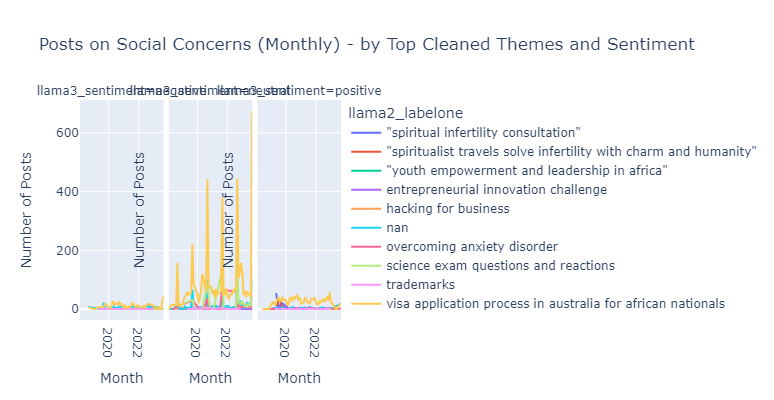

In [241]:
import plotly.express as px
import pandas as pd

# Assuming 'df' is your DataFrame and is already loaded

# Convert 'Date' column to datetime if it's not already
df['Date'] = pd.to_datetime(df['Date'])

# Identify the top ten 'cleaned_theme' based on the number of posts
top_themes = df['llama2_labelone'].value_counts().nlargest(10).index

# Filter the DataFrame to include only rows with the top ten 'cleaned_theme'
filtered_df = df[df['llama2_labelone'].isin(top_themes)]

# Group by 'cleaned_theme', 'Date', and 'llama3_sentiment' and count the posts
aggr_df = filtered_df.groupby(['llama2_labelone', pd.Grouper(key='Date', freq='M'), 'llama3_sentiment'])['Text_lemma'].count().reset_index()
aggr_df.columns = ['llama2_labelone', 'Date', 'llama3_sentiment', 'Posts']

# Create a line plot visualizing the monthly post counts by 'cleaned_theme' and 'llama3_sentiment'
fig = px.line(aggr_df, x='Date', y='Posts', color='llama2_labelone',
              title='Posts on Social Concerns (Monthly) - by Top Cleaned Themes and Sentiment',
              labels={'Date': 'Month'},
              facet_col='llama3_sentiment',
              category_orders={"llama3_sentiment": sorted(aggr_df['llama3_sentiment'].unique())})

# Update axis titles
fig.update_xaxes(title_text='Month')
fig.update_yaxes(title_text='Number of Posts')

# Add a legend label and adjust layout
fig.update_layout(legend_title_text='llama2_labelone', showlegend=True)
fig.update_layout(height=400, width=900, title_text='Posts on Social Concerns (Monthly) - by Top Cleaned Themes and Sentiment')

# Display the plot
fig.show()

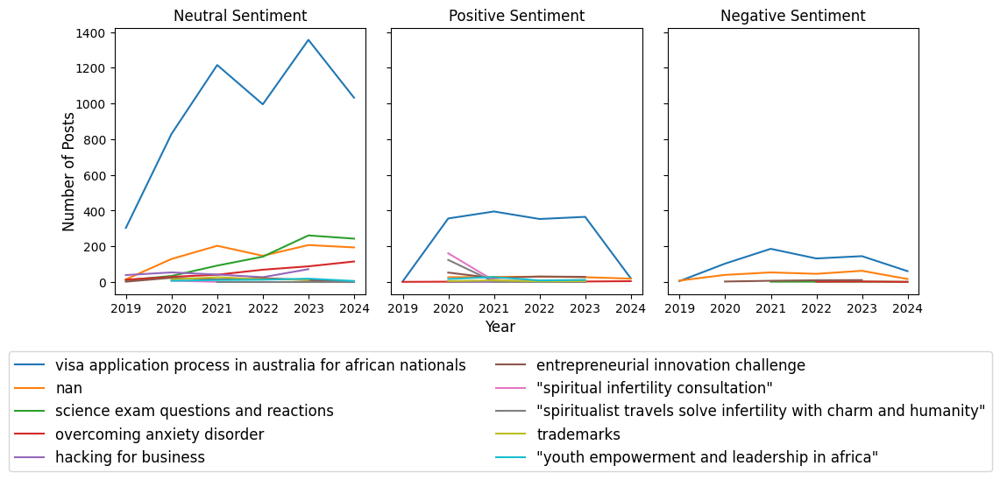

In [242]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'df' is your DataFrame and is already loaded

# Convert 'Date' column to datetime if it's not already
df['Date'] = pd.to_datetime(df['Date'])

# Filter topics that have a count between 50 and 100
topic_counts = df['llama2_labelone'].value_counts()
top_themes = topic_counts.head(10).index

# Filter the DataFrame to include only rows with the selected topics
filtered_df = df[df['llama2_labelone'].isin(top_themes)]

# Group by 'llama2_labelone', 'Date', and 'llama3_sentiment', and count the posts
aggr_df = filtered_df.groupby(['llama2_labelone', pd.Grouper(key='Date', freq='Y'), 'llama3_sentiment'])['Text_lemma'].count().reset_index()
aggr_df.columns = ['llama2_labelone', 'Date', 'llama3_sentiment', 'Posts']

# Get unique sentiments and filtered top themes for plotting
unique_sentiments = aggr_df['llama3_sentiment'].unique()

# Create a grid of subplots
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(10, 4), sharex=True, sharey=True)

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Plot data for each sentiment and topic in subplots
handles = []  # Store handles for the legend
labels = []  # Store labels for the legend

for i, sentiment in enumerate(unique_sentiments):
    sentiment_data = aggr_df[aggr_df['llama3_sentiment'] == sentiment]
    
    for j, topic in enumerate(top_themes):
        topic_data = sentiment_data[sentiment_data['llama2_labelone'] == topic]
        if not topic_data.empty:
            ax = axes[i]  # Use one of the subplots axes
            line, = ax.plot(topic_data['Date'], topic_data['Posts'], label=f'{topic}')  # Only the topic name in the legend
            
            # Collect the handles and labels once to ensure all are included in the final legend
            if topic not in labels:
                handles.append(line)
                labels.append(topic)
    
    # Set title for each subplot
    ax.set_title(f'{sentiment.capitalize()} Sentiment')

# Global x and y labels
fig.text(0.5, 0.04, 'Year', ha='center', fontsize=12)
fig.text(0.0004, 0.5, 'Number of Posts', va='center', rotation='vertical', fontsize=12)

# Remove individual y-axis labels
for ax in axes:
    ax.set_ylabel('')  # Remove individual y-axis labels

# Use the stored handles and labels to create one global legend
fig.legend(handles, labels, loc='lower center', bbox_to_anchor=(0.5, -0.38), ncol=2, fontsize=12)

# Adjust layout
plt.tight_layout(rect=[0, 0.05, 1, 1])  # Leave space for the legend at the bottom

# Show the plot
plt.show()


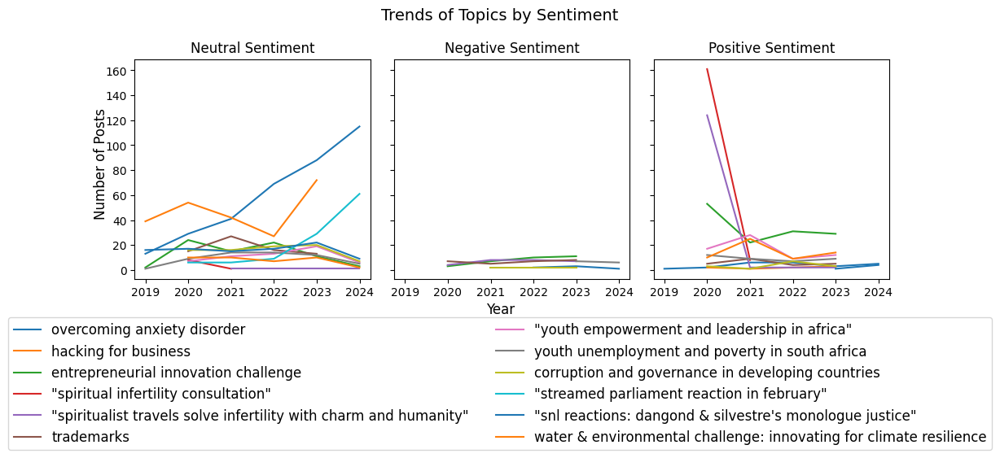

In [232]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'df' is your DataFrame and is already loaded

# Convert 'Date' column to datetime if it's not already
df['Date'] = pd.to_datetime(df['Date'])

# Filter topics that have a count between 50 and 100
topic_counts = df['llama2_labelone'].value_counts()
# top_themes = topic_counts.head(10).index
top_themes = topic_counts[(topic_counts >= 100) & (topic_counts <= 500)].index


# Filter the DataFrame to include only rows with the selected topics
filtered_df = df[df['llama2_labelone'].isin(top_themes)]

# Group by 'llama2_labelone', 'Date', and 'llama3_sentiment', and count the posts
aggr_df = filtered_df.groupby(['llama2_labelone', pd.Grouper(key='Date', freq='Y'), 'llama3_sentiment'])['Text_lemma'].count().reset_index()
aggr_df.columns = ['llama2_labelone', 'Date', 'llama3_sentiment', 'Posts']

# Get unique sentiments and filtered top themes for plotting
unique_sentiments = aggr_df['llama3_sentiment'].unique()

# Create a grid of subplots
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(10, 4), sharex=True, sharey=True)

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Plot data for each sentiment and topic in subplots
handles = []  # Store handles for the legend
labels = []  # Store labels for the legend

for i, sentiment in enumerate(unique_sentiments):
    sentiment_data = aggr_df[aggr_df['llama3_sentiment'] == sentiment]
    
    for j, topic in enumerate(top_themes):
        topic_data = sentiment_data[sentiment_data['llama2_labelone'] == topic]
        if not topic_data.empty:
            ax = axes[i]  # Use one of the subplots axes
            line, = ax.plot(topic_data['Date'], topic_data['Posts'], label=f'{topic}')  # Only the topic name in the legend
            
            # Collect the handles and labels once to ensure all are included in the final legend
            if topic not in labels:
                handles.append(line)
                labels.append(topic)
    
    # Set title for each subplot
    ax.set_title(f'{sentiment.capitalize()} Sentiment')

# Global x and y labels
fig.text(0.5, 0.04, 'Year', ha='center', fontsize=12)
fig.text(0.0004, 0.5, 'Number of Posts', va='center', rotation='vertical', fontsize=12)

# Remove individual y-axis labels
for ax in axes:
    ax.set_ylabel('')  # Remove individual y-axis labels
fig.suptitle('Trends of Topics by Sentiment', fontsize=14)

# Use the stored handles and labels to create one global legend
fig.legend(handles, labels, loc='lower center', bbox_to_anchor=(0.5, -0.4), ncol=2, fontsize=12)

# Adjust layout
plt.tight_layout(rect=[0, 0.05, 1, 1])  # Leave space for the legend at the bottom

# Show the plot
plt.show()

/tmp/ipykernel_723867/3807875669.py:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_723867/3807875669.py:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_723867/3807875669.py:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipyke

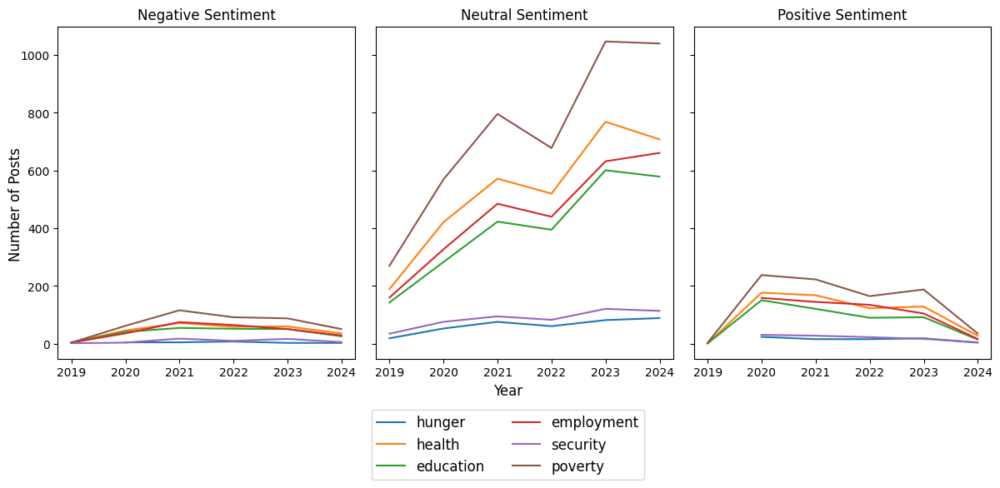

In [187]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'df' is your DataFrame and is already loaded

# Convert 'Date' column to datetime if it's not already
df['Date'] = pd.to_datetime(df['Date'])

# Define the themes of interest
themes = ['hunger', 'health', 'education', 'employment', 'security', 'poverty']

# Filter the DataFrame to include only rows where 'Predicted_Categories3' contains one of the themes
filtered_df = pd.DataFrame()

# Loop over each theme and filter the dataframe using 'contains'
for theme in themes:
    theme_df = df[df['Predicted_Categories3'].str.contains(theme, case=False, na=False)]
    
    # Use .loc to assign a new column safely
    theme_df.loc[:, 'theme'] = theme  # Add a new column to track which theme it belongs to
    filtered_df = pd.concat([filtered_df, theme_df])

# Group by 'theme', 'Date', and 'llama3_sentiment', and count the posts
aggr_df = filtered_df.groupby(['theme', pd.Grouper(key='Date', freq='Y'), 'llama3_sentiment'])['Text_lemma'].count().reset_index()
aggr_df.columns = ['theme', 'Date', 'llama3_sentiment', 'Posts']

# Get unique sentiments for plotting
unique_sentiments = aggr_df['llama3_sentiment'].unique()

# Create a grid of subplots
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(12, 5), sharex=True, sharey=True)

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Plot data for each sentiment and theme in subplots
handles = []  # Store handles for the legend
labels = []  # Store labels for the legend

for i, sentiment in enumerate(unique_sentiments):
    sentiment_data = aggr_df[aggr_df['llama3_sentiment'] == sentiment]
    
    for j, theme in enumerate(themes):
        theme_data = sentiment_data[sentiment_data['theme'] == theme]
        if not theme_data.empty:
            ax = axes[i]  # Use one of the subplots axes
            line, = ax.plot(theme_data['Date'], theme_data['Posts'], label=f'{theme}')  # Only the theme name in the legend
            
            # Collect the handles and labels once to ensure all are included in the final legend
            if theme not in labels:
                handles.append(line)
                labels.append(theme)
    
    # Set title for each subplot
    ax.set_title(f'{sentiment.capitalize()} Sentiment')

# Global x and y labels
fig.text(0.5, 0.04, 'Year', ha='center', fontsize=12)
fig.text(0.0004, 0.5, 'Number of Posts', va='center', rotation='vertical', fontsize=12)

# Remove individual y-axis labels
for ax in axes:
    ax.set_ylabel('')  # Remove individual y-axis labels

# Use the stored handles and labels to create one global legend
fig.legend(handles, labels, loc='lower center', bbox_to_anchor=(0.5, -0.18), ncol=2, fontsize=12)

# Adjust layout
plt.tight_layout(rect=[0, 0.05, 1, 1])  # Leave space for the legend at the bottom

# Show the plot
plt.show()


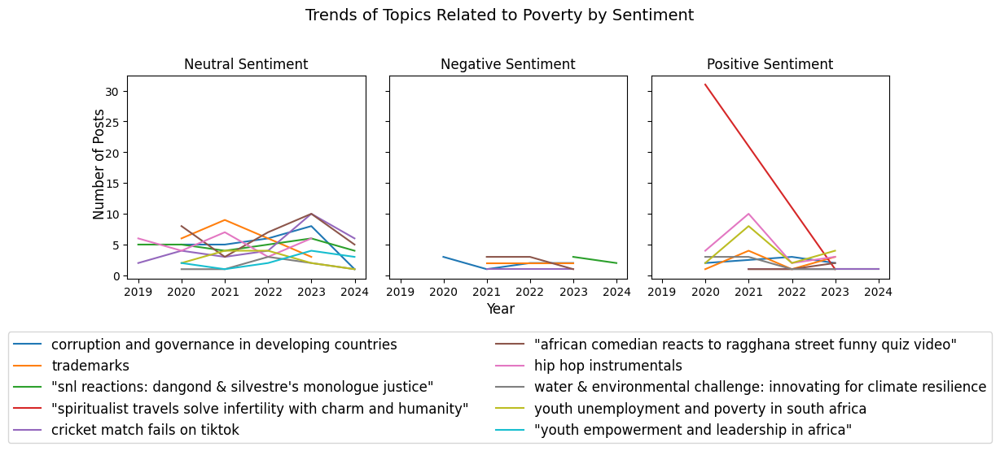

In [231]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'df' is your DataFrame and is already loaded

# Convert 'Date' column to datetime if it's not already
df['Date'] = pd.to_datetime(df['Date'])

# Filter the DataFrame to include only rows where 'Predicted_Categories3' contains 'poverty'
poverty_df = df[df['Predicted_Categories3'].str.contains('poverty', case=False, na=False)]

# Identify the top topics related to the "poverty" theme by their counts
topic_counts = poverty_df['llama2_labelone'].value_counts()

# top_poverty_topics = poverty_df['llama2_labelone'].value_counts().nlargest(5).index  # Top 5 topics for clarity
top_poverty_topics =  topic_counts[(topic_counts >= 28) & (topic_counts <= 40)].index

# Filter the poverty DataFrame to include only rows with the top topics
filtered_poverty_df = poverty_df[poverty_df['llama2_labelone'].isin(top_poverty_topics)]

# Group by 'llama2_labelone', 'Date', and 'llama3_sentiment', and count the posts
aggr_df = filtered_poverty_df.groupby(['llama2_labelone', pd.Grouper(key='Date', freq='Y'), 'llama3_sentiment'])['Text_lemma'].count().reset_index()
aggr_df.columns = ['llama2_labelone', 'Date', 'llama3_sentiment', 'Posts']

# Get unique sentiments for plotting
unique_sentiments = aggr_df['llama3_sentiment'].unique()

# Create a grid of subplots
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(10, 4), sharex=True, sharey=True)

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Plot data for each sentiment and top poverty-related topics in subplots
handles = []  # Store handles for the legend
labels = []  # Store labels for the legend

for i, sentiment in enumerate(unique_sentiments):
    sentiment_data = aggr_df[aggr_df['llama3_sentiment'] == sentiment]
    
    for j, topic in enumerate(top_poverty_topics):
        topic_data = sentiment_data[sentiment_data['llama2_labelone'] == topic]
        if not topic_data.empty:
            ax = axes[i]  # Use one of the subplots axes
            line, = ax.plot(topic_data['Date'], topic_data['Posts'], label=f'{topic}')  # Only the topic name in the legend
            
            # Collect the handles and labels once to ensure all are included in the final legend
            if topic not in labels:
                handles.append(line)
                labels.append(topic)
    
    # Set title for each subplot
    ax.set_title(f'{sentiment.capitalize()} Sentiment')

# Global x and y labels
fig.text(0.5, 0.04, 'Year', ha='center', fontsize=12)
fig.text(0.00002, 0.5, 'Number of Posts', va='center', rotation='vertical', fontsize=12)

# Remove individual y-axis labels
for ax in axes:
    ax.set_ylabel('')  # Remove individual y-axis labels

# Use the stored handles and labels to create one global legend
fig.legend(handles, labels, loc='lower center', bbox_to_anchor=(0.5, -0.38), ncol=2, fontsize=12)

# Add a title to the entire figure
fig.suptitle('Trends of Topics Related to Poverty by Sentiment', fontsize=14)

# Adjust layout
plt.tight_layout(rect=[0, 0.05, 1, 0.95])  # Leave space for the legend at the bottom and title at the top

# Show the plot
plt.show()


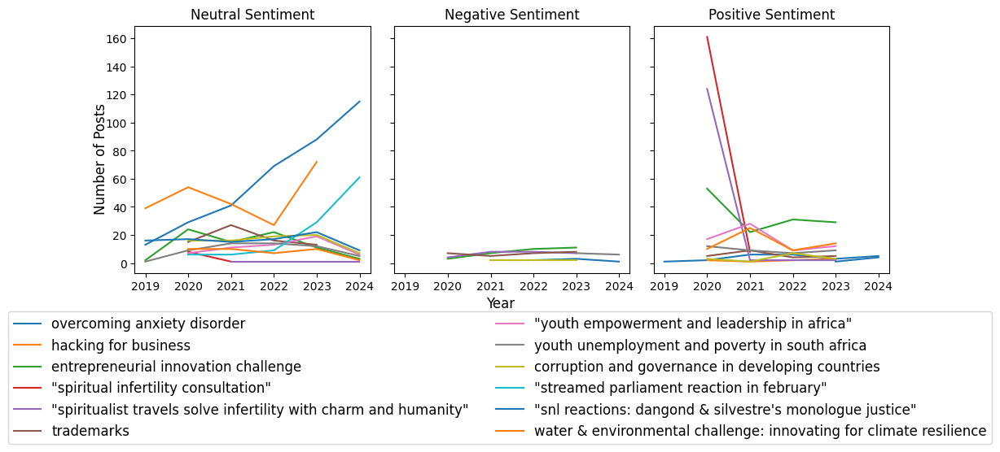

In [234]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'df' is your DataFrame and is already loaded

# Convert 'Date' column to datetime if it's not already
df['Date'] = pd.to_datetime(df['Date'])

# Filter topics that have a count between 50 and 100
topic_counts = df['llama2_labelone'].value_counts()
top_themes = topic_counts[(topic_counts >= 100) & (topic_counts <= 500)].index

# Filter the DataFrame to include only rows with the selected topics
filtered_df = df[df['llama2_labelone'].isin(top_themes)]

# Group by 'llama2_labelone', 'Date', and 'llama3_sentiment', and count the posts
aggr_df = filtered_df.groupby(['llama2_labelone', pd.Grouper(key='Date', freq='Y'), 'llama3_sentiment'])['Text_lemma'].count().reset_index()
aggr_df.columns = ['llama2_labelone', 'Date', 'llama3_sentiment', 'Posts']

# Get unique sentiments and filtered top themes for plotting
unique_sentiments = aggr_df['llama3_sentiment'].unique()

# Create a grid of subplots
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(10, 4), sharex=True, sharey=True)

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Plot data for each sentiment and topic in subplots
handles = []  # Store handles for the legend
labels = []  # Store labels for the legend

for i, sentiment in enumerate(unique_sentiments):
    sentiment_data = aggr_df[aggr_df['llama3_sentiment'] == sentiment]
    
    for j, topic in enumerate(top_themes):
        topic_data = sentiment_data[sentiment_data['llama2_labelone'] == topic]
        if not topic_data.empty:
            ax = axes[i]  # Use one of the subplots axes
            line, = ax.plot(topic_data['Date'], topic_data['Posts'], label=f'{topic}')  # Only the topic name in the legend
            
            # Collect the handles and labels once to ensure all are included in the final legend
            if topic not in labels:
                handles.append(line)
                labels.append(topic)
    
    # Set title for each subplot
    ax.set_title(f'{sentiment.capitalize()} Sentiment')

# Global x and y labels
fig.text(0.5, 0.04, 'Year', ha='center', fontsize=12)
fig.text(0.0004, 0.5, 'Number of Posts', va='center', rotation='vertical', fontsize=12)

# Remove individual y-axis labels
for ax in axes:
    ax.set_ylabel('')  # Remove individual y-axis labels

# Use the stored handles and labels to create one global legend
fig.legend(handles, labels, loc='lower center', bbox_to_anchor=(0.5, -0.4), ncol=2, fontsize=12)

# Adjust layout
plt.tight_layout(rect=[0, 0.05, 1, 1])  # Leave space for the legend at the bottom

# Show the plot
plt.show()


/tmp/ipykernel_897567/1919104934.py:32: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 4.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 6.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 0.
INFO:prophet:n_changepoints greater than number of observations. Using 18.
DEBUG:cmdstanpy:input tempfile: /tmp/tmptwp2u6ii/oye_oaje.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmptwp2u6ii/ueni3m0e.json
DEBUG:cmdsta

Skipping cricket match fails on tiktok (negative) due to insufficient data.


10:59:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 18.
INFO:prophet:n_changepoints greater than number of observations. Using 4.
DEBUG:cmdstanpy:input tempfile: /tmp/tmptwp2u6ii/g90w4dyo.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmptwp2u6ii/_mtvnyur.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=23481', 'data', 'file=/tmp/tmptwp2u6ii/g90w4dyo.json', 'init=/tmp/tmptwp2u6ii/_mtvnyur.json', 'output', 'file=/tmp/tmptwp2u6ii/prophet_model6cca_zsw/prophet_model-20240914105908.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
10:59:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
10:59:08 - cmdstanpy - INFO - Chain [1] done processing
INF

Skipping "spiritualist travels solve infertility with charm and humanity" (neutral) due to insufficient data.


10:59:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:n_changepoints greater than number of observations. Using 19.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 5.
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 8.
DEBUG:cmdstanpy:input tempfile: /tmp/tmptwp2u6ii/kfqiha9o.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmptwp2u6ii/4g1vroh_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=29991', 'data', 'file=/tmp/tmptwp2u6ii/kfqiha9o.json', 'init=/tmp/tmptwp2u6ii/4g1vroh_.json', 'output', 'file=/tmp/tm

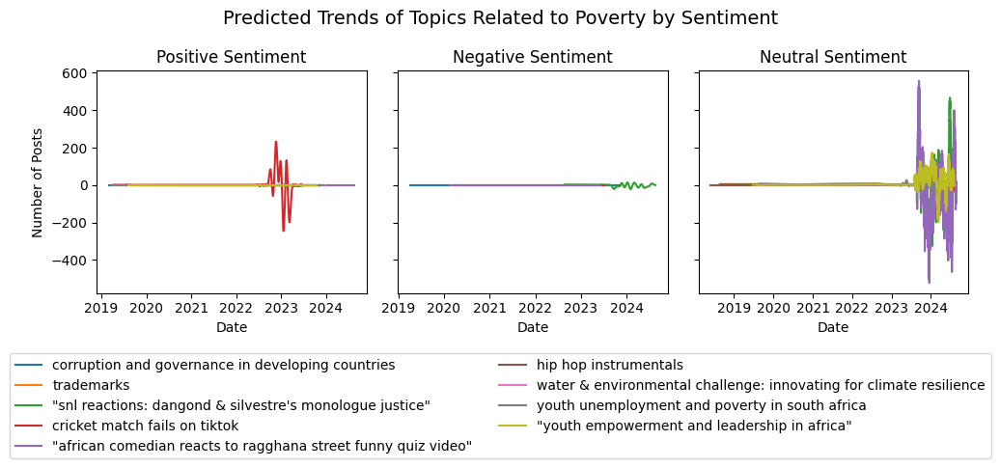

In [243]:
import pandas as pd
from prophet import Prophet
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np

# Assuming 'df' is your DataFrame and is already loaded

# Convert 'Date' column to datetime if it's not already
df['Date'] = pd.to_datetime(df['Date'])

# Filter the DataFrame to include only rows where 'Predicted_Categories3' contains 'poverty'
poverty_df = df[df['Predicted_Categories3'].str.contains('poverty', case=False, na=False)]

# Identify the top topics related to the "poverty" theme by their counts
topic_counts = poverty_df['llama2_labelone'].value_counts()

# Filter for topics with between 28 and 40 counts for better clarity
top_poverty_topics = topic_counts[(topic_counts >= 28) & (topic_counts <= 40)].index

# Filter the poverty DataFrame to include only rows with the top topics
filtered_poverty_df = poverty_df[poverty_df['llama2_labelone'].isin(top_poverty_topics)]

# Get unique sentiments and topics
unique_sentiments = filtered_poverty_df['llama3_sentiment'].unique()
unique_topics = top_poverty_topics

# Number of unique topics
n_topics = len(unique_topics)

# Generate a color map automatically based on the number of unique topics
color_map = cm.get_cmap('tab10', n_topics)
colors = color_map(np.linspace(0, 1, n_topics))

# Create a grid of subplots for each sentiment
fig, axes = plt.subplots(nrows=1, ncols=len(unique_sentiments), figsize=(10, 4), sharey=True)

# Loop through each sentiment and create subplots
for i, sentiment in enumerate(unique_sentiments):
    ax = axes[i]
    sentiment_data = filtered_poverty_df[filtered_poverty_df['llama3_sentiment'] == sentiment]
    
    # Index for color assignment
    color_index = 0
    
    # Loop through each topic for the current sentiment
    for topic in unique_topics:
        topic_data = sentiment_data[sentiment_data['llama2_labelone'] == topic]
        
        if not topic_data.empty:
            # Prepare data for Prophet
            topic_df = topic_data.groupby('Date').agg({'Text_lemma': 'count'}).reset_index()
            topic_df.columns = ['ds', 'y']
            
            # Only fit Prophet if there are at least 2 non-NaN rows
            if len(topic_df) >= 2:
                # Initialize Prophet model
                model = Prophet(yearly_seasonality=True, daily_seasonality=False)
                model.fit(topic_df)

                # Create a dataframe to hold future dates
                future_dates = model.make_future_dataframe(periods=365)  # 1 year into the future
                forecast = model.predict(future_dates)

                # Plot the forecast on the corresponding subplot
                ax.plot(forecast['ds'], forecast['yhat'], label=f'{topic}', color=colors[color_index])
                color_index += 1
            else:
                print(f"Skipping {topic} ({sentiment}) due to insufficient data.")
    
    # Set title and labels
    ax.set_title(f'{sentiment.capitalize()} Sentiment')
    ax.set_xlabel('Date')
    if i == 0:
        ax.set_ylabel('Number of Posts')
fig.suptitle('Predicted Trends of Topics Related to Poverty by Sentiment', fontsize=14)

# Add a global legend for all topics
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc='lower center', bbox_to_anchor=(0.5, -0.2), ncol=2, fontsize=10)

# Adjust layout
plt.tight_layout(rect=[0, 0.1, 1, 1])  # Leave space for the legend

# Show the plot
plt.show()


/tmp/ipykernel_897567/2358951465.py:21: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_897567/2358951465.py:21: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_897567/2358951465.py:21: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipyke

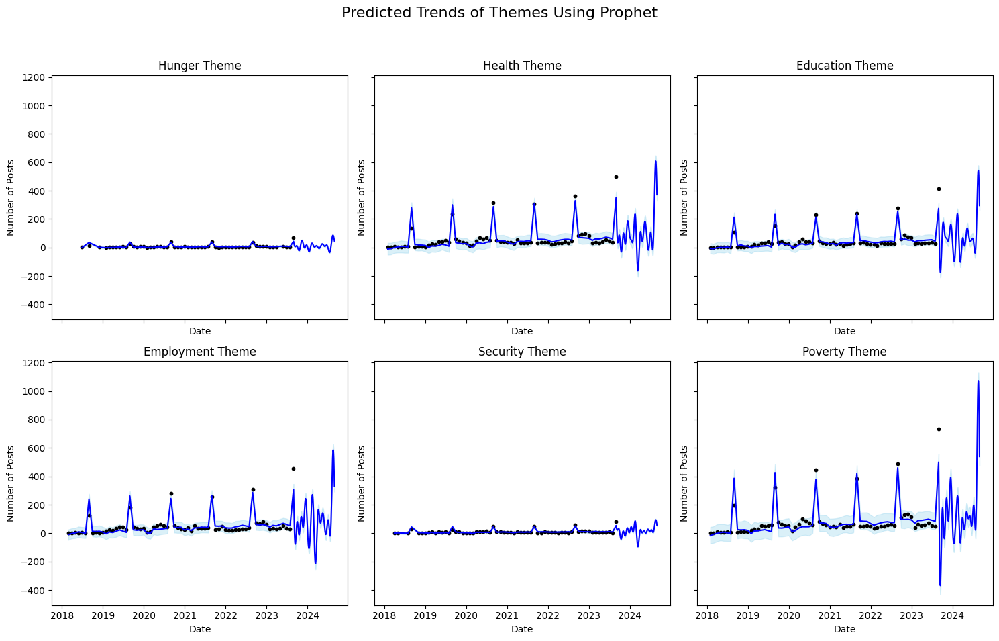

In [248]:
import pandas as pd
from prophet import Prophet
import matplotlib.pyplot as plt

# Assuming 'df' is your DataFrame and is already loaded

# Convert 'Date' column to datetime if it's not already
df['Date'] = pd.to_datetime(df['Date'])

# Define the themes of interest
themes = ['hunger', 'health', 'education', 'employment', 'security', 'poverty']

# Filter the DataFrame to include only rows where 'Predicted_Categories3' contains one of the themes
filtered_df = pd.DataFrame()

# Loop over each theme and filter the dataframe using 'contains'
for theme in themes:
    theme_df = df[df['Predicted_Categories3'].str.contains(theme, case=False, na=False)]
    
    # Use .loc to assign a new column safely
    theme_df.loc[:, 'theme'] = theme  # Add a new column to track which theme it belongs to
    filtered_df = pd.concat([filtered_df, theme_df])

# Group by 'theme' and 'Date', and count the posts
aggr_df = filtered_df.groupby(['theme', pd.Grouper(key='Date', freq='M')])['Text_lemma'].count().reset_index()
aggr_df.columns = ['theme', 'Date', 'Posts']

# Initialize subplots
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(15, 10), sharex=True, sharey=True)
axes = axes.flatten()

# Loop through each theme and apply Prophet
for i, theme in enumerate(themes):
    theme_data = aggr_df[aggr_df['theme'] == theme]
    
    if not theme_data.empty:
        ax = axes[i]
        
        # Prepare data for Prophet
        theme_df = theme_data.groupby('Date').agg({'Posts': 'sum'}).reset_index()
        theme_df.columns = ['ds', 'y']
        
        # Only fit Prophet if there are at least 2 non-NaN rows
        if len(theme_df) >= 2:
            # Initialize Prophet model
            model = Prophet(yearly_seasonality=True, daily_seasonality=False)
            model.fit(theme_df)

            # Create a dataframe to hold future dates
            future_dates = model.make_future_dataframe(periods=365)  # 1 year into the future
            forecast = model.predict(future_dates)

            # Plot the forecast, along with confidence intervals
            ax.plot(forecast['ds'], forecast['yhat'], label=f'{theme} trend', color='blue')
            ax.fill_between(forecast['ds'], forecast['yhat_lower'], forecast['yhat_upper'], color='skyblue', alpha=0.3)
            
            # Plot historical data
            ax.scatter(theme_df['ds'], theme_df['y'], color='black', label='Historical Data', s=10)

        else:
            print(f"Skipping {theme} due to insufficient data.")
    
    # Set title for each subplot
    ax.set_title(f'{theme.capitalize()} Theme')
    ax.set_xlabel('Date')
    ax.set_ylabel('Number of Posts')

# Global adjustments for the plot
fig.suptitle('Predicted Trends of Themes Using Prophet', fontsize=16)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Adjust layout for the title

# Show the plot
plt.show()


/tmp/ipykernel_897567/2595062134.py:21: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_897567/2595062134.py:21: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_897567/2595062134.py:21: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipyke

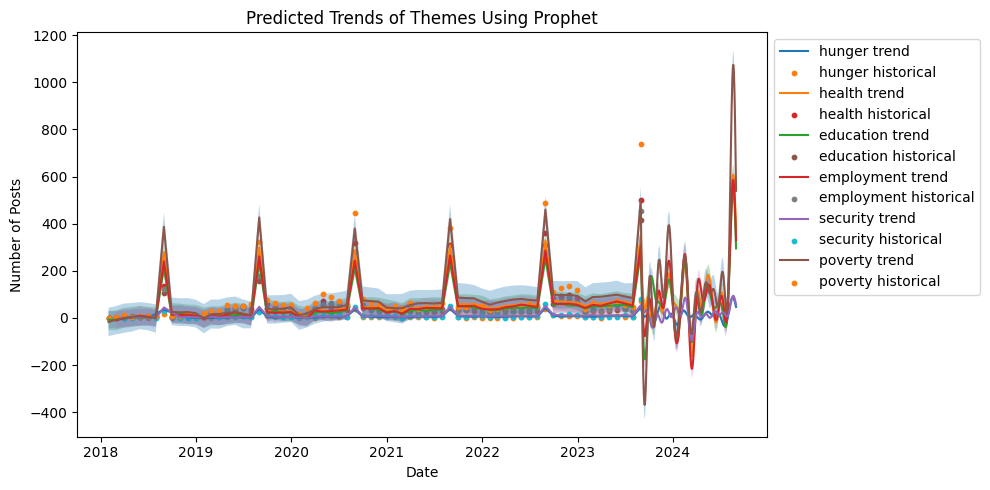

In [251]:
import pandas as pd
from prophet import Prophet
import matplotlib.pyplot as plt

# Assuming 'df' is your DataFrame and is already loaded

# Convert 'Date' column to datetime if it's not already
df['Date'] = pd.to_datetime(df['Date'])

# Define the themes of interest
themes = ['hunger', 'health', 'education', 'employment', 'security', 'poverty']

# Filter the DataFrame to include only rows where 'Predicted_Categories3' contains one of the themes
filtered_df = pd.DataFrame()

# Loop over each theme and filter the dataframe using 'contains'
for theme in themes:
    theme_df = df[df['Predicted_Categories3'].str.contains(theme, case=False, na=False)]
    
    # Use .loc to assign a new column safely
    theme_df.loc[:, 'theme'] = theme  # Add a new column to track which theme it belongs to
    filtered_df = pd.concat([filtered_df, theme_df])

# Group by 'theme' and 'Date', and count the posts
aggr_df = filtered_df.groupby(['theme', pd.Grouper(key='Date', freq='M')])['Text_lemma'].count().reset_index()
aggr_df.columns = ['theme', 'Date', 'Posts']

# Initialize a figure for a single graph
plt.figure(figsize=(10, 5))

# Loop through each theme and apply Prophet, adding results to the same plot
for theme in themes:
    theme_data = aggr_df[aggr_df['theme'] == theme]
    
    if not theme_data.empty:
        # Prepare data for Prophet
        theme_df = theme_data.groupby('Date').agg({'Posts': 'sum'}).reset_index()
        theme_df.columns = ['ds', 'y']
        
        # Only fit Prophet if there are at least 2 non-NaN rows
        if len(theme_df) >= 2:
            # Initialize Prophet model
            model = Prophet(yearly_seasonality=True, daily_seasonality=False)
            model.fit(theme_df)

            # Create a dataframe to hold future dates
            future_dates = model.make_future_dataframe(periods=365)  # 1 year into the future
            forecast = model.predict(future_dates)

            # Plot the forecast trend, along with confidence intervals, on the same graph
            plt.plot(forecast['ds'], forecast['yhat'], label=f'{theme} trend')
            plt.fill_between(forecast['ds'], forecast['yhat_lower'], forecast['yhat_upper'], alpha=0.3)

            # Plot historical data
            plt.scatter(theme_df['ds'], theme_df['y'], label=f'{theme} historical', s=10)
        else:
            print(f"Skipping {theme} due to insufficient data.")

# Set title and labels
plt.title('Predicted Trends of Themes Using Prophet', fontsize=12)
plt.xlabel('Date', fontsize=10)
plt.ylabel('Number of Posts', fontsize=10)

# Add a legend
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))

# Show the plot
plt.tight_layout()
plt.show()


/tmp/ipykernel_897567/3220322259.py:35: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 3.
DEBUG:cmdstanpy:input tempfile: /tmp/tmptwp2u6ii/sksk44_b.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmptwp2u6ii/6ss1fhpc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=21028', 'data', 'file=/tmp/tmptwp2u6ii/sksk44_b.json', 'init=/tmp/tmptwp2u6ii/6ss1fhpc.json', 'output', 'file=/tmp/tmptwp2u6ii/prophet_models5w18wlu/prophet_model-20240914113940.csv', 'method=optimize', 'al

Skipping "spiritualist travels solve infertility with charm and humanity" (neutral) due to insufficient data.


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 3.
DEBUG:cmdstanpy:input tempfile: /tmp/tmptwp2u6ii/bnxdtjwi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmptwp2u6ii/witnnk5r.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=67717', 'data', 'file=/tmp/tmptwp2u6ii/bnxdtjwi.json', 'init=/tmp/tmptwp2u6ii/witnnk5r.json', 'output', 'file=/tmp/tmptwp2u6ii/prophet_model58y525gp/prophet_model-20240914113940.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
11:39:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
11:39:40 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling weekly se

Skipping cricket match fails on tiktok (negative) due to insufficient data.


11:39:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 2.
DEBUG:cmdstanpy:input tempfile: /tmp/tmptwp2u6ii/6gi1cwhu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmptwp2u6ii/spd0lgux.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=8485', 'data', 'file=/tmp/tmptwp2u6ii/6gi1cwhu.json', 'init=/tmp/tmptwp2u6ii/spd0lgux.json', 'output', 'file=/tmp/tmptwp2u6ii/prophet_modelqjh13tj_/prophet_model-20240914113941.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
11:39:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
11:39:41 - cmdstanpy - INFO - Cha

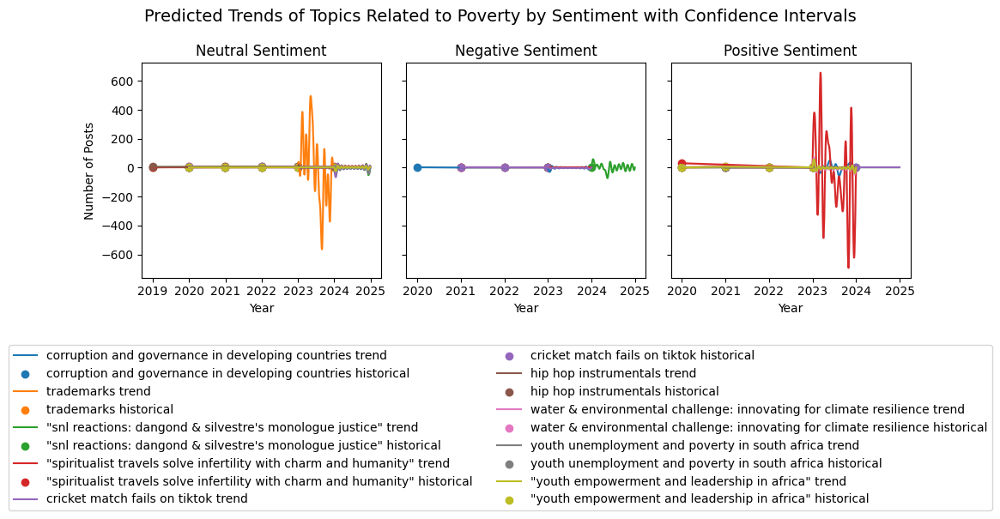

In [255]:
import pandas as pd
from prophet import Prophet
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np

# Assuming 'df' is your DataFrame and is already loaded

# Convert 'Date' column to datetime if it's not already
df['Date'] = pd.to_datetime(df['Date'])

# Filter the DataFrame to include only rows where 'Predicted_Categories3' contains 'poverty'
poverty_df = df[df['Predicted_Categories3'].str.contains('poverty', case=False, na=False)]

# Identify the top topics related to the "poverty" theme by their counts
topic_counts = poverty_df['llama2_labelone'].value_counts()

# Select topics with a count between 28 and 40 for better clarity
top_poverty_topics = topic_counts[(topic_counts >= 28) & (topic_counts <= 40)].index

# Filter the poverty DataFrame to include only rows with the top topics
filtered_poverty_df = poverty_df[poverty_df['llama2_labelone'].isin(top_poverty_topics)]

# Group by 'llama2_labelone', 'Date', and 'llama3_sentiment', and count the posts
aggr_df = filtered_poverty_df.groupby(['llama2_labelone', pd.Grouper(key='Date', freq='Y'), 'llama3_sentiment'])['Text_lemma'].count().reset_index()
aggr_df.columns = ['llama2_labelone', 'Date', 'llama3_sentiment', 'Posts']

# Get unique sentiments for plotting
unique_sentiments = aggr_df['llama3_sentiment'].unique()

# Number of unique topics
n_topics = len(top_poverty_topics)

# Generate a color map automatically based on the number of unique topics
color_map = cm.get_cmap('tab10', n_topics)
colors = color_map(np.linspace(0, 1, n_topics))

# Create a grid of subplots for each sentiment
fig, axes = plt.subplots(nrows=1, ncols=len(unique_sentiments), figsize=(10, 4), sharey=True)

# Loop through each sentiment and create subplots
for i, sentiment in enumerate(unique_sentiments):
    ax = axes[i]
    sentiment_data = aggr_df[aggr_df['llama3_sentiment'] == sentiment]
    
    # Index for color assignment
    color_index = 0
    
    # Loop through each topic for the current sentiment
    for topic in top_poverty_topics:
        topic_data = sentiment_data[sentiment_data['llama2_labelone'] == topic]
        
        if not topic_data.empty:
            # Prepare data for Prophet
            topic_df = topic_data.groupby('Date').agg({'Posts': 'sum'}).reset_index()
            topic_df.columns = ['ds', 'y']
            
            # Only fit Prophet if there are at least 2 non-NaN rows
            if len(topic_df) >= 2:
                # Initialize Prophet model
                model = Prophet(yearly_seasonality=True, daily_seasonality=False)
                model.fit(topic_df)

                # Create a dataframe to hold future dates
                future_dates = model.make_future_dataframe(periods=365)  # 1 year into the future
                forecast = model.predict(future_dates)

                # Plot the forecast and confidence intervals on the corresponding subplot
                ax.plot(forecast['ds'], forecast['yhat'], label=f'{topic} trend', color=colors[color_index])
                ax.fill_between(forecast['ds'], forecast['yhat_lower'], forecast['yhat_upper'], color=colors[color_index], alpha=0.2)
                ax.scatter(topic_df['ds'], topic_df['y'], label=f'{topic} historical', color=colors[color_index])
                color_index += 1
            else:
                print(f"Skipping {topic} ({sentiment}) due to insufficient data.")
    
    # Set title and labels
    ax.set_title(f'{sentiment.capitalize()} Sentiment')
    ax.set_xlabel('Year')
    if i == 0:
        ax.set_ylabel('Number of Posts')

# Add a global legend for all topics
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc='lower center', bbox_to_anchor=(0.5, -0.5), ncol=2, fontsize=10)

# Set a global title
fig.suptitle('Predicted Trends of Topics Related to Poverty by Sentiment with Confidence Intervals', fontsize=14)

# Adjust layout
plt.tight_layout(rect=[0, 0.05, 1, 1])  # Leave space for the legend and title

# Show the plot
plt.show()


In [246]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import matplotlib.cm as cm
# import numpy as np
# from gluonts.dataset.common import ListDataset
# from gluonts.mx.model.transformer import TransformerEstimator
# from gluonts.mx.trainer import Trainer
# from gluonts.evaluation import make_evaluation_predictions

# # Assuming 'df' is your DataFrame and is already loaded

# # Convert 'Date' column to datetime if it's not already
# df['Date'] = pd.to_datetime(df['Date'])

# # Filter the DataFrame to include only rows where 'Predicted_Categories3' contains 'poverty'
# poverty_df = df[df['Predicted_Categories3'].str.contains('poverty', case=False, na=False)]

# # Identify the top topics related to the "poverty" theme by their counts
# topic_counts = poverty_df['llama2_labelone'].value_counts()

# # Filter for topics with between 28 and 40 counts for better clarity
# top_poverty_topics = topic_counts[(topic_counts >= 28) & (topic_counts <= 40)].index

# # Filter the poverty DataFrame to include only rows with the top topics
# filtered_poverty_df = poverty_df[poverty_df['llama2_labelone'].isin(top_poverty_topics)]

# # Get unique sentiments and topics
# unique_sentiments = filtered_poverty_df['llama3_sentiment'].unique()
# unique_topics = top_poverty_topics

# # Number of unique topics
# n_topics = len(unique_topics)

# # Generate a color map automatically based on the number of unique topics
# color_map = cm.get_cmap('tab10', n_topics)
# colors = color_map(np.linspace(0, 1, n_topics))

# # Create a grid of subplots for each sentiment
# fig, axes = plt.subplots(nrows=1, ncols=len(unique_sentiments), figsize=(10, 4), sharey=True)

# # Loop through each sentiment and create subplots
# for i, sentiment in enumerate(unique_sentiments):
#     ax = axes[i]
#     sentiment_data = filtered_poverty_df[filtered_poverty_df['llama3_sentiment'] == sentiment]
    
#     # Index for color assignment
#     color_index = 0
    
#     # Loop through each topic for the current sentiment
#     for topic in unique_topics:
#         topic_data = sentiment_data[sentiment_data['llama2_labelone'] == topic]
        
#         if not topic_data.empty:
#             # Prepare data for Transformer
#             topic_df = topic_data.groupby('Date').agg({'Text_lemma': 'count'}).reset_index()
#             topic_df.columns = ['ds', 'y']
            
#             # Check if there is enough data for training
#             if len(topic_df) >= 30:  # Ensure enough data points for Transformer
#                 # Prepare the data for GluonTS Transformer model
#                 train_ds = ListDataset(
#                     [{"start": topic_df['ds'].min(), "target": topic_df['y'].values}],
#                     freq='D'  # Assuming daily frequency
#                 )

#                 # Define and train the Transformer estimator
#                 estimator = TransformerEstimator(
#                     prediction_length=30,
#                     context_length=90,
#                     freq='D',
#                     trainer=Trainer(epochs=5)
#                 )
                
#                 try:
#                     predictor = estimator.train(train_ds)

#                     # Create future dates and generate predictions
#                     test_ds = ListDataset(
#                         [{"start": topic_df['ds'].min(), "target": topic_df['y'].values}],
#                         freq='D'
#                     )

#                     # Make predictions
#                     forecast_it, _ = make_evaluation_predictions(test_ds, predictor=predictor, num_samples=100)
#                     forecast = next(forecast_it)

#                     # Plot the forecast on the corresponding subplot
#                     forecast_mean = forecast.mean[:len(topic_df['ds'])]
#                     ax.plot(topic_df['ds'], forecast_mean, label=f'{topic}', color=colors[color_index])
#                     color_index += 1
#                 except Exception as e:
#                     print(f"Error training model for topic {topic}: {e}")
#             else:
#                 print(f"Skipping {topic} ({sentiment}) due to insufficient data (less than 30 data points).")
    
#     # Set title and labels
#     ax.set_title(f'{sentiment.capitalize()} Sentiment')
#     ax.set_xlabel('Date')
#     if i == 0:
#         ax.set_ylabel('Number of Posts')

# # Set the overall plot title
# fig.suptitle('Predicted Trends of Topics Related to Poverty by Sentiment', fontsize=14)

# # Add a global legend for all topics
# handles, labels = ax.get_legend_handles_labels()
# fig.legend(handles, labels, loc='lower center', bbox_to_anchor=(0.5, -0.2), ncol=2, fontsize=10)

# # Adjust layout
# plt.tight_layout(rect=[0, 0.1, 1, 1])  # Leave space for the legend

# # Show the plot
# plt.show()


/tmp/ipykernel_897567/646859925.py:30: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 3.
DEBUG:cmdstanpy:input tempfile: /tmp/tmptwp2u6ii/qt6kz751.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmptwp2u6ii/c36fsvvg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60375', 'data', 'file=/tmp/tmptwp2u6ii/qt6kz751.json', 'init=/tmp/tmptwp2u6ii/c36fsvvg.json', 'output', 'file=/tmp/tmptwp2u6ii/prophet_modeld52i4gpw/prophet_model-20240914110454.csv', 'method=optimize', 'alg

Skipping hacking for business (negative) due to insufficient data.
Skipping "youth empowerment and leadership in africa" (negative) due to insufficient data.


11:04:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 2.
DEBUG:cmdstanpy:input tempfile: /tmp/tmptwp2u6ii/pq0p20o4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmptwp2u6ii/3ok22xzn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=48605', 'data', 'file=/tmp/tmptwp2u6ii/pq0p20o4.json', 'init=/tmp/tmptwp2u6ii/3ok22xzn.json', 'output', 'file=/tmp/tmptwp2u6ii/prophet_modelmmi1cxgt/prophet_model-20240914110455.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
11:04:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
11:04:55 - cmdstanpy - INFO - Ch

Skipping "streamed parliament reaction in february" (negative) due to insufficient data.


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 1.
DEBUG:cmdstanpy:input tempfile: /tmp/tmptwp2u6ii/gfryo7my.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmptwp2u6ii/e2mbmt_2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=3482', 'data', 'file=/tmp/tmptwp2u6ii/gfryo7my.json', 'init=/tmp/tmptwp2u6ii/e2mbmt_2.json', 'output', 'file=/tmp/tmptwp2u6ii/prophet_modeluay4n66u/prophet_model-20240914110456.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
11:04:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
11:04:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling weekly sea

Skipping "streamed parliament reaction in february" (positive) due to insufficient data.


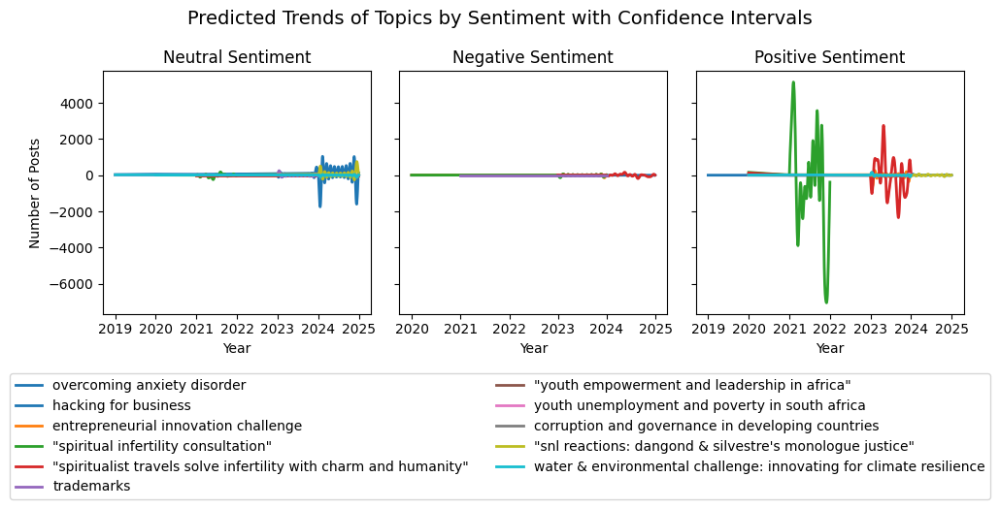

In [247]:
import pandas as pd
from prophet import Prophet
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np

# Assuming 'df' is your DataFrame and is already loaded

# Convert 'Date' column to datetime if it's not already
df['Date'] = pd.to_datetime(df['Date'])

# Filter topics that have a count between 100 and 500
topic_counts = df['llama2_labelone'].value_counts()
top_themes = topic_counts[(topic_counts >= 100) & (topic_counts <= 500)].index

# Filter the DataFrame to include only rows with the selected topics
filtered_df = df[df['llama2_labelone'].isin(top_themes)]

# Group by 'llama2_labelone', 'Date', and 'llama3_sentiment', and count the posts
aggr_df = filtered_df.groupby(['llama2_labelone', pd.Grouper(key='Date', freq='Y'), 'llama3_sentiment'])['Text_lemma'].count().reset_index()
aggr_df.columns = ['llama2_labelone', 'Date', 'llama3_sentiment', 'Posts']

# Get unique sentiments for plotting
unique_sentiments = aggr_df['llama3_sentiment'].unique()

# Number of unique topics
n_topics = len(top_themes)

# Generate a color map automatically based on the number of unique topics
color_map = cm.get_cmap('tab10', n_topics)
colors = color_map(np.linspace(0, 1, n_topics))

# Create a grid of subplots for each sentiment
fig, axes = plt.subplots(nrows=1, ncols=len(unique_sentiments), figsize=(10, 4), sharey=True)

# Loop through each sentiment and create subplots
for i, sentiment in enumerate(unique_sentiments):
    ax = axes[i]
    sentiment_data = aggr_df[aggr_df['llama3_sentiment'] == sentiment]
    
    # Index for color assignment
    color_index = 0
    
    # Loop through each topic for the current sentiment
    for topic in top_themes:
        topic_data = sentiment_data[sentiment_data['llama2_labelone'] == topic]
        
        if not topic_data.empty:
            # Prepare data for Prophet
            topic_df = topic_data.groupby('Date').agg({'Posts': 'sum'}).reset_index()
            topic_df.columns = ['ds', 'y']
            
            # Only fit Prophet if there are at least 2 non-NaN rows
            if len(topic_df) >= 2:
                # Initialize Prophet model
                model = Prophet(yearly_seasonality=True, daily_seasonality=False)
                model.fit(topic_df)

                # Create a dataframe to hold future dates
                future_dates = model.make_future_dataframe(periods=365)  # 1 year into the future
                forecast = model.predict(future_dates)

                # Plot the forecast and uncertainty intervals
                ax.plot(forecast['ds'], forecast['yhat'], label=f'{topic}', color=colors[color_index], lw=2)
                ax.fill_between(forecast['ds'], forecast['yhat_lower'], forecast['yhat_upper'], color=colors[color_index], alpha=0.2)

                color_index += 1
            else:
                print(f"Skipping {topic} ({sentiment}) due to insufficient data.")
    
    # Set title and labels
    ax.set_title(f'{sentiment.capitalize()} Sentiment')
    ax.set_xlabel('Year')
    if i == 0:
        ax.set_ylabel('Number of Posts')

fig.suptitle('Predicted Trends of Topics by Sentiment with Confidence Intervals', fontsize=14)

# Add a global legend for all topics
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc='lower center', bbox_to_anchor=(0.5, -0.3), ncol=2, fontsize=10)

# Adjust layout
plt.tight_layout(rect=[0, 0.05, 1, 1])  # Leave space for the legend

# Show the plot
plt.show()


In [118]:
# import pandas as pd
# import matplotlib.pyplot as plt
# from prophet import Prophet

# # Assuming 'df' is your DataFrame and is already loaded

# # Convert 'Date' column to datetime if it's not already
# df['Date'] = pd.to_datetime(df['Date'])

# # Filter topics based on count range (100 - 500)
# topic_counts = df['llama2_labelone'].value_counts()
# top_themes = topic_counts[(topic_counts >= 100) & (topic_counts <= 500)].index

# # Filter the DataFrame for the top themes
# filtered_df = df[df['llama2_labelone'].isin(top_themes)]

# # Group by 'llama2_labelone', 'Date', and 'llama3_sentiment', and count the posts
# aggr_df = filtered_df.groupby(['llama2_labelone', pd.Grouper(key='Date', freq='Y'), 'llama3_sentiment'])['Text_lemma'].count().reset_index()
# aggr_df.columns = ['llama2_labelone', 'Date', 'llama3_sentiment', 'Posts']

# # Get unique themes and sentiments
# unique_themes = aggr_df['llama2_labelone'].unique()
# unique_sentiments = aggr_df['llama3_sentiment'].unique()

# # Create a grid of subplots
# fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(12, 5), sharex=True, sharey=True)
# axes = axes.flatten()

# # Iterate through each sentiment for forecasting
# for i, sentiment in enumerate(unique_sentiments):
#     sentiment_data = aggr_df[aggr_df['llama3_sentiment'] == sentiment]
    
#     for j, theme in enumerate(unique_themes):
#         theme_data = sentiment_data[sentiment_data['llama2_labelone'] == theme]
        
#         if not theme_data.empty:
#             # Prophet expects two columns: 'ds' (date) and 'y' (target)
#             theme_df = theme_data[['Date', 'Posts']].rename(columns={'Date': 'ds', 'Posts': 'y'})
            
#             # Check if there are enough non-NaN data points
#             if theme_df['y'].notnull().sum() >= 2:  # Ensure at least 2 data points
#                 # Initialize Prophet model and fit the data
#                 model = Prophet(yearly_seasonality=True, daily_seasonality=False)
#                 model.fit(theme_df)
                
#                 # Create a dataframe for future dates (365 days into 2024)
#                 future_dates = model.make_future_dataframe(periods=365)
                
#                 # Predict the future trend for 2024
#                 forecast = model.predict(future_dates)
                
#                 # Plot actual and forecast data
#                 ax = axes[i]
#                 ax.plot(theme_df['ds'], theme_df['y'], label=f'{theme}', linestyle='solid')  # Actual data
#                 ax.plot(forecast['ds'], forecast['yhat'], linestyle='--')  # Forecast
    
#     # Set title and labels for each subplot
#     ax.set_title(f'{sentiment.capitalize()} Sentiment')
#     ax.set_ylabel('Number of Posts')

# # Global x and y labels
# fig.text(0.5, 0.04, 'Year', ha='center', fontsize=12)
# fig.text(0.0004, 0.5, 'Number of Posts', va='center', rotation='vertical', fontsize=12)

# # Remove individual y-axis labels
# for ax in axes:
#     ax.set_ylabel('')  # Remove individual y-axis labels

# # Combine all legends into one
# fig.legend(loc='lower center', bbox_to_anchor=(0.5, -0.2), ncol=3, fontsize=10)

# # Adjust layout to fit everything
# plt.tight_layout(rect=[0, 0.05, 1, 1])

# # Show the plot
# plt.show()


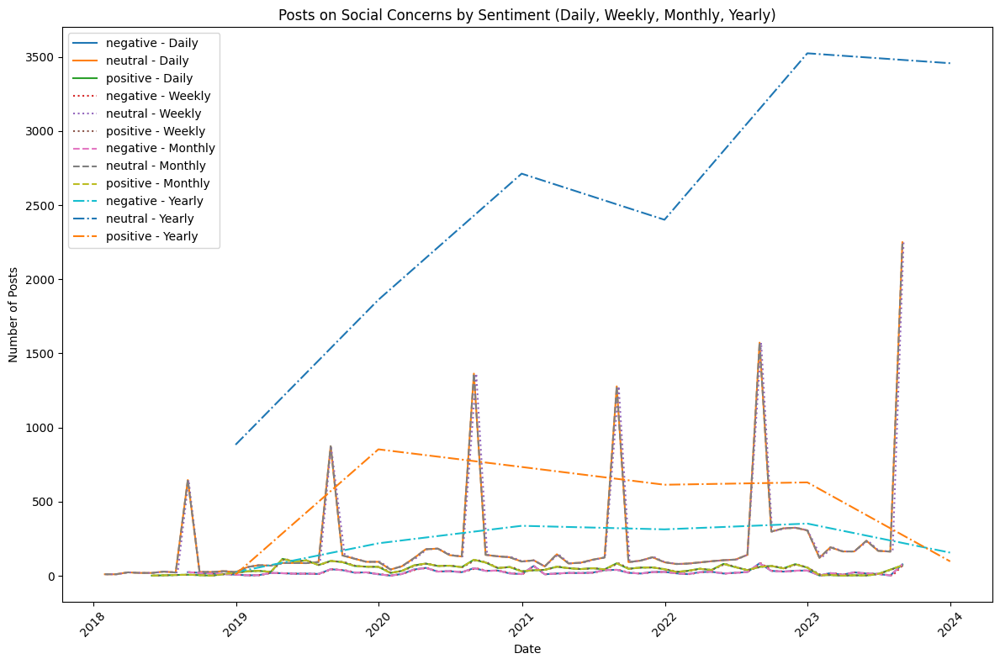

In [27]:
import pandas as pd
import matplotlib.pyplot as plt
aggr_df=monthly_OS.copy()
# Convert 'Date' column to datetime
aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])

# Resample data for daily, weekly, monthly, and yearly frequencies based on 'llama3_sentiment'
aggr_df.set_index('Date', inplace=True)

# Grouping and summing posts for different time intervals
daily_data = aggr_df.groupby([pd.Grouper(freq='D'), 'llama3_sentiment'])['Posts'].sum().reset_index()
weekly_data = aggr_df.groupby([pd.Grouper(freq='W'), 'llama3_sentiment'])['Posts'].sum().reset_index()
monthly_data = aggr_df.groupby([pd.Grouper(freq='M'), 'llama3_sentiment'])['Posts'].sum().reset_index()
yearly_data = aggr_df.groupby([pd.Grouper(freq='Y'), 'llama3_sentiment'])['Posts'].sum().reset_index()

# Create the plot
plt.figure(figsize=(12, 8))

# List of unique sentiments to plot
sentiments = aggr_df['llama3_sentiment'].unique()

# Plot Daily data
for sentiment in sentiments:
    daily_sentiment_data = daily_data[daily_data['llama3_sentiment'] == sentiment]
    plt.plot(daily_sentiment_data['Date'], daily_sentiment_data['Posts'], label=f'{sentiment} - Daily', linestyle='solid')

# Plot Weekly data
for sentiment in sentiments:
    weekly_sentiment_data = weekly_data[weekly_data['llama3_sentiment'] == sentiment]
    plt.plot(weekly_sentiment_data['Date'], weekly_sentiment_data['Posts'], label=f'{sentiment} - Weekly', linestyle='dotted')

# Plot Monthly data
for sentiment in sentiments:
    monthly_sentiment_data = monthly_data[monthly_data['llama3_sentiment'] == sentiment]
    plt.plot(monthly_sentiment_data['Date'], monthly_sentiment_data['Posts'], label=f'{sentiment} - Monthly', linestyle='--')

# Plot Yearly data
for sentiment in sentiments:
    yearly_sentiment_data = yearly_data[yearly_data['llama3_sentiment'] == sentiment]
    plt.plot(yearly_sentiment_data['Date'], yearly_sentiment_data['Posts'], label=f'{sentiment} - Yearly', linestyle='-.')

# Set titles and labels
plt.title('Posts on Social Concerns by Sentiment (Daily, Weekly, Monthly, Yearly)')
plt.xlabel('Date')
plt.ylabel('Number of Posts')

# Show the legend
plt.legend()

# Rotate x-axis labels for readability
plt.xticks(rotation=45)

# Adjust layout to avoid overlapping
plt.tight_layout()

# Show the plot
plt.show()


In [44]:
aggr_df=monthly_OS.copy()

In [45]:
import pandas as pd
from prophet import Prophet

# Assuming you have a DataFrame named 'daily_df' with the provided columns
# If not, load your DataFrame here

# Reset the index and rename the columns as 'ds' and 'y' for Prophet
# df2 = aggr_df.reset_index()
df2=aggr_df.copy()
df2 = df2[['llama3_sentiment', 'Date', 'Posts']]  # Select the relevant columns
df2.columns = ['llama3_sentiment', 'ds', 'y']

# Set the timezone for the 'ds' column (e.g., 'UTC' or any other desired timezone)
# df['ds'] = df['ds'].dt.tz_localize('UTC')
df2['ds'] = df2['ds'].dt.tz_localize(None)

# Create a Prophet model
model = Prophet()

# Fit the model to your data
model.fit(df2)

# Generate future dates for forecasting
future = model.make_future_dataframe(periods=365)  # Adjust the number of periods as needed

# Make predictions
forecast = model.predict(future)

# Display the last 3 rows of the forecast
forecast.tail(n=3)


19:04:25 - cmdstanpy - INFO - Chain [1] start processing
19:04:25 - cmdstanpy - INFO - Chain [1] done processing


,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
430,2024-08-28,168.729162,321.313486,874.665118,168.726763,168.731057,437.278100,437.278100,437.278100,437.278100,437.278100,437.278100,0.0,0.0,0.0,606.007263
431,2024-08-29,168.783930,331.541639,864.348243,168.781518,168.785836,420.024375,420.024375,420.024375,420.024375,420.024375,420.024375,0.0,0.0,0.0,588.808304
432,2024-08-30,168.838697,289.565761,849.288618,168.836276,168.840612,399.434932,399.434932,399.434932,399.434932,399.434932,399.434932,0.0,0.0,0.0,568.273629


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/prophet/plot.py:71: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/prophet/plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



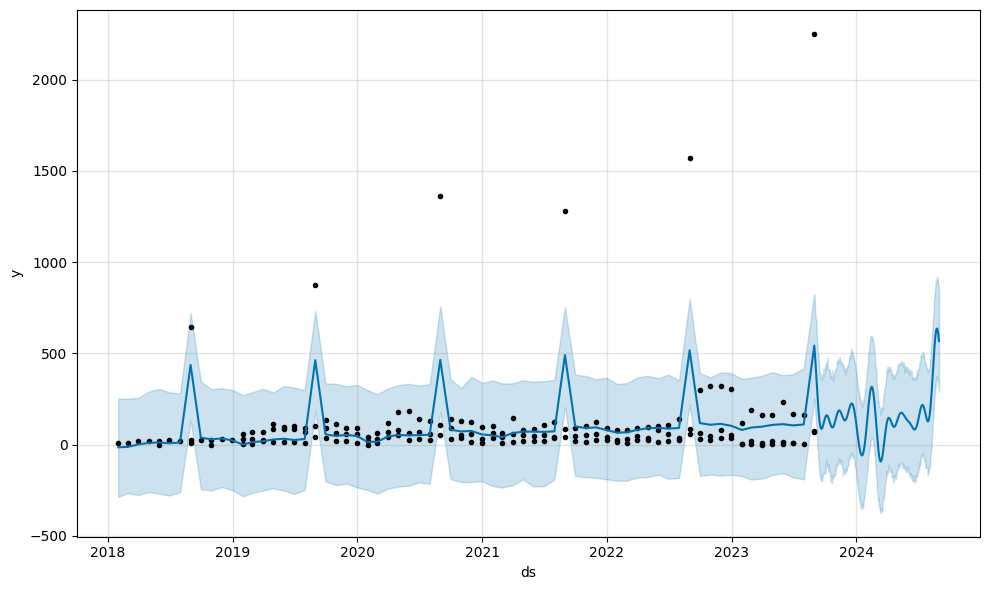

In [46]:
model.plot(forecast);

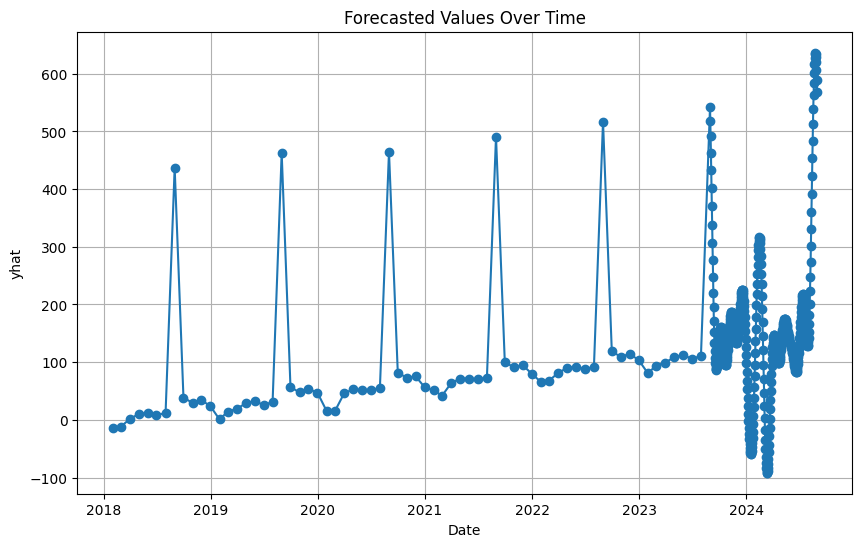

In [47]:
import matplotlib.pyplot as plt
import pandas as pd

# # Sample data
# data = {
#     'ds': ['2018-01-31', '2018-02-28', '2018-03-31'],
#     'yhat': [-28.423583, -22.012196, -13.283741]
# }

# # Create a DataFrame from the sample data
# df = pd.DataFrame(data)

# # Convert 'ds' column to datetime
# df['ds'] = pd.to_datetime(df['ds'])

# Plot the data
plt.figure(figsize=(10, 6))
plt.plot(forecast['ds'], forecast['yhat'], marker='o', linestyle='-')
plt.title('Forecasted Values Over Time')
plt.xlabel('Date')
plt.ylabel('yhat')
plt.grid(True)
plt.show()


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/prophet/plot.py:226: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/prophet/plot.py:349: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/prophet/plot.py:352: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on t

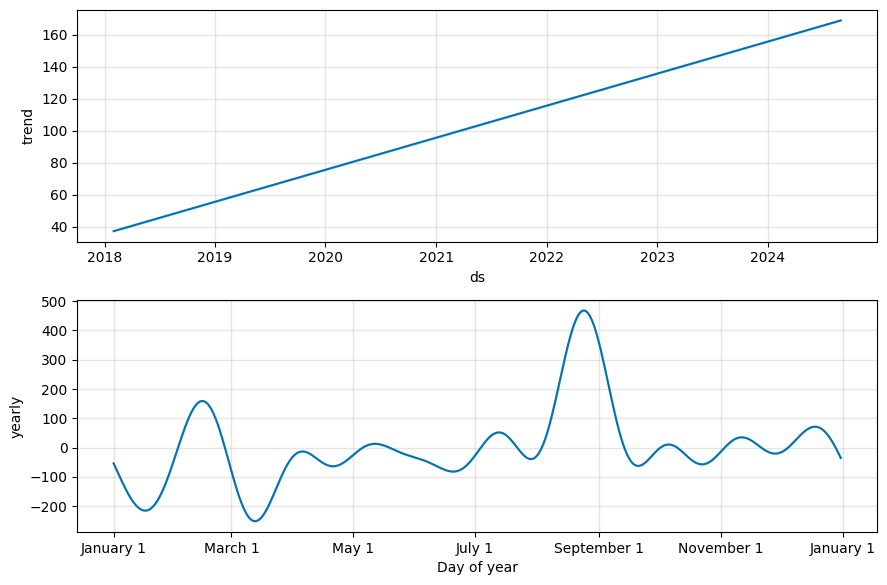

In [48]:
model.plot_components(forecast);

19:11:24 - cmdstanpy - INFO - Chain [1] start processing
19:11:24 - cmdstanpy - INFO - Chain [1] done processing
/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

19:11:24 - cmdstanpy - INFO - Chain [1] start processing
19:11:24 - cmdstanpy - INFO - Chain [1] done processing
/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

19:11:25 - cmdstanpy - INFO - Chain [1] start processing
19:11:25 - 

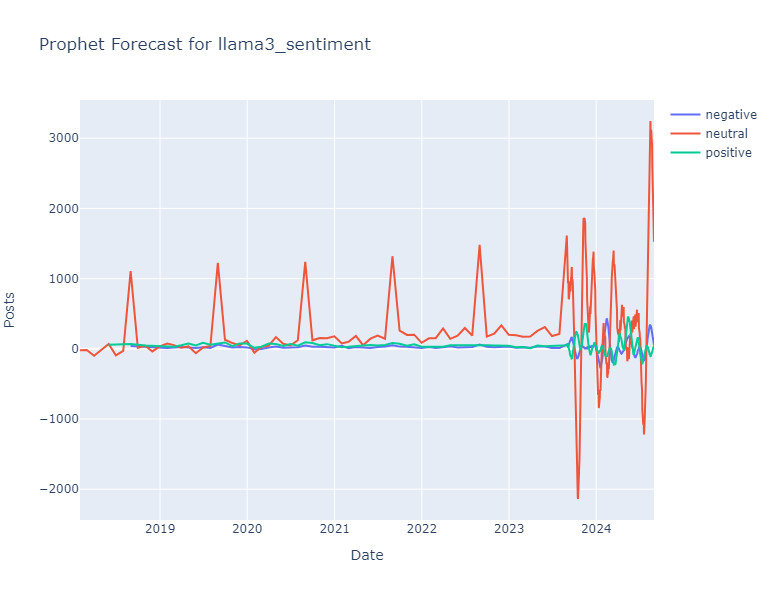

In [55]:
import pandas as pd
from prophet import Prophet
import plotly.graph_objects as go

# Assuming 'aggr_df' is already loaded and formatted correctly

# Get the unique values of 'llama3_sentiment'
unique_themes = aggr_df['llama3_sentiment'].unique()

# Create a figure for all unique 'llama3_sentiment' values
fig = go.Figure()

for keysector in unique_themes:
    # Filter the DataFrame for the current 'llama3_sentiment'
    df_subset = aggr_df[aggr_df['llama3_sentiment'] == keysector]

    # Reset the index and rename the columns as 'ds' and 'y' for Prophet
    df_subset = df_subset[['Date', 'Posts']].reset_index(drop=True)
    df_subset.columns = ['ds', 'y']

    # Remove the timezone information from the 'ds' column if necessary
    df_subset['ds'] = pd.to_datetime(df_subset['ds']).dt.tz_localize(None)

    # Check if there are at least two non-NaN rows
    if df_subset.dropna().shape[0] >= 2:
        # Create and fit the Prophet model
        model = Prophet(weekly_seasonality=True)
        try:
            model.fit(df_subset)

            # Generate future dates for forecasting
            future = model.make_future_dataframe(periods=365)

            # Make predictions
            forecast = model.predict(future)

            # Add a trace for the forecasted values with the corresponding 'llama3_sentiment' name
            fig.add_trace(go.Scatter(x=forecast['ds'], y=forecast['yhat'], name=keysector))
        except Exception as e:
            print(f"Error fitting model for {keysector}: {e}")
    else:
        print(f"Not enough data to fit model for {keysector}")

# Update layout for the graph
fig.update_layout(
    title='Prophet Forecast for llama3_sentiment',
    xaxis_title='Date',
    yaxis_title='Posts',
    height=600,
    width=800
)

# Show the graph
fig.show()


In [250]:
aggr_df

,llama3_sentiment,Date,Posts
0,negative,2018-08-31,24
1,negative,2019-01-31,3
2,negative,2019-02-28,4
3,negative,2019-03-31,19
4,negative,2019-04-30,17
...,...,...,...
178,positive,2023-03-31,1
179,positive,2023-04-30,3
180,positive,2023-05-31,2
181,positive,2023-06-30,12


19:41:25 - cmdstanpy - INFO - Chain [1] start processing
19:41:25 - cmdstanpy - INFO - Chain [1] done processing
19:41:25 - cmdstanpy - INFO - Chain [1] start processing
19:41:25 - cmdstanpy - INFO - Chain [1] done processing
19:41:25 - cmdstanpy - INFO - Chain [1] start processing
19:41:26 - cmdstanpy - INFO - Chain [1] done processing


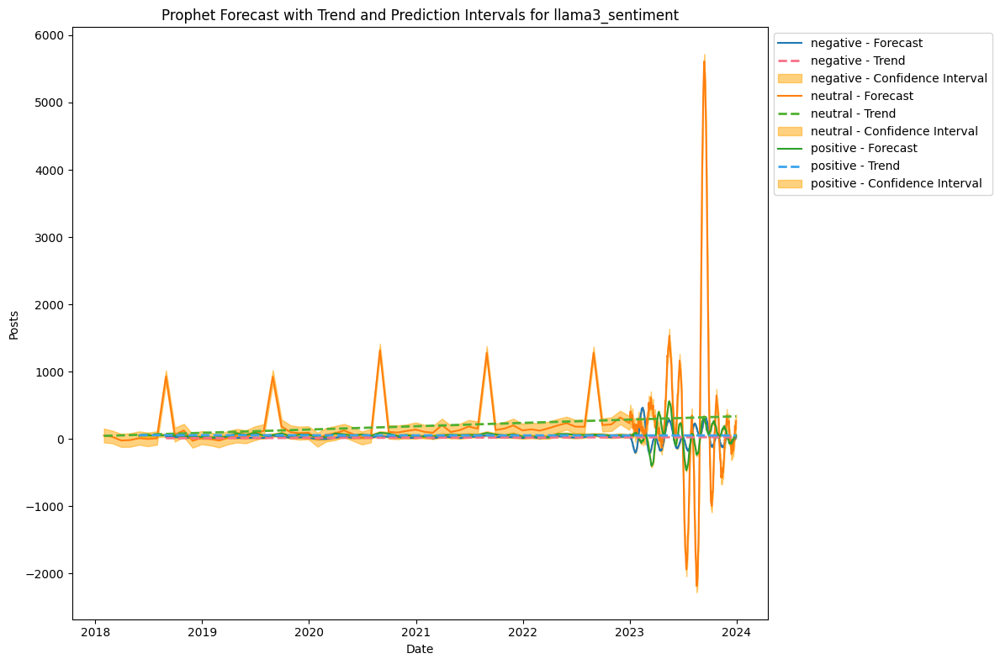

Metrics for negative:
MAE: 21.931698881729588
MSE: 1134.2993581023302
RMSE: 33.67936101089702
MAPE: 320.679709429662%
R-squared (R2): -1.178203280081287


Metrics for neutral:
MAE: 363.82876364465534
MSE: 489546.53447475395
RMSE: 699.6760210802954
MAPE: 85.49719577927115%
R-squared (R2): -0.03510095855299222


Metrics for positive:
MAE: 40.2556020595402
MSE: 1834.9130691995615
RMSE: 42.8358852972547
MAPE: 1675.1941012184677%
R-squared (R2): -2.420740389239785




In [29]:
import pandas as pd
from prophet import Prophet
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns  # Using seaborn for a color palette

# Assuming 'aggr_df' is already loaded and formatted correctly
aggr_df=monthly_OS.copy()
# Get the top 'llama3_sentiment' values
top_themes = aggr_df['llama3_sentiment'].unique()

# Initialize lists to store metrics
mae_list = []
mse_list = []
rmse_list = []
mape_list = []
r2_list = []

# Set up the Matplotlib figure
plt.figure(figsize=(12, 8))

# Generate a color palette for different trend lines
colors = sns.color_palette("husl", len(top_themes))

for i, theme in enumerate(top_themes):
    # Filter the DataFrame for the current 'llama3_sentiment'
    df_subset = aggr_df[aggr_df['llama3_sentiment'] == theme]

    # Reset the index and rename the columns as 'ds' and 'y' for Prophet
    df_subset = df_subset[['Date', 'Posts']].reset_index(drop=True)
    df_subset.columns = ['ds', 'y']

    # Remove the timezone information from the 'ds' column
    df_subset['ds'] = pd.to_datetime(df_subset['ds']).dt.tz_localize(None)

    # Split the data into training (first four years) and testing (last year)
    train_data = df_subset[df_subset['ds'] < '2023-01-01']  # Training: Before 2023
    test_data = df_subset[df_subset['ds'] >= '2023-01-01']  # Testing: 2023 data

    # Create a Prophet model with a weekly seasonality component for each 'llama3_sentiment'
    model = Prophet(weekly_seasonality=True)

    # Fit the model to the training data (first four years)
    model.fit(train_data)

    # Generate future dates for forecasting (next 365 days for the fifth year)
    future = model.make_future_dataframe(periods=365)

    # Make predictions for the entire period (training + prediction)
    forecast = model.predict(future)

    # Get the predicted values for the fifth year (2023)
    future_forecast = forecast[forecast['ds'] >= '2023-01-01']['yhat'].values

    # Use the actual data from the test period (2023) to calculate metrics
    actual_values = test_data['y'].values  # Actual data for 2023

    # Ensure the forecast length matches the actual data length
    future_forecast = future_forecast[:len(actual_values)]

    # Calculate performance metrics
    mae = np.mean(np.abs(future_forecast - actual_values))
    mse = np.mean((future_forecast - actual_values) ** 2)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((actual_values - future_forecast) / actual_values)) * 100
    r2 = 1 - (np.sum((actual_values - future_forecast) ** 2) / np.sum((actual_values - np.mean(actual_values)) ** 2))

    # Append metrics to the lists
    mae_list.append(mae)
    mse_list.append(mse)
    rmse_list.append(rmse)
    mape_list.append(mape)
    r2_list.append(r2)

    # Extract trend, lower bound, and upper bound for the forecast
    trend = forecast['trend'].values
    lower_bound = forecast['yhat_lower'].values  # Lower boundary
    upper_bound = forecast['yhat_upper'].values  # Upper boundary

    # Plot the forecasted values
    plt.plot(forecast['ds'], forecast['yhat'], label=f'{theme} - Forecast', zorder=3)

    # Plot the trend line with a unique color from the palette
    plt.plot(forecast['ds'], trend, label=f'{theme} - Trend', linestyle='--', color=colors[i], linewidth=2, zorder=4)

    # Plot the uncertainty interval (upper and lower bounds) with a more visible color and increased alpha
    plt.fill_between(forecast['ds'], lower_bound, upper_bound, color='orange', alpha=0.5, label=f'{theme} - Confidence Interval', zorder=1)

# Set the title and labels
plt.title('Prophet Forecast with Trend and Prediction Intervals for llama3_sentiment')
plt.xlabel('Date')
plt.ylabel('Posts')

# Show legend
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

# Print the performance metrics for each theme
for i, theme in enumerate(top_themes):
    print(f'Metrics for {theme}:')
    print(f'MAE: {mae_list[i]}')
    print(f'MSE: {mse_list[i]}')
    print(f'RMSE: {rmse_list[i]}')
    print(f'MAPE: {mape_list[i]}%')
    print(f'R-squared (R2): {r2_list[i]}')
    print('\n')


In [252]:
aggr_df.shape

(183, 3)

Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=417.308, Time=0.20 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=412.408, Time=0.00 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=412.593, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=412.284, Time=0.01 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=473.800, Time=0.00 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=414.215, Time=0.02 sec
 ARIMA(0,0,2)(0,0,0)[0] intercept   : AIC=414.188, Time=0.02 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=416.185, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=451.645, Time=0.01 sec

Best model:  ARIMA(0,0,1)(0,0,0)[0] intercept
Total fit time: 0.393 seconds
Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=869.188, Time=0.07 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=863.577, Time=0.00 sec


/tmp/ipykernel_723867/855970259.py:54: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_data['trend'] = train_data['y'].rolling(window=12, min_periods=1).mean()
/tmp/ipykernel_723867/855970259.py:54: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_data['trend'] = train_data['y'].rolling(window=12, min_periods=1).mean()


 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=865.553, Time=0.01 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=865.555, Time=0.02 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=880.424, Time=0.00 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=867.546, Time=0.02 sec

Best model:  ARIMA(0,0,0)(0,0,0)[0] intercept
Total fit time: 0.127 seconds
Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.06 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=480.667, Time=0.00 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=465.123, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=470.560, Time=0.01 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=566.732, Time=0.00 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=466.531, Time=0.03 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=466.650, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=468.514, Time=0.05 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=473.992, Time=0.01 sec

Best model:  ARIMA(1,0,0)(0,0,0)[0] in

/tmp/ipykernel_723867/855970259.py:54: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_data['trend'] = train_data['y'].rolling(window=12, min_periods=1).mean()


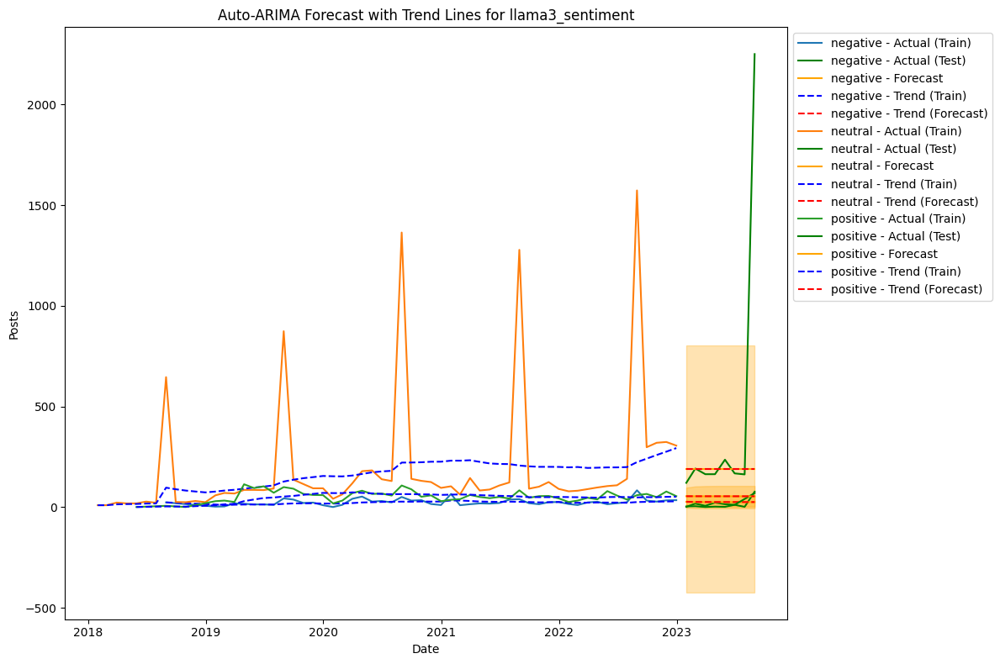

Metrics for negative:
MAE: 19.055325011872945
MSE: 566.6380231412637
RMSE: 23.80415978650084
MAPE: 374.46739506502354%
R-squared (R2): -0.0881191034877844


Metrics for neutral:
MAE: 284.69166666666666
MSE: 531743.8544444443
RMSE: 729.2076895126959
MAPE: 28.743981637639177%
R-squared (R2): -0.12432329651899887


Metrics for positive:
MAE: 45.09170613957105
MSE: 2189.3324878841404
RMSE: 46.79030335319638
MAPE: 1759.8585590958514%
R-squared (R2): -3.0814675051865352




In [30]:
import pandas as pd
import matplotlib.pyplot as plt
from pmdarima.arima import auto_arima
from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error, r2_score
import numpy as np

# Assuming 'aggr_df' is already loaded and formatted correctly
aggr_df = monthly_os.copy()

# Get the top ten common themes based on the count (using unique sentiments in this case)
top_ten_themes = aggr_df['llama3_sentiment'].unique()

# Initialize lists to store metrics
mae_list = []
mse_list = []
rmse_list = []
mape_list = []
r2_list = []

# Set up the Matplotlib figure
plt.figure(figsize=(12, 8))

for theme in top_ten_themes:
    # Filter the DataFrame for the current theme
    df_subset = aggr_df[aggr_df['llama3_sentiment'] == theme]

    # Reset the index and rename the columns as 'ds' and 'y' for fitting the ARIMA model
    df_subset = df_subset.reset_index(drop=True)
    df_subset = df_subset[['Date', 'Posts']]  # Select the relevant columns
    df_subset.columns = ['ds', 'y']

    # Remove the timezone information from the 'ds' column
    df_subset['ds'] = pd.to_datetime(df_subset['ds']).dt.tz_localize(None)

    # Split the data into training (first 4 years) and testing (last 1 year)
    train_data = df_subset[df_subset['ds'] < '2023-01-01']
    test_data = df_subset[df_subset['ds'] >= '2023-01-01']

    # Fit an Auto-ARIMA model to the training data (first 4 years)
    model = auto_arima(train_data['y'], seasonal=True, stepwise=True, trace=True)

    # Forecast for the length of the test data (last year)
    forecast, conf_int = model.predict(n_periods=len(test_data), return_conf_int=True)

    # Store the forecast in a DataFrame
    forecast_df = pd.DataFrame({
        'ds': test_data['ds'],  # Use the same dates as in the test data
        'yhat': forecast,
        'yhat_lower': conf_int[:, 0],
        'yhat_upper': conf_int[:, 1]
    })

    # Calculate rolling average (trend) for training and forecasted data (window=12 for monthly trends)
    train_data['trend'] = train_data['y'].rolling(window=12, min_periods=1).mean()
    forecast_df['trend'] = forecast_df['yhat'].rolling(window=12, min_periods=1).mean()

    # Plot the actual and forecasted values
    plt.plot(train_data['ds'], train_data['y'], label=f'{theme} - Actual (Train)')
    plt.plot(test_data['ds'], test_data['y'], label=f'{theme} - Actual (Test)', color='green')
    plt.plot(forecast_df['ds'], forecast_df['yhat'], label=f'{theme} - Forecast', color='orange')

    # Plot the trend lines for both training and forecast
    plt.plot(train_data['ds'], train_data['trend'], label=f'{theme} - Trend (Train)', linestyle='--', color='blue')
    plt.plot(forecast_df['ds'], forecast_df['trend'], label=f'{theme} - Trend (Forecast)', linestyle='--', color='red')

    # Plot confidence intervals
    plt.fill_between(forecast_df['ds'], forecast_df['yhat_lower'], forecast_df['yhat_upper'], color='orange', alpha=0.3)

    # Calculate performance metrics
    actual_values = test_data['y'].values  # Actual values from the last year
    mae = mean_absolute_error(actual_values, forecast)
    mse = mean_squared_error(actual_values, forecast)
    rmse = np.sqrt(mse)
    mape = mean_absolute_percentage_error(actual_values, forecast) * 100
    r2 = r2_score(actual_values, forecast)

    # Append metrics to the lists
    mae_list.append(mae)
    mse_list.append(mse)
    rmse_list.append(rmse)
    mape_list.append(mape)
    r2_list.append(r2)

# Set the title and labels
plt.title('Auto-ARIMA Forecast with Trend Lines for llama3_sentiment')
plt.xlabel('Date')
plt.ylabel('Posts')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))

# Adjust layout to fit everything
plt.tight_layout()

# Show the plot
plt.show()

# Print the performance metrics for each theme
for i, theme in enumerate(top_ten_themes):
    print(f'Metrics for {theme}:')
    print(f'MAE: {mae_list[i]}')
    print(f'MSE: {mse_list[i]}')
    print(f'RMSE: {rmse_list[i]}')
    print(f'MAPE: {mape_list[i]}%')
    print(f'R-squared (R2): {r2_list[i]}')
    print('\n')


In [53]:
aggr_df.shape

(183, 3)

2024-09-12 19:44:04.744788: I tensorflow/core/common_runtime/process_util.cc:146] Creating new thread pool with default inter op setting: 2. Tune using inter_op_parallelism_threads for best performance.


Training model for theme negative...
Epoch 1/50


2024-09-12 19:44:05.105177: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-12 19:44:05.106071: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-12 19:44:05.106711: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step - loss: 0.1708
Epoch 2/50
1/1 [==============================] - 0s 6ms/step - loss: 0.1503
Epoch 3/50
1/1 [==============================] - 0s 6ms/step - loss: 0.1324
Epoch 4/50
1/1 [==============================] - 0s 5ms/step - loss: 0.1164
Epoch 5/50
1/1 [==============================] - 0s 5ms/step - loss: 0.1022
Epoch 6/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0894
Epoch 7/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0778
Epoch 8/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0674
Epoch 9/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0582
Epoch 10/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0503
Epoch 11/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0440
Epoch 12/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0396
Epoch 13/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0375
Epoch 1

2024-09-12 19:44:06.959176: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-12 19:44:06.960178: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-12 19:44:06.960910: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 0s 12ms/step
Training model for theme neutral...
Epoch 1/50


2024-09-12 19:44:18.094301: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-12 19:44:18.095164: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-12 19:44:18.095858: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step - loss: 0.0413
Epoch 2/50
1/1 [==============================] - 0s 13ms/step - loss: 0.0389
Epoch 3/50
1/1 [==============================] - 0s 11ms/step - loss: 0.0368
Epoch 4/50
1/1 [==============================] - 0s 10ms/step - loss: 0.0350
Epoch 5/50
1/1 [==============================] - 0s 10ms/step - loss: 0.0335
Epoch 6/50
1/1 [==============================] - 0s 10ms/step - loss: 0.0324
Epoch 7/50
1/1 [==============================] - 0s 11ms/step - loss: 0.0317
Epoch 8/50
1/1 [==============================] - 0s 10ms/step - loss: 0.0315
Epoch 9/50
1/1 [==============================] - 0s 10ms/step - loss: 0.0318
Epoch 10/50
1/1 [==============================] - 0s 10ms/step - loss: 0.0323
Epoch 11/50
1/1 [==============================] - 0s 11ms/step - loss: 0.0326
Epoch 12/50
1/1 [==============================] - 0s 11ms/step - loss: 0.0326
Epoch 13/50
1/1 [==============================] - 0s 11ms/step - loss: 0.

2024-09-12 19:44:20.037094: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-12 19:44:20.038071: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-12 19:44:20.038795: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 0s 12ms/step
Training model for theme positive...
Epoch 1/50


2024-09-12 19:44:30.800149: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-12 19:44:30.801035: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-12 19:44:30.801672: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 949ms/step - loss: 0.1836
Epoch 2/50
1/1 [==============================] - 0s 6ms/step - loss: 0.1543
Epoch 3/50
1/1 [==============================] - 0s 6ms/step - loss: 0.1277
Epoch 4/50
1/1 [==============================] - 0s 5ms/step - loss: 0.1038
Epoch 5/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0824
Epoch 6/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0638
Epoch 7/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0482
Epoch 8/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0361
Epoch 9/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0283
Epoch 10/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0257
Epoch 11/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0283
Epoch 12/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0344
Epoch 13/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0396
Epoc

2024-09-12 19:44:32.230346: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-12 19:44:32.231351: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-12 19:44:32.232119: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 0s 12ms/step


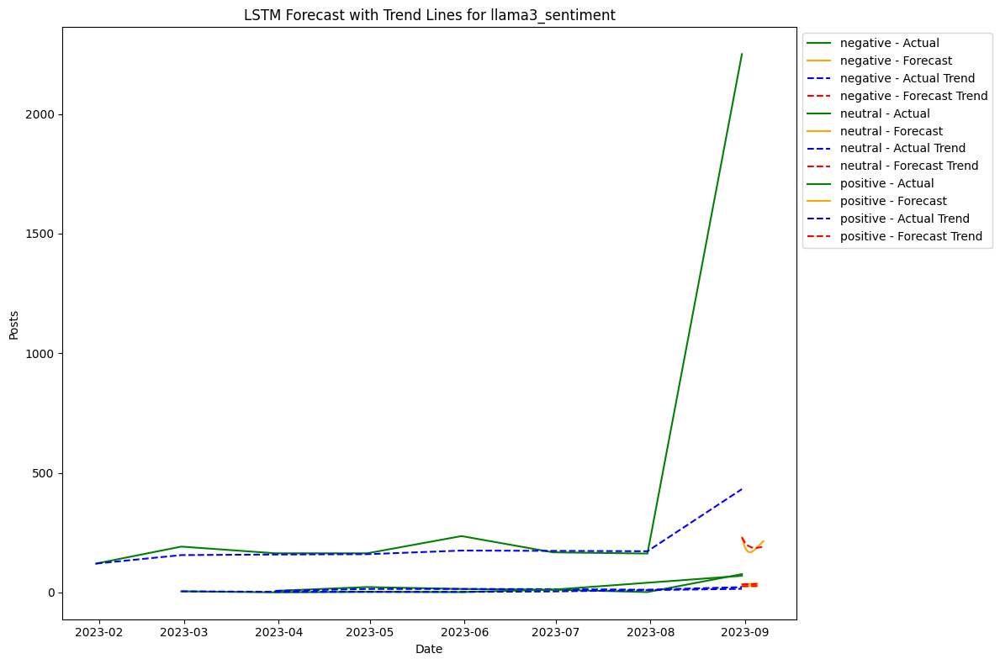

Cleaned Theme: negative
Mean Absolute Error (MAE): 20.806472778320312
Mean Squared Error (MSE): 642.3497690773316
Root Mean Squared Error (RMSE): 25.344620120990797
Mean Absolute Percentage Error (MAPE): 304.83948161337406%
R-squared (R2): -0.014948722207862808

Cleaned Theme: neutral
Mean Absolute Error (MAE): 284.8951225280762
Mean Squared Error (MSE): 520026.01850944216
Root Mean Squared Error (RMSE): 721.1282954575018
Mean Absolute Percentage Error (MAPE): 31.394169284334804%
R-squared (R2): -0.09954701407324307

Cleaned Theme: positive
Mean Absolute Error (MAE): 31.35357411702474
Mean Squared Error (MSE): 993.876111454602
Root Mean Squared Error (RMSE): 31.52580072662076
Mean Absolute Percentage Error (MAPE): 1176.8310748206245%
R-squared (R2): -0.6375824986207914



In [31]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error, r2_score
import tensorflow as tf

# Assuming 'aggr_df' is loaded correctly
aggr_df = monthly_os.copy()

# Get the top 10 themes based on the number of posts
unique_themes = aggr_df['llama3_sentiment'].unique()

# Initialize lists to store metrics
mae_list = []
mse_list = []
rmse_list = []
mape_list = []
r2_list = []

look_back = 30

# Set up the Matplotlib figure
plt.figure(figsize=(12, 8))

for theme in unique_themes:
    df_subset = aggr_df[aggr_df['llama3_sentiment'] == theme].reset_index(drop=True)
    df_subset['Date'] = pd.to_datetime(df_subset['Date']).dt.tz_localize(None)

    scaler = MinMaxScaler()
    df_subset['Posts'] = scaler.fit_transform(df_subset[['Posts']].values)

    X, y = [], []
    for i in range(look_back, len(df_subset)):
        X.append(df_subset['Posts'].values[i - look_back:i])
        y.append(df_subset['Posts'].values[i])

    if len(X) < 1:  # Ensure there is enough data to train
        print(f"Not enough data for training on theme {theme}. Skipping...")
        continue

    X, y = np.array(X), np.array(y)
    X = X.reshape((X.shape[0], X.shape[1], 1))

    # Train-test split
    split_index = int(0.8 * len(X))
    X_train, X_test, y_train, y_test = X[:split_index], X[split_index:], y[:split_index], y[split_index:]

    # Continue only if there is training data
    if X_train.shape[0] > 0:
        model = Sequential([
            LSTM(50, input_shape=(look_back, 1)),
            Dense(1)
        ])
        model.compile(optimizer='adam', loss='mean_squared_error')

        print(f'Training model for theme {theme}...')

        # Fit model
        model.fit(X_train, y_train, epochs=50, batch_size=32, verbose=1)

        # Forecasting the next 365 days
        future_X = df_subset['Posts'].values[-look_back:].reshape(1, look_back, 1)
        future_preds = []
        for _ in range(365):
            future_pred = model.predict(future_X)
            future_preds.append(future_pred[0][0])
            future_X = np.append(future_X[:, 1:, :], future_pred.reshape(1, 1, 1), axis=1)

        future_preds = scaler.inverse_transform(np.array(future_preds).reshape(-1, 1)).flatten()

        # Adjust the length of actual_values and future_preds to match
        actual_values = scaler.inverse_transform(y_test.reshape(-1, 1)).flatten()
        min_length = min(len(actual_values), len(future_preds))
        actual_values = actual_values[:min_length]
        future_preds = future_preds[:min_length]

        # Calculate performance metrics based on the matching lengths of actual data and forecasted values
        mae = mean_absolute_error(actual_values, future_preds)
        mse = mean_squared_error(actual_values, future_preds)
        rmse = np.sqrt(mse)
        mape = mean_absolute_percentage_error(actual_values, future_preds) * 100
        r2 = r2_score(actual_values, future_preds)

        # Store metrics
        mae_list.append(mae)
        mse_list.append(mse)
        rmse_list.append(rmse)
        mape_list.append(mape)
        r2_list.append(r2)

        # Calculate rolling average (trend) for actual and predicted values
        actual_trend = pd.Series(actual_values).rolling(window=12, min_periods=1).mean()
        future_trend = pd.Series(future_preds).rolling(window=12, min_periods=1).mean()

        # Plot actual and predicted values
        future_dates = pd.date_range(start=df_subset['Date'].iloc[-1], periods=len(future_preds), freq='D')
        plt.plot(df_subset['Date'][split_index + look_back:split_index + look_back + len(actual_values)], actual_values, label=f'{theme} - Actual', color='green')
        plt.plot(future_dates, future_preds, label=f'{theme} - Forecast', color='orange')

        # Plot trend lines for both actual and forecasted values
        plt.plot(df_subset['Date'][split_index + look_back:split_index + look_back + len(actual_values)], actual_trend, label=f'{theme} - Actual Trend', linestyle='--', color='blue')
        plt.plot(future_dates, future_trend, label=f'{theme} - Forecast Trend', linestyle='--', color='red')

    else:
        print(f"Not enough data for theme {theme} after look-back period.")

# Set the title and labels
plt.title('LSTM Forecast with Trend Lines for llama3_sentiment')
plt.xlabel('Date')
plt.ylabel('Posts')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))

# Adjust layout to fit everything
plt.tight_layout()

# Show the plot
plt.show()

# Display performance metrics
for i, theme in enumerate(unique_themes):
    if i < len(mae_list):  # Check if metrics were computed
        print(f'Cleaned Theme: {theme}')
        print(f'Mean Absolute Error (MAE): {mae_list[i]}')
        print(f'Mean Squared Error (MSE): {mse_list[i]}')
        print(f'Root Mean Squared Error (RMSE): {rmse_list[i]}')
        print(f'Mean Absolute Percentage Error (MAPE): {mape_list[i]}%')
        print(f'R-squared (R2): {r2_list[i]}')
        print()
    else:
        print(f'Insufficient data to compute metrics for theme: {theme}')


In [64]:
df.shape

(19182, 66)

In [38]:
aggr_df.shape

(183, 2)

Lengths of each series:
llama3_sentiment
negative    57
neutral     68
positive    58
dtype: int64
Valid themes (with sufficient data): ['negative', 'neutral', 'positive']
Processing theme: negative


100%|██████████| 50/50 [00:01<00:00, 30.03it/s, epoch=10/10, avg_epoch_loss=2.41]


Processing theme: neutral


100%|██████████| 50/50 [00:01<00:00, 28.26it/s, epoch=10/10, avg_epoch_loss=3.97]


Processing theme: positive


100%|██████████| 50/50 [00:01<00:00, 32.46it/s, epoch=10/10, avg_epoch_loss=3.43]


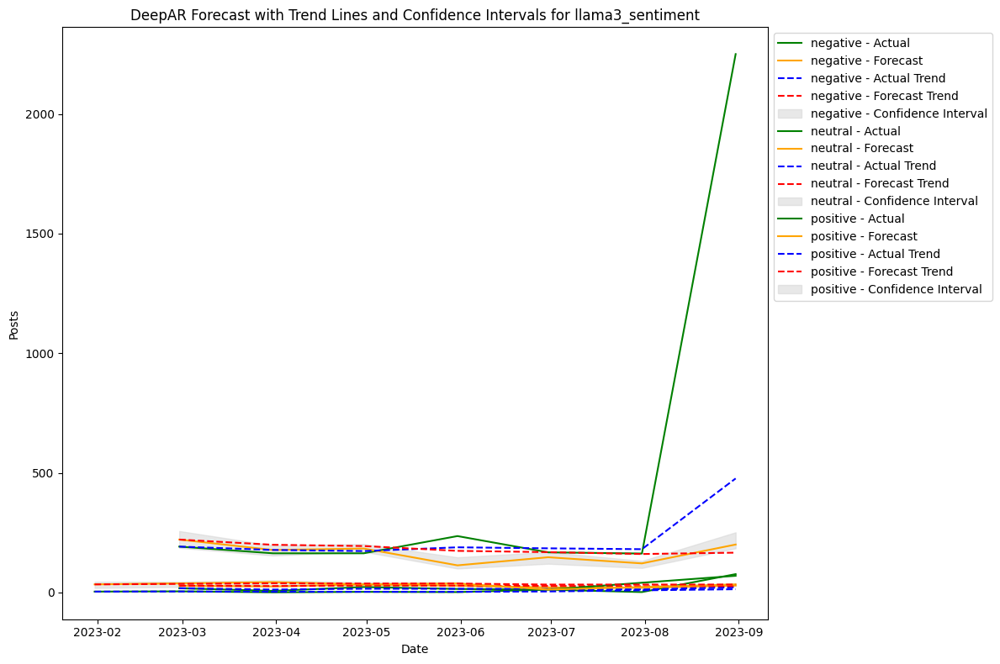

Theme: negative
MAE: 18.34673990522112
MSE: 488.55785791526483
RMSE: 22.103344948565248
MAPE: 216.43%
R-squared (R2): 0.103798508644104

Theme: neutral
MAE: 328.0560858590262
MSE: 602638.0057275392
RMSE: 776.2976270268634
MAPE: 30.88%
R-squared (R2): -0.14855420589447021

Theme: positive
MAE: 29.947696685791016
MSE: 1056.259976781441
RMSE: 32.500153488582804
MAPE: 1224.35%
R-squared (R2): -0.9691349267959595



In [42]:
import pandas as pd
import numpy as np
from gluonts.dataset.common import ListDataset
from gluonts.mx.model.deepar import DeepAREstimator
from gluonts.mx.trainer import Trainer
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import matplotlib.pyplot as plt

# Assuming 'aggr_df' is already loaded and contains 'Date', 'llama3_sentiment', and 'Posts'
aggr_df = monthly_OS.copy()

# Convert 'Date' column to datetime and set it as index
aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])
aggr_df.set_index('Date', inplace=True)

# Define reduced context and prediction lengths
context_length = 30  # 1 month of context
prediction_length = 7  # 1 week of prediction
freq = 'D'  # Daily frequency

# Filter out series with insufficient data (less than context + prediction length)
min_required_length = context_length + prediction_length

# Check the lengths of each series
series_lengths = aggr_df.groupby('llama3_sentiment').apply(len)
print("Lengths of each series:")
print(series_lengths)

# Filter valid themes
valid_themes = series_lengths[series_lengths >= min_required_length].index.tolist()
print(f"Valid themes (with sufficient data): {valid_themes}")

# Initialize lists to store performance metrics
mae_list = []
mse_list = []
rmse_list = []
mape_list = []
r2_list = []

# Plotting setup
plt.figure(figsize=(12, 8))

# Process each valid theme
for theme in valid_themes:
    print(f"Processing theme: {theme}")

    # Filter the DataFrame for the current 'llama3_sentiment'
    df_subset = aggr_df[aggr_df['llama3_sentiment'] == theme]['Posts'].to_frame()
    df_subset.rename(columns={'Posts': 'y'}, inplace=True)

    # Ensure the subset has enough data for both context and prediction
    if len(df_subset) >= min_required_length:
        # Split data into training and prediction
        train_data = ListDataset(
            [{"start": df_subset.index[0], "target": df_subset.y[:-prediction_length]}],
            freq=freq
        )

        # Define and train the DeepAR estimator
        estimator = DeepAREstimator(
            prediction_length=prediction_length,
            context_length=context_length,
            freq=freq,
            trainer=Trainer(epochs=10)
        )
        predictor = estimator.train(training_data=train_data)

        # Generate forecasts
        test_data = ListDataset(
            [{"start": df_subset.index[-prediction_length], "target": df_subset.y[-context_length:].tolist()}],
            freq=freq
        )

        forecast = list(predictor.predict(test_data))
        forecast_values = np.array([f.mean for f in forecast]).flatten()
        lower_bound = np.array([f.quantile(0.025) for f in forecast]).flatten()  # 2.5th percentile (lower bound)
        upper_bound = np.array([f.quantile(0.975) for f in forecast]).flatten()  # 97.5th percentile (upper bound)

        # Extract actual values for the prediction period
        actual_values = df_subset.y.values[-prediction_length:]

        # Calculate performance metrics
        mae = mean_absolute_error(actual_values, forecast_values)
        mse = mean_squared_error(actual_values, forecast_values)
        rmse = np.sqrt(mse)
        mape = np.mean(np.abs((actual_values - forecast_values) / actual_values)) * 100
        r2 = r2_score(actual_values, forecast_values)

        # Append metrics to the respective lists
        mae_list.append(mae)
        mse_list.append(mse)
        rmse_list.append(rmse)
        mape_list.append(mape)
        r2_list.append(r2)

        # Calculate rolling averages (trend lines) for actual and predicted values
        actual_trend = pd.Series(actual_values).rolling(window=7, min_periods=1).mean()  # Trend for actual data
        forecast_trend = pd.Series(forecast_values).rolling(window=7, min_periods=1).mean()  # Trend for forecast data

        # Plot actual and forecasted values
        plt.plot(df_subset.index[-prediction_length:], actual_values, label=f'{theme} - Actual', color='green')
        plt.plot(df_subset.index[-prediction_length:], forecast_values, label=f'{theme} - Forecast', color='orange')

        # Plot trend lines for both actual and forecasted data
        plt.plot(df_subset.index[-prediction_length:], actual_trend, label=f'{theme} - Actual Trend', linestyle='--', color='blue')
        plt.plot(df_subset.index[-prediction_length:], forecast_trend, label=f'{theme} - Forecast Trend', linestyle='--', color='red')

        # Plot confidence intervals (upper and lower bounds)
        plt.fill_between(df_subset.index[-prediction_length:], lower_bound, upper_bound, color='lightgray', alpha=0.5, label=f'{theme} - Confidence Interval')

    else:
        print(f"Skipping {theme}: insufficient data.")

# Set the title and labels for the plot
plt.title('DeepAR Forecast with Trend Lines and Confidence Intervals for llama3_sentiment')
plt.xlabel('Date')
plt.ylabel('Posts')

# Ensure that labels are only placed for valid data
if valid_themes:
    plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
else:
    print("No valid data for plotting.")

# Adjust layout to fit everything
plt.tight_layout()

# Show the plot
plt.show()

# Print the performance metrics for each 'llama3_sentiment'
for i, theme in enumerate(valid_themes):
    print(f'Theme: {theme}')
    print(f'MAE: {mae_list[i]}')
    print(f'MSE: {mse_list[i]}')
    print(f'RMSE: {rmse_list[i]}')
    print(f'MAPE: {mape_list[i]:.2f}%')
    print(f'R-squared (R2): {r2_list[i]}')
    print()


100%|██████████| 50/50 [00:01<00:00, 47.55it/s, epoch=10/10, avg_epoch_loss=3.85]


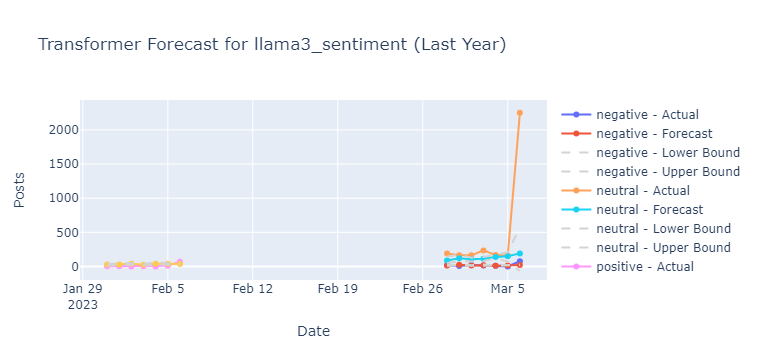

Theme: negative
MAE: 14.163399696350098
MSE: 485.0607851853847
RMSE: 22.024095558850647
MAPE: 145.04%
R-squared (R2): 0.1102135181427002

Theme: neutral
MAE: 346.0111203874861
MSE: 609302.6698012348
RMSE: 780.578420020202
MAPE: 40.23%
R-squared (R2): -0.1612560749053955

Theme: positive
MAE: 30.619650432041713
MSE: 978.3906732406348
RMSE: 31.27923709492664
MAPE: 1160.16%
R-squared (R2): -0.8239669799804688



In [57]:
import pandas as pd
import numpy as np
from gluonts.dataset.common import ListDataset
from gluonts.mx.model.transformer import TransformerEstimator
from gluonts.mx.trainer import Trainer
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import plotly.graph_objects as go
import plotly.offline as pyo

# Assuming aggr_df is loaded and contains 'Date', 'llama3_sentiment', and 'Posts'
aggr_df = monthly_OS.copy()

# Convert the 'Date' column to datetime and set as the index
aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])
aggr_df.set_index('Date', inplace=True)

# Define reduced context and prediction lengths
context_length = 30  # 1 month of context
prediction_length = 7  # 1 week of prediction
freq = 'D'  # Daily frequency

# Get unique 'llama3_sentiment' values
unique_themes = aggr_df['llama3_sentiment'].unique()

# Initialize lists to store performance metrics and track valid themes
mae_list = []
mse_list = []
rmse_list = []
mape_list = []
r2_list = []
processed_themes = []

# Create a figure for all themes using Plotly
fig = go.Figure()

for theme in unique_themes:
    # Filter the DataFrame for the current 'llama3_sentiment'
    df_subset = aggr_df[aggr_df['llama3_sentiment'] == theme]

    # Ensure there's enough data for training and prediction
    if len(df_subset) >= (context_length + prediction_length):
        # Select only the Date and Posts columns
        df_subset = df_subset.reset_index()[['Date', 'Posts']]
        df_subset.columns = ['ds', 'y']

        # Remove timezone information from the 'ds' column
        df_subset['ds'] = df_subset['ds'].dt.tz_localize(None)

        # Check if there's enough data to safely slice for context and prediction
        if len(df_subset) >= (context_length + prediction_length):
            # Training data (everything except the last `prediction_length` days)
            train_data = ListDataset(
                [{"start": df_subset['ds'][0], "target": df_subset['y'][:-prediction_length].values}],
                freq=freq
            )

            # Define and train the Transformer estimator
            estimator = TransformerEstimator(
                prediction_length=prediction_length,
                context_length=context_length,
                freq=freq,  # Specify the frequency here
                trainer=Trainer(epochs=10)
            )
            predictor = estimator.train(training_data=train_data)

            # Testing data (context_length + prediction_length from the end)
            test_data_start = len(df_subset) - (context_length + prediction_length)

            test_data = ListDataset(
                [{"start": df_subset['ds'][test_data_start], "target": df_subset['y'][test_data_start:-prediction_length].tolist()}],
                freq=freq
            )

            # Generate forecasts for the current theme
            forecast = list(predictor.predict(test_data))[0]
            forecast_values = forecast.mean[:prediction_length]
            lower_bound = forecast.quantile(0.025)[:prediction_length]  # 2.5th percentile (lower bound)
            upper_bound = forecast.quantile(0.975)[:prediction_length]  # 97.5th percentile (upper bound)

            # Extract actual values for the last `prediction_length` days
            actual_values = df_subset['y'][-prediction_length:].values

            # Calculate performance metrics
            mae = mean_absolute_error(actual_values, forecast_values)
            mse = mean_squared_error(actual_values, forecast_values)
            rmse = np.sqrt(mse)
            mape = np.mean(np.abs((actual_values - forecast_values) / actual_values)) * 100
            r2 = r2_score(actual_values, forecast_values)

            # Append metrics to the respective lists
            mae_list.append(mae)
            mse_list.append(mse)
            rmse_list.append(rmse)
            mape_list.append(mape)
            r2_list.append(r2)

            # Track successfully processed themes
            processed_themes.append(theme)

            # Plot the actual and forecasted values using Plotly
            dates = pd.date_range(start=df_subset['ds'].iloc[-prediction_length], periods=prediction_length, freq=freq)
            fig.add_trace(go.Scatter(x=dates, y=actual_values, mode='lines+markers', name=f'{theme} - Actual'))
            fig.add_trace(go.Scatter(x=dates, y=forecast_values, mode='lines+markers', name=f'{theme} - Forecast'))

            # Plot the confidence intervals (upper and lower bounds)
            fig.add_trace(go.Scatter(x=dates, y=lower_bound, mode='lines', name=f'{theme} - Lower Bound', line=dict(dash='dash', color='lightgray')))
            fig.add_trace(go.Scatter(x=dates, y=upper_bound, mode='lines', name=f'{theme} - Upper Bound', line=dict(dash='dash', color='lightgray')))

        else:
            print(f"Skipping {theme}: insufficient data for context and prediction.")
    else:
        print(f"Skipping {theme}: insufficient data.")

# Update layout for the graph using Plotly
fig.update_layout(
    title='Transformer Forecast for llama3_sentiment (Last Year)',
    xaxis_title='Date',
    yaxis_title='Posts',
    showlegend=True
)

# Show the graph using Plotly
pyo.iplot(fig)

# Print the performance metrics for each successfully processed theme
for i, theme in enumerate(processed_themes):
    print(f'Theme: {theme}')
    print(f'MAE: {mae_list[i]}')
    print(f'MSE: {mse_list[i]}')
    print(f'RMSE: {rmse_list[i]}')
    print(f'MAPE: {mape_list[i]:.2f}%')
    print(f'R-squared (R2): {r2_list[i]}')
    print()


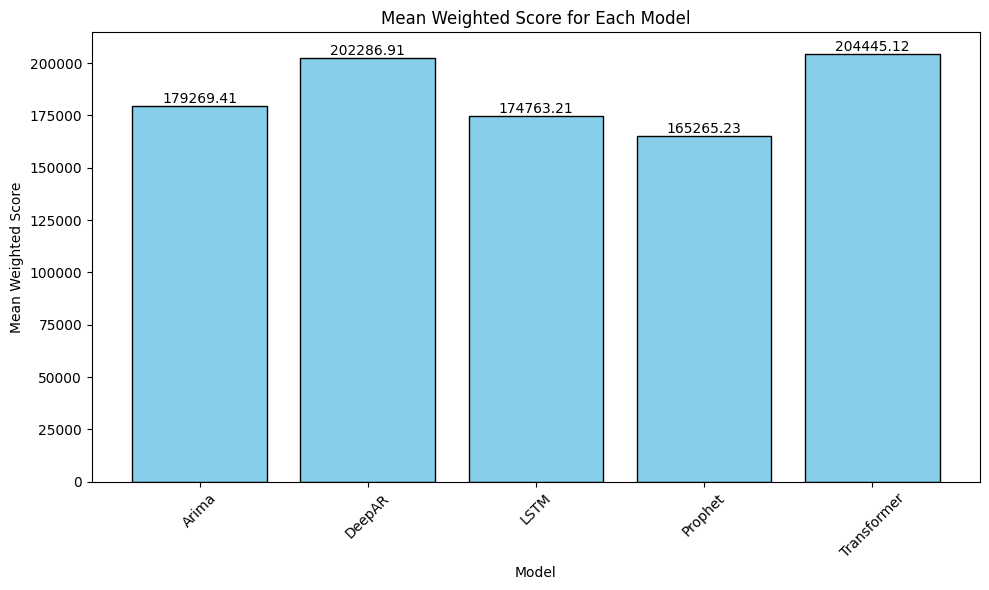

In [126]:
import pandas as pd
import matplotlib.pyplot as plt

# Define the metrics for each model and theme
data = {
    "Model": ["Prophet", "Prophet", "Prophet", "Arima", "Arima", "Arima", 
              "LSTM", "LSTM", "LSTM", "DeepAR", "DeepAR", "DeepAR", 
              "Transformer", "Transformer", "Transformer"],
    "Theme": ["negative", "neutral", "positive", "negative", "neutral", "positive", 
              "negative", "neutral", "positive", "negative", "neutral", "positive", 
              "negative", "neutral", "positive"],
    "MAE": [21.93, 363.83, 40.26, 19.06, 284.69, 45.09, 20.81, 284.90, 31.35, 
            18.35, 328.06, 29.95, 14.16, 346.01, 30.62],
    "MSE": [1134.30, 489546.53, 1834.91, 566.64, 531743.85, 2189.33, 642.35, 
            520026.02, 993.88, 488.56, 602638.01, 1056.26, 485.06, 609302.67, 978.39],
    "RMSE": [33.68, 699.68, 42.84, 23.80, 729.21, 46.79, 25.34, 721.13, 31.53, 
             22.10, 776.30, 32.50, 22.02, 780.58, 31.28],
    "MAPE": [320.68, 85.50, 1675.19, 374.47, 28.74, 1759.86, 304.84, 31.39, 
             1176.83, 216.43, 30.88, 1224.35, 145.04, 40.23, 1160.16],
    "R-squared": [-1.18, -0.04, -2.42, -0.09, -0.12, -3.08, -0.01, -0.10, -0.64, 
                  0.10, -0.15, -0.97, 0.11, -0.16, -0.82]
}

# Create the DataFrame
df_metrics = pd.DataFrame(data)

# Calculate the weighted score for each model
df_metrics["Weighted Score"] = df_metrics["MAE"] + df_metrics["MSE"] + df_metrics["RMSE"] + df_metrics["MAPE"] + df_metrics["R-squared"]

# Group by model to get the mean score for each model
model_means = df_metrics.groupby("Model")["Weighted Score"].mean().reset_index()

# Plot the mean score for each model
plt.figure(figsize=(10, 6))
plt.bar(model_means['Model'], model_means['Weighted Score'], color='skyblue', edgecolor='black')

# Add the mean weighted score as text on top of each bar
for index, row in model_means.iterrows():
    plt.text(row['Model'], row['Weighted Score'], round(row['Weighted Score'], 2), ha='center', va='bottom')

plt.title('Mean Weighted Score for Each Model')
plt.xlabel('Model')
plt.ylabel('Mean Weighted Score')
plt.xticks(rotation=45)
plt.tight_layout()

# Show the plot
plt.show()


Automatically calculated weights:
MSE: 0.1487072851100696, MAE: 0.16939291600676526, RMSE: 0.13932428962383986, MAPE: 0.2167505496608583, R2: 0.3258249595984671


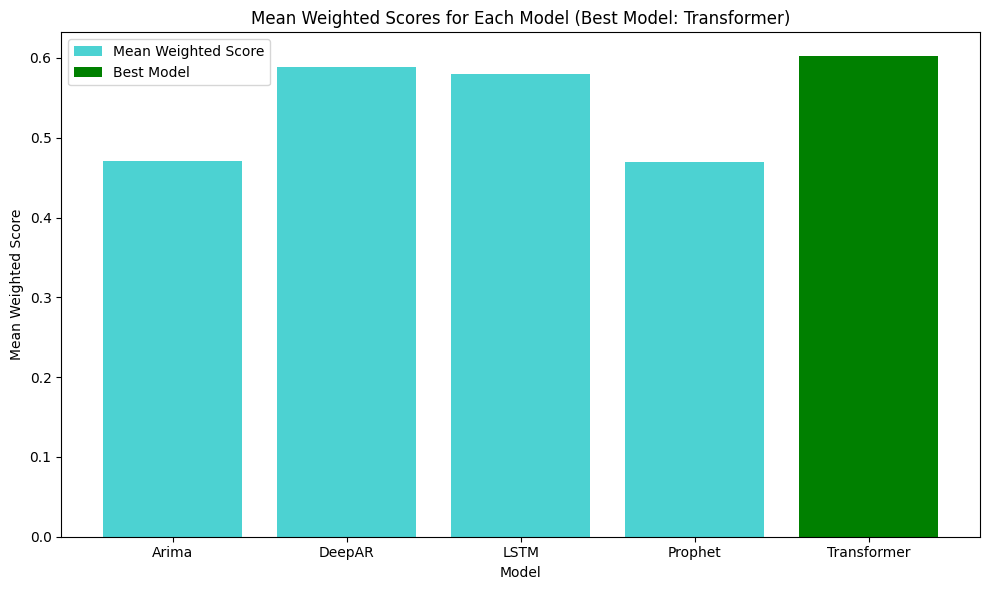

In [130]:
import pandas as pd
import matplotlib.pyplot as plt

# Define the metrics for each model and theme
data = {
    "Model": ["Prophet", "Prophet", "Prophet", "Arima", "Arima", "Arima", 
              "LSTM", "LSTM", "LSTM", "DeepAR", "DeepAR", "DeepAR", 
              "Transformer", "Transformer", "Transformer"],
    "Theme": ["negative", "neutral", "positive", "negative", "neutral", "positive", 
              "negative", "neutral", "positive", "negative", "neutral", "positive", 
              "negative", "neutral", "positive"],
    "MAE": [21.93, 363.83, 40.26, 19.06, 284.69, 45.09, 20.81, 284.90, 31.35, 
            18.35, 328.06, 29.95, 14.16, 346.01, 30.62],
    "MSE": [1134.30, 489546.53, 1834.91, 566.64, 531743.85, 2189.33, 642.35, 
            520026.02, 993.88, 488.56, 602638.01, 1056.26, 485.06, 609302.67, 978.39],
    "RMSE": [33.68, 699.68, 42.84, 23.80, 729.21, 46.79, 25.34, 721.13, 31.53, 
             22.10, 776.30, 32.50, 22.02, 780.58, 31.28],
    "MAPE": [320.68, 85.50, 1675.19, 374.47, 28.74, 1759.86, 304.84, 31.39, 
             1176.83, 216.43, 30.88, 1224.35, 145.04, 40.23, 1160.16],
    "R-squared": [-1.18, -0.04, -2.42, -0.09, -0.12, -3.08, -0.01, -0.10, -0.64, 
                  0.10, -0.15, -0.97, 0.11, -0.16, -0.82]
}

# Create the DataFrame
df_metrics = pd.DataFrame(data)

# Normalize the scores for each metric
df_metrics['NORMALIZED_MSE'] = (df_metrics['MSE'] - df_metrics['MSE'].min()) / (df_metrics['MSE'].max() - df_metrics['MSE'].min())
df_metrics['NORMALIZED_MAE'] = (df_metrics['MAE'] - df_metrics['MAE'].min()) / (df_metrics['MAE'].max() - df_metrics['MAE'].min())
df_metrics['NORMALIZED_RMSE'] = (df_metrics['RMSE'] - df_metrics['RMSE'].min()) / (df_metrics['RMSE'].max() - df_metrics['RMSE'].min())
df_metrics['NORMALIZED_MAPE'] = (df_metrics['MAPE'] - df_metrics['MAPE'].min()) / (df_metrics['MAPE'].max() - df_metrics['MAPE'].min())
df_metrics['NORMALIZED_R2'] = (df_metrics['R-squared'] - df_metrics['R-squared'].min()) / (df_metrics['R-squared'].max() - df_metrics['R-squared'].min())

# Calculate the variance of each normalized metric
var_mse = df_metrics['NORMALIZED_MSE'].var()
var_mae = df_metrics['NORMALIZED_MAE'].var()
var_rmse = df_metrics['NORMALIZED_RMSE'].var()
var_mape = df_metrics['NORMALIZED_MAPE'].var()
var_r2 = df_metrics['NORMALIZED_R2'].var()

# Invert variances (lower variance gets higher weight)
inv_var_mse = 1 / var_mse
inv_var_mae = 1 / var_mae
inv_var_rmse = 1 / var_rmse
inv_var_mape = 1 / var_mape
inv_var_r2 = 1 / var_r2

# Normalize the inverted variances to sum to 1
total_inv_var = inv_var_mse + inv_var_mae + inv_var_rmse + inv_var_mape + inv_var_r2

WEIGHT_MSE = inv_var_mse / total_inv_var
WEIGHT_MAE = inv_var_mae / total_inv_var
WEIGHT_RMSE = inv_var_rmse / total_inv_var
WEIGHT_MAPE = inv_var_mape / total_inv_var
WEIGHT_R2 = inv_var_r2 / total_inv_var

# Print the calculated weights for reference
print(f"Automatically calculated weights:\nMSE: {WEIGHT_MSE}, MAE: {WEIGHT_MAE}, RMSE: {WEIGHT_RMSE}, MAPE: {WEIGHT_MAPE}, R2: {WEIGHT_R2}")

# Calculate the weighted score
df_metrics['WEIGHTED_SCORE'] = (
    WEIGHT_MSE * df_metrics['NORMALIZED_MSE'] +
    WEIGHT_MAE * df_metrics['NORMALIZED_MAE'] +
    WEIGHT_RMSE * df_metrics['NORMALIZED_RMSE'] +
    WEIGHT_MAPE * (1 - df_metrics['NORMALIZED_MAPE']) +  # (1 - NORMALIZED_MAPE) because lower MAPE is better
    WEIGHT_R2 * df_metrics['NORMALIZED_R2']
)

# Calculate the mean weighted score for each model
mean_scores = df_metrics.groupby('Model')['WEIGHTED_SCORE'].mean()

# Find the best model based on the highest mean score
best_model = mean_scores.idxmax()

# Create a bar plot to visualize the mean weighted scores for each model
plt.figure(figsize=(10, 6))
plt.bar(mean_scores.index, mean_scores, color='c', alpha=0.7, label='Mean Weighted Score')

# Highlight the best model with a different color
plt.bar(best_model, mean_scores[best_model], color='g', label='Best Model')

# Set labels and title
plt.xlabel('Model')
plt.ylabel('Mean Weighted Score')
plt.title(f'Mean Weighted Scores for Each Model (Best Model: {best_model})')

# Show the plot
plt.legend()
plt.tight_layout()
plt.show()


In [131]:
mean_scores

Model
Arima          0.470440
DeepAR         0.588604
LSTM           0.579765
Prophet        0.469533
Transformer    0.602028
Name: WEIGHTED_SCORE, dtype: float64

In [75]:
import pandas as pd
import numpy as np
from gluonts.dataset.common import ListDataset
from gluonts.mx.model.transformer import TransformerEstimator
from gluonts.mx.model.deepar import DeepAREstimator
from gluonts.mx.trainer import Trainer
from pmdarima.arima import auto_arima
from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from sklearn.preprocessing import MinMaxScaler
from prophet import Prophet
import plotly.graph_objects as go

# Assuming you have a DataFrame named 'aggr_df'
aggr_df = monthly_os.copy()

# Convert 'Date' to datetime and set it as the index
aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])
aggr_df.set_index('Date', inplace=True)

# Get unique 'llama3_sentiment' values (themes)
unique_themes = aggr_df['llama3_sentiment'].unique()

# Initialize lists to store performance metrics
performance_metrics = []

# Define reduced context and prediction lengths
context_length = 30  # 1 month of context
prediction_length = 7  # 1 week of prediction
freq = 'D'  # Daily frequency

# 1. Auto-ARIMA
for theme in unique_themes:
    df_subset = aggr_df[aggr_df['llama3_sentiment'] == theme].copy()

    # Ensure enough data for training and prediction
    if len(df_subset) < context_length + prediction_length:
        continue

    # Split data: training (all but the last 7 days) and testing (last 7 days)
    df_train = df_subset.iloc[:-prediction_length]
    df_test = df_subset.iloc[-prediction_length:]

    # Fit Auto-ARIMA model
    model = auto_arima(df_train['Posts'], seasonal=True, stepwise=True, trace=True)

    # Forecast the next 7 days
    forecast, conf_int = model.predict(n_periods=prediction_length, return_conf_int=True)

    # Calculate performance metrics
    actual_values = df_test['Posts'].values
    mae = mean_absolute_error(actual_values, forecast)
    mse = mean_squared_error(actual_values, forecast)
    rmse = np.sqrt(mse)
    mape = mean_absolute_percentage_error(actual_values, forecast) * 100
    r2 = r2_score(actual_values, forecast)

    # Store ARIMA metrics
    performance_metrics.append({
        'Model': 'Auto-ARIMA',
        'Theme': theme,
        'MAE': mae,
        'MSE': mse,
        'RMSE': rmse,
        'MAPE': mape,
        'R2': r2
    })

# 2. Prophet
for theme in unique_themes:
    df_subset = aggr_df[aggr_df['llama3_sentiment'] == theme].copy()

    if len(df_subset) < context_length + prediction_length:
        continue

    # Split data: training (all but the last 7 days) and testing (last 7 days)
    df_train = df_subset.iloc[:-prediction_length]
    df_test = df_subset.iloc[-prediction_length:]

    # Prepare data for Prophet
    df_train = df_train.reset_index().rename(columns={'Date': 'ds', 'Posts': 'y'})
    
    model = Prophet(weekly_seasonality=True)
    model.fit(df_train)

    future = model.make_future_dataframe(periods=prediction_length)
    forecast = model.predict(future)

    # Extract forecast for the last 7 days
    future_forecast = forecast.tail(prediction_length)['yhat'].values
    actual_values = df_test['Posts'].values

    # Calculate performance metrics
    mae = mean_absolute_error(actual_values, future_forecast)
    mse = mean_squared_error(actual_values, future_forecast)
    rmse = np.sqrt(mse)
    mape = mean_absolute_percentage_error(actual_values, future_forecast) * 100
    r2 = r2_score(actual_values, future_forecast)

    # Store Prophet metrics
    performance_metrics.append({
        'Model': 'Prophet',
        'Theme': theme,
        'MAE': mae,
        'MSE': mse,
        'RMSE': rmse,
        'MAPE': mape,
        'R2': r2
    })

# 3. LSTM
scaler = MinMaxScaler()
look_back = 30  # 1 month

for theme in unique_themes:
    df_subset = aggr_df[aggr_df['llama3_sentiment'] == theme].copy()

    if len(df_subset) < context_length + prediction_length:
        continue

    # Scale the data
    df_subset['Posts'] = scaler.fit_transform(df_subset[['Posts']].values)

    # Prepare X and y data with look_back window
    X, y = [], []
    for i in range(look_back, len(df_subset)):
        X.append(df_subset['Posts'].values[i-look_back:i])
        y.append(df_subset['Posts'].values[i])

    X, y = np.array(X), np.array(y)
    X = X.reshape((X.shape[0], X.shape[1], 1))

    # Split into training and test sets (train on all but the last 7 days)
    split_index = len(X) - prediction_length
    X_train, X_test, y_train, y_test = X[:split_index], X[split_index:], y[:split_index], y[split_index:]

    # Define and train LSTM model
    model = Sequential([LSTM(50, input_shape=(look_back, 1)), Dense(1)])
    model.compile(optimizer='adam', loss='mean_squared_error')
    model.fit(X_train, y_train, epochs=50, batch_size=32, verbose=1)

    # Forecast the next 7 days
    future_X = df_subset['Posts'].values[-look_back:].reshape(1, look_back, 1)
    future_preds = []
    for _ in range(prediction_length):
        future_pred = model.predict(future_X)
        future_preds.append(future_pred[0][0])
        future_X = np.append(future_X[:, 1:, :], future_pred.reshape(1, 1, 1), axis=1)

    future_preds = scaler.inverse_transform(np.array(future_preds).reshape(-1, 1)).flatten()
    actual_values = scaler.inverse_transform(y_test.reshape(-1, 1)).flatten()

    # Calculate performance metrics
    mae = mean_absolute_error(actual_values, future_preds)
    mse = mean_squared_error(actual_values, future_preds)
    rmse = np.sqrt(mse)
    mape = mean_absolute_percentage_error(actual_values, future_preds) * 100
    r2 = r2_score(actual_values, future_preds)

    # Store LSTM metrics
    performance_metrics.append({
        'Model': 'LSTM',
        'Theme': theme,
        'MAE': mae,
        'MSE': mse,
        'RMSE': rmse,
        'MAPE': mape,
        'R2': r2
    })

# 4. DeepAR
context_length = 30  # 1 month of context
prediction_length = 7  # 1 week of prediction

for theme in unique_themes:
    df_subset = aggr_df[aggr_df['llama3_sentiment'] == theme]['Posts'].to_frame()

    if len(df_subset) < context_length + prediction_length:
        continue

    # Create DeepAR dataset (training: all but the last 7 days)
    train_data = ListDataset([{"start": df_subset.index[0], "target": df_subset['Posts'].values[:-prediction_length]}], freq='D')

    estimator = DeepAREstimator(prediction_length=prediction_length, context_length=context_length, freq='D', trainer=Trainer(epochs=10))
    predictor = estimator.train(training_data=train_data)

    # Test on the last week (7 days)
    test_data = ListDataset([{"start": df_subset.index[-prediction_length], "target": df_subset['Posts'].values[-context_length:]}], freq='D')

    forecast = list(predictor.predict(test_data))[0]
    forecast_values = forecast.mean[:prediction_length]

    actual_values = df_subset['Posts'][-prediction_length:].values

    # Calculate performance metrics
    mae = mean_absolute_error(actual_values, forecast_values)
    mse = mean_squared_error(actual_values, forecast_values)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((actual_values - forecast_values) / actual_values)) * 100
    r2 = r2_score(actual_values, forecast_values)

    # Store DeepAR metrics
    performance_metrics.append({
        'Model': 'DeepAR',
        'Theme': theme,
        'MAE': mae,
        'MSE': mse,
        'RMSE': rmse,
        'MAPE': mape,
        'R2': r2
    })

# 5. Transformer
for theme in unique_themes:
    df_subset = aggr_df[aggr_df['llama3_sentiment'] == theme]['Posts'].to_frame()

    if len(df_subset) < context_length + prediction_length:
        continue

    # Create Transformer dataset (training: all but the last 7 days)
    train_data = ListDataset([{"start": df_subset.index[0], "target": df_subset['Posts'].values[:-prediction_length]}], freq='D')

    estimator = TransformerEstimator(prediction_length=prediction_length, context_length=context_length, freq='D', trainer=Trainer(epochs=10))
    predictor = estimator.train(training_data=train_data)

    # Test on the last week (7 days)
    test_data = ListDataset([{"start": df_subset.index[-prediction_length], "target": df_subset['Posts'].values[-context_length:]}], freq='D')

    forecast = list(predictor.predict(test_data))[0]
    forecast_values = forecast.mean[:prediction_length]

    actual_values = df_subset['Posts'][-prediction_length:].values

    # Calculate performance metrics
    mae = mean_absolute_error(actual_values, forecast_values)
    mse = mean_squared_error(actual_values, forecast_values)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((actual_values - forecast_values) / actual_values)) * 100
    r2 = r2_score(actual_values, forecast_values)

    # Store Transformer metrics
    performance_metrics.append({
        'Model': 'Transformer',
        'Theme': theme,
        'MAE': mae,
        'MSE': mse,
        'RMSE': rmse,
        'MAPE': mape,
        'R2': r2
    })

# Create DataFrame for performance metrics and display results
performance_metrics_df = pd.DataFrame(performance_metrics)
print(performance_metrics_df)


Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=425.065, Time=0.08 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=421.930, Time=0.00 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=422.505, Time=0.01 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=422.198, Time=0.01 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=482.423, Time=0.00 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=424.098, Time=0.02 sec

Best model:  ARIMA(0,0,0)(0,0,0)[0] intercept
Total fit time: 0.137 seconds
Performing stepwise search to minimize aic


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.08 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=876.943, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=878.923, Time=0.01 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=878.915, Time=0.02 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=894.167, Time=0.01 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=880.916, Time=0.02 sec

Best model:  ARIMA(0,0,0)(0,0,0)[0] intercept
Total fit time: 0.141 seconds
Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.06 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=480.667, Time=0.00 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=465.123, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=470.560, Time=0.01 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=566.732, Time=0.00 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=466.531, Time=0.03 sec


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmprt0rt69b/4919kuq5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmprt0rt69b/cobgrh9m.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99020', 'data', 'file=/tmp/tmprt0r

 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=466.650, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=468.514, Time=0.05 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=473.992, Time=0.01 sec

Best model:  ARIMA(1,0,0)(0,0,0)[0] intercept
Total fit time: 0.221 seconds


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmprt0rt69b/q45bgr3t.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmprt0rt69b/ig739bkm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=66612', 'data', 'file=/tmp/tmprt0rt69b/q45bgr3t.json', 'init=/tmp/tmprt0rt69b/ig739bkm.json', 'output', 'file=/tmp/tmprt0rt69b/prophet_modelbgu6a071/prophet_model-20240913080322.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
08:03:22 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
08:03:22 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cm

Epoch 1/50


2024-09-13 08:03:23.094985: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-13 08:03:23.095897: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-13 08:03:23.096560: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 966ms/step - loss: 0.1279
Epoch 2/50
1/1 [==============================] - 0s 6ms/step - loss: 0.1110
Epoch 3/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0959
Epoch 4/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0826
Epoch 5/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0711
Epoch 6/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0613
Epoch 7/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0532
Epoch 8/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0469
Epoch 9/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0424
Epoch 10/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0400
Epoch 11/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0397
Epoch 12/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0412
Epoch 13/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0437
Epoc

2024-09-13 08:03:24.523919: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-13 08:03:24.524800: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-13 08:03:24.525543: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 0s 12ms/step
Epoch 1/50


2024-09-13 08:03:24.869353: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-13 08:03:24.870165: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-13 08:03:24.870795: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step - loss: 0.0428
Epoch 2/50
1/1 [==============================] - 0s 12ms/step - loss: 0.0394
Epoch 3/50
1/1 [==============================] - 0s 12ms/step - loss: 0.0365
Epoch 4/50
1/1 [==============================] - 0s 11ms/step - loss: 0.0341
Epoch 5/50
1/1 [==============================] - 0s 13ms/step - loss: 0.0322
Epoch 6/50
1/1 [==============================] - 0s 11ms/step - loss: 0.0309
Epoch 7/50
1/1 [==============================] - 0s 11ms/step - loss: 0.0301
Epoch 8/50
1/1 [==============================] - 0s 11ms/step - loss: 0.0300
Epoch 9/50
1/1 [==============================] - 0s 11ms/step - loss: 0.0304
Epoch 10/50
1/1 [==============================] - 0s 11ms/step - loss: 0.0311
Epoch 11/50
1/1 [==============================] - 0s 11ms/step - loss: 0.0314
Epoch 12/50
1/1 [==============================] - 0s 11ms/step - loss: 0.0314
Epoch 13/50
1/1 [==============================] - 0s 11ms/step - loss: 0.

2024-09-13 08:03:26.860994: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-13 08:03:26.861866: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-13 08:03:26.862580: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 0s 12ms/step
Epoch 1/50


2024-09-13 08:03:27.205280: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-13 08:03:27.206108: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-13 08:03:27.206759: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 943ms/step - loss: 0.2411
Epoch 2/50
1/1 [==============================] - 0s 5ms/step - loss: 0.2148
Epoch 3/50
1/1 [==============================] - 0s 5ms/step - loss: 0.1901
Epoch 4/50
1/1 [==============================] - 0s 5ms/step - loss: 0.1670
Epoch 5/50
1/1 [==============================] - 0s 5ms/step - loss: 0.1454
Epoch 6/50
1/1 [==============================] - 0s 5ms/step - loss: 0.1251
Epoch 7/50
1/1 [==============================] - 0s 5ms/step - loss: 0.1061
Epoch 8/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0883
Epoch 9/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0718
Epoch 10/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0568
Epoch 11/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0434
Epoch 12/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0322
Epoch 13/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0238
Epoc

2024-09-13 08:03:28.598628: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-13 08:03:28.599533: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-13 08:03:28.600251: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 0s 12ms/step


100%|██████████| 50/50 [00:00<00:00, 50.13it/s, epoch=10/10, avg_epoch_loss=3.94]

          Model     Theme         MAE            MSE        RMSE         MAPE  \
0    Auto-ARIMA  negative   17.814286     553.786457   23.532668   241.712349   
1    Auto-ARIMA   neutral  315.377049  607679.947403  779.538291    24.499630   
2    Auto-ARIMA  positive   45.091706    2189.332488   46.790303  1759.858559   
3       Prophet  negative  181.411734   39280.604071  198.193350  2907.580407   
4       Prophet   neutral  358.569022  538756.611227  734.000416    59.816470   
5       Prophet  positive   40.255602    1834.913069   42.835885  1675.194101   
6          LSTM  negative   19.416006     564.543566   23.760126   275.928524   
7          LSTM   neutral  310.288175  598130.424315  773.388922    22.133170   
8          LSTM  positive   34.449212    1203.721997   34.694697  1271.815397   
9        DeepAR  negative   15.439580     382.442872   19.556147   205.998477   
10       DeepAR   neutral  343.522013  618262.777399  786.296876    37.709745   
11       DeepAR  positive   

In [62]:
aggr_df.shape

(183, 2)

In [133]:
df2=df.copy()

In [132]:
df.columns

Index(['Unnamed: 0.2', 'Unnamed: 0', 'textid', 'Date', 'Views', 'sourcetype',
       'alltext', 'Text_emt', 'Text_emj', 'Text_langue', 'Text_translate',
       'Text_langue2', 'Text_lower', 'Text_punct', 'Text_tags', 'Text_chat',
       'Text_spell', 'Text_langue3', 'Text_translate2', 'Text_token',
       'Text_stop', 'Text_stem', 'Text_lemma', 'berttopic2', 'cluster_id2',
       'llama2_labelone10', 'cluster_labelone10', 'cluster_id',
       'llama2_labelone', 'cluster_labelone', 'Unnamed: 0.1', 'Text_lemma2',
       'Bertscore_Labels', 'Final_Labels', 'Predicted_Categories3', 'polarity',
       'subjectivity', 'Textblob', 'VADER', 'neg', 'neu', 'pos', 'compound',
       'BERT', 'Sentiment_Score', 'Sentiwordnet', 'llama3_sentiment',
       'Emotion', 'Emotional_Polarity', 'Common_Sentiment32', 'Sentiment2',
       'Predicted_Labels', 'Sentiment2_prediction', 'Sentiment2_roberta',
       'Predicted_Labels_roberta', 'Predicted_Sentiment_finetunned',
       'mapped_initial_label', 'finet

In [134]:
# Ensure 'Date' column is in datetime format
df['Date'] = pd.to_datetime(df['Date_Extracted'])


# Group by 'Keysector' and 'Date' and count the posts
aggr_df = df.groupby(['llama2_labelone', pd.Grouper(key='Date', freq='M')])['Text_lemma'].count().reset_index()
aggr_df.columns = ['llama2_labelone', 'Date', 'Posts']
aggr_df.head(5)

,llama2_labelone,Date,Posts
0,"""african comedian reacts to ragghana street fu...",2019-08-31,13
1,"""african comedian reacts to ragghana street fu...",2020-08-31,8
2,"""african comedian reacts to ragghana street fu...",2020-09-30,1
3,"""african comedian reacts to ragghana street fu...",2021-08-31,20
4,"""african comedian reacts to ragghana street fu...",2022-08-31,17


In [135]:
monthly_os=aggr_df.copy()

In [136]:
# monthly_OS=aggr_df.copy()
monthly_os.head(5)

,llama2_labelone,Date,Posts
0,"""african comedian reacts to ragghana street fu...",2019-08-31,13
1,"""african comedian reacts to ragghana street fu...",2020-08-31,8
2,"""african comedian reacts to ragghana street fu...",2020-09-30,1
3,"""african comedian reacts to ragghana street fu...",2021-08-31,20
4,"""african comedian reacts to ragghana street fu...",2022-08-31,17


In [137]:
# monthly_OS=aggr_df.copy()
monthly_os.shape

(2726, 3)

In [138]:
from statsmodels.tsa.stattools import adfuller
import pandas as pd

# Assuming 'monthly_OS' is your time series data in the DataFrame
# You may want to select a specific column from your DataFrame, e.g., monthly_os['Posts']

print('Results of Dickey-Fuller Test:')
dftest = adfuller(monthly_os['Posts'], autolag='AIC')
dfoutput = pd.Series(dftest[0:4], index=['Test Statistic', 'p-value', '#Lags Used', 'Number of Observations Used'])

# Print the results
print(dfoutput)


Results of Dickey-Fuller Test:
Test Statistic                   -4.812250
p-value                           0.000052
#Lags Used                       28.000000
Number of Observations Used    2697.000000
dtype: float64


The Dickey-Fuller test is used to check if a time series is stationary, meaning its statistical properties like mean and variance are constant over time. Here’s how to interpret these specific results:

1. Test Statistic: -4.812250
The test statistic is the computed value from the Dickey-Fuller test. Generally, the more negative this value, the stronger the evidence against the null hypothesis (which assumes that the time series has a unit root and is non-stationary).
A test statistic of -4.812250 is quite negative, suggesting that the time series might be stationary.
2. p-value: 0.000052
The p-value indicates the probability of observing the test statistic, or one more extreme, if the null hypothesis is true. A lower p-value means stronger evidence against the null hypothesis.
Here, the p-value is 0.000052, which is well below common significance levels like 0.05 or 0.01. This means we can confidently reject the null hypothesis and conclude that the time series is stationary.
3. #Lags Used: 28
This refers to the number of lagged differences included in the model to account for potential autocorrelation in the data. Including these lags helps to better capture the underlying structure of the time series.
4. Number of Observations Used: 2697
This is the total number of data points used in the test after accounting for the lags. Having a large number of observations (2697 in this case) generally increases the reliability of the test results.
Summary Interpretation:
The Dickey-Fuller test results indicate that the time series is likely stationary. The very low p-value of 0.000052 allows us to reject the null hypothesis of a unit root with high confidence. The significantly negative test statistic (-4.812250) further supports the conclusion that the series is stationary, meaning it doesn't have a trend or varying mean over time, making it more suitable for certain time series models like ARIMA without needing further differencing.

In [139]:
# # Assuming 'Value' is the column you want to calculate rolling statistics for
# moving_avg = monthly_OS['Posts'].rolling(12).mean()
# moving_std = monthly_OS['Posts'].rolling(12).std()


In [140]:
# #Plot rolling statistics:
# orig = plt.plot(monthly_OS['Posts'], color='blue',label='Original')
# mean = plt.plot(moving_avg, color='red', label='Rolling Mean')
# std = plt.plot(moving_std, color='black', label = 'Rolling Std')
# plt.legend(loc='best')
# plt.title('Rolling Mean & Standard Deviation')
# plt.show(block=False)

In [141]:
from statsmodels.tsa.stattools import adfuller
import pandas as pd

# Assuming 'monthly_OS' contains the DataFrame with 'Posts' column
print('Results of Dickey-Fuller Test:')
dftest = adfuller(monthly_os['Posts'], autolag='AIC')
dfoutput = pd.Series(dftest[0:4], index=['Test Statistic', 'p-value', '#Lags Used', 'Number of Observations Used'])

for key, value in dftest[4].items():
    dfoutput['Critical Value (%s)' % key] = value
print(dfoutput)

Results of Dickey-Fuller Test:
Test Statistic                   -4.812250
p-value                           0.000052
#Lags Used                       28.000000
Number of Observations Used    2697.000000
Critical Value (1%)              -3.432777
Critical Value (5%)              -2.862612
Critical Value (10%)             -2.567341
dtype: float64


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



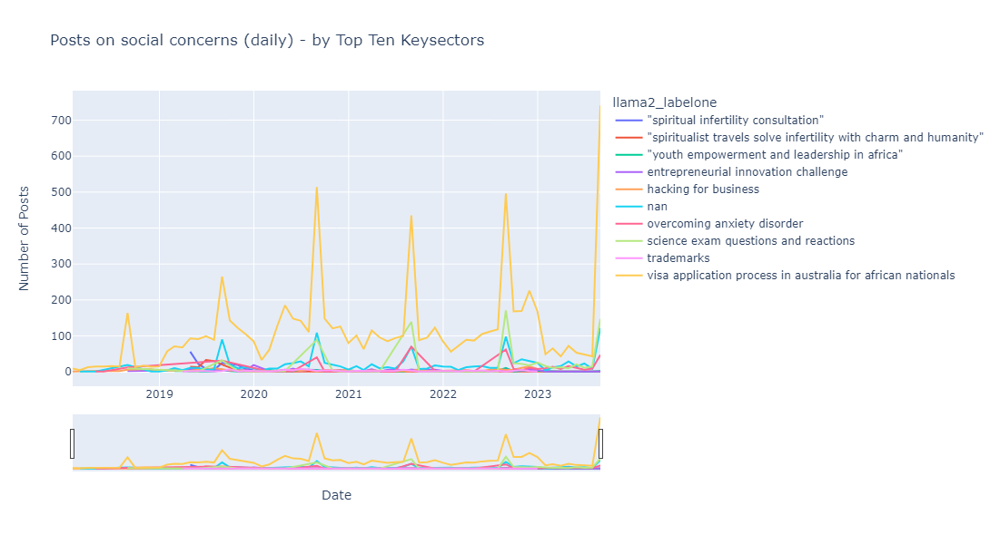

In [142]:
import plotly.express as px
import pandas as pd

# Convert 'Date' column to datetime
aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])

# Calculate the total posts for each 'llama2_labelone'
total_posts = aggr_df.groupby('llama2_labelone')['Posts'].sum().reset_index()

# Get the top ten 'llama2_labelone' based on the number of posts
top_ten_labels = total_posts.nlargest(10, 'Posts')['llama2_labelone']

# Filter the DataFrame to include only the top ten 'llama2_labelone'
aggr_df_top_ten = aggr_df[aggr_df['llama2_labelone'].isin(top_ten_labels)]

# Create a line plot for the top ten 'llama2_labelone' categories
fig = px.line(aggr_df_top_ten, x='Date', y='Posts', color='llama2_labelone',
              title='Posts on social concerns (daily) - by Top Ten Keysectors')
fig.update_xaxes(title_text='Date')
fig.update_yaxes(title_text='Number of Posts')

# Update layout for the legend and the overall plot
fig.update_layout(legend_title_text='llama2_labelone', xaxis_rangeslider_visible=True, showlegend=True)
fig.update_xaxes(rangeslider=dict(visible=True))
fig.update_layout(height=600, width=800, title_text='Posts on social concerns (daily) - by Top Ten Keysectors')
fig.show()


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



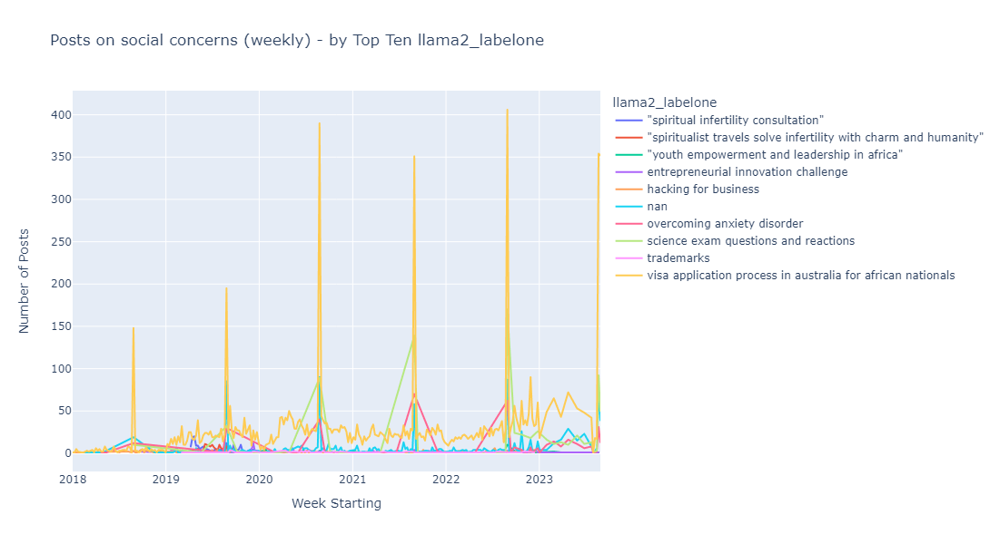

In [356]:
import plotly.express as px
import pandas as pd

# Ensure 'Date' column is in datetime format
df['Date'] = pd.to_datetime(df['Date'])

# Group by 'llama2_labelone' and 'Date' and count the posts
aggr_df = df.groupby(['llama2_labelone', pd.Grouper(key='Date', freq='W-MON')])['Text_lemma'].count().reset_index()
aggr_df.columns = ['llama2_labelone', 'Date', 'Posts']

# Calculate the total posts for each 'llama2_labelone'
total_posts = aggr_df.groupby('llama2_labelone')['Posts'].sum().reset_index()

# Get the top ten 'llama2_labelone' based on the number of posts
top_ten_labels = total_posts.nlargest(10, 'Posts')['llama2_labelone']

# Filter the aggregated DataFrame to include only the top ten 'llama2_labelone'
aggr_df_top_ten = aggr_df[aggr_df['llama2_labelone'].isin(top_ten_labels)]

# Create a line plot for the top ten 'llama2_labelone' categories
fig = px.line(aggr_df_top_ten, x='Date', y='Posts', color='llama2_labelone',
              title='Posts on social concerns (weekly) - by Top Ten llama2_labelone',
              labels={'Date': 'Week Starting'})
fig.update_yaxes(title_text='Number of Posts')

# Update layout for the legend and the overall plot
fig.update_layout(legend_title_text='llama2_labelone', showlegend=True, height=600, width=800)
fig.show()


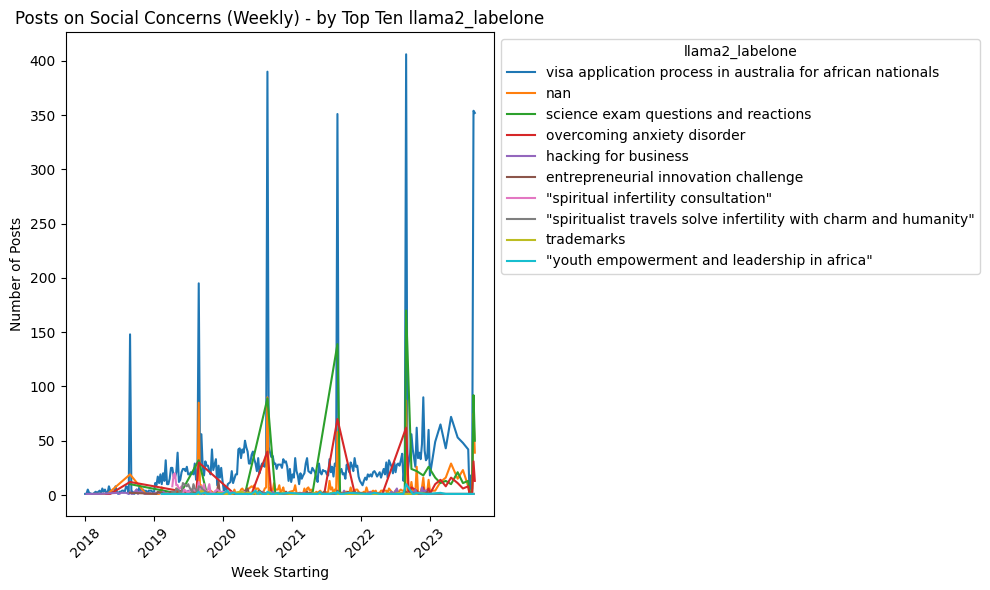

In [360]:
import pandas as pd
import matplotlib.pyplot as plt

# Ensure 'Date' column is in datetime format
df['Date'] = pd.to_datetime(df['Date'])

# Group by 'llama2_labelone' and 'Date' and count the posts
aggr_df = df.groupby(['llama2_labelone', pd.Grouper(key='Date', freq='W-MON')])['Text_lemma'].count().reset_index()
aggr_df.columns = ['llama2_labelone', 'Date', 'Posts']

# Calculate the total posts for each 'llama2_labelone'
total_posts = aggr_df.groupby('llama2_labelone')['Posts'].sum().reset_index()

# Get the top ten 'llama2_labelone' based on the number of posts
top_ten_labels = total_posts.nlargest(10, 'Posts')['llama2_labelone']

# Filter the aggregated DataFrame to include only the top ten 'llama2_labelone'
aggr_df_top_ten = aggr_df[aggr_df['llama2_labelone'].isin(top_ten_labels)]

# Plot for each topic in the top ten
plt.figure(figsize=(10, 6))

for label in top_ten_labels:
    label_data = aggr_df_top_ten[aggr_df_top_ten['llama2_labelone'] == label]
    plt.plot(label_data['Date'], label_data['Posts'], label=label)

# Set title and labels
plt.title('Posts on Social Concerns (Weekly) - by Top Ten llama2_labelone')
plt.xlabel('Week Starting')
plt.ylabel('Number of Posts')

# Add legend
plt.legend(title='llama2_labelone', loc='upper left', bbox_to_anchor=(1, 1))

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



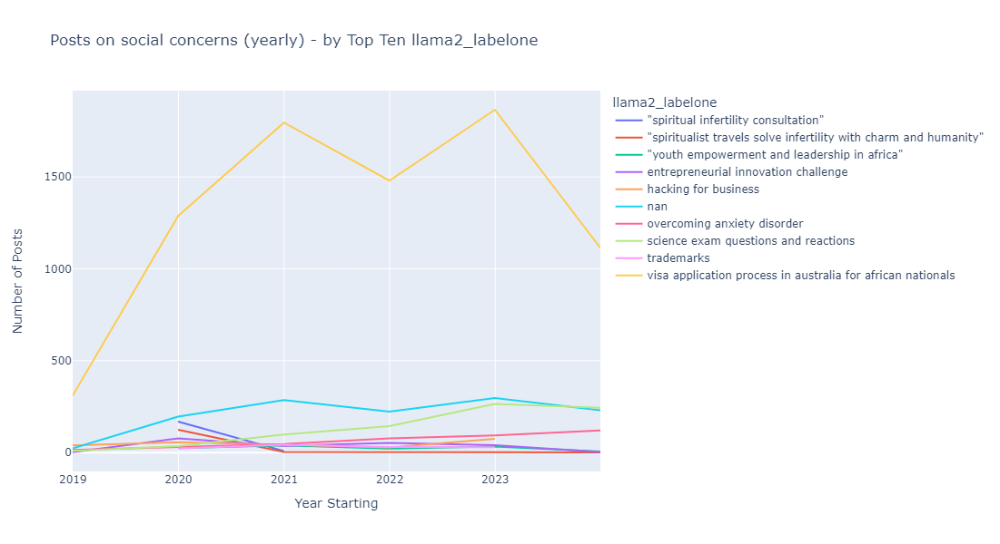

In [125]:
import plotly.express as px
import pandas as pd

# Ensure 'Date' column is in datetime format
df['Date'] = pd.to_datetime(df['Date'])

# Group by 'llama2_labelone' and 'Date' and count the posts
aggr_df = df.groupby(['llama2_labelone', pd.Grouper(key='Date', freq='Y')])['Text_lemma'].count().reset_index()
aggr_df.columns = ['llama2_labelone', 'Date', 'Posts']

# Calculate the total posts for each 'llama2_labelone'
total_posts = aggr_df.groupby('llama2_labelone')['Posts'].sum().reset_index()

# Get the top ten 'llama2_labelone' based on the number of posts
top_ten_labels = total_posts.nlargest(10, 'Posts')['llama2_labelone']

# Filter the aggregated DataFrame to include only the top ten 'llama2_labelone'
aggr_df_top_ten = aggr_df[aggr_df['llama2_labelone'].isin(top_ten_labels)]

# Create a line plot for the top ten 'llama2_labelone' categories
fig = px.line(aggr_df_top_ten, x='Date', y='Posts', color='llama2_labelone',
              title='Posts on social concerns (yearly) - by Top Ten llama2_labelone',
              labels={'Date': 'Year Starting'})
fig.update_yaxes(title_text='Number of Posts')

# Update layout for the legend and the overall plot
fig.update_layout(legend_title_text='llama2_labelone', showlegend=True, height=600, width=800)
fig.show()


In [336]:
df=df2.copy()

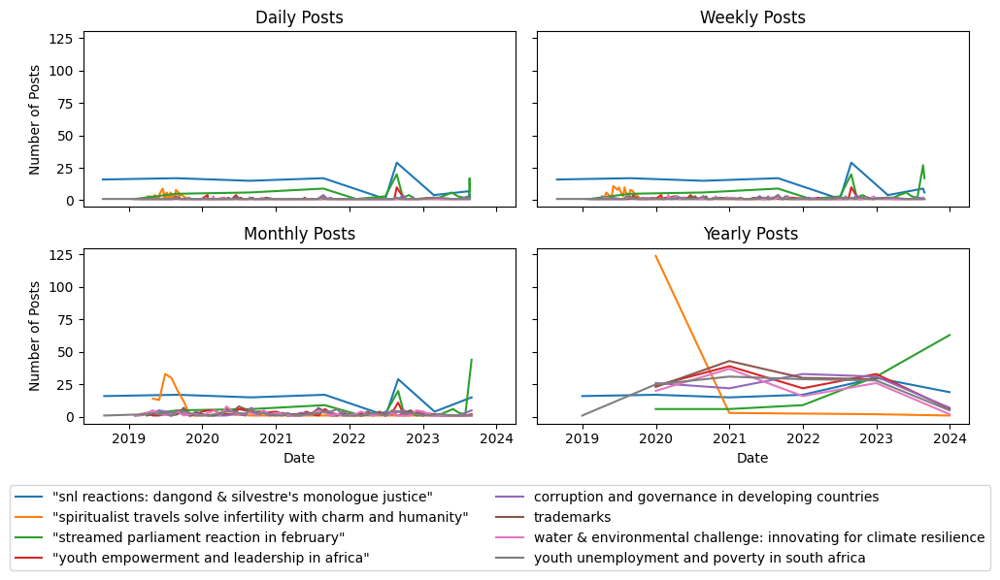

In [394]:
import pandas as pd
import matplotlib.pyplot as plt

# Ensure 'Date' column is in datetime format
df['Date'] = pd.to_datetime(df['Date'])

# Group by 'llama2_labelone' and 'Date' and count the posts for weekly data
aggr_df_weekly = df.groupby(['llama2_labelone', pd.Grouper(key='Date', freq='W-MON')])['Text_lemma'].count().reset_index()
aggr_df_weekly.columns = ['llama2_labelone', 'Date', 'Posts']

# Group by 'llama2_labelone' and 'Date' and count the posts for daily data
aggr_df_daily = df.groupby(['llama2_labelone', pd.Grouper(key='Date', freq='D')])['Text_lemma'].count().reset_index()
aggr_df_daily.columns = ['llama2_labelone', 'Date', 'Posts']

# Group by 'llama2_labelone' and 'Date' and count the posts for monthly data
aggr_df_monthly = df.groupby(['llama2_labelone', pd.Grouper(key='Date', freq='M')])['Text_lemma'].count().reset_index()
aggr_df_monthly.columns = ['llama2_labelone', 'Date', 'Posts']

# Group by 'llama2_labelone' and 'Date' and count the posts for yearly data
aggr_df_yearly = df.groupby(['llama2_labelone', pd.Grouper(key='Date', freq='Y')])['Text_lemma'].count().reset_index()
aggr_df_yearly.columns = ['llama2_labelone', 'Date', 'Posts']

# Calculate the total posts for each 'llama2_labelone' to get the top ten labels
total_posts = aggr_df_weekly.groupby('llama2_labelone')['Posts'].sum().reset_index()
# top_ten_labels = total_posts.nlargest(10, 'Posts')['llama2_labelone']
top_ten_labels = total_posts[(total_posts['Posts'] >= 100) & (total_posts['Posts'] <= 150)]['llama2_labelone']


# Filter the aggregated DataFrames to include only the top ten 'llama2_labelone'
aggr_df_top_ten_weekly = aggr_df_weekly[aggr_df_weekly['llama2_labelone'].isin(top_ten_labels)]
aggr_df_top_ten_daily = aggr_df_daily[aggr_df_daily['llama2_labelone'].isin(top_ten_labels)]
aggr_df_top_ten_monthly = aggr_df_monthly[aggr_df_monthly['llama2_labelone'].isin(top_ten_labels)]
aggr_df_top_ten_yearly = aggr_df_yearly[aggr_df_yearly['llama2_labelone'].isin(top_ten_labels)]

# Create subplots for daily, weekly, monthly, and yearly data in a 2x2 grid
fig, axes = plt.subplots(2, 2, figsize=(10, 5), sharex=True, sharey=True)

# Plot daily data in the first subplot (axes[0, 0])
for label in top_ten_labels:
    label_data_daily = aggr_df_top_ten_daily[aggr_df_top_ten_daily['llama2_labelone'] == label]
    axes[0, 0].plot(label_data_daily['Date'], label_data_daily['Posts'], label=label)

axes[0, 0].set_title('Daily Posts')
axes[0, 0].set_ylabel('Number of Posts')

# Plot weekly data in the second subplot (axes[0, 1])
for label in top_ten_labels:
    label_data_weekly = aggr_df_top_ten_weekly[aggr_df_top_ten_weekly['llama2_labelone'] == label]
    axes[0, 1].plot(label_data_weekly['Date'], label_data_weekly['Posts'], label=label)

axes[0, 1].set_title('Weekly Posts')

# Plot monthly data in the third subplot (axes[1, 0])
for label in top_ten_labels:
    label_data_monthly = aggr_df_top_ten_monthly[aggr_df_top_ten_monthly['llama2_labelone'] == label]
    axes[1, 0].plot(label_data_monthly['Date'], label_data_monthly['Posts'], label=label)

axes[1, 0].set_title('Monthly Posts')
axes[1, 0].set_ylabel('Number of Posts')
axes[1, 0].set_xlabel('Date')

# Plot yearly data in the fourth subplot (axes[1, 1])
for label in top_ten_labels:
    label_data_yearly = aggr_df_top_ten_yearly[aggr_df_top_ten_yearly['llama2_labelone'] == label]
    axes[1, 1].plot(label_data_yearly['Date'], label_data_yearly['Posts'], label=label)

axes[1, 1].set_title('Yearly Posts ')
axes[1, 1].set_xlabel('Date')

# Add a single legend for all subplots at the bottom
handles, labels = axes[0, 0].get_legend_handles_labels()
fig.legend(handles, labels, loc='lower center', bbox_to_anchor=(0.5, -0.2), ncol=2)

# Adjust layout to prevent overlap and improve readability
plt.tight_layout()

# Show the plots
plt.show()


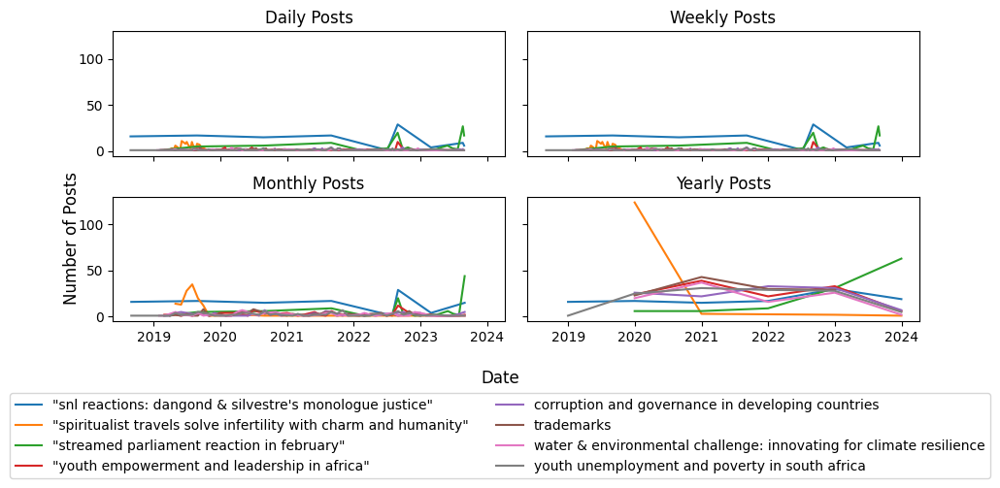

In [395]:
import pandas as pd
import matplotlib.pyplot as plt

# Convert 'Date' column to datetime
aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])

# Calculate the total posts for each 'llama2_labelone'
total_posts = aggr_df.groupby('llama2_labelone')['Posts'].sum().reset_index()

# Filter topics that have a total number of posts between 50 and 100
filtered_labels = total_posts[(total_posts['Posts'] >= 100) & (total_posts['Posts'] <= 150)]['llama2_labelone']

# Filter the DataFrame to include only the topics within the specified range of posts
aggr_df_filtered = aggr_df[aggr_df['llama2_labelone'].isin(filtered_labels)]

# Resample the data for daily, weekly, monthly, and yearly frequencies
daily_data = aggr_df_filtered.groupby([pd.Grouper(key='Date', freq='D'), 'llama2_labelone'])['Posts'].sum().reset_index()
weekly_data = aggr_df_filtered.groupby([pd.Grouper(key='Date', freq='W'), 'llama2_labelone'])['Posts'].sum().reset_index()
monthly_data = aggr_df_filtered.groupby([pd.Grouper(key='Date', freq='M'), 'llama2_labelone'])['Posts'].sum().reset_index()
yearly_data = aggr_df_filtered.groupby([pd.Grouper(key='Date', freq='Y'), 'llama2_labelone'])['Posts'].sum().reset_index()

# Create subplots for daily, weekly, monthly, and yearly data
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(9, 5), sharex=True, sharey=True)
axes = axes.flatten()

# Plot Daily data on the first subplot
for label in filtered_labels:
    daily_label_data = daily_data[daily_data['llama2_labelone'] == label]
    axes[0].plot(daily_label_data['Date'], daily_label_data['Posts'], label=label)
axes[0].set_title('Daily Posts')

# Plot Weekly data on the second subplot
for label in filtered_labels:
    weekly_label_data = weekly_data[weekly_data['llama2_labelone'] == label]
    axes[1].plot(weekly_label_data['Date'], weekly_label_data['Posts'], label=label)
axes[1].set_title('Weekly Posts')

# Plot Monthly data on the third subplot
for label in filtered_labels:
    monthly_label_data = monthly_data[monthly_data['llama2_labelone'] == label]
    axes[2].plot(monthly_label_data['Date'], monthly_label_data['Posts'], label=label)
axes[2].set_title('Monthly Posts')

# Plot Yearly data on the fourth subplot
for label in filtered_labels:
    yearly_label_data = yearly_data[yearly_data['llama2_labelone'] == label]
    axes[3].plot(yearly_label_data['Date'], yearly_label_data['Posts'], label=label)
axes[3].set_title('Yearly Posts')

# Global x and y labels
fig.text(0.5, 0.2, 'Date', ha='center', fontsize=12)
fig.text(0.0004, 0.5, 'Number of Posts', va='center', rotation='vertical', fontsize=12)

# Set legend at the bottom of the figure
handles, labels = axes[0].get_legend_handles_labels()
fig.legend(handles, labels, loc='lower center', bbox_to_anchor=(0.5, -0.01), ncol=2)

# Adjust layout
plt.tight_layout(rect=[0, 0.25, 1, 1])  # Adjust rect to leave space for the legend

# Show the plot
plt.show()


In [126]:
import pandas as pd
from prophet import Prophet

# Assuming you have a DataFrame named 'daily_df' with the provided columns
# If not, load your DataFrame here

# Reset the index and rename the columns as 'ds' and 'y' for Prophet
df2 = aggr_df.reset_index()
df2 = df2[['llama2_labelone', 'Date', 'Posts']]  # Select the relevant columns
df2.columns = ['llama2_labelone', 'ds', 'y']

# Set the timezone for the 'ds' column (e.g., 'UTC' or any other desired timezone)
# df['ds'] = df['ds'].dt.tz_localize('UTC')
df2['ds'] = df2['ds'].dt.tz_localize(None)

# Create a Prophet model
model = Prophet()

# Fit the model to your data
model.fit(df2)

# Generate future dates for forecasting
future = model.make_future_dataframe(periods=365)  # Adjust the number of periods as needed

# Make predictions
forecast = model.predict(future)

# Display the last 3 rows of the forecast
forecast.tail(n=3)


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpr1r82ec0/fw5gj87r.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpr1r82ec0/vbzfxd29.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39547', 'data', 'file=/tmp/tmpr1r82ec0/fw5gj87r.json', 'init=/tmp/tmpr1r82ec0/vbzfxd29.json', 'output', 'file=/tmp/tmpr1r82ec0/prophet_modelxn_aw7ft/prophet_model-20240830224251.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
22:42:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
22:42:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
368,2024-12-28,13.599683,-125.639358,155.022642,13.517677,13.691310,9.569265,9.569265,9.569265,9.569265,9.569265,9.569265,0.0,0.0,0.0,23.168948
369,2024-12-29,13.604466,-121.587639,157.297287,13.521957,13.696681,10.251475,10.251475,10.251475,10.251475,10.251475,10.251475,0.0,0.0,0.0,23.855941
370,2024-12-30,13.609248,-115.362034,166.212099,13.526247,13.702041,10.824463,10.824463,10.824463,10.824463,10.824463,10.824463,0.0,0.0,0.0,24.433711


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/prophet/plot.py:71: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/prophet/plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



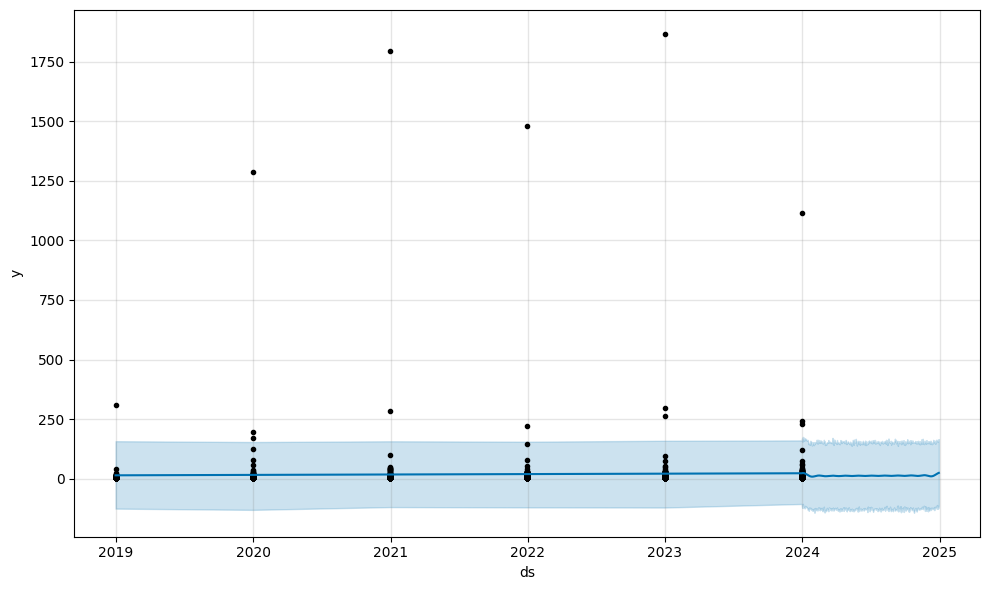

In [127]:
model.plot(forecast);

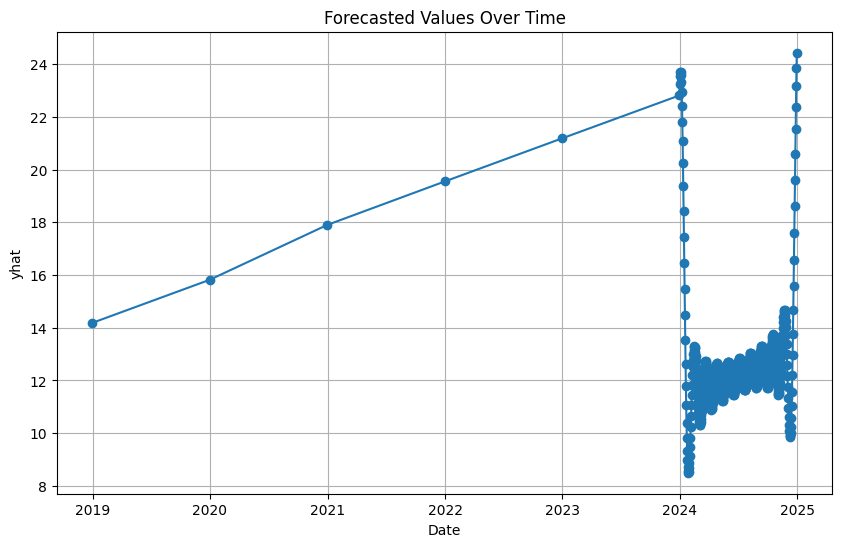

In [128]:
import matplotlib.pyplot as plt
import pandas as pd

# # Sample data
# data = {
#     'ds': ['2018-01-31', '2018-02-28', '2018-03-31'],
#     'yhat': [-28.423583, -22.012196, -13.283741]
# }

# # Create a DataFrame from the sample data
# df = pd.DataFrame(data)

# # Convert 'ds' column to datetime
# df['ds'] = pd.to_datetime(df['ds'])

# Plot the data
plt.figure(figsize=(10, 6))
plt.plot(forecast['ds'], forecast['yhat'], marker='o', linestyle='-')
plt.title('Forecasted Values Over Time')
plt.xlabel('Date')
plt.ylabel('yhat')
plt.grid(True)
plt.show()


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/prophet/plot.py:226: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/prophet/plot.py:349: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/prophet/plot.py:352: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on t

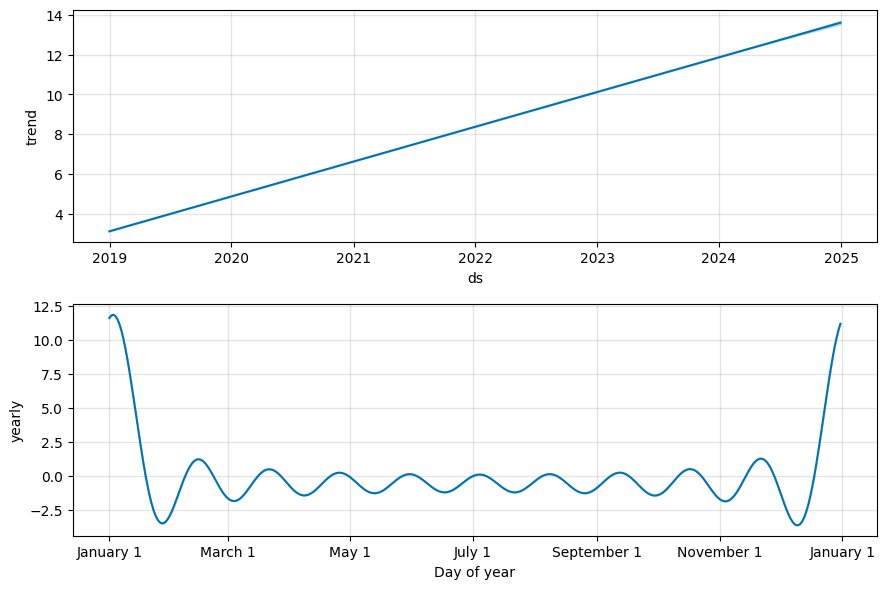

In [129]:
model.plot_components(forecast);

In [57]:
aggr_df=monthly_os.copy()
aggr_df.shape

(2726, 3)

05:46:13 - cmdstanpy - INFO - Chain [1] start processing
05:46:13 - cmdstanpy - INFO - Chain [1] done processing
/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

05:46:13 - cmdstanpy - INFO - Chain [1] start processing
05:46:13 - cmdstanpy - INFO - Chain [1] done processing
/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

05:46:13 - cmdstanpy - INFO - Chain [1] start processing
05:46:14 - 

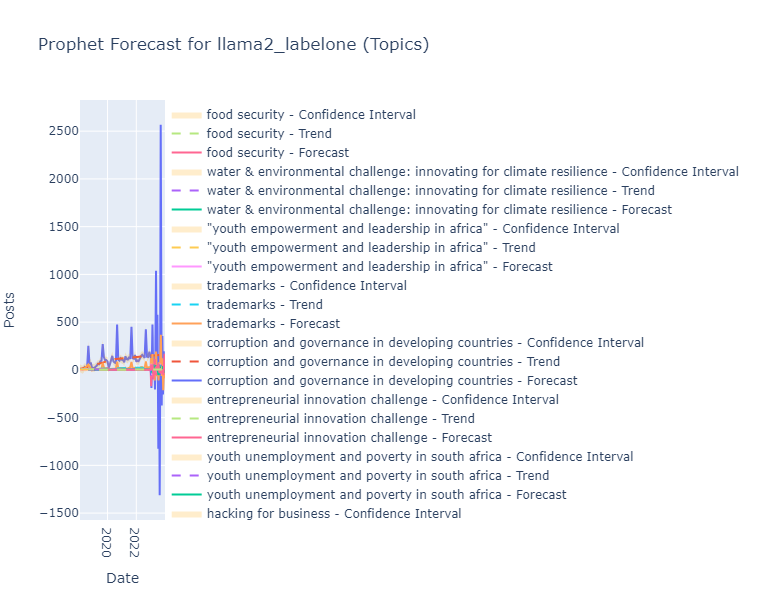

Metrics for visa application process in australia for african nationals:
MAE: 136.63339656106982
MSE: 63710.42386272381
RMSE: 252.40923886166252
MAPE: 107.0857428715857%
R-squared (R2): -0.22940437168392025


Metrics for nan:
MAE: 51.10062890720576
MSE: 3304.518844157455
RMSE: 57.484944499907584
MAPE: 416.3678413847215%
R-squared (R2): -1.5508902159752633


Metrics for hacking for business:
MAE: nan
MSE: nan
RMSE: nan
MAPE: nan%
R-squared (R2): nan


Metrics for youth unemployment and poverty in south africa:
MAE: 9.811100521415892
MSE: 107.54382027290237
RMSE: 10.370333662563725
MAPE: 910.5532315978315%
R-squared (R2): -572.5670414554793


Metrics for entrepreneurial innovation challenge:
MAE: 34.21865947788783
MSE: 1457.6624598184728
RMSE: 38.179345984687494
MAPE: 3421.865947788783%
R-squared (R2): -inf


Metrics for corruption and governance in developing countries:
MAE: 9.028272979304363
MSE: 105.76157061668778
RMSE: 10.284044467848618
MAPE: 487.5515426057174%
R-squared (R2): -28.7

In [143]:
import pandas as pd
from prophet import Prophet
import plotly.graph_objects as go
import numpy as np

# Assuming 'aggr_df' is already loaded and formatted correctly
aggr_df = monthly_os.copy()

# Get the top ten 'llama2_labelone' values based on the number of posts
top_themes = aggr_df['llama2_labelone'].value_counts().nlargest(10).index.tolist()

# Initialize lists to store metrics
mae_list = []
mse_list = []
rmse_list = []
mape_list = []
r2_list = []

# Create a figure for the top ten 'llama2_labelone' values
fig = go.Figure()

for theme in top_themes:
    # Filter the DataFrame for the current 'llama2_labelone'
    df_subset = aggr_df[aggr_df['llama2_labelone'] == theme]

    # Reset the index and rename the columns as 'ds' and 'y' for Prophet
    df_subset = df_subset[['Date', 'Posts']].reset_index(drop=True)
    df_subset.columns = ['ds', 'y']

    # Remove the timezone information from the 'ds' column
    df_subset['ds'] = pd.to_datetime(df_subset['ds']).dt.tz_localize(None)

    # Split the data into training (first four years) and testing (last year)
    train_data = df_subset[df_subset['ds'] < '2023-01-01']  # Training: Before 2023
    test_data = df_subset[df_subset['ds'] >= '2023-01-01']  # Testing: 2023 data

    # Create a Prophet model with a weekly seasonality component for each 'llama2_labelone'
    model = Prophet(weekly_seasonality=True)

    # Fit the model to the training data (first four years)
    model.fit(train_data)

    # Generate future dates for forecasting (365 days for the fifth year)
    future = model.make_future_dataframe(periods=365)

    # Make predictions for the entire period (training + prediction)
    forecast = model.predict(future)

    # Get the predicted values for the fifth year (2023)
    future_forecast = forecast[forecast['ds'] >= '2023-01-01']['yhat'].values

    # Use the actual data from the test period (2023) to calculate metrics
    actual_values = test_data['y'].values  # Actual data for 2023

    # Ensure the forecast length matches the actual data length
    future_forecast = future_forecast[:len(actual_values)]

    # Calculate performance metrics
    mae = np.mean(np.abs(future_forecast - actual_values))
    mse = np.mean((future_forecast - actual_values) ** 2)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((actual_values - future_forecast) / actual_values)) * 100
    r2 = 1 - (np.sum((actual_values - future_forecast) ** 2) / np.sum((actual_values - np.mean(actual_values)) ** 2))

    # Append metrics to the lists
    mae_list.append(mae)
    mse_list.append(mse)
    rmse_list.append(rmse)
    mape_list.append(mape)
    r2_list.append(r2)

    # Add a trace for the forecasted values with the corresponding 'llama2_labelone' name
    fig.add_trace(go.Scatter(x=future['ds'], y=forecast['yhat'], name=f'{theme} - Forecast'))

    # Add the trend line, upper and lower boundaries
    fig.add_trace(go.Scatter(x=forecast['ds'], y=forecast['trend'], mode='lines', name=f'{theme} - Trend', line=dict(dash='dash')))

    # Add the uncertainty interval (upper and lower bounds) for the forecast
    fig.add_trace(go.Scatter(
        x=forecast['ds'],
        y=forecast['yhat_upper'],
        mode='lines',
        line=dict(width=0),
        showlegend=False
    ))
    fig.add_trace(go.Scatter(
        x=forecast['ds'],
        y=forecast['yhat_lower'],
        fill='tonexty',
        mode='lines',
        line=dict(width=0),
        fillcolor='rgba(255, 165, 0, 0.2)',  # Confidence interval fill color (light orange)
        name=f'{theme} - Confidence Interval'
    ))

# Update layout for the graph
fig.update_layout(
    title='Prophet Forecast for llama2_labelone (Topics)',
    xaxis_title='Date',
    yaxis_title='Posts',
    height=600,
    width=800
)

# Show the graph
fig.show()

# Print the performance metrics
for i, theme in enumerate(top_themes):
    print(f'Metrics for {theme}:')
    print(f'MAE: {mae_list[i]}')
    print(f'MSE: {mse_list[i]}')
    print(f'RMSE: {rmse_list[i]}')
    print(f'MAPE: {mape_list[i]}%')
    print(f'R-squared (R2): {r2_list[i]}')
    print('\n')


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.08 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=585.335, Time=0.00 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=575.133, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.02 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=583.344, Time=0.00 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=572.389, Time=0.02 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=572.512, Time=0.02 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.04 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.06 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.08 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=570.459, Time=0.01 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=573.168, Time=0.01 sec
 ARIMA(3,1,0)(0,0,0)[0]             : AIC=570.615, Time=0.02 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=566.681, Time=0.03 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=564.719, Time=0.02 sec
 A

/tmp/ipykernel_897567/3206727197.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_897567/3206727197.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.07 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=192.231, Time=0.00 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=190.151, Time=0.01 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=191.593, Time=0.01 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=255.140, Time=0.00 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=189.787, Time=0.01 sec
 ARIMA(3,0,0)(0,0,0)[0] intercept   : AIC=190.881, Time=0.02 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=191.470, Time=0.02 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=191.195, Time=0.02 sec
 ARIMA(3,0,1)(0,0,0)[0] intercept   : AIC=191.274, Time=0.04 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=195.464, Time=0.01 sec

Best model:  ARIMA(2,0,0)(0,0,0)[0] intercept
Total fit time: 0.221 seconds
Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.06 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=124.289, Time=0.00 sec


/tmp/ipykernel_897567/3206727197.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_897567/3206727197.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=187.060, Time=0.03 sec

Best model:  ARIMA(0,0,0)(0,0,0)[0] intercept
Total fit time: 0.093 seconds
Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=134.760, Time=0.06 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=128.553, Time=0.00 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=130.553, Time=0.01 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=130.553, Time=0.01 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=166.565, Time=0.00 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=131.086, Time=0.04 sec

Best model:  ARIMA(0,0,0)(0,0,0)[0] intercept
Total fit time: 0.124 seconds
Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=144.617, Time=0.03 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=141.902, Time=0.00 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=140.052, Time=0.01 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=140.338, Time=0.01 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=181

/tmp/ipykernel_897567/3206727197.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_897567/3206727197.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=142.050, Time=0.01 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=142.049, Time=0.01 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=144.048, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=148.883, Time=0.01 sec

Best model:  ARIMA(1,0,0)(0,0,0)[0] intercept
Total fit time: 0.121 seconds
Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.06 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=117.866, Time=0.00 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=119.428, Time=0.01 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=119.303, Time=0.01 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=158.056, Time=0.00 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.04 sec

Best model:  ARIMA(0,0,0)(0,0,0)[0] intercept
Total fit time: 0.126 seconds
Performing stepwise search to minimize aic


/tmp/ipykernel_897567/3206727197.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_897567/3206727197.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.06 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=118.239, Time=0.00 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=119.215, Time=0.01 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=119.227, Time=0.01 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=149.108, Time=0.00 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=121.213, Time=0.02 sec

Best model:  ARIMA(0,0,0)(0,0,0)[0] intercept
Total fit time: 0.107 seconds
Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.06 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=72.476, Time=0.00 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=73.521, Time=0.01 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=73.702, Time=0.01 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=100.433, Time=0.00 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.04 sec

Best model:  ARIMA(0,0,0)(0,0,0)[0] intercept
Total fit time: 0.126 seconds


/tmp/ipykernel_897567/3206727197.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_897567/3206727197.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



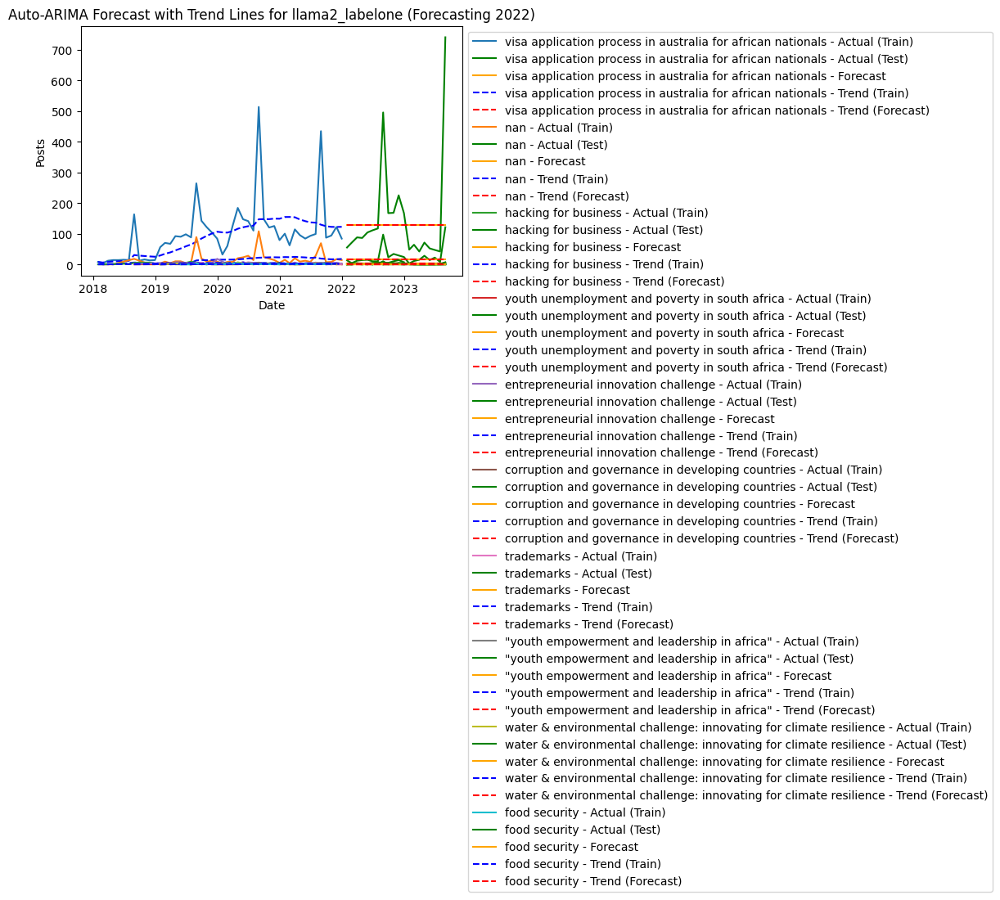

Metrics for visa application process in australia for african nationals:
MAE: 99.6445949868278
MSE: 28830.2144182396
RMSE: 169.79462423245207
MAPE: 84.22314461407711%
R-squared (R2): -0.013211163804402126


Metrics for nan:
MAE: 15.801219512195122
MSE: 930.4826591314695
RMSE: 30.503813845672962
MAPE: 68.16029900653994%
R-squared (R2): -0.08621618980416734


Metrics for hacking for business:
MAE: 3.2410038879868703
MSE: 20.101996958675805
RMSE: 4.483525059445504
MAPE: 47.011299387973835%
R-squared (R2): -0.5052977441754114


Metrics for youth unemployment and poverty in south africa:
MAE: 1.1360294117647058
MSE: 1.6516003460207613
RMSE: 1.2851460407365232
MAPE: 81.85661764705881%
R-squared (R2): -0.152069996134373


Metrics for entrepreneurial innovation challenge:
MAE: 2.022448979591837
MSE: 6.725306122448979
RMSE: 2.593319518001779
MAPE: 173.7687074829932%
R-squared (R2): -0.8487517531556805


Metrics for corruption and governance in developing countries:
MAE: 1.3506493506493507
MSE: 

In [168]:
import pandas as pd
import matplotlib.pyplot as plt
from pmdarima.arima import auto_arima
from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error, r2_score
import numpy as np

# Assuming 'aggr_df' is already loaded and formatted correctly
aggr_df = monthly_os.copy()

# Get the top ten common themes based on the count (using unique sentiments in this case)
top_ten_themes = aggr_df['llama2_labelone'].value_counts().nlargest(10).index.tolist()

# Initialize lists to store metrics
mae_list = []
mse_list = []
rmse_list = []
mape_list = []
r2_list = []

# Set up the Matplotlib figure
plt.figure(figsize=(12, 8))

for theme in top_ten_themes:
    # Filter the DataFrame for the current theme
    df_subset = aggr_df[aggr_df['llama2_labelone'] == theme]

    # Reset the index and rename the columns as 'ds' and 'y' for fitting the ARIMA model
    df_subset = df_subset.reset_index(drop=True)
    df_subset = df_subset[['Date', 'Posts']]  # Select the relevant columns
    df_subset.columns = ['ds', 'y']

    # Remove the timezone information from the 'ds' column
    df_subset['ds'] = pd.to_datetime(df_subset['ds']).dt.tz_localize(None)

    # Split the data into training (up to the end of 2021) and testing (the year 2022)
    train_data = df_subset[df_subset['ds'] < '2022-01-01']
    test_data = df_subset[df_subset['ds'] >= '2022-01-01']

    # Fit an Auto-ARIMA model to the training data (up to 2021)
    model = auto_arima(train_data['y'], seasonal=True, stepwise=True, trace=True)

    # Forecast for the length of the test data (the year 2022)
    n_periods = len(test_data)  # Number of periods to forecast
    forecast = model.predict(n_periods=n_periods)

    # Store the forecast in a DataFrame
    forecast_df = pd.DataFrame({
        'ds': test_data['ds'],  # Use the same dates as in the test data
        'yhat': forecast
    })

    # Calculate rolling average (trend) for training and forecasted data (window=12 for monthly trends)
    train_data['trend'] = train_data['y'].rolling(window=12, min_periods=1).mean()
    forecast_df['trend'] = forecast_df['yhat'].rolling(window=12, min_periods=1).mean()

    # Plot the actual and forecasted values
    plt.plot(train_data['ds'], train_data['y'], label=f'{theme} - Actual (Train)')
    plt.plot(test_data['ds'], test_data['y'], label=f'{theme} - Actual (Test)', color='green')
    plt.plot(forecast_df['ds'], forecast_df['yhat'], label=f'{theme} - Forecast', color='orange')

    # Plot the trend lines for both training and forecast
    plt.plot(train_data['ds'], train_data['trend'], label=f'{theme} - Trend (Train)', linestyle='--', color='blue')
    plt.plot(forecast_df['ds'], forecast_df['trend'], label=f'{theme} - Trend (Forecast)', linestyle='--', color='red')

    # Calculate performance metrics
    actual_values = test_data['y'].values  # Actual values from the year 2022
    mae = mean_absolute_error(actual_values, forecast)
    mse = mean_squared_error(actual_values, forecast)
    rmse = np.sqrt(mse)
    mape = mean_absolute_percentage_error(actual_values, forecast) * 100
    r2 = r2_score(actual_values, forecast)

    # Append metrics to the lists
    mae_list.append(mae)
    mse_list.append(mse)
    rmse_list.append(rmse)
    mape_list.append(mape)
    r2_list.append(r2)

# Set the title and labels
plt.title('Auto-ARIMA Forecast with Trend Lines for llama2_labelone (Forecasting 2022)')
plt.xlabel('Date')
plt.ylabel('Posts')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))

# Adjust layout to fit everything
plt.tight_layout()

# Show the plot
plt.show()

# Print the performance metrics for each theme
for i, theme in enumerate(top_ten_themes):
    print(f'Metrics for {theme}:')
    print(f'MAE: {mae_list[i]}')
    print(f'MSE: {mse_list[i]}')
    print(f'RMSE: {rmse_list[i]}')
    print(f'MAPE: {mape_list[i]}%')
    print(f'R-squared (R2): {r2_list[i]}')
    print('\n')


2024-09-14 06:39:23.770399: I tensorflow/core/common_runtime/process_util.cc:146] Creating new thread pool with default inter op setting: 2. Tune using inter_op_parallelism_threads for best performance.
2024-09-14 06:39:23.921172: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-14 06:39:23.921873: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-14 06:39:23.9

Training model for theme visa application process in australia for african nationals...
X_train shape: (18, 30, 1), y_train shape: (18,)
Epoch 1/50


2024-09-14 06:39:24.145445: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-14 06:39:24.146520: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-14 06:39:24.147419: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 1s 1s/step - loss: 0.0535
Epoch 2/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0480
Epoch 3/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0430
Epoch 4/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0386
Epoch 5/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0349
Epoch 6/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0318
Epoch 7/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0296
Epoch 8/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0284
Epoch 9/50
1/1 [==============================] - 0s 6ms/step - loss: 0.0283
Epoch 10/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0291
Epoch 11/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0303
Epoch 12/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0310
Epoch 13/50
1/1 [==============================] - 0s 5ms/step - loss: 0.0310
Epoch 1

2024-09-14 06:39:25.462709: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-14 06:39:25.463631: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-14 06:39:25.464368: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 0s 12ms/step
Training model for theme nan...
X_train shape: (11, 30, 1), y_train shape: (11,)
Epoch 1/50


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

2024-09-14 06:39:26.696348: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-14 06:39:26.697094: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder 

1/1 [==============================] - 1s 949ms/step - loss: 0.0541
Epoch 2/50
1/1 [==============================] - 0s 6ms/step - loss: 0.0474
Epoch 3/50
1/1 [==============================] - 0s 7ms/step - loss: 0.0418
Epoch 4/50
1/1 [==============================] - 0s 8ms/step - loss: 0.0371
Epoch 5/50
1/1 [==============================] - 0s 6ms/step - loss: 0.0331
Epoch 6/50
1/1 [==============================] - 0s 8ms/step - loss: 0.0298
Epoch 7/50
1/1 [==============================] - 0s 6ms/step - loss: 0.0270
Epoch 8/50
1/1 [==============================] - 0s 6ms/step - loss: 0.0248
Epoch 9/50
1/1 [==============================] - 0s 6ms/step - loss: 0.0232
Epoch 10/50
1/1 [==============================] - 0s 7ms/step - loss: 0.0220
Epoch 11/50
1/1 [==============================] - 0s 8ms/step - loss: 0.0214
Epoch 12/50
1/1 [==============================] - 0s 7ms/step - loss: 0.0213
Epoch 13/50
1/1 [==============================] - 0s 7ms/step - loss: 0.0216
Epoc

2024-09-14 06:39:28.422307: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-14 06:39:28.423247: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-14 06:39:28.423993: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 0s 12ms/step
Training model for theme hacking for business...
X_train shape: (14, 30, 1), y_train shape: (14,)
Epoch 1/50


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

2024-09-14 06:39:29.136114: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-14 06:39:29.136837: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder 

1/1 [==============================] - 1s 942ms/step - loss: 0.0482
Epoch 2/50
1/1 [==============================] - 0s 12ms/step - loss: 0.0419
Epoch 3/50
1/1 [==============================] - 0s 11ms/step - loss: 0.0363
Epoch 4/50
1/1 [==============================] - 0s 11ms/step - loss: 0.0312
Epoch 5/50
1/1 [==============================] - 0s 12ms/step - loss: 0.0267
Epoch 6/50
1/1 [==============================] - 0s 8ms/step - loss: 0.0227
Epoch 7/50
1/1 [==============================] - 0s 11ms/step - loss: 0.0194
Epoch 8/50
1/1 [==============================] - 0s 10ms/step - loss: 0.0168
Epoch 9/50
1/1 [==============================] - 0s 11ms/step - loss: 0.0150
Epoch 10/50
1/1 [==============================] - 0s 9ms/step - loss: 0.0141
Epoch 11/50
1/1 [==============================] - 0s 10ms/step - loss: 0.0143
Epoch 12/50
1/1 [==============================] - 0s 10ms/step - loss: 0.0153
Epoch 13/50
1/1 [==============================] - 0s 10ms/step - loss: 0

2024-09-14 06:39:30.937081: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-14 06:39:30.938005: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-14 06:39:30.938733: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 0s 12ms/step
Training model for theme youth unemployment and poverty in south africa...
X_train shape: (4, 30, 1), y_train shape: (4,)
Epoch 1/50


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

2024-09-14 06:39:31.425182: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-14 06:39:31.425909: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder 

1/1 [==============================] - 1s 964ms/step - loss: 0.3631
Epoch 2/50
1/1 [==============================] - 0s 33ms/step - loss: 0.3421
Epoch 3/50
1/1 [==============================] - 0s 10ms/step - loss: 0.3222
Epoch 4/50
1/1 [==============================] - 0s 8ms/step - loss: 0.3033
Epoch 5/50
1/1 [==============================] - 0s 8ms/step - loss: 0.2855
Epoch 6/50
1/1 [==============================] - 0s 8ms/step - loss: 0.2686
Epoch 7/50
1/1 [==============================] - 0s 8ms/step - loss: 0.2527
Epoch 8/50
1/1 [==============================] - 0s 8ms/step - loss: 0.2379
Epoch 9/50
1/1 [==============================] - 0s 9ms/step - loss: 0.2245
Epoch 10/50
1/1 [==============================] - 0s 9ms/step - loss: 0.2127
Epoch 11/50
1/1 [==============================] - 0s 9ms/step - loss: 0.2031
Epoch 12/50
1/1 [==============================] - 0s 9ms/step - loss: 0.1966
Epoch 13/50
1/1 [==============================] - 0s 9ms/step - loss: 0.1944
Ep

2024-09-14 06:39:33.157910: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-14 06:39:33.159068: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-14 06:39:33.160017: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 0s 12ms/step
Training model for theme entrepreneurial innovation challenge...
X_train shape: (5, 30, 1), y_train shape: (5,)
Epoch 1/50


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

2024-09-14 06:39:33.766942: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-14 06:39:33.767638: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder 

1/1 [==============================] - 1s 976ms/step - loss: 0.0504
Epoch 2/50
1/1 [==============================] - 0s 18ms/step - loss: 0.0414
Epoch 3/50
1/1 [==============================] - 0s 8ms/step - loss: 0.0332
Epoch 4/50
1/1 [==============================] - 0s 8ms/step - loss: 0.0257
Epoch 5/50
1/1 [==============================] - 0s 8ms/step - loss: 0.0190
Epoch 6/50
1/1 [==============================] - 0s 8ms/step - loss: 0.0133
Epoch 7/50
1/1 [==============================] - 0s 8ms/step - loss: 0.0087
Epoch 8/50
1/1 [==============================] - 0s 10ms/step - loss: 0.0056
Epoch 9/50
1/1 [==============================] - 0s 8ms/step - loss: 0.0042
Epoch 10/50
1/1 [==============================] - 0s 12ms/step - loss: 0.0047
Epoch 11/50
1/1 [==============================] - 0s 10ms/step - loss: 0.0068
Epoch 12/50
1/1 [==============================] - 0s 13ms/step - loss: 0.0086
Epoch 13/50
1/1 [==============================] - 0s 10ms/step - loss: 0.009

2024-09-14 06:39:35.489166: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-14 06:39:35.490283: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-14 06:39:35.491212: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 0s 12ms/step
Training model for theme corruption and governance in developing countries...
X_train shape: (3, 30, 1), y_train shape: (3,)
Epoch 1/50


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

2024-09-14 06:39:36.035883: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-14 06:39:36.036590: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder 

1/1 [==============================] - 1s 960ms/step - loss: 0.1059
Epoch 2/50
1/1 [==============================] - 0s 29ms/step - loss: 0.0947
Epoch 3/50
1/1 [==============================] - 0s 9ms/step - loss: 0.0850
Epoch 4/50
1/1 [==============================] - 0s 9ms/step - loss: 0.0769
Epoch 5/50
1/1 [==============================] - 0s 9ms/step - loss: 0.0700
Epoch 6/50
1/1 [==============================] - 0s 9ms/step - loss: 0.0645
Epoch 7/50
1/1 [==============================] - 0s 9ms/step - loss: 0.0603
Epoch 8/50
1/1 [==============================] - 0s 9ms/step - loss: 0.0573
Epoch 9/50
1/1 [==============================] - 0s 9ms/step - loss: 0.0555
Epoch 10/50
1/1 [==============================] - 0s 9ms/step - loss: 0.0549
Epoch 11/50
1/1 [==============================] - 0s 9ms/step - loss: 0.0554
Epoch 12/50
1/1 [==============================] - 0s 9ms/step - loss: 0.0564
Epoch 13/50
1/1 [==============================] - 0s 9ms/step - loss: 0.0576
Epo

2024-09-14 06:39:37.831062: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-14 06:39:37.832032: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-14 06:39:37.832737: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 0s 12ms/step
Training model for theme trademarks...
X_train shape: (4, 30, 1), y_train shape: (4,)
Epoch 1/50


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

2024-09-14 06:39:38.378968: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-14 06:39:38.379706: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder 

1/1 [==============================] - 1s 965ms/step - loss: 0.0080
Epoch 2/50
1/1 [==============================] - 0s 22ms/step - loss: 0.0073
Epoch 3/50
1/1 [==============================] - 0s 14ms/step - loss: 0.0073
Epoch 4/50
1/1 [==============================] - 0s 12ms/step - loss: 0.0073
Epoch 5/50
1/1 [==============================] - 0s 12ms/step - loss: 0.0070
Epoch 6/50
1/1 [==============================] - 0s 12ms/step - loss: 0.0067
Epoch 7/50
1/1 [==============================] - 0s 12ms/step - loss: 0.0066
Epoch 8/50
1/1 [==============================] - 0s 12ms/step - loss: 0.0066
Epoch 9/50
1/1 [==============================] - 0s 11ms/step - loss: 0.0065
Epoch 10/50
1/1 [==============================] - 0s 11ms/step - loss: 0.0063
Epoch 11/50
1/1 [==============================] - 0s 7ms/step - loss: 0.0061
Epoch 12/50
1/1 [==============================] - 0s 9ms/step - loss: 0.0059
Epoch 13/50
1/1 [==============================] - 0s 8ms/step - loss: 0.

2024-09-14 06:39:40.135838: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-14 06:39:40.136799: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-14 06:39:40.137574: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 0s 12ms/step
Not enough data for theme "youth empowerment and leadership in africa" after look-back period.
Training model for theme water & environmental challenge: innovating for climate resilience...
X_train shape: (11, 30, 1), y_train shape: (11,)
Epoch 1/50


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

2024-09-14 06:39:40.635532: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-14 06:39:40.636281: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder 

1/1 [==============================] - 1s 969ms/step - loss: 0.0786
Epoch 2/50
1/1 [==============================] - 0s 10ms/step - loss: 0.0726
Epoch 3/50
1/1 [==============================] - 0s 9ms/step - loss: 0.0672
Epoch 4/50
1/1 [==============================] - 0s 9ms/step - loss: 0.0623
Epoch 5/50
1/1 [==============================] - 0s 9ms/step - loss: 0.0578
Epoch 6/50
1/1 [==============================] - 0s 9ms/step - loss: 0.0538
Epoch 7/50
1/1 [==============================] - 0s 10ms/step - loss: 0.0503
Epoch 8/50
1/1 [==============================] - 0s 9ms/step - loss: 0.0473
Epoch 9/50
1/1 [==============================] - 0s 9ms/step - loss: 0.0449
Epoch 10/50
1/1 [==============================] - 0s 9ms/step - loss: 0.0431
Epoch 11/50
1/1 [==============================] - 0s 9ms/step - loss: 0.0420
Epoch 12/50
1/1 [==============================] - 0s 9ms/step - loss: 0.0418
Epoch 13/50
1/1 [==============================] - 0s 9ms/step - loss: 0.0424
Ep

2024-09-14 06:39:42.400373: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-14 06:39:42.401325: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-14 06:39:42.402102: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 0s 12ms/step
Not enough data for theme food security after look-back period.


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/sklearn/metrics/_regression.py:1211: UndefinedMetricWarning:

R^2 score is not well-defined with less than two samples.

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



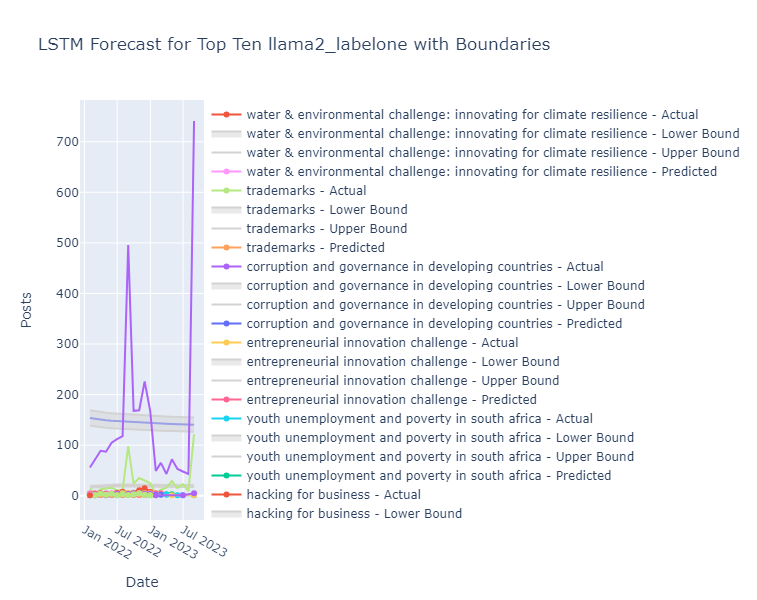

Cleaned Theme: visa application process in australia for african nationals
Mean Absolute Error (MAE): 106.6532958984375
Mean Squared Error (MSE): 28727.751144878617
Root Mean Squared Error (RMSE): 169.49262858566627
Mean Absolute Percentage Error (MAPE): 99.2086323816578%
R-squared (R2): -0.009610187032491169

Cleaned Theme: nan
Mean Absolute Error (MAE): 15.952569770812989
Mean Squared Error (MSE): 896.4292363689252
Root Mean Squared Error (RMSE): 29.94042812601258
Mean Absolute Percentage Error (MAPE): 75.9305540849937%
R-squared (R2): -0.046463295153290174

Cleaned Theme: hacking for business
Mean Absolute Error (MAE): 2.956720232963562
Mean Squared Error (MSE): 17.31954554066702
Root Mean Squared Error (RMSE): 4.161675809174355
Mean Absolute Percentage Error (MAPE): 49.731012712223354%
R-squared (R2): -0.2969394476630527

Cleaned Theme: youth unemployment and poverty in south africa
Mean Absolute Error (MAE): 1.308543249964714
Mean Squared Error (MSE): 2.2486560550537824
Root Mean 

In [169]:
import pandas as pd
import numpy as np
import plotly.graph_objects as go
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error, r2_score
import tensorflow as tf

# Assuming 'aggr_df' is loaded correctly
aggr_df = monthly_os.copy()

# Get the top 10 themes based on the number of posts
unique_themes = aggr_df['llama2_labelone'].value_counts().nlargest(10).index.tolist()

fig = go.Figure()
look_back = 30

# Initialize lists to store metrics
mae_list = []
mse_list = []
rmse_list = []
mape_list = []
r2_list = []

# Function to calculate upper and lower bounds
def calculate_bounds(predictions, percentage=10):
    upper_bound = predictions * (1 + percentage / 100)
    lower_bound = predictions * (1 - percentage / 100)
    return lower_bound, upper_bound

for theme in unique_themes:
    df_subset = aggr_df[aggr_df['llama2_labelone'] == theme].reset_index(drop=True)
    df_subset['Date'] = pd.to_datetime(df_subset['Date']).dt.tz_localize(None)

    # Scale data
    scaler = MinMaxScaler()
    df_subset['Posts'] = scaler.fit_transform(df_subset[['Posts']].values)

    # Create sequences for LSTM
    X, y = [], []
    for i in range(look_back, len(df_subset)):
        X.append(df_subset['Posts'].values[i-look_back:i])
        y.append(df_subset['Posts'].values[i])

    if len(X) < 1:  # Ensure there is enough data to train
        print(f"Not enough data for training on theme {theme}. Skipping...")
        continue

    X, y = np.array(X), np.array(y)
    X = X.reshape((X.shape[0], X.shape[1], 1))

    # Train-test split based on date (first 4 years for training, last year for testing)
    train_data = df_subset[df_subset['Date'] < '2022-01-01']
    test_data = df_subset[df_subset['Date'] >= '2022-01-01']
    
    # Preparing training data based on the new date split
    X_train, y_train = X[:len(train_data) - look_back], y[:len(train_data) - look_back]
    X_test, y_test = X[len(train_data) - look_back:], y[len(train_data) - look_back:]

    if X_train.shape[0] > 0:
        model = Sequential([
            LSTM(50, input_shape=(look_back, 1)),
            Dense(1)
        ])
        model.compile(optimizer='adam', loss='mean_squared_error')

        print(f'Training model for theme {theme}...')
        print(f'X_train shape: {X_train.shape}, y_train shape: {y_train.shape}')

        # Fit the model
        model.fit(X_train, y_train, epochs=50, batch_size=32, verbose=1)

        # Forecasting the last year (2022)
        future_X = df_subset['Posts'].values[-look_back:].reshape(1, look_back, 1)
        future_preds = []
        for _ in range(len(test_data)):  # Predict for the length of the test data
            future_pred = model.predict(future_X)
            future_preds.append(future_pred[0][0])
            future_X = np.append(future_X[:, 1:, :], future_pred.reshape(1, 1, 1), axis=1)

        # Inverse transform predictions to original scale
        future_preds = scaler.inverse_transform(np.array(future_preds).reshape(-1, 1)).flatten()

        # Calculate upper and lower bounds (10% deviation for simplicity)
        lower_bound, upper_bound = calculate_bounds(future_preds, percentage=10)

        # Adjust the length of actual values and future_preds to match
        actual_values = scaler.inverse_transform(y_test.reshape(-1, 1)).flatten()
        min_length = min(len(actual_values), len(future_preds))
        actual_values = actual_values[:min_length]
        future_preds = future_preds[:min_length]
        lower_bound = lower_bound[:min_length]
        upper_bound = upper_bound[:min_length]

        # Calculate performance metrics based on the matching lengths of actual data and forecasted values
        mae = mean_absolute_error(actual_values, future_preds)
        mse = mean_squared_error(actual_values, future_preds)
        rmse = np.sqrt(mse)
        mape = mean_absolute_percentage_error(actual_values, future_preds) * 100
        r2 = r2_score(actual_values, future_preds)

        # Store metrics
        mae_list.append(mae)
        mse_list.append(mse)
        rmse_list.append(rmse)
        mape_list.append(mape)
        r2_list.append(r2)

        # Plot predictions
        future_dates = pd.date_range(start=test_data['Date'].iloc[0], periods=len(future_preds), freq='M')
        fig.add_trace(go.Scatter(x=future_dates, y=future_preds, name=f'{theme} - Predicted'))
        fig.add_trace(go.Scatter(x=future_dates, y=upper_bound, fill=None, mode='lines', line_color='lightgrey', name=f'{theme} - Upper Bound'))
        fig.add_trace(go.Scatter(x=future_dates, y=lower_bound, fill='tonexty', mode='lines', line_color='lightgrey', name=f'{theme} - Lower Bound'))

        # Plot actual data for comparison
        actual_dates = test_data['Date'].iloc[:min_length]
        fig.add_trace(go.Scatter(x=actual_dates, y=actual_values, name=f'{theme} - Actual'))

    else:
        print(f"Not enough data for theme {theme} after look-back period.")

# Update layout for the graph
fig.update_layout(
    title='LSTM Forecast for Top Ten llama2_labelone with Boundaries',
    xaxis_title='Date',
    yaxis_title='Posts',
    height=600,
    width=800
)
fig.show()

# Display performance metrics
for i, theme in enumerate(unique_themes):
    if i < len(mae_list):  # Check if metrics were computed
        print(f'Cleaned Theme: {theme}')
        print(f'Mean Absolute Error (MAE): {mae_list[i]}')
        print(f'Mean Squared Error (MSE): {mse_list[i]}')
        print(f'Root Mean Squared Error (RMSE): {rmse_list[i]}')
        print(f'Mean Absolute Percentage Error (MAPE): {mape_list[i]}%')
        print(f'R-squared (R2): {r2_list[i]}')
        print()
    else:
        print(f'Insufficient data to compute metrics for theme: {theme}')


In [180]:
# import pandas as pd
# import numpy as np
# import plotly.graph_objects as go
# from sklearn.preprocessing import MinMaxScaler
# from tensorflow.keras.models import Sequential
# from tensorflow.keras.layers import LSTM, Dense
# from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error, r2_score
# import tensorflow as tf

# # Assuming 'aggr_df' is loaded correctly

# unique_themes = aggr_df['llama2_labelone'].value_counts().nlargest(10).index.tolist()

# fig = go.Figure()
# look_back = 30

# for theme in unique_themes:
#     df_subset = aggr_df[aggr_df['llama2_labelone'] == theme].reset_index(drop=True)
#     df_subset['Date'] = pd.to_datetime(df_subset['Date']).dt.tz_localize(None)

#     scaler = MinMaxScaler()
#     df_subset['Posts'] = scaler.fit_transform(df_subset[['Posts']].values)

#     X, y = [], []
#     for i in range(look_back, len(df_subset)):
#         X.append(df_subset['Posts'].values[i-look_back:i])
#         y.append(df_subset['Posts'].values[i])

#     if len(X) < 1:  # Ensure there is enough data to train
#         print(f"Not enough data for training on theme {theme}. Skipping...")
#         continue

#     X, y = np.array(X), np.array(y)
#     X = X.reshape((X.shape[0], X.shape[1], 1))

#     split = int(0.8 * len(X))
#     X_train, X_test, y_train, y_test = X[:split], X[split:], y[:split], y[split:]

#     # Continue only if there is training data
#     if X_train.shape[0] > 0:
#         model = Sequential([
#             LSTM(50, input_shape=(look_back, 1)),
#             Dense(1)
#         ])
#         model.compile(optimizer='adam', loss='mean_squared_error')

#         print(f'Training model for theme {theme}...')
#         print(f'X_train shape: {X_train.shape}, y_train shape: {y_train.shape}')

#         # Fit model
#         model.fit(X_train, y_train, epochs=50, batch_size=32, verbose=1)

#         y_pred = model.predict(X_test)
#         y_pred = scaler.inverse_transform(y_pred)
#         y_test = scaler.inverse_transform(y_test.reshape(-1, 1))

#         fig.add_trace(go.Scatter(x=df_subset['Date'][split+look_back:], y=y_pred.flatten(), name=f'{theme} - Predicted'))
#         fig.add_trace(go.Scatter(x=df_subset['Date'][split+look_back:], y=y_test.flatten(), name=f'{theme} - Actual'))

#  # Calculate performance metrics
#         mae = mean_absolute_error(y_test, y_pred)
#         mse = mean_squared_error(y_test, y_pred)
#         rmse = np.sqrt(mse)
#         mape = mean_absolute_percentage_error(y_test, y_pred) * 100
#         r2 = r2_score(y_test, y_pred)

#         # Store metrics
#         mae_list.append(mae)
#         mse_list.append(mse)
#         rmse_list.append(rmse)
#         mape_list.append(mape)
#         r2_list.append(r2)

#         # Plot predictions
#         actual_dates = df_subset['Date'].values[split_index+look_back:]
#         fig.add_trace(go.Scatter(x=actual_dates, y=y_pred.flatten(), name=f'{theme} - Predicted'))
#         fig.add_trace(go.Scatter(x=actual_dates, y=y_test.flatten(), name=f'{theme} - Actual'))
#     else:
#         print(f"Not enough data for theme {theme} after look-back period.")

# # # Graph settings
# # fig.update_layout(
# #     title='LSTM Forecast for Top Ten Cleaned Themes',
# #     xaxis_title='Date',
# #     yaxis_title='Posts',
# #     height=600,
# #     width=800
# # )
# # fig.show()

# # Display performance metrics
# for i, theme in enumerate(unique_themes):
#     if i < len(mae_list):  # Check if metrics were computed
#         print(f'Cleaned Theme: {theme}')
#         print(f'Mean Absolute Error (MAE): {mae_list[i]}')
#         print(f'Mean Squared Error (MSE): {mse_list[i]}')
#         print(f'Root Mean Squared Error (RMSE): {rmse_list[i]}')
#         print(f'Mean Absolute Percentage Error (MAPE): {mape_list[i]}%')
#         print(f'R-squared (R2): {r2_list[i]}')
#         print()
#     else:
#         print(f'Insufficient data to compute metrics for theme: {theme}')

# fig.update_layout(title='LSTM Forecast for Top Ten Cleaned Themes', xaxis_title='Date', yaxis_title='Posts', height=600, width=800)
# fig.show()


In [192]:
aggr_df=monthly_os.copy()

100%|██████████| 50/50 [00:03<00:00, 12.56it/s, epoch=10/10, avg_epoch_loss=1.78]


Skipping theme hacking for business due to lack of test data.


100%|██████████| 50/50 [00:03<00:00, 13.01it/s, epoch=10/10, avg_epoch_loss=-.325]


Skipping theme trademarks due to lack of test data.


100%|██████████| 50/50 [00:03<00:00, 12.65it/s, epoch=10/10, avg_epoch_loss=-1.36]


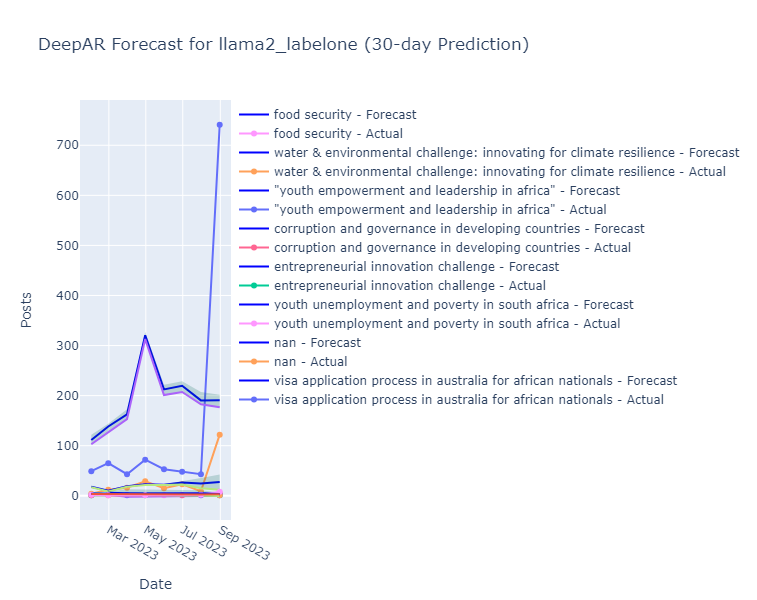

Cleaned Theme: visa application process in australia for african nationals
MAE: 191.5649061203003
MSE: 58074.60037669991
RMSE: 240.9867224074802
MAPE: 242.39%
R-squared (R2): -0.12065136432647705

Cleaned Theme: nan
MAE: 18.14516770839691
MSE: 1182.6114908926425
RMSE: 34.38911878621845
MAPE: 89.44%
R-squared (R2): 0.08709496259689331

Cleaned Theme: youth unemployment and poverty in south africa
MAE: 0.9208201915025711
MSE: 1.3244911288332668
RMSE: 1.1508653825853252
MAPE: 69.27%
R-squared (R2): -6.0639519691467285

Cleaned Theme: entrepreneurial innovation challenge
MAE: 2.303126096725464
MSE: 6.069792350664045
RMSE: 2.4636948574578073
MAPE: 230.31%
R-squared (R2): 0.0

Cleaned Theme: corruption and governance in developing countries
MAE: 1.6818877855936687
MSE: 3.2148760909871803
RMSE: 1.793007554637509
MAPE: 104.00%
R-squared (R2): 0.09581607580184937

Cleaned Theme: "youth empowerment and leadership in africa"
MAE: 3.3831098675727844
MSE: 12.163604770346481
RMSE: 3.487635985928933


In [193]:
import pandas as pd
import numpy as np
from gluonts.dataset.common import ListDataset
from gluonts.mx.model.deepar import DeepAREstimator
from gluonts.mx.trainer import Trainer
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import plotly.graph_objects as go
import plotly.offline as pyo

# Assuming 'aggr_df' is loaded with 'Date', 'cleaned_theme', and 'Posts'
# Convert 'Date' to datetime and set it as the index if not already done
aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])
aggr_df.set_index('Date', inplace=True)

# Define hyperparameters for the DeepAR model
prediction_length = 30  # Predict the next 30 days
context_length = 90  # Use the previous 90 days for context
freq = 'D'  # Daily frequency

# Get unique 'cleaned_theme' values
unique_themes = aggr_df['llama2_labelone'].value_counts().nlargest(10).index.tolist()

# Initialize lists to store performance metrics and successful themes
mae_list = []
mse_list = []
rmse_list = []
mape_list = []
r2_list = []
successful_themes = []  # Keep track of themes for which metrics were calculated

# Create a figure for all 'cleaned_theme' values using Plotly
fig = go.Figure()

for theme in unique_themes:
    # Filter the DataFrame for the current 'cleaned_theme'
    df_subset = aggr_df[aggr_df['llama2_labelone'] == theme]['Posts'].to_frame()
    df_subset.rename(columns={'Posts': 'y'}, inplace=True)

    # Split data into training (before 2023) and test (last year of data)
    train_data = df_subset[df_subset.index < '2023-01-01']
    test_data = df_subset[df_subset.index >= '2023-01-01']

    # If there's no data for testing, skip the iteration
    if len(test_data) == 0:
        print(f"Skipping theme {theme} due to lack of test data.")
        continue

    # Create training dataset for DeepAR
    train_ds = ListDataset(
        [{"start": train_data.index[0], "target": train_data.y}],
        freq=freq
    )

    # Define and train the DeepAR estimator
    estimator = DeepAREstimator(
        prediction_length=prediction_length,
        context_length=context_length,
        freq=freq,
        trainer=Trainer(epochs=10)
    )
    predictor = estimator.train(training_data=train_ds)

    # Creating test dataset for prediction (use the last 90 days of training data as context)
    test_ds = ListDataset(
        [{"start": train_data.index[0], "target": train_data.y}],
        freq=freq
    )

    # Generate forecasts for the test period (2023)
    forecast_it = predictor.predict(test_ds)
    forecast = next(forecast_it)

    # Extract forecast mean, lower, and upper bounds for the next 30 days
    forecast_mean = forecast.mean[:prediction_length]
    forecast_lower = forecast.quantile(0.1)[:prediction_length]
    forecast_upper = forecast.quantile(0.9)[:prediction_length]

    # Extract actual values for the available days in the test period
    actual_values = test_data['y'].values[:min(len(test_data), prediction_length)]  # Take the overlapping period

    # Ensure the forecast and actual values have the same length
    forecast_mean = forecast_mean[:len(actual_values)]
    forecast_lower = forecast_lower[:len(actual_values)]
    forecast_upper = forecast_upper[:len(actual_values)]

    # If actual_values or forecast_mean has no data, skip this theme
    if len(actual_values) == 0 or len(forecast_mean) == 0:
        print(f"Skipping theme {theme} due to lack of forecast or actual values.")
        continue

    # Calculate performance metrics
    mae = mean_absolute_error(actual_values, forecast_mean)
    mse = mean_squared_error(actual_values, forecast_mean)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((actual_values - forecast_mean) / actual_values)) * 100
    r2 = r2_score(actual_values, forecast_mean)

    # Append metrics to the respective lists and store the theme
    mae_list.append(mae)
    mse_list.append(mse)
    rmse_list.append(rmse)
    mape_list.append(mape)
    r2_list.append(r2)
    successful_themes.append(theme)

    # Plot the actual values, forecast mean, and confidence intervals using Plotly
    fig.add_trace(go.Scatter(x=test_data.index[:len(actual_values)], y=actual_values, mode='lines+markers', name=f'{theme} - Actual'))
    fig.add_trace(go.Scatter(x=test_data.index[:len(actual_values)], y=forecast_mean, mode='lines', name=f'{theme} - Forecast', line=dict(color='blue')))
    fig.add_trace(go.Scatter(
        x=test_data.index[:len(actual_values)], y=forecast_upper, mode='lines', line=dict(width=0), showlegend=False))
    fig.add_trace(go.Scatter(
        x=test_data.index[:len(actual_values)], y=forecast_lower, fill='tonexty', mode='lines', fillcolor='rgba(0, 100, 80, 0.2)', showlegend=False))

# Update layout for the graph using Plotly
fig.update_layout(
    title='DeepAR Forecast for llama2_labelone (30-day Prediction)',
    xaxis_title='Date',
    yaxis_title='Posts',
    height=600,
    width=800,
    showlegend=True
)

# Show the graph using Plotly
pyo.iplot(fig)

# Print the performance metrics only for the themes that were processed successfully
for i, theme in enumerate(successful_themes):
    print(f'Cleaned Theme: {theme}')
    print(f'MAE: {mae_list[i]}')
    print(f'MSE: {mse_list[i]}')
    print(f'RMSE: {rmse_list[i]}')
    print(f'MAPE: {mape_list[i]:.2f}%')
    print(f'R-squared (R2): {r2_list[i]}')
    print()


In [195]:
aggr_df=monthly_os.copy()

100%|██████████| 50/50 [00:02<00:00, 22.78it/s, epoch=10/10, avg_epoch_loss=2.54]


Skipping theme hacking for business due to lack of test data.


100%|██████████| 50/50 [00:02<00:00, 22.62it/s, epoch=10/10, avg_epoch_loss=0.097]


Skipping theme trademarks due to lack of test data.


100%|██████████| 50/50 [00:02<00:00, 21.15it/s, epoch=10/10, avg_epoch_loss=-.883]


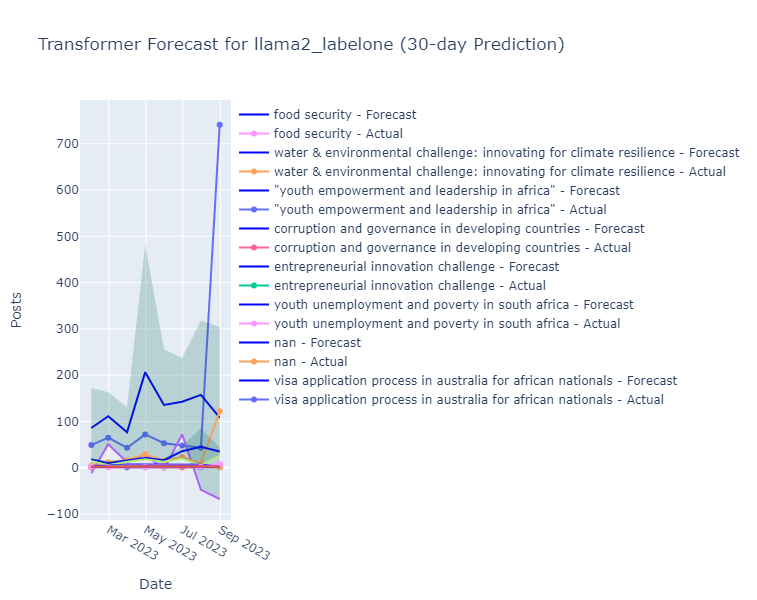

Cleaned Theme: visa application process in australia for african nationals
MAE: 146.9478883743286
MSE: 56499.94596859038
RMSE: 237.69717282414274
MAPE: 139.45%
R-squared (R2): -0.09026551246643066

Cleaned Theme: nan
MAE: 20.200419664382935
MSE: 1166.352494217906
RMSE: 34.151903229804134
MAPE: 115.94%
R-squared (R2): 0.09964585304260254

Cleaned Theme: youth unemployment and poverty in south africa
MAE: 0.5325444042682648
MSE: 0.28438088007333917
RMSE: 0.5332737384058389
MAPE: 47.19%
R-squared (R2): -0.5166980028152466

Cleaned Theme: entrepreneurial innovation challenge
MAE: 2.9781150023142495
MSE: 9.067187844286858
RMSE: 3.0111771525911353
MAPE: 297.81%
R-squared (R2): 0.0

Cleaned Theme: corruption and governance in developing countries
MAE: 2.1413987477620444
MSE: 5.673974308039154
RMSE: 2.3820105600183963
MAPE: 195.96%
R-squared (R2): -0.595805287361145

Cleaned Theme: "youth empowerment and leadership in africa"
MAE: 3.7464739084243774
MSE: 18.179441406788044
RMSE: 4.263735616426

In [196]:
import pandas as pd
import numpy as np
from gluonts.dataset.common import ListDataset
from gluonts.mx.model.transformer import TransformerEstimator
from gluonts.mx.trainer import Trainer
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import plotly.graph_objects as go
import plotly.offline as pyo

# Assuming 'aggr_df' is loaded with 'Date', 'llama2_labelone', and 'Posts'
# Convert 'Date' to datetime and set it as the index if not already done
aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])
aggr_df.set_index('Date', inplace=True)

# Define hyperparameters for the Transformer model
prediction_length = 30  # Predict the next 30 days
context_length = 90  # Use the previous 90 days for context
freq = 'D'  # Daily frequency

# Get unique 'llama2_labelone' values (top 10 themes)
unique_themes = aggr_df['llama2_labelone'].value_counts().nlargest(10).index.tolist()

# Initialize lists to store performance metrics and successful themes
mae_list = []
mse_list = []
rmse_list = []
mape_list = []
r2_list = []
successful_themes = []  # Keep track of themes for which metrics were calculated

# Create a figure for all 'llama2_labelone' values using Plotly
fig = go.Figure()

for theme in unique_themes:
    # Filter the DataFrame for the current 'llama2_labelone'
    df_subset = aggr_df[aggr_df['llama2_labelone'] == theme]['Posts'].to_frame()
    df_subset.rename(columns={'Posts': 'y'}, inplace=True)

    # Split data into training (before 2023) and test (last year of data)
    train_data = df_subset[df_subset.index < '2023-01-01']
    test_data = df_subset[df_subset.index >= '2023-01-01']

    # If there's no data for testing, skip the iteration
    if len(test_data) == 0:
        print(f"Skipping theme {theme} due to lack of test data.")
        continue

    # Create training dataset for the Transformer model
    train_ds = ListDataset(
        [{"start": train_data.index[0], "target": train_data.y}],
        freq=freq
    )

    # Define and train the Transformer estimator
    estimator = TransformerEstimator(
        prediction_length=prediction_length,
        context_length=context_length,
        freq=freq,
        trainer=Trainer(epochs=10)
    )
    predictor = estimator.train(training_data=train_ds)

    # Create test dataset for prediction (use the last 90 days of training data as context)
    test_ds = ListDataset(
        [{"start": train_data.index[0], "target": train_data.y}],
        freq=freq
    )

    # Generate forecasts for the test period (2023)
    forecast_it = predictor.predict(test_ds)
    forecast = next(forecast_it)

    # Extract forecast mean, lower, and upper bounds for the next 30 days
    forecast_mean = forecast.mean[:prediction_length]
    forecast_lower = forecast.quantile(0.1)[:prediction_length]
    forecast_upper = forecast.quantile(0.9)[:prediction_length]

    # Extract actual values for the available days in the test period
    actual_values = test_data['y'].values[:min(len(test_data), prediction_length)]  # Take the overlapping period

    # Ensure the forecast and actual values have the same length
    forecast_mean = forecast_mean[:len(actual_values)]
    forecast_lower = forecast_lower[:len(actual_values)]
    forecast_upper = forecast_upper[:len(actual_values)]

    # If actual_values or forecast_mean has no data, skip this theme
    if len(actual_values) == 0 or len(forecast_mean) == 0:
        print(f"Skipping theme {theme} due to lack of forecast or actual values.")
        continue

    # Calculate performance metrics
    mae = mean_absolute_error(actual_values, forecast_mean)
    mse = mean_squared_error(actual_values, forecast_mean)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((actual_values - forecast_mean) / actual_values)) * 100
    r2 = r2_score(actual_values, forecast_mean)

    # Append metrics to the respective lists and store the theme
    mae_list.append(mae)
    mse_list.append(mse)
    rmse_list.append(rmse)
    mape_list.append(mape)
    r2_list.append(r2)
    successful_themes.append(theme)

    # Plot the actual values, forecast mean, and confidence intervals using Plotly
    fig.add_trace(go.Scatter(x=test_data.index[:len(actual_values)], y=actual_values, mode='lines+markers', name=f'{theme} - Actual'))
    fig.add_trace(go.Scatter(x=test_data.index[:len(actual_values)], y=forecast_mean, mode='lines', name=f'{theme} - Forecast', line=dict(color='blue')))
    fig.add_trace(go.Scatter(
        x=test_data.index[:len(actual_values)], y=forecast_upper, mode='lines', line=dict(width=0), showlegend=False))
    fig.add_trace(go.Scatter(
        x=test_data.index[:len(actual_values)], y=forecast_lower, fill='tonexty', mode='lines', fillcolor='rgba(0, 100, 80, 0.2)', showlegend=False))

# Update layout for the graph using Plotly
fig.update_layout(
    title='Transformer Forecast for llama2_labelone (30-day Prediction)',
    xaxis_title='Date',
    yaxis_title='Posts',
    height=600,
    width=800,
    showlegend=True
)

# Show the graph using Plotly
pyo.iplot(fig)

# Print the performance metrics only for the themes that were processed successfully
for i, theme in enumerate(successful_themes):
    print(f'Cleaned Theme: {theme}')
    print(f'MAE: {mae_list[i]}')
    print(f'MSE: {mse_list[i]}')
    print(f'RMSE: {rmse_list[i]}')
    print(f'MAPE: {mape_list[i]:.2f}%')
    print(f'R-squared (R2): {r2_list[i]}')
    print()


In [54]:
df3=df.copy()

In [59]:
aggr_df=monthly_os.copy()


In [200]:
import pandas as pd

# Data for Prophet
prophet_data = {
    "Theme": [
        "visa application process in australia for african nationals", "nan", "hacking for business", 
        "youth unemployment and poverty in south africa", "entrepreneurial innovation challenge", 
        "corruption and governance in developing countries", "trademarks", 
        "youth empowerment and leadership in africa", "water & environmental challenge: innovating for climate resilience", "food security"
    ],
    "MAE": [136.63, 51.10, float('nan'), 9.81, 34.22, 9.03, float('nan'), 9.59, 4.16, 5.30],
    "MSE": [63710.42, 3304.52, float('nan'), 107.54, 1457.66, 105.76, float('nan'), 109.58, 18.15, 34.78],
    "RMSE": [252.41, 57.48, float('nan'), 10.37, 38.18, 10.28, float('nan'), 10.47, 4.26, 5.90],
    "MAPE": [107.09, 416.37, float('nan'), 910.55, 3421.87, 487.55, float('nan'), 736.87, 415.75, 323.26],
    "R2": [-0.23, -1.55, float('nan'), -572.57, float('-inf'), -28.75, float('nan'), -437.34, float('-inf'), -4.00]
}

# Data for ARIMA
arima_data = {
    "Theme": [
        "visa application process in australia for african nationals", "nan", "hacking for business", 
        "youth unemployment and poverty in south africa", "entrepreneurial innovation challenge", 
        "corruption and governance in developing countries", "trademarks", 
        "youth empowerment and leadership in africa", "water & environmental challenge: innovating for climate resilience", "food security"
    ],
    "MAE": [99.64, 15.80, 3.24, 1.14, 2.02, 1.35, 1.19, 1.43, 1.28, 1.07],
    "MSE": [28830.21, 930.48, 20.10, 1.65, 6.73, 2.27, 1.83, 5.76, 1.95, 3.08],
    "RMSE": [169.79, 30.50, 4.48, 1.29, 2.59, 1.51, 1.35, 2.40, 1.40, 1.76],
    "MAPE": [84.22, 68.16, 47.01, 81.86, 173.77, 66.36, 77.55, 79.02, 86.76, 54.75],
    "R2": [-0.01, -0.09, -0.51, -0.15, -0.85, -0.03, -0.05, -0.01, -0.07, -0.02]
}

# Data for LSTM
lstm_data = {
    "Theme": [
        "visa application process in australia for african nationals", "nan", "hacking for business", 
        "youth unemployment and poverty in south africa", "entrepreneurial innovation challenge", 
        "corruption and governance in developing countries", "trademarks", 
        "youth empowerment and leadership in africa"
    ],
    "MAE": [106.65, 15.95, 2.96, 1.31, 1.94, 1.34, 1.18, 1.33],
    "MSE": [28727.75, 896.43, 17.32, 2.25, 6.16, 2.95, 2.25, 1.78],
    "RMSE": [169.49, 29.94, 4.16, 1.50, 2.48, 1.72, 1.50, 1.33],
    "MAPE": [99.21, 75.93, 49.73, 102.03, 166.09, 51.06, 49.43, 133.40],
    "R2": [-0.01, -0.05, -0.30, -0.57, -0.69, -0.34, -0.29, float('nan')]
}

# Data for DeepAR
deepar_data = {
    "Theme": [
        "visa application process in australia for african nationals", "nan", 
        "youth unemployment and poverty in south africa", "entrepreneurial innovation challenge", 
        "corruption and governance in developing countries", 
        "youth empowerment and leadership in africa", 
        "water & environmental challenge: innovating for climate resilience", "food security"
    ],
    "MAE": [191.56, 18.15, 0.92, 2.30, 1.68, 3.38, 1.93, 2.90],
    "MSE": [58074.60, 1182.61, 1.32, 6.07, 3.21, 12.16, 4.67, 9.25],
    "RMSE": [240.99, 34.39, 1.15, 2.46, 1.79, 3.49, 2.16, 3.04],
    "MAPE": [242.39, 89.44, 69.27, 230.31, 104.00, 266.96, 192.57, 170.37],
    "R2": [-0.12, 0.09, -6.06, 0.0, 0.1, -47.65, 0.0, -0.33]
}

# Data for Transformer
transformer_data = {
    "Theme": [
        "visa application process in australia for african nationals", "nan", 
        "youth unemployment and poverty in south africa", "entrepreneurial innovation challenge", 
        "corruption and governance in developing countries", 
        "youth empowerment and leadership in africa", 
        "water & environmental challenge: innovating for climate resilience", "food security"
    ],
    "MAE": [146.95, 20.20, 0.53, 2.98, 2.14, 3.75, 2.55, 1.99],
    "MSE": [56499.95, 1166.35, 0.28, 9.07, 5.67, 18.18, 8.29, 8.17],
    "RMSE": [237.70, 34.15, 0.53, 3.01, 2.38, 4.26, 2.88, 2.86],
    "MAPE": [139.45, 115.94, 47.19, 297.81, 195.96, 330.45, 255.32, 83.85],
    "R2": [-0.09, 0.10, -0.52, 0.0, -0.60, -71.72, 0.0, -0.17]
}

# Create dataframes for each model
prophet_df = pd.DataFrame(prophet_data)
arima_df = pd.DataFrame(arima_data)
lstm_df = pd.DataFrame(lstm_data)
deepar_df = pd.DataFrame(deepar_data)
transformer_df = pd.DataFrame(transformer_data)

# Compute the average for each metric for each model, skipping the 'Theme' column
prophet_avg = prophet_df[['MAE', 'MSE', 'RMSE', 'MAPE', 'R2']].mean()
arima_avg = arima_df[['MAE', 'MSE', 'RMSE', 'MAPE', 'R2']].mean()
lstm_avg = lstm_df[['MAE', 'MSE', 'RMSE', 'MAPE', 'R2']].mean()
deepar_avg = deepar_df[['MAE', 'MSE', 'RMSE', 'MAPE', 'R2']].mean()
transformer_avg = transformer_df[['MAE', 'MSE', 'RMSE', 'MAPE', 'R2']].mean()

# Combine the averages into one dataframe
avg_metrics_df = pd.DataFrame({
    "Prophet": prophet_avg,
    "ARIMA": arima_avg,
    "LSTM": lstm_avg,
    "DeepAR": deepar_avg,
    "Transformer": transformer_avg
})

# Transpose for better readability
avg_metrics_df = avg_metrics_df.T

# Display the resulting dataframe
print(avg_metrics_df)


                  MAE         MSE      RMSE       MAPE        R2
Prophet      32.48000  8606.05125  48.66875  852.41375      -inf
ARIMA        12.81600  2980.40600  21.70700   81.94600 -0.179000
LSTM         16.58250  3707.11125  26.51500   90.86000 -0.321429
DeepAR       27.85250  7411.73625  36.18375  170.66375 -6.746250
Transformer  22.63625  7214.49500  35.97125  183.24625 -9.125000


Automatically calculated weights:
MSE: 0.18616227549245967, MAE: 0.2179616383060134, RMSE: 0.24451523120214197, MAPE: 0.20292407882761845, R2: 0.14843677617176654


Text(0.5, 0, 'Model')

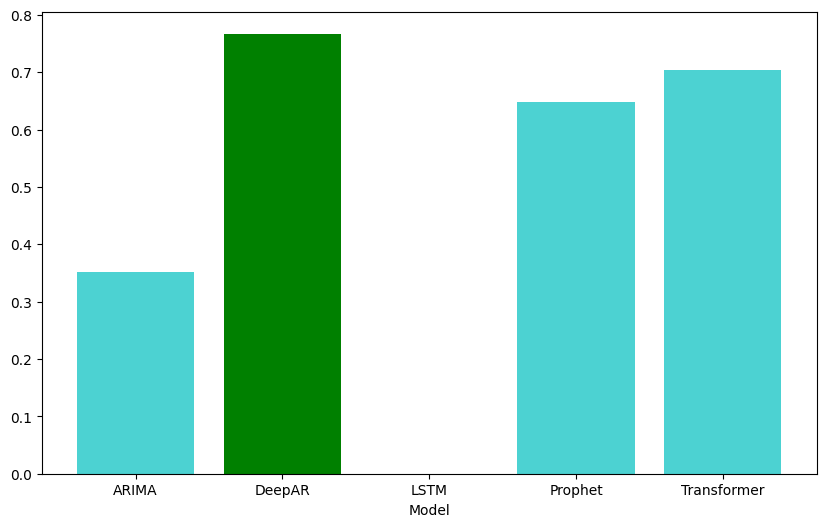

In [201]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Continue from previous data for the transformer (add data for R2)
data = {
    'Model': ['Prophet', 'ARIMA', 'LSTM', 'DeepAR', 'Transformer'],
    'MAE': [np.mean([136.63, 51.10, 9.81, 34.22, 9.03, 9.59, 4.16, 5.30]),
            np.mean([99.64, 15.80, 3.24, 1.14, 2.02, 1.35, 1.19, 1.43, 1.28, 1.07]),
            np.mean([106.65, 15.95, 2.96, 1.31, 1.94, 1.34, 1.18, 1.33]),
            np.mean([191.56, 18.15, 0.92, 2.30, 1.68, 3.38, 1.93, 2.90]),
            np.mean([146.95, 20.20, 0.53, 2.98, 2.14, 3.75, 2.55, 1.99])],
    'MSE': [np.mean([63710.42, 3304.52, 107.54, 1457.66, 105.76, 109.58, 18.15, 34.78]),
            np.mean([28830.21, 930.48, 20.10, 1.65, 6.73, 2.27, 1.83, 5.76, 1.95, 3.08]),
            np.mean([28727.75, 896.43, 17.32, 2.25, 6.16, 2.95, 2.25, 1.78]),
            np.mean([58074.60, 1182.61, 1.32, 6.07, 3.21, 12.16, 4.67, 9.25]),
            np.mean([56499.95, 1166.35, 0.28, 9.07, 5.67, 18.18, 8.29, 8.17])],
    'RMSE': [np.mean([252.41, 57.48, 10.37, 38.18, 10.28, 10.47, 4.26, 5.90]),
             np.mean([169.79, 30.50, 4.48, 1.29, 2.59, 1.51, 1.35, 2.40, 1.40, 1.76]),
             np.mean([169.49, 29.94, 4.16, 1.50, 2.48, 1.72, 1.50, 1.33]),
             np.mean([240.99, 34.39, 1.15, 2.46, 1.79, 3.49, 2.16, 3.04]),
             np.mean([237.70, 34.15, 0.53, 3.01, 2.38, 4.26, 2.88, 2.86])],
    'MAPE': [np.mean([107.09, 416.37, 910.55, 3421.87, 487.55, 736.87, 415.75, 323.26]),
             np.mean([84.22, 68.16, 47.01, 81.86, 173.77, 66.36, 77.55, 79.02, 86.76, 54.75]),
             np.mean([99.21, 75.93, 49.73, 102.03, 166.09, 51.06, 49.43, 133.40]),
             np.mean([242.39, 89.44, 69.27, 230.31, 104.00, 266.96, 192.57, 170.37]),
             np.mean([139.45, 115.94, 47.19, 297.81, 195.96, 330.45, 255.32, 83.85])],
    'R2': [np.mean([-0.23, -1.55, -572.57, -28.75, -437.34, -4.00]),
           np.mean([-0.01, -0.09, -0.51, -0.15, -0.85, -0.03, -0.05, -0.01, -0.07, -0.02]),
           np.mean([-0.01, -0.05, -0.30, -0.57, -0.69, -0.34, -0.29, float('nan')]),
           np.mean([-0.12, 0.09, -6.06, 0.0, 0.1, -47.65, 0.0, -0.33]),
           np.mean([-0.09, 0.10, -0.52])]
}

# Create a DataFrame
df_metrics = pd.DataFrame(data)

# Normalize the scores for each metric
df_metrics['NORMALIZED_MSE'] = (df_metrics['MSE'] - df_metrics['MSE'].min()) / (df_metrics['MSE'].max() - df_metrics['MSE'].min())
df_metrics['NORMALIZED_MAE'] = (df_metrics['MAE'] - df_metrics['MAE'].min()) / (df_metrics['MAE'].max() - df_metrics['MAE'].min())
df_metrics['NORMALIZED_RMSE'] = (df_metrics['RMSE'] - df_metrics['RMSE'].min()) / (df_metrics['RMSE'].max() - df_metrics['RMSE'].min())
df_metrics['NORMALIZED_MAPE'] = (df_metrics['MAPE'] - df_metrics['MAPE'].min()) / (df_metrics['MAPE'].max() - df_metrics['MAPE'].min())
df_metrics['NORMALIZED_R2'] = (df_metrics['R2'] - df_metrics['R2'].min()) / (df_metrics['R2'].max() - df_metrics['R2'].min())

# Calculate the variance of each normalized metric
var_mse = df_metrics['NORMALIZED_MSE'].var()
var_mae = df_metrics['NORMALIZED_MAE'].var()
var_rmse = df_metrics['NORMALIZED_RMSE'].var()
var_mape = df_metrics['NORMALIZED_MAPE'].var()
var_r2 = df_metrics['NORMALIZED_R2'].var()

# Invert variances (lower variance gets higher weight)
inv_var_mse = 1 / var_mse
inv_var_mae = 1 / var_mae
inv_var_rmse = 1 / var_rmse
inv_var_mape = 1 / var_mape
inv_var_r2 = 1 / var_r2

# Normalize the inverted variances to sum to 1
total_inv_var = inv_var_mse + inv_var_mae + inv_var_rmse + inv_var_mape + inv_var_r2

WEIGHT_MSE = inv_var_mse / total_inv_var
WEIGHT_MAE = inv_var_mae / total_inv_var
WEIGHT_RMSE = inv_var_rmse / total_inv_var
WEIGHT_MAPE = inv_var_mape / total_inv_var
WEIGHT_R2 = inv_var_r2 / total_inv_var

# Print the calculated weights for reference
print(f"Automatically calculated weights:\nMSE: {WEIGHT_MSE}, MAE: {WEIGHT_MAE}, RMSE: {WEIGHT_RMSE}, MAPE: {WEIGHT_MAPE}, R2: {WEIGHT_R2}")

# Calculate the weighted score
df_metrics['WEIGHTED_SCORE'] = (
    WEIGHT_MSE * df_metrics['NORMALIZED_MSE'] +
    WEIGHT_MAE * df_metrics['NORMALIZED_MAE'] +
    WEIGHT_RMSE * df_metrics['NORMALIZED_RMSE'] +
    WEIGHT_MAPE * (1 - df_metrics['NORMALIZED_MAPE']) +  # (1 - NORMALIZED_MAPE) because lower MAPE is better
    WEIGHT_R2 * df_metrics['NORMALIZED_R2']
)

# Calculate the mean weighted score for each model
mean_scores = df_metrics.groupby('Model')['WEIGHTED_SCORE'].mean()

# Find the best model based on the highest mean score
best_model = mean_scores.idxmax()

# Create a bar plot to visualize the mean weighted scores for each model
plt.figure(figsize=(10, 6))
plt.bar(mean_scores.index, mean_scores, color='c', alpha=0.7, label='Mean Weighted Score')

# Highlight the best model with a different color
plt.bar(best_model, mean_scores[best_model], color='g', label='Best Model')

# Set labels and title
plt.xlabel('Model')


In [202]:
mean_scores

Model
ARIMA          0.351353
DeepAR         0.766980
LSTM                NaN
Prophet        0.648639
Transformer    0.703007
Name: WEIGHTED_SCORE, dtype: float64

In [40]:
# # Print the number of posts per theme
# theme_counts = aggr_df['llama2_labelone'].value_counts()
# print(theme_counts)

# # Check the date range of the posts
# print(aggr_df.index.min(), aggr_df.index.max())


In [ ]:
# performance_metrics_df.to_csv('../topics_metrics.csv')
# performance_metrics_df

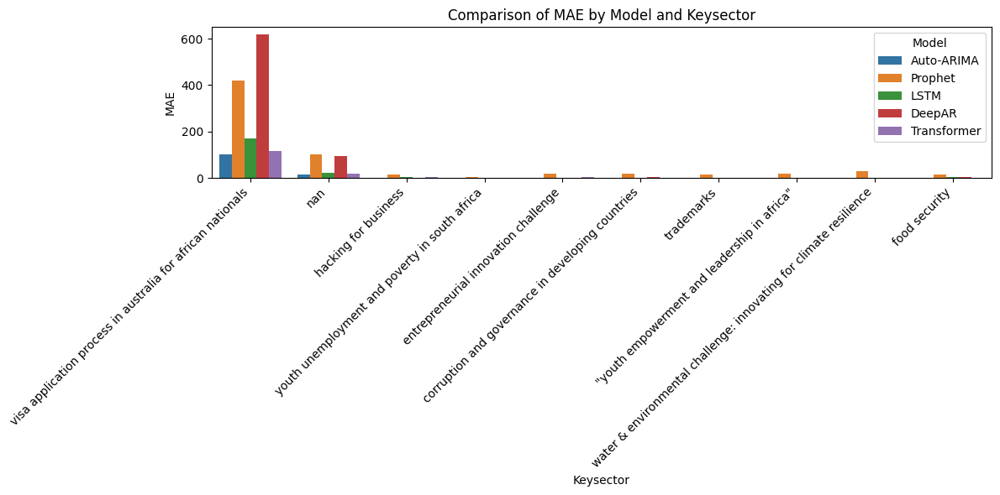

In [190]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming you have already computed the performance_metrics_df DataFrame

# Filter the DataFrame to select only the MAE values
mae_df = performance_metrics_df[performance_metrics_df['Model'].isin(['Prophet', 'Auto-ARIMA', 'LSTM','DeepAR', 'Transformer'])]

# Create a bar chart
plt.figure(figsize=(12, 6))
sns.barplot(data=mae_df, x='Keysector', y='mae', hue='Model')
plt.title('Comparison of MAE by Model and Keysector')
plt.xlabel('Keysector')
plt.ylabel('MAE')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
plt.tight_layout()
plt.show()


/tmp/ipykernel_1186332/2970738291.py:24: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.


/tmp/ipykernel_1186332/2970738291.py:24: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.


/tmp/ipykernel_1186332/2970738291.py:24: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.


/tmp/ipykernel_1186332/2970738291.py:24: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.


/tmp/ipykernel_1186332/2970738291.py:24: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




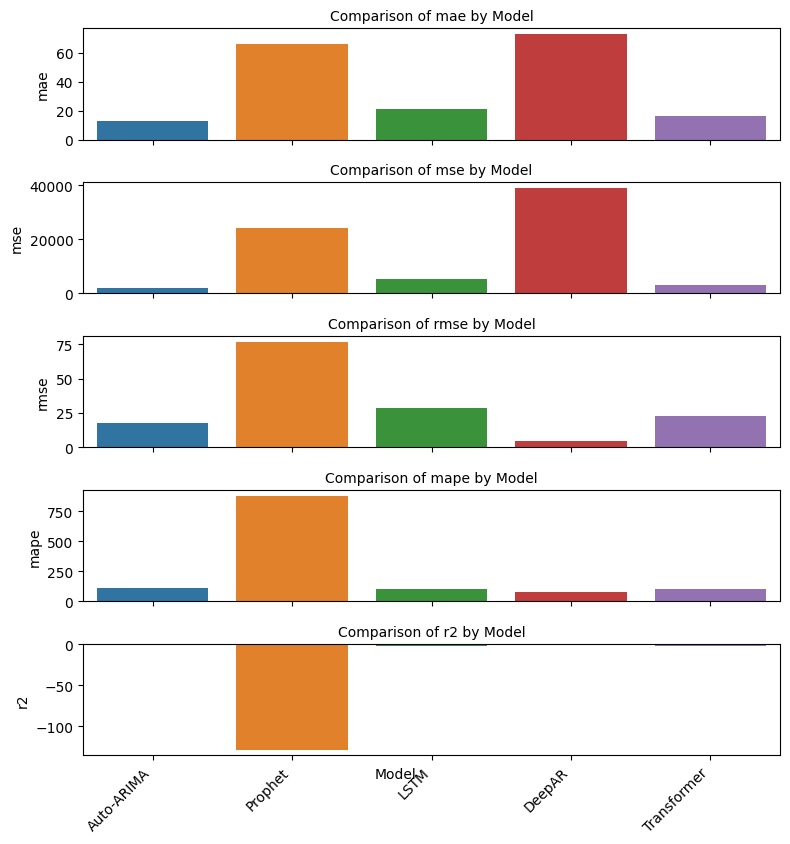

In [191]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Assuming you have already computed the performance_metrics_df DataFrame

# Filter the DataFrame to select only the models of interest
models = performance_metrics_df['Model']
filtered_df = performance_metrics_df[performance_metrics_df['Model'].isin(models)]

# Define the metrics to plot
metrics = ['mae', 'mse', 'rmse', 'mape', 'r2']

# Create subplots for each metric
fig, axes = plt.subplots(nrows=len(metrics), ncols=1, figsize=(8, 8), sharex=True)

# Set the common x-axis label
fig.text(0.5, 0.02, 'Model', ha='center', fontsize=10)
fig.subplots_adjust(hspace=0.5)

for i, metric in enumerate(metrics):
    ax = axes[i]
    sns.barplot(data=filtered_df, x='Model', y=metric, ci=None, ax=ax)
    ax.set_title(f'Comparison of {metric} by Model', fontsize=10)
    ax.set_xlabel('')
    ax.set_ylabel(metric)

plt.tight_layout()
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
plt.show()


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/home/hsibitenda/anacond

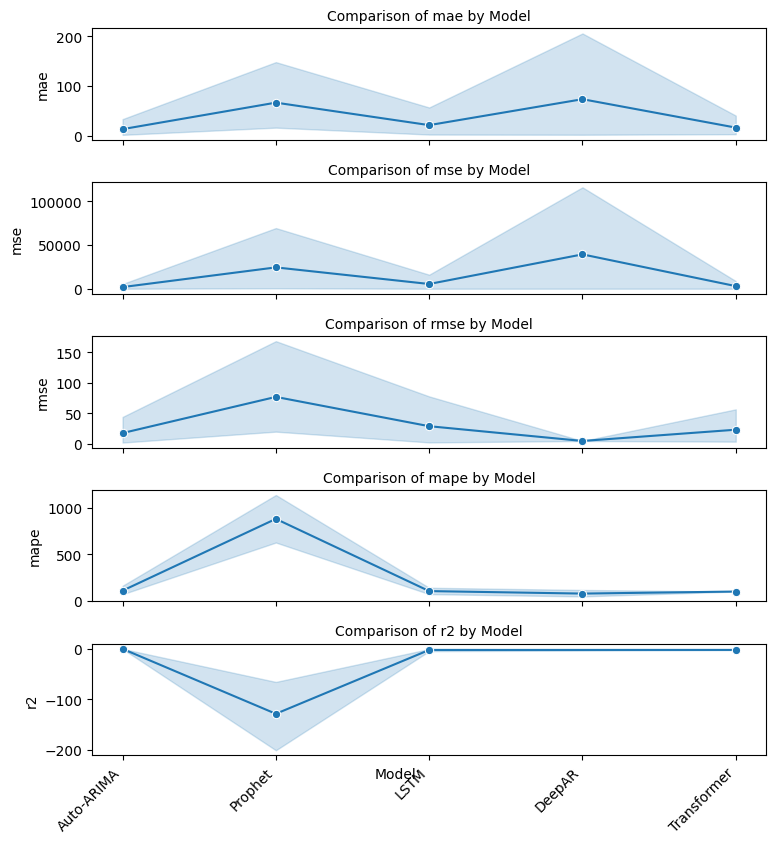

In [192]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming you have already computed the performance_metrics_df DataFrame

# Filter the DataFrame to select only the models of interest
models = performance_metrics_df['Model']
filtered_df = performance_metrics_df[performance_metrics_df['Model'].isin(models)]

# Define the metrics to plot
metrics = ['mae', 'mse', 'rmse', 'mape', 'r2']

# Create subplots for each metric
fig, axes = plt.subplots(nrows=len(metrics), ncols=1, figsize=(8, 8), sharex=True)

# Set the common x-axis label
fig.text(0.5, 0.02, 'Model', ha='center', fontsize=10)
fig.subplots_adjust(hspace=0.5)

for i, metric in enumerate(metrics):
    ax = axes[i]
    sns.lineplot(data=filtered_df, x='Model', y=metric, ax=ax, marker='o')
    ax.set_title(f'Comparison of {metric} by Model', fontsize=10)
    ax.set_xlabel('')
    ax.set_ylabel(metric)

plt.tight_layout()
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
plt.show()


In [194]:
df=performance_metrics_df.copy()

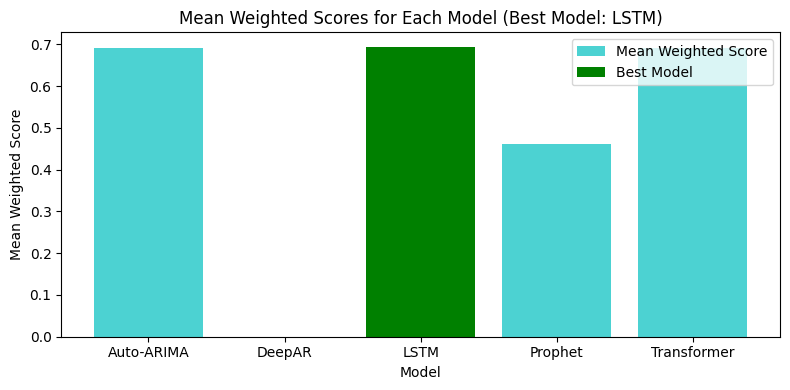

In [195]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming you have a DataFrame called "df" with the data and calculated mean weighted scores

# Normalize all the scores to [0, 1] range
df['normalized_mse'] = (df['mse'] - df['mse'].min()) / (df['mse'].max() - df['mse'].min())
df['normalized_mae'] = (df['mae'] - df['mae'].min()) / (df['mae'].max() - df['mae'].min())
df['normalized_rmse'] = (df['rmse'] - df['rmse'].min()) / (df['rmse'].max() - df['rmse'].min())
df['normalized_mape'] = (df['mape'] - df['mape'].min()) / (df['mape'].max() - df['mape'].min())
df['normalized_r2'] = (df['r2'] - df['r2'].min()) / (df['r2'].max() - df['r2'].min())

# Define weights for all the scores
weight_mse = 0.1
weight_mae = 0.1
weight_rmse = 0.1
weight_mape = 0.3
weight_r2 = 0.4

# Calculate the weighted score
df['weighted_score'] = (
    weight_mse * df['normalized_mse'] +
    weight_mae * df['normalized_mae'] +
    weight_rmse * df['normalized_rmse'] +
    weight_mape * (1 - df['normalized_mape']) +
    weight_r2 * df['normalized_r2']
)

# Calculate the mean weighted score for each model
mean_scores = df.groupby('Model')['weighted_score'].mean()

# Find the best model based on the highest mean score
best_model = mean_scores.idxmax()

# Create a bar plot to visualize the mean weighted scores for each model
plt.figure(figsize=(8, 4))
plt.bar(mean_scores.index, mean_scores, color='c', alpha=0.7, label='Mean Weighted Score')

# Highlight the best model with a different color
plt.bar(best_model, mean_scores[best_model], color='g', label='Best Model')

# Set labels and title
plt.xlabel('Model')
plt.ylabel('Mean Weighted Score')
plt.title(f'Mean Weighted Scores for Each Model (Best Model: {best_model})')

# Show the plot
plt.legend()
plt.tight_layout()
plt.show()


In [204]:
# d2

In [205]:
df2=df.copy()

In [206]:
# Ensure 'Date' column is in datetime format
df['Date'] = pd.to_datetime(df['Date_Extracted'])


# Group by 'Keysector' and 'Date' and count the posts
aggr_df = df.groupby(['Predicted_Categories3', pd.Grouper(key='Date', freq='M')])['Text_lemma'].count().reset_index()
aggr_df.columns = ['Predicted_Categories3', 'Date', 'Posts']
aggr_df.head(5)

,Predicted_Categories3,Date,Posts
0,education,2018-02-28,1
1,education,2018-04-30,1
2,education,2018-06-30,2
3,education,2018-07-31,1
4,education,2018-08-31,33


In [207]:
aggr_df.shape

(1382, 3)

In [208]:
monthly_OS=aggr_df.copy()
monthly_OS.shape

(1382, 3)

In [209]:
from statsmodels.tsa.stattools import adfuller
import pandas as pd

# Assuming 'monthly_OS' is your time series data in the DataFrame
# You may want to select a specific column from your DataFrame, e.g., monthly_os['Posts']

print('Results of Dickey-Fuller Test:')
dftest = adfuller(monthly_OS['Posts'], autolag='AIC')
dfoutput = pd.Series(dftest[0:4], index=['Test Statistic', 'p-value', '#Lags Used', 'Number of Observations Used'])

# Print the results
print(dfoutput)


Results of Dickey-Fuller Test:
Test Statistic                   -3.664678
p-value                           0.004638
#Lags Used                       24.000000
Number of Observations Used    1357.000000
dtype: float64


In [210]:
# Assuming 'Value' is the column you want to calculate rolling statistics for
moving_avg = monthly_OS['Posts'].rolling(12).mean()
moving_std = monthly_OS['Posts'].rolling(12).std()


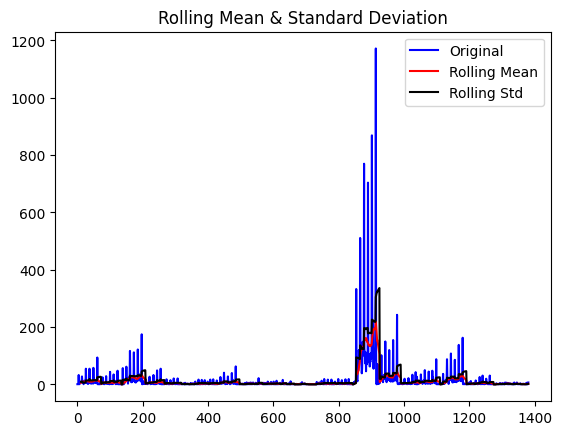

In [211]:
#Plot rolling statistics:
orig = plt.plot(monthly_OS['Posts'], color='blue',label='Original')
mean = plt.plot(moving_avg, color='red', label='Rolling Mean')
std = plt.plot(moving_std, color='black', label = 'Rolling Std')
plt.legend(loc='best')
plt.title('Rolling Mean & Standard Deviation')
plt.show(block=False)

In [212]:
aggr_df

,Predicted_Categories3,Date,Posts
0,education,2018-02-28,1
1,education,2018-04-30,1
2,education,2018-06-30,2
3,education,2018-07-31,1
4,education,2018-08-31,33
...,...,...,...
1377,security|health,2022-09-30,1
1378,security|health,2022-10-31,2
1379,security|health,2022-11-30,1
1380,security|health,2023-02-28,1


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



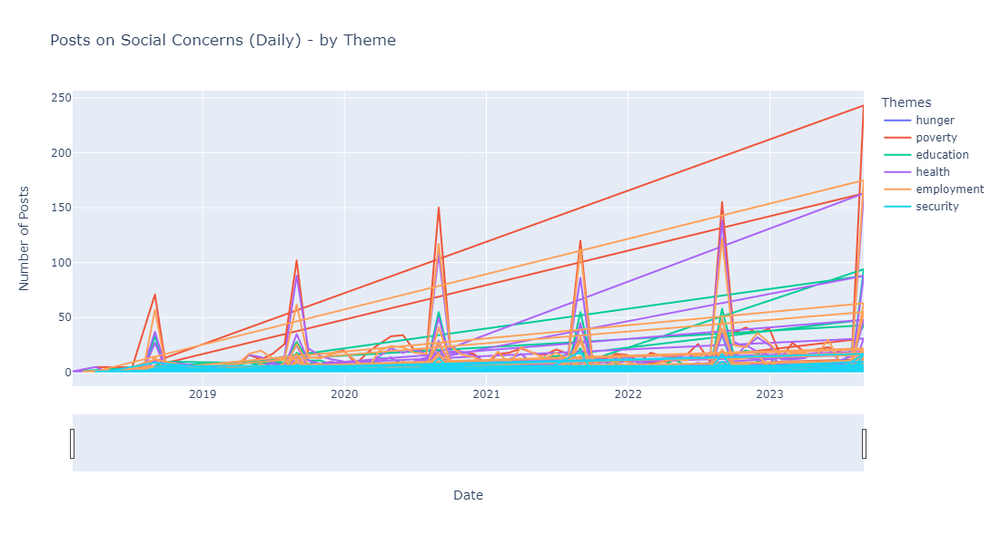

In [44]:
import plotly.express as px
import pandas as pd

# List of themes to filter by
themes_to_include = ['hunger', 'poverty', 'education', 'health', 'employment', 'security']

# Convert 'Date' column to datetime
aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])

# Create an empty DataFrame to collect filtered data for all themes
all_themes_df = pd.DataFrame()

# Loop through each theme, filter the data, and concatenate it to the main DataFrame
for theme in themes_to_include:
    # Filter the DataFrame for rows where 'Predicted_Categories3' contains the current theme
    theme_df = aggr_df[aggr_df['Predicted_Categories3'].apply(lambda x: pd.notna(x) and theme in x)].copy()
    
    # Add a column to track the current theme (using .loc to avoid SettingWithCopyWarning)
    theme_df.loc[:, 'Filtered_Theme'] = theme
    
    # Concatenate to the main DataFrame
    all_themes_df = pd.concat([all_themes_df, theme_df], ignore_index=True)

# Create a line plot for all themes combined
fig = px.line(all_themes_df, x='Date', y='Posts', color='Filtered_Theme',
              title='Posts on Social Concerns (Daily) - by Theme')

# Update axis labels
fig.update_xaxes(title_text='Date')
fig.update_yaxes(title_text='Number of Posts')

# Update layout for the legend and the overall plot
fig.update_layout(legend_title_text='Themes', xaxis_rangeslider_visible=True, showlegend=True)
fig.update_xaxes(rangeslider=dict(visible=True))
fig.update_layout(height=600, width=800, title_text='Posts on Social Concerns (Daily) - by Theme')

fig.show()


In [24]:
# import plotly.express as px
# import pandas as pd

# # List of themes to filter by
# themes_to_include = ['hunger', 'poverty', 'education', 'health', 'employment', 'security']

# # Convert 'Date' column to datetime
# aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])

# # Filter the DataFrame to include rows where 'cleaned_theme' contains any of the themes in the list
# filtered_aggr_df = aggr_df[aggr_df['Predicted_Categories3'].apply(lambda x: any(theme in x for theme in themes_to_include))]

# # Create a line plot for the filtered themes
# fig = px.line(filtered_aggr_df, x='Date', y='Posts', color='Predicted_Categories3',
#               title='Posts on social concerns (daily) - by Keysector')
# fig.update_xaxes(title_text='Date')
# fig.update_yaxes(title_text='Number of Posts')

# # Update layout for the legend and the overall plot
# fig.update_layout(legend_title_text='Predicted_Categories3', xaxis_rangeslider_visible=True, showlegend=True)
# fig.update_xaxes(rangeslider=dict(visible=True))
# fig.update_layout(height=600, width=800, title_text='Posts on social concerns (daily) - by Keysector')
# fig.show()


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



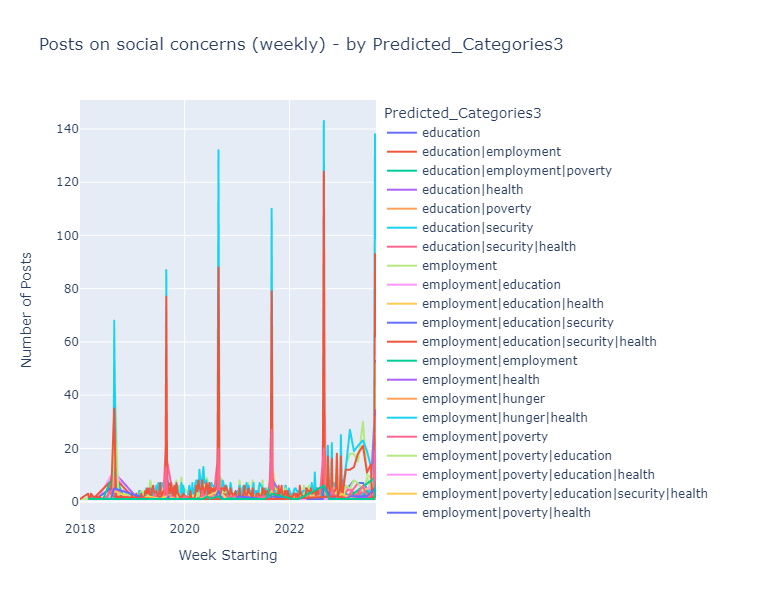

In [45]:
import plotly.express as px
import pandas as pd

# List of themes to filter by
themes_to_include = ['hunger', 'poverty', 'education', 'health', 'employment', 'security']

# Ensure 'Date' column is in datetime format
df['Date'] = pd.to_datetime(df['Date'])

# Filter the DataFrame to include rows where 'cleaned_theme' contains any of the themes in the list
filtered_df = df[df['Predicted_Categories3'].apply(lambda x: any(theme in x for theme in themes_to_include))]

# Group by 'cleaned_theme' and 'Date' and count the posts
aggr_df = filtered_df.groupby(['Predicted_Categories3', pd.Grouper(key='Date', freq='W-MON')])['llama2_labelone'].count().reset_index()
aggr_df.columns = ['Predicted_Categories3', 'Date', 'Posts']

# Create a line plot for the filtered themes
fig = px.line(aggr_df, x='Date', y='Posts', color='Predicted_Categories3',
              title='Posts on social concerns (weekly) - by Predicted_Categories3',
              labels={'Date': 'Week Starting'})
fig.update_yaxes(title_text='Number of Posts')

# Update layout for the legend and the overall plot
fig.update_layout(legend_title_text='Predicted_Categories3', showlegend=True, height=600, width=800)
fig.show()


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



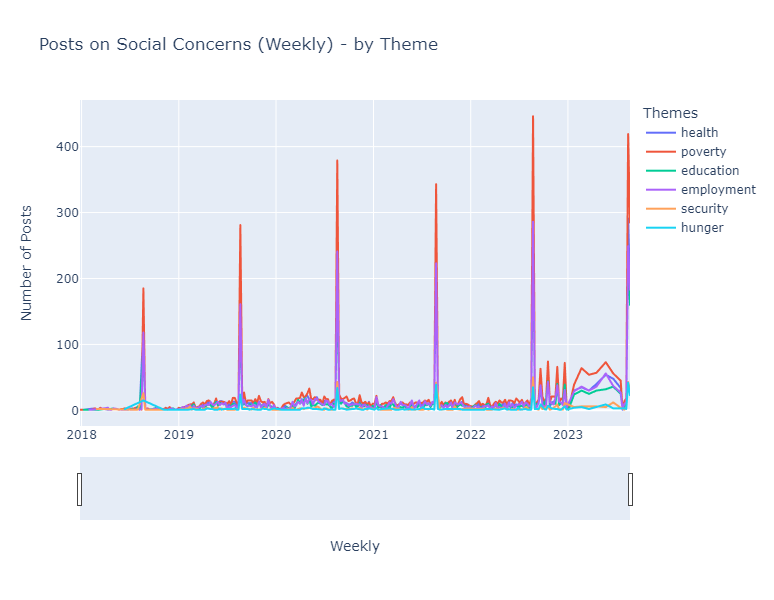

In [47]:
import plotly.express as px
import pandas as pd

# List of themes to filter by
themes_to_include = ['hunger', 'poverty', 'education', 'health', 'employment', 'security']

# Convert 'Date' column to datetime
aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])

# Create an empty DataFrame to collect filtered data for all themes
all_themes_df = pd.DataFrame()

# Loop through each theme, filter the data, and concatenate it to the main DataFrame
for theme in themes_to_include:
    # Filter the DataFrame for rows where 'Predicted_Categories3' contains the current theme
    theme_df = aggr_df[aggr_df['Predicted_Categories3'].apply(lambda x: pd.notna(x) and theme in x)].copy()
    
    # Add a column to track the current theme
    theme_df.loc[:, 'Filtered_Theme'] = theme
    
    # Concatenate to the main DataFrame
    all_themes_df = pd.concat([all_themes_df, theme_df], ignore_index=True)

# Group by month and sum the 'Posts' for each theme
all_themes_df['Month'] = all_themes_df['Date'].dt.to_period('W-Mon')
monthly_data = all_themes_df.groupby(['Month', 'Filtered_Theme'])['Posts'].sum().reset_index()

# Convert 'Month' back to datetime for plotting
monthly_data['Month'] = monthly_data['Month'].dt.to_timestamp()

# Create a line plot for all themes combined
fig = px.line(monthly_data, x='Month', y='Posts', color='Filtered_Theme',
              title='Posts on Social Concerns (Weekly) - by Theme')

# Update axis labels
fig.update_xaxes(title_text='Weekly')
fig.update_yaxes(title_text='Number of Posts')

# Update layout for the legend and the overall plot
fig.update_layout(legend_title_text='Themes', xaxis_rangeslider_visible=True, showlegend=True)
fig.update_xaxes(rangeslider=dict(visible=True))
fig.update_layout(height=600, width=800, title_text='Posts on Social Concerns (Weekly) - by Theme')

fig.show()


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



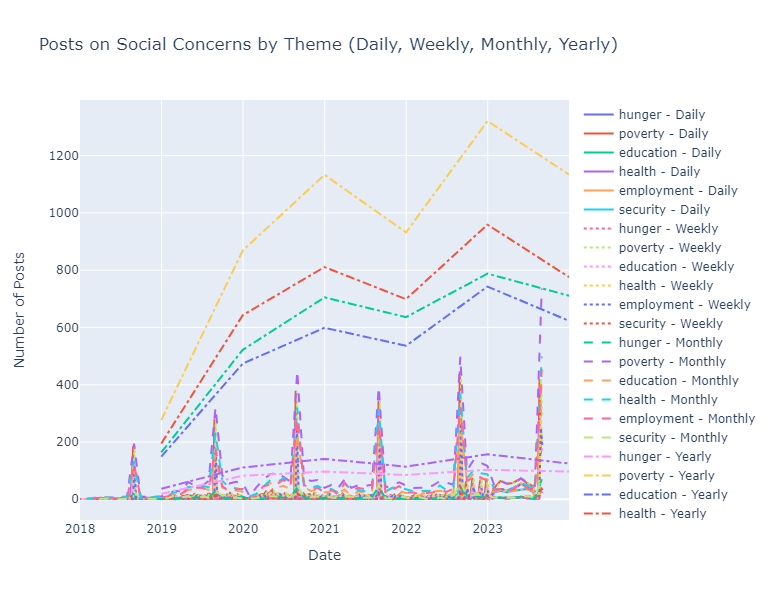

In [53]:
import plotly.graph_objects as go
import pandas as pd

# List of themes to filter by
themes_to_include = ['hunger', 'poverty', 'education', 'health', 'employment', 'security']

# Convert 'Date' column to datetime
aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])

# Create an empty DataFrame to collect filtered data for all themes
all_themes_df = pd.DataFrame()

# Loop through each theme, filter the data, and concatenate it to the main DataFrame
for theme in themes_to_include:
    # Filter the DataFrame for rows where 'Predicted_Categories3' contains the current theme
    theme_df = aggr_df[aggr_df['Predicted_Categories3'].apply(lambda x: pd.notna(x) and theme in x)].copy()
    
    # Add a column to track the current theme
    theme_df.loc[:, 'Filtered_Theme'] = theme
    
    # Concatenate to the main DataFrame
    all_themes_df = pd.concat([all_themes_df, theme_df], ignore_index=True)

# Resample data for daily, weekly, monthly, and yearly frequencies
all_themes_df.set_index('Date', inplace=True)

# Grouping and summing posts for different time intervals
daily_data = all_themes_df.groupby([pd.Grouper(freq='D'), 'Filtered_Theme'])['Posts'].sum().reset_index()
weekly_data = all_themes_df.groupby([pd.Grouper(freq='W'), 'Filtered_Theme'])['Posts'].sum().reset_index()
monthly_data = all_themes_df.groupby([pd.Grouper(freq='M'), 'Filtered_Theme'])['Posts'].sum().reset_index()
yearly_data = all_themes_df.groupby([pd.Grouper(freq='Y'), 'Filtered_Theme'])['Posts'].sum().reset_index()

# Create a single plot with all frequencies overlaid
fig = go.Figure()

# Daily plot
for theme in themes_to_include:
    daily_theme_data = daily_data[daily_data['Filtered_Theme'] == theme]
    fig.add_trace(go.Scatter(x=daily_theme_data['Date'], y=daily_theme_data['Posts'], mode='lines', name=f'{theme} - Daily'))

# Weekly plot
for theme in themes_to_include:
    weekly_theme_data = weekly_data[weekly_data['Filtered_Theme'] == theme]
    fig.add_trace(go.Scatter(x=weekly_theme_data['Date'], y=weekly_theme_data['Posts'], mode='lines', name=f'{theme} - Weekly', line=dict(dash='dot')))

# Monthly plot
for theme in themes_to_include:
    monthly_theme_data = monthly_data[monthly_data['Filtered_Theme'] == theme]
    fig.add_trace(go.Scatter(x=monthly_theme_data['Date'], y=monthly_theme_data['Posts'], mode='lines', name=f'{theme} - Monthly', line=dict(dash='dash')))

# Yearly plot
for theme in themes_to_include:
    yearly_theme_data = yearly_data[yearly_data['Filtered_Theme'] == theme]
    fig.add_trace(go.Scatter(x=yearly_theme_data['Date'], y=yearly_theme_data['Posts'], mode='lines', name=f'{theme} - Yearly', line=dict(dash='dashdot')))

# Update layout
fig.update_layout(
    height=600, width=1000,
    title_text='Posts on Social Concerns by Theme (Daily, Weekly, Monthly, Yearly)',
    xaxis_title='Date',
    yaxis_title='Number of Posts',
    showlegend=True
)

# Show the plot
fig.show()


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



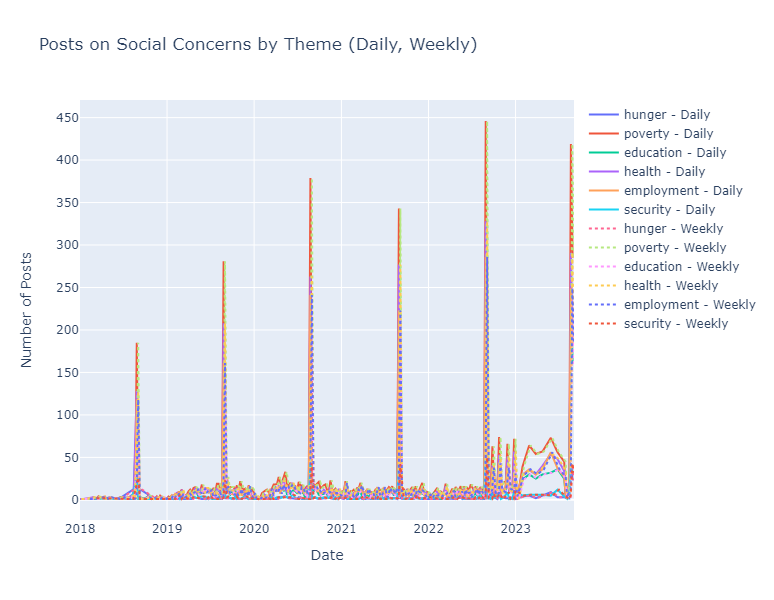

In [55]:
import plotly.graph_objects as go
import pandas as pd

# List of themes to filter by
themes_to_include = ['hunger', 'poverty', 'education', 'health', 'employment', 'security']

# Convert 'Date' column to datetime
aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])

# Create an empty DataFrame to collect filtered data for all themes
all_themes_df = pd.DataFrame()

# Loop through each theme, filter the data, and concatenate it to the main DataFrame
for theme in themes_to_include:
    # Filter the DataFrame for rows where 'Predicted_Categories3' contains the current theme
    theme_df = aggr_df[aggr_df['Predicted_Categories3'].apply(lambda x: pd.notna(x) and theme in x)].copy()
    
    # Add a column to track the current theme
    theme_df.loc[:, 'Filtered_Theme'] = theme
    
    # Concatenate to the main DataFrame
    all_themes_df = pd.concat([all_themes_df, theme_df], ignore_index=True)

# Resample data for daily, weekly, monthly, and yearly frequencies
all_themes_df.set_index('Date', inplace=True)

# Grouping and summing posts for different time intervals
daily_data = all_themes_df.groupby([pd.Grouper(freq='D'), 'Filtered_Theme'])['Posts'].sum().reset_index()
weekly_data = all_themes_df.groupby([pd.Grouper(freq='W'), 'Filtered_Theme'])['Posts'].sum().reset_index()
monthly_data = all_themes_df.groupby([pd.Grouper(freq='M'), 'Filtered_Theme'])['Posts'].sum().reset_index()
yearly_data = all_themes_df.groupby([pd.Grouper(freq='Y'), 'Filtered_Theme'])['Posts'].sum().reset_index()

# Create a single plot with all frequencies overlaid
fig = go.Figure()

# Daily plot
for theme in themes_to_include:
    daily_theme_data = daily_data[daily_data['Filtered_Theme'] == theme]
    fig.add_trace(go.Scatter(x=daily_theme_data['Date'], y=daily_theme_data['Posts'], mode='lines', name=f'{theme} - Daily'))

# Weekly plot
for theme in themes_to_include:
    weekly_theme_data = weekly_data[weekly_data['Filtered_Theme'] == theme]
    fig.add_trace(go.Scatter(x=weekly_theme_data['Date'], y=weekly_theme_data['Posts'], mode='lines', name=f'{theme} - Weekly', line=dict(dash='dot')))

# # Monthly plot
# for theme in themes_to_include:
#     monthly_theme_data = monthly_data[monthly_data['Filtered_Theme'] == theme]
#     fig.add_trace(go.Scatter(x=monthly_theme_data['Date'], y=monthly_theme_data['Posts'], mode='lines', name=f'{theme} - Monthly', line=dict(dash='dash')))

# # Yearly plot
# for theme in themes_to_include:
#     yearly_theme_data = yearly_data[yearly_data['Filtered_Theme'] == theme]
#     fig.add_trace(go.Scatter(x=yearly_theme_data['Date'], y=yearly_theme_data['Posts'], mode='lines', name=f'{theme} - Yearly', line=dict(dash='dashdot')))

# Update layout
fig.update_layout(
    height=600, width=1000,
    title_text='Posts on Social Concerns by Theme (Daily, Weekly)',
    xaxis_title='Date',
    yaxis_title='Number of Posts',
    showlegend=True
)

# Show the plot
fig.show()


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



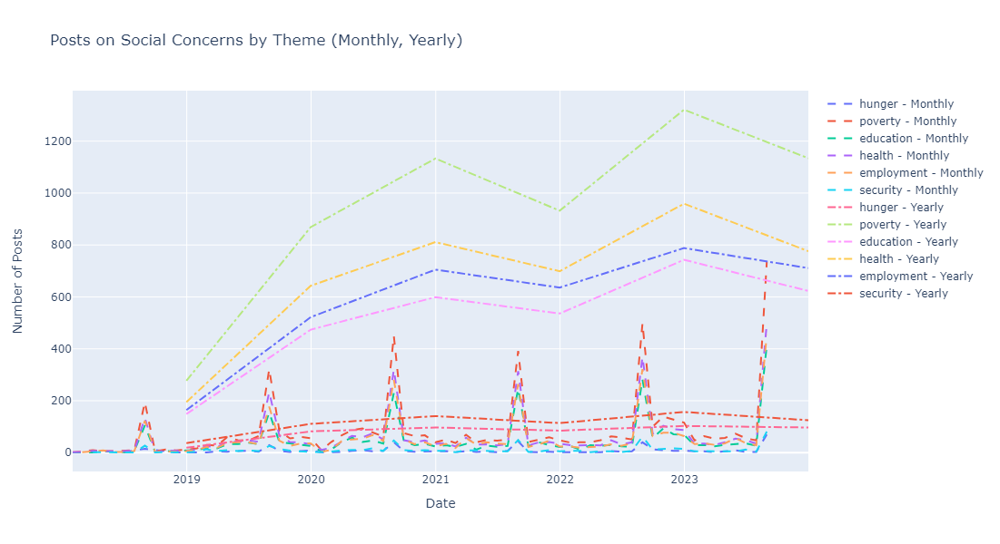

In [54]:
import plotly.graph_objects as go
import pandas as pd

# List of themes to filter by
themes_to_include = ['hunger', 'poverty', 'education', 'health', 'employment', 'security']

# Convert 'Date' column to datetime
aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])

# Create an empty DataFrame to collect filtered data for all themes
all_themes_df = pd.DataFrame()

# Loop through each theme, filter the data, and concatenate it to the main DataFrame
for theme in themes_to_include:
    # Filter the DataFrame for rows where 'Predicted_Categories3' contains the current theme
    theme_df = aggr_df[aggr_df['Predicted_Categories3'].apply(lambda x: pd.notna(x) and theme in x)].copy()
    
    # Add a column to track the current theme
    theme_df.loc[:, 'Filtered_Theme'] = theme
    
    # Concatenate to the main DataFrame
    all_themes_df = pd.concat([all_themes_df, theme_df], ignore_index=True)

# Resample data for daily, weekly, monthly, and yearly frequencies
all_themes_df.set_index('Date', inplace=True)

# Grouping and summing posts for different time intervals
daily_data = all_themes_df.groupby([pd.Grouper(freq='D'), 'Filtered_Theme'])['Posts'].sum().reset_index()
weekly_data = all_themes_df.groupby([pd.Grouper(freq='W'), 'Filtered_Theme'])['Posts'].sum().reset_index()
monthly_data = all_themes_df.groupby([pd.Grouper(freq='M'), 'Filtered_Theme'])['Posts'].sum().reset_index()
yearly_data = all_themes_df.groupby([pd.Grouper(freq='Y'), 'Filtered_Theme'])['Posts'].sum().reset_index()

# Create a single plot with all frequencies overlaid
fig = go.Figure()

# # Daily plot
# for theme in themes_to_include:
#     daily_theme_data = daily_data[daily_data['Filtered_Theme'] == theme]
#     fig.add_trace(go.Scatter(x=daily_theme_data['Date'], y=daily_theme_data['Posts'], mode='lines', name=f'{theme} - Daily'))

# # Weekly plot
# for theme in themes_to_include:
#     weekly_theme_data = weekly_data[weekly_data['Filtered_Theme'] == theme]
#     fig.add_trace(go.Scatter(x=weekly_theme_data['Date'], y=weekly_theme_data['Posts'], mode='lines', name=f'{theme} - Weekly', line=dict(dash='dot')))

# Monthly plot
for theme in themes_to_include:
    monthly_theme_data = monthly_data[monthly_data['Filtered_Theme'] == theme]
    fig.add_trace(go.Scatter(x=monthly_theme_data['Date'], y=monthly_theme_data['Posts'], mode='lines', name=f'{theme} - Monthly', line=dict(dash='dash')))

# Yearly plot
for theme in themes_to_include:
    yearly_theme_data = yearly_data[yearly_data['Filtered_Theme'] == theme]
    fig.add_trace(go.Scatter(x=yearly_theme_data['Date'], y=yearly_theme_data['Posts'], mode='lines', name=f'{theme} - Yearly', line=dict(dash='dashdot')))

# Update layout
fig.update_layout(
    height=600, width=1000,
    title_text='Posts on Social Concerns by Theme (Monthly, Yearly)',
    xaxis_title='Date',
    yaxis_title='Number of Posts',
    showlegend=True
)

# Show the plot
fig.show()


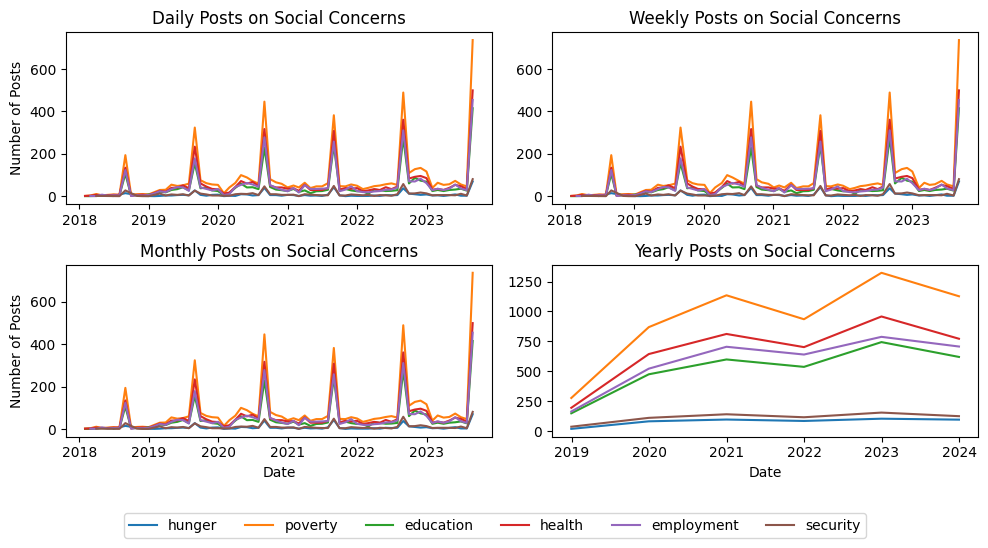

In [410]:
import pandas as pd
import matplotlib.pyplot as plt

# List of themes to filter by
themes_to_include = ['hunger', 'poverty', 'education', 'health', 'employment', 'security']

# Convert 'Date' column to datetime
aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])

# Create an empty DataFrame to collect filtered data for all themes
all_themes_df = pd.DataFrame()

# Loop through each theme, filter the data, and concatenate it to the main DataFrame
for theme in themes_to_include:
    # Filter the DataFrame for rows where 'Predicted_Categories3' contains the current theme
    theme_df = aggr_df[aggr_df['Predicted_Categories3'].apply(lambda x: pd.notna(x) and theme in x)].copy()
    
    # Add a column to track the current theme
    theme_df['Filtered_Theme'] = theme
    
    # Concatenate to the main DataFrame
    all_themes_df = pd.concat([all_themes_df, theme_df], ignore_index=True)

# Group and aggregate data for different frequencies
daily_data = all_themes_df.groupby([pd.Grouper(key='Date', freq='D'), 'Filtered_Theme']).sum().reset_index()
weekly_data = all_themes_df.groupby([pd.Grouper(key='Date', freq='W'), 'Filtered_Theme']).sum().reset_index()
monthly_data = all_themes_df.groupby([pd.Grouper(key='Date', freq='M'), 'Filtered_Theme']).sum().reset_index()
yearly_data = all_themes_df.groupby([pd.Grouper(key='Date', freq='Y'), 'Filtered_Theme']).sum().reset_index()

# Create subplots for daily, weekly, monthly, and yearly trends
fig, axes = plt.subplots(2, 2, figsize=(10, 5), sharex=False, sharey=False)

# Plot daily data in the first subplot (axes[0, 0])
for theme in themes_to_include:
    theme_data = daily_data[daily_data['Filtered_Theme'] == theme]
    axes[0, 0].plot(theme_data['Date'], theme_data['Posts'], label=theme)
axes[0, 0].set_title('Daily Posts on Social Concerns')
axes[0, 0].set_ylabel('Number of Posts')

# Plot weekly data in the second subplot (axes[0, 1])
for theme in themes_to_include:
    theme_data = weekly_data[weekly_data['Filtered_Theme'] == theme]
    axes[0, 1].plot(theme_data['Date'], theme_data['Posts'], label=theme)
axes[0, 1].set_title('Weekly Posts on Social Concerns')

# Plot monthly data in the third subplot (axes[1, 0])
for theme in themes_to_include:
    theme_data = monthly_data[monthly_data['Filtered_Theme'] == theme]
    axes[1, 0].plot(theme_data['Date'], theme_data['Posts'], label=theme)
axes[1, 0].set_title('Monthly Posts on Social Concerns')
axes[1, 0].set_ylabel('Number of Posts')
axes[1, 0].set_xlabel('Date')

# Plot yearly data in the fourth subplot (axes[1, 1])
for theme in themes_to_include:
    theme_data = yearly_data[yearly_data['Filtered_Theme'] == theme]
    axes[1, 1].plot(theme_data['Date'], theme_data['Posts'], label=theme)
axes[1, 1].set_title('Yearly Posts on Social Concerns')
axes[1, 1].set_xlabel('Date')

# Add a single legend for all subplots at the bottom
handles, labels = axes[0, 0].get_legend_handles_labels()
fig.legend(handles, labels, loc='lower center', bbox_to_anchor=(0.5, -0.1), ncol=6)

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plots
plt.show()


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



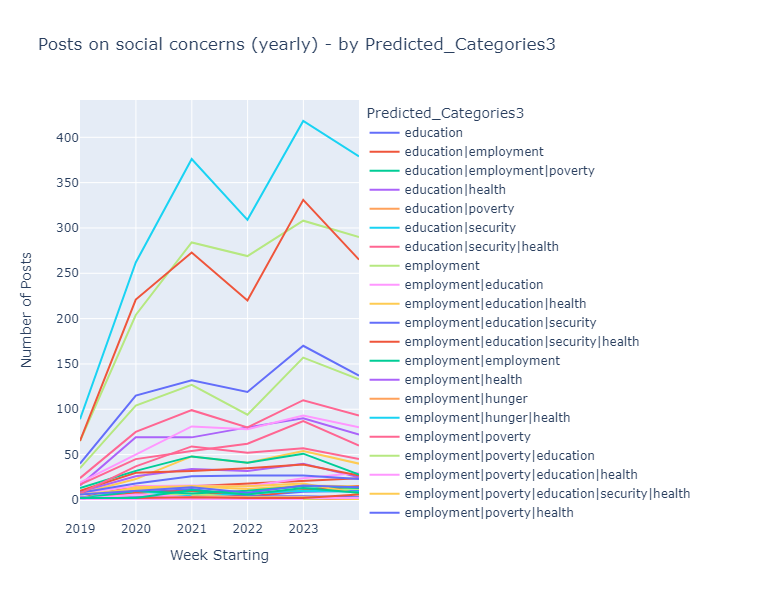

In [43]:
import plotly.express as px
import pandas as pd

# List of themes to filter by
themes_to_include = ['hunger', 'poverty', 'education', 'health', 'employment', 'security']

# Ensure 'Date' column is in datetime format
df['Date'] = pd.to_datetime(df['Date'])

# Filter the DataFrame to include rows where 'cleaned_theme' contains any of the themes in the list
filtered_df = df[df['Predicted_Categories3'].apply(lambda x: any(theme in x for theme in themes_to_include))]

# Group by 'cleaned_theme' and 'Date' and count the posts
aggr_df = filtered_df.groupby(['Predicted_Categories3', pd.Grouper(key='Date', freq='Y')])['llama2_labelone'].count().reset_index()
aggr_df.columns = ['Predicted_Categories3', 'Date', 'Posts']

# Create a line plot for the filtered themes
fig = px.line(aggr_df, x='Date', y='Posts', color='Predicted_Categories3',
              title='Posts on social concerns (yearly) - by Predicted_Categories3',
              labels={'Date': 'Week Starting'})
fig.update_yaxes(title_text='Number of Posts')

# Update layout for the legend and the overall plot
fig.update_layout(legend_title_text='Predicted_Categories3', showlegend=True, height=600, width=800)
fig.show()


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



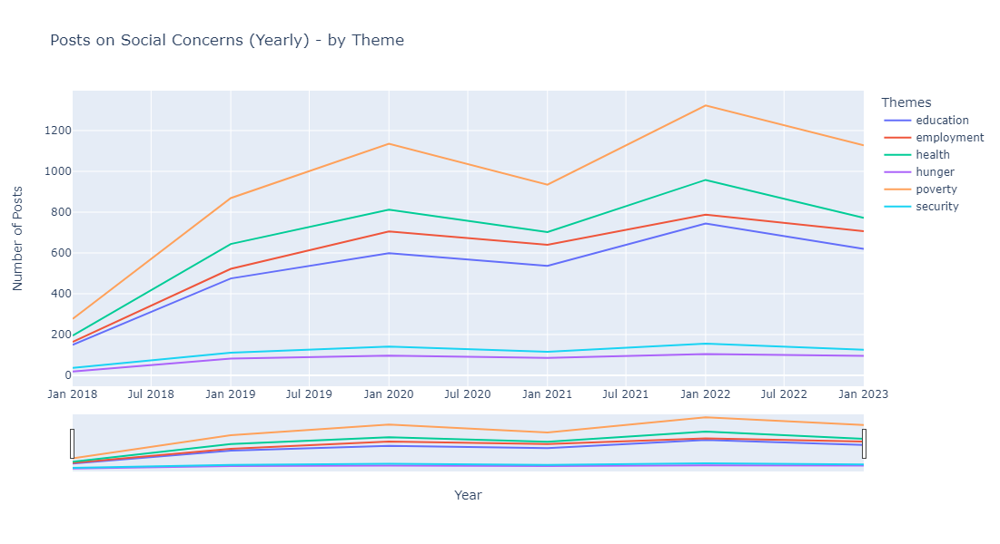

In [47]:
import plotly.express as px
import pandas as pd

# List of themes to filter by
themes_to_include = ['hunger', 'poverty', 'education', 'health', 'employment', 'security']

# Convert 'Date' column to datetime
aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])

# Create an empty DataFrame to collect filtered data for all themes
all_themes_df = pd.DataFrame()

# Loop through each theme, filter the data, and concatenate it to the main DataFrame
for theme in themes_to_include:
    # Filter the DataFrame for rows where 'Predicted_Categories3' contains the current theme
    theme_df = aggr_df[aggr_df['Predicted_Categories3'].apply(lambda x: pd.notna(x) and theme in x)].copy()
    
    # Add a column to track the current theme
    theme_df.loc[:, 'Filtered_Theme'] = theme
    
    # Concatenate to the main DataFrame
    all_themes_df = pd.concat([all_themes_df, theme_df], ignore_index=True)

# Group by year and sum the 'Posts' for each theme
all_themes_df['Year'] = all_themes_df['Date'].dt.to_period('Y')
yearly_data = all_themes_df.groupby(['Year', 'Filtered_Theme'])['Posts'].sum().reset_index()

# Convert 'Year' back to datetime for plotting
yearly_data['Year'] = yearly_data['Year'].dt.to_timestamp()

# Create a line plot for all themes combined
fig = px.line(yearly_data, x='Year', y='Posts', color='Filtered_Theme',
              title='Posts on Social Concerns (Yearly) - by Theme')

# Update axis labels
fig.update_xaxes(title_text='Year')
fig.update_yaxes(title_text='Number of Posts')

# Update layout for the legend and the overall plot
fig.update_layout(legend_title_text='Themes', xaxis_rangeslider_visible=True, showlegend=True)
fig.update_xaxes(rangeslider=dict(visible=True))
fig.update_layout(height=600, width=800, title_text='Posts on Social Concerns (Yearly) - by Theme')

fig.show()


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp_nvt37p3/hoyqabwz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp_nvt37p3/6ubfkder.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=3597', 'data', 'file=/tmp/tmp_nvt37p3/hoyqabwz.json', 'init=/tmp/tmp_nvt37p3/6ubfkder.json', 'output', 'file=/tmp/tmp_nvt37p3/prophet_model2vljbzzn/prophet_model-20240911151630.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
15:16:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:16:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: 

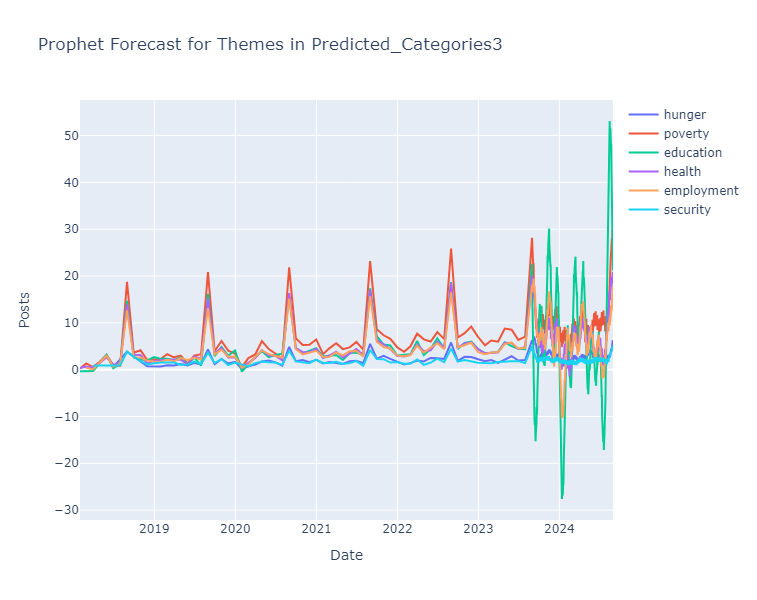

In [103]:
import pandas as pd
from prophet import Prophet
import plotly.graph_objects as go
aggr_df=monthly_OS.copy()
# List of themes to filter by
themes_to_include = ['hunger', 'poverty', 'education', 'health', 'employment', 'security']

# Filter the DataFrame to include rows where 'Predicted_Categories3' contains any of the themes in the list
filtered_aggr_df = pd.DataFrame()

for theme in themes_to_include:
    # Filter the DataFrame using the contains function for each theme
    theme_df = aggr_df[aggr_df['Predicted_Categories3'].str.contains(theme, na=False)]
    # Append the filtered DataFrame to the final DataFrame
    filtered_aggr_df = pd.concat([filtered_aggr_df, theme_df])

# Drop duplicates in case the same row matches multiple themes
filtered_aggr_df.drop_duplicates(inplace=True)

# Get the unique values of 'Predicted_Categories3' in the filtered DataFrame
unique_themes = themes_to_include

# Create a figure for all unique 'Predicted_Categories3' values
fig = go.Figure()

for keysector in unique_themes:
    # Filter the DataFrame for the current theme in 'Predicted_Categories3'
    df_subset = filtered_aggr_df[filtered_aggr_df['Predicted_Categories3'].str.contains(keysector, na=False)].copy()

    # Reset the index and rename the columns as 'ds' and 'y' for Prophet
    df_subset = df_subset[['Date', 'Posts']].reset_index(drop=True)
    df_subset.columns = ['ds', 'y']

    # Remove the timezone information from the 'ds' column if necessary
    df_subset['ds'] = pd.to_datetime(df_subset['ds']).dt.tz_localize(None)

    # Check if there are at least two non-NaN rows
    if df_subset.dropna().shape[0] >= 2:
        # Create and fit the Prophet model
        model = Prophet(weekly_seasonality=True)
        try:
            model.fit(df_subset)

            # Generate future dates for forecasting
            future = model.make_future_dataframe(periods=365)

            # Make predictions
            forecast = model.predict(future)

            # Add a trace for the forecasted values with the corresponding 'Predicted_Categories3' name
            fig.add_trace(go.Scatter(x=forecast['ds'], y=forecast['yhat'], name=keysector))
        except Exception as e:
            print(f"Error fitting model for {keysector}: {e}")
    else:
        print(f"Not enough data to fit model for {keysector}")

# Update layout for the graph
fig.update_layout(
    title='Prophet Forecast for Themes in Predicted_Categories3',
    xaxis_title='Date',
    yaxis_title='Posts',
    height=600,
    width=800
)

# Show the graph
fig.show()


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmprt0rt69b/3ud7orbw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmprt0rt69b/cfbhjmv8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=37092', 'data', 'file=/tmp/tmprt0rt69b/3ud7orbw.json', 'init=/tmp/tmprt0rt69b/cfbhjmv8.json', 'output', 'file=/tmp/tmprt0rt69b/prophet_modeldhehymf2/prophet_model-20240913161745.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
16:17:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:17:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106:

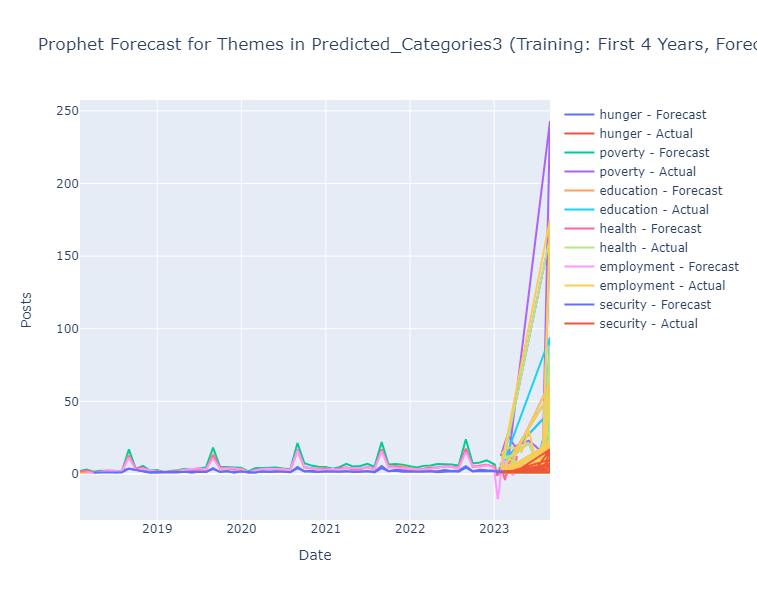

Metrics for hunger:
MAE: 2.8149758418568003
MSE: 39.865636464766624
RMSE: 6.313924014807798
MAPE: 79.37927919622096
R-squared (R2): -0.048414465469512


Metrics for poverty:
MAE: 10.917898330590946
MSE: 1045.235514292303
RMSE: 32.33010229325455
MAPE: 199.8685252174239
R-squared (R2): -0.04749157546327476


Metrics for education:
MAE: 6.915823348896095
MSE: 294.96811856715954
RMSE: 17.174635907848515
MAPE: 153.52388122325496
R-squared (R2): -0.08445209747128324


Metrics for health:
MAE: 7.526894664780868
MSE: 393.30755554514207
RMSE: 19.83198314705673
MAPE: 171.0779128710149
R-squared (R2): -0.06642997061373457


Metrics for employment:
MAE: 10.601268910392509
MSE: 556.5275495048147
RMSE: 23.590836134075765
MAPE: 281.6398232220604
R-squared (R2): -0.3742210730005755


Metrics for security:
MAE: 1.7977892546175944
MSE: 13.679583905250503
RMSE: 3.6985921517856633
MAPE: 60.038353237193455
R-squared (R2): -0.06684362853119707




In [411]:
import pandas as pd
from prophet import Prophet
import plotly.graph_objects as go
import numpy as np

# Assuming 'aggr_df' is already loaded and formatted correctly
aggr_df = monthly_OS.copy()

# List of themes to include for filtering
themes_to_include = ['hunger', 'poverty', 'education', 'health', 'employment', 'security']

# Initialize lists to store metrics
mae_list = []
mse_list = []
rmse_list = []
mape_list = []
r2_list = []

# Create a figure for all themes in 'Predicted_Categories3'
fig = go.Figure()

for theme in themes_to_include:
    # Filter the DataFrame for the current theme using contains for multi-label column 'Predicted_Categories3'
    df_subset = aggr_df[aggr_df['Predicted_Categories3'].str.contains(theme, na=False)].copy()

    # Reset the index and rename the columns as 'ds' and 'y' for Prophet
    df_subset = df_subset[['Date', 'Posts']].reset_index(drop=True)
    df_subset.columns = ['ds', 'y']

    # Remove the timezone information from the 'ds' column
    df_subset['ds'] = pd.to_datetime(df_subset['ds']).dt.tz_localize(None)

    # Step 1: Split the data into training (first 4 years) and test (last year)
    train_data = df_subset[df_subset['ds'] < '2023-01-01']  # Training on data before 2023
    test_data = df_subset[df_subset['ds'] >= '2023-01-01']  # Testing on 2023 data

    # Step 2: Create a Prophet model with a weekly seasonality component
    model = Prophet(weekly_seasonality=True)

    # Step 3: Fit the model to the training data (first four years)
    model.fit(train_data)

    # Step 4: Generate future dates for forecasting (periods equal to the length of test data)
    future = model.make_future_dataframe(periods=len(test_data), freq='D')

    # Step 5: Make predictions
    forecast = model.predict(future)

    # Step 6: Get the forecasted values for the test period (2023)
    future_forecast = forecast.tail(len(test_data))['yhat'].values

    # Use the actual data points from the test set for performance metrics calculation
    actual_values = test_data['y'].values

    # Calculate performance metrics based on the available actual data and the forecasted values
    mae = np.mean(np.abs(future_forecast - actual_values))
    mse = np.mean((future_forecast - actual_values) ** 2)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((actual_values - future_forecast) / actual_values)) * 100
    r2 = 1 - (np.sum((actual_values - future_forecast) ** 2) / np.sum((actual_values - np.mean(actual_values)) ** 2))

    # Append metrics to the lists
    mae_list.append(mae)
    mse_list.append(mse)
    rmse_list.append(rmse)
    mape_list.append(mape)
    r2_list.append(r2)

    # Add a trace for the forecasted values with the corresponding theme name
    fig.add_trace(go.Scatter(x=future['ds'], y=forecast['yhat'], name=f'{theme} - Forecast'))

    # Add a trace for the actual values in the test set
    fig.add_trace(go.Scatter(x=test_data['ds'], y=test_data['y'], mode='lines', name=f'{theme} - Actual'))

# Update layout for the graph
fig.update_layout(
    title='Prophet Forecast for Themes in Predicted_Categories3 (Training: First 4 Years, Forecast: Last Year)',
    xaxis_title='Date',
    yaxis_title='Posts',
    height=600,
    width=800
)

# Show the graph
fig.show()

# Print the performance metrics
for i, theme in enumerate(themes_to_include):
    print(f'Metrics for {theme}:')
    print(f'MAE: {mae_list[i]}')
    print(f'MSE: {mse_list[i]}')
    print(f'RMSE: {rmse_list[i]}')
    print(f'MAPE: {mape_list[i]}')
    print(f'R-squared (R2): {r2_list[i]}')
    print('\n')


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=899.084, Time=0.07 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=987.902, Time=0.01 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=945.790, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=893.418, Time=0.02 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=985.902, Time=0.01 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=895.313, Time=0.03 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=895.314, Time=0.03 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=897.092, Time=0.05 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=891.477, Time=0.01 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=893.392, Time=0.02 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=893.392, Time=0.02 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=943.790, Time=0.01 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=895.157, Time=0.03 sec

Best model:  ARIMA(0,1,1)(0,0,0)[0]          
Total fit time: 0.306 seconds
Performing stepwise search to minim

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=5154.729, Time=0.15 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=5496.737, Time=0.01 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=5324.802, Time=0.04 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=5166.813, Time=0.04 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=5494.737, Time=0.01 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=5160.356, Time=0.18 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=5166.208, Time=0.11 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=5168.350, Time=0.32 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=5143.025, Time=0.49 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=5154.676, Time=0.19 sec
 ARIMA(3,1,3)(0,0,0)[0] intercept   : AIC=5142.557, Time=0.48 sec
 ARIMA(4,1,3)(0,0,0)[0] intercept   : AIC=5129.787, Time=0.54 sec
 ARIMA(4,1,2)(0,0,0)[0] intercept   : AIC=5150.815, Time=0.39 sec
 ARIMA(5,1,3)(0,0,0)[0] intercept   : AIC=5141.821, Time=0.55 sec
 ARIMA(4,1,4)(0,0,0)[0] intercept   : AIC=inf, Time=0.66 sec
 ARIMA(3,1,4)(0

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=3320.873, Time=0.28 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3595.376, Time=0.01 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3460.277, Time=0.03 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3318.642, Time=0.05 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=3593.376, Time=0.01 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3318.776, Time=0.07 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=3318.997, Time=0.07 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.21 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=3316.793, Time=0.02 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=3316.927, Time=0.04 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=3317.149, Time=0.03 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=3458.277, Time=0.02 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=inf, Time=0.11 sec

Best model:  ARIMA(0,1,1)(0,0,0)[0]          
Total fit time: 0.953 seconds
Performing stepwise search to minimize aic


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=4713.994, Time=0.30 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=5056.672, Time=0.01 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=4891.246, Time=0.04 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=4723.144, Time=0.05 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=5054.672, Time=0.01 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=4721.455, Time=0.15 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=4719.880, Time=0.13 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=4721.967, Time=0.34 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=inf, Time=0.49 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=4720.071, Time=0.09 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=4714.319, Time=1.16 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=4719.991, Time=0.19 sec
 ARIMA(3,1,3)(0,0,0)[0] intercept   : AIC=inf, Time=0.53 sec
 ARIMA(2,1,2)(0,0,0)[0]             : AIC=4712.025, Time=0.16 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=4719.473, Time=0.07 sec
 ARIMA(2,1,1)(0,0,0)

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=4115.621, Time=0.04 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=4425.852, Time=0.01 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=4116.496, Time=0.07 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=4116.571, Time=0.07 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=4118.962, Time=0.15 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=4113.732, Time=0.02 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=4114.659, Time=0.03 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=4114.728, Time=0.03 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=4275.706, Time=0.02 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=4117.071, Time=0.06 sec

Best model:  ARIMA(0,1,1)(0,0,0)[0]          
Total fit time: 0.664 seconds
Performing stepwise search to minimize aic


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.18 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=1210.255, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=1211.553, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=1211.594, Time=0.02 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=1390.839, Time=0.00 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=1207.830, Time=0.10 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=1209.600, Time=0.14 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=1209.574, Time=0.14 sec
 ARIMA(0,0,2)(0,0,0)[0] intercept   : AIC=1213.377, Time=0.03 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=1213.236, Time=0.03 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=1213.924, Time=0.04 sec

Best model:  ARIMA(1,0,1)(0,0,0)[0] intercept
Total fit time: 0.708 seconds


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.

/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



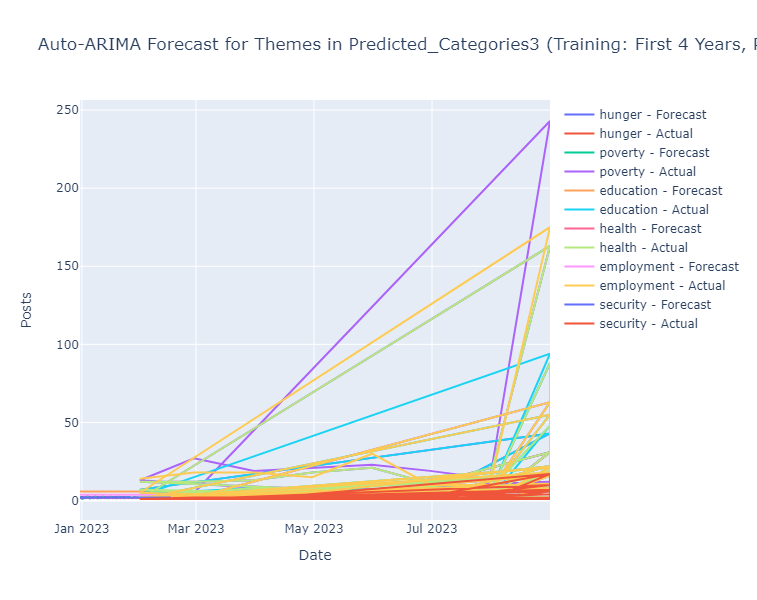

Metrics for hunger:
MAE: 2.929922756907276
MSE: 39.84276944492481
RMSE: 6.312112914462542
MAPE: 92.96817956980475
R-squared (R2): -0.0478130925451008


Metrics for poverty:
MAE: 10.845176675133821
MSE: 1098.6048729123027
RMSE: 33.14520889830539
MAPE: 74.22995759879957
R-squared (R2): -0.10097612777508447


Metrics for education:
MAE: 7.133033723210945
MSE: 276.42806955385566
RMSE: 16.626126113856337
MAPE: 205.42086183814706
R-squared (R2): -0.016289493535088573


Metrics for health:
MAE: 6.612768154529573
MSE: 405.0709192472294
RMSE: 20.126373723232643
MAPE: 64.64014302797635
R-squared (R2): -0.09832562944425982


Metrics for employment:
MAE: 6.817458472861082
MSE: 420.53640970524896
RMSE: 20.506984412761643
MAPE: 146.05643809701584
R-squared (R2): -0.03842118273420203


Metrics for security:
MAE: 1.8724205457460315
MSE: 13.24036970665398
RMSE: 3.638731881666191
MAPE: 74.63464227738817
R-squared (R2): -0.03259018393970692




In [412]:
import pandas as pd
import plotly.graph_objects as go
from pmdarima.arima import auto_arima
from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error, r2_score
import numpy as np

# Assuming 'aggr_df' is already loaded and formatted correctly
aggr_df = monthly_OS.copy()

# List of themes to include for filtering
themes_to_include = ['hunger', 'poverty', 'education', 'health', 'employment', 'security']

# Initialize lists to store metrics
mae_list = []
mse_list = []
rmse_list = []
mape_list = []
r2_list = []

# Create a figure for all top themes
fig = go.Figure()

for theme in themes_to_include:
    # Filter the DataFrame using contains for multi-label column 'Predicted_Categories3'
    df_subset = aggr_df[aggr_df['Predicted_Categories3'].str.contains(theme, na=False)].copy()

    # Reset the index and rename the columns as 'ds' and 'y' for ARIMA
    df_subset = df_subset.reset_index(drop=True)
    df_subset = df_subset[['Date', 'Posts']]  # Select relevant columns
    df_subset.columns = ['ds', 'y']

    # Remove timezone information from 'ds' column
    df_subset['ds'] = pd.to_datetime(df_subset['ds']).dt.tz_localize(None)

    # Step 1: Split the data into training (first 4 years) and testing (last year)
    train_data = df_subset[df_subset['ds'] < '2023-01-01']  # Train on data before 2023
    test_data = df_subset[df_subset['ds'] >= '2023-01-01']  # Test on data from 2023 onwards

    # Step 2: Fit an Auto-ARIMA model to the training data
    model = auto_arima(train_data['y'], seasonal=True, stepwise=True, trace=True)

    # Step 3: Forecast for the next year (same length as test_data)
    future_dates = pd.date_range(start=train_data['ds'].max(), periods=len(test_data), freq='D')

    forecast, conf_int = model.predict(n_periods=len(test_data), return_conf_int=True)

    # Step 4: Store the forecast in a DataFrame
    forecast_df = pd.DataFrame({
        'ds': future_dates,
        'yhat': forecast,
        'yhat_lower': conf_int[:, 0],
        'yhat_upper': conf_int[:, 1]
    })

    # Step 5: Calculate performance metrics on the test data
    actual_values = test_data['y'].values  # Actual values for 2023
    historical_forecast = forecast  # Forecast for 2023

    mae = mean_absolute_error(actual_values, historical_forecast)
    mse = mean_squared_error(actual_values, historical_forecast)
    rmse = np.sqrt(mse)
    mape = mean_absolute_percentage_error(actual_values, historical_forecast) * 100
    r2 = r2_score(actual_values, historical_forecast)

    # Append metrics to the lists
    mae_list.append(mae)
    mse_list.append(mse)
    rmse_list.append(rmse)
    mape_list.append(mape)
    r2_list.append(r2)

    # Add a trace for the forecasted values with the corresponding theme name
    fig.add_trace(go.Scatter(x=forecast_df['ds'], y=forecast_df['yhat'], name=f'{theme} - Forecast'))

    # Optionally, you can add actual values as well to compare
    fig.add_trace(go.Scatter(x=test_data['ds'], y=test_data['y'], mode='lines', name=f'{theme} - Actual'))

# Update layout for the graph
fig.update_layout(
    title='Auto-ARIMA Forecast for Themes in Predicted_Categories3 (Training: First 4 Years, Prediction: 2023)',
    xaxis_title='Date',
    yaxis_title='Posts',
    height=600,
    width=800
)

# Show the graph
fig.show()

# Print the performance metrics
for i, theme in enumerate(themes_to_include):
    print(f'Metrics for {theme}:')
    print(f'MAE: {mae_list[i]}')
    print(f'MSE: {mse_list[i]}')
    print(f'RMSE: {rmse_list[i]}')
    print(f'MAPE: {mape_list[i]}')
    print(f'R-squared (R2): {r2_list[i]}')
    print('\n')


Training model for theme hunger...
X_train shape: (136, 30, 1), y_train shape: (136,)
Epoch 1/50


/tmp/ipykernel_723867/326580801.py:43: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_723867/326580801.py:44: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

2024-09-13 16:22:32.392550: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gr

5/5 [==============================] - 1s 11ms/step - loss: 0.0177
Epoch 2/50
5/5 [==============================] - 0s 9ms/step - loss: 0.0168
Epoch 3/50
5/5 [==============================] - 0s 9ms/step - loss: 0.0166
Epoch 4/50
5/5 [==============================] - 0s 9ms/step - loss: 0.0165
Epoch 5/50
5/5 [==============================] - 0s 9ms/step - loss: 0.0165
Epoch 6/50
5/5 [==============================] - 0s 9ms/step - loss: 0.0163
Epoch 7/50
5/5 [==============================] - 0s 9ms/step - loss: 0.0163
Epoch 8/50
5/5 [==============================] - 0s 9ms/step - loss: 0.0162
Epoch 9/50
5/5 [==============================] - 0s 9ms/step - loss: 0.0162
Epoch 10/50
5/5 [==============================] - 0s 9ms/step - loss: 0.0163
Epoch 11/50
5/5 [==============================] - 0s 9ms/step - loss: 0.0163
Epoch 12/50
5/5 [==============================] - 0s 9ms/step - loss: 0.0162
Epoch 13/50
5/5 [==============================] - 0s 9ms/step - loss: 0.0163
Epoch

2024-09-13 16:22:35.999944: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-13 16:22:36.001008: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-13 16:22:36.001774: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 0s 12ms/step
Training model for theme poverty...
X_train shape: (606, 30, 1), y_train shape: (606,)
Epoch 1/50


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/tmp/ipykernel_723867/326580801.py:43: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_723867/326580801.py:44: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

19/19 [==============================] - 1s 14ms/step - loss: 0.0094
Epoch 2/50
19/19 [==============================] - 0s 13ms/step - loss: 0.0088
Epoch 3/50
19/19 [==============================] - 0s 14ms/step - loss: 0.0087
Epoch 4/50
19/19 [==============================] - 0s 14ms/step - loss: 0.0087
Epoch 5/50
19/19 [==============================] - 0s 14ms/step - loss: 0.0087
Epoch 6/50
19/19 [==============================] - 0s 13ms/step - loss: 0.0086
Epoch 7/50
19/19 [==============================] - 0s 12ms/step - loss: 0.0086
Epoch 8/50
19/19 [==============================] - 0s 11ms/step - loss: 0.0086
Epoch 9/50
19/19 [==============================] - 0s 13ms/step - loss: 0.0086
Epoch 10/50
19/19 [==============================] - 0s 15ms/step - loss: 0.0085
Epoch 11/50
19/19 [==============================] - 0s 12ms/step - loss: 0.0085
Epoch 12/50
19/19 [==============================] - 0s 13ms/step - loss: 0.0085
Epoch 13/50
19/19 [=============================

2024-09-13 16:22:50.613400: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-13 16:22:50.614450: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-13 16:22:50.615201: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 0s 12ms/step
Training model for theme education...
X_train shape: (448, 30, 1), y_train shape: (448,)
Epoch 1/50


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/tmp/ipykernel_723867/326580801.py:43: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_723867/326580801.py:44: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

14/14 [==============================] - 1s 9ms/step - loss: 0.0176
Epoch 2/50
14/14 [==============================] - 0s 9ms/step - loss: 0.0179
Epoch 3/50
14/14 [==============================] - 0s 9ms/step - loss: 0.0171
Epoch 4/50
14/14 [==============================] - 0s 9ms/step - loss: 0.0170
Epoch 5/50
14/14 [==============================] - 0s 9ms/step - loss: 0.0172
Epoch 6/50
14/14 [==============================] - 0s 9ms/step - loss: 0.0170
Epoch 7/50
14/14 [==============================] - 0s 9ms/step - loss: 0.0168
Epoch 8/50
14/14 [==============================] - 0s 9ms/step - loss: 0.0169
Epoch 9/50
14/14 [==============================] - 0s 9ms/step - loss: 0.0169
Epoch 10/50
14/14 [==============================] - 0s 9ms/step - loss: 0.0166
Epoch 11/50
14/14 [==============================] - 0s 9ms/step - loss: 0.0168
Epoch 12/50
14/14 [==============================] - 0s 9ms/step - loss: 0.0167
Epoch 13/50
14/14 [==============================] - 0s 9ms/

2024-09-13 16:23:00.916926: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-13 16:23:00.918000: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-13 16:23:00.918750: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 0s 12ms/step
Training model for theme health...
X_train shape: (611, 30, 1), y_train shape: (611,)
Epoch 1/50


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/tmp/ipykernel_723867/326580801.py:43: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_723867/326580801.py:44: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

20/20 [==============================] - 1s 10ms/step - loss: 0.0052
Epoch 2/50
20/20 [==============================] - 0s 9ms/step - loss: 0.0052
Epoch 3/50
20/20 [==============================] - 0s 10ms/step - loss: 0.0051
Epoch 4/50
20/20 [==============================] - 0s 9ms/step - loss: 0.0051
Epoch 5/50
20/20 [==============================] - 0s 9ms/step - loss: 0.0050
Epoch 6/50
20/20 [==============================] - 0s 10ms/step - loss: 0.0055
Epoch 7/50
20/20 [==============================] - 0s 9ms/step - loss: 0.0050
Epoch 8/50
20/20 [==============================] - 0s 9ms/step - loss: 0.0051
Epoch 9/50
20/20 [==============================] - 0s 9ms/step - loss: 0.0050
Epoch 10/50
20/20 [==============================] - 0s 9ms/step - loss: 0.0050
Epoch 11/50
20/20 [==============================] - 0s 9ms/step - loss: 0.0049
Epoch 12/50
20/20 [==============================] - 0s 9ms/step - loss: 0.0049
Epoch 13/50
20/20 [==============================] - 0s 9

2024-09-13 16:23:14.252239: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-13 16:23:14.253262: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-13 16:23:14.253963: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 0s 13ms/step
Training model for theme employment...
X_train shape: (526, 30, 1), y_train shape: (526,)
Epoch 1/50


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/tmp/ipykernel_723867/326580801.py:43: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_723867/326580801.py:44: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

17/17 [==============================] - 1s 11ms/step - loss: 0.0051
Epoch 2/50
17/17 [==============================] - 0s 11ms/step - loss: 0.0049
Epoch 3/50
17/17 [==============================] - 0s 12ms/step - loss: 0.0047
Epoch 4/50
17/17 [==============================] - 0s 12ms/step - loss: 0.0048
Epoch 5/50
17/17 [==============================] - 0s 14ms/step - loss: 0.0048
Epoch 6/50
17/17 [==============================] - 0s 14ms/step - loss: 0.0048
Epoch 7/50
17/17 [==============================] - 0s 14ms/step - loss: 0.0047
Epoch 8/50
17/17 [==============================] - 0s 11ms/step - loss: 0.0047
Epoch 9/50
17/17 [==============================] - 0s 11ms/step - loss: 0.0047
Epoch 10/50
17/17 [==============================] - 0s 10ms/step - loss: 0.0046
Epoch 11/50
17/17 [==============================] - 0s 12ms/step - loss: 0.0047
Epoch 12/50
17/17 [==============================] - 0s 12ms/step - loss: 0.0045
Epoch 13/50
17/17 [=============================

2024-09-13 16:23:28.620288: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-13 16:23:28.621200: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-13 16:23:28.621996: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 0s 12ms/step
Training model for theme security...
X_train shape: (250, 30, 1), y_train shape: (250,)
Epoch 1/50


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/tmp/ipykernel_723867/326580801.py:43: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_723867/326580801.py:44: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

8/8 [==============================] - 1s 10ms/step - loss: 0.0154
Epoch 2/50
8/8 [==============================] - 0s 10ms/step - loss: 0.0143
Epoch 3/50
8/8 [==============================] - 0s 10ms/step - loss: 0.0144
Epoch 4/50
8/8 [==============================] - 0s 10ms/step - loss: 0.0141
Epoch 5/50
8/8 [==============================] - 0s 10ms/step - loss: 0.0141
Epoch 6/50
8/8 [==============================] - 0s 10ms/step - loss: 0.0142
Epoch 7/50
8/8 [==============================] - 0s 10ms/step - loss: 0.0141
Epoch 8/50
8/8 [==============================] - 0s 10ms/step - loss: 0.0140
Epoch 9/50
8/8 [==============================] - 0s 10ms/step - loss: 0.0140
Epoch 10/50
8/8 [==============================] - 0s 10ms/step - loss: 0.0140
Epoch 11/50
8/8 [==============================] - 0s 10ms/step - loss: 0.0140
Epoch 12/50
8/8 [==============================] - 0s 10ms/step - loss: 0.0139
Epoch 13/50
8/8 [==============================] - 0s 10ms/step - loss: 

2024-09-13 16:23:36.704827: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_2_grad/concat/split_2/split_dim' with dtype int32
	 [[{{node gradients/split_2_grad/concat/split_2/split_dim}}]]
2024-09-13 16:23:36.705883: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'gradients/split_grad/concat/split/split_dim' with dtype int32
	 [[{{node gradients/split_grad/concat/split/split_dim}}]]
2024-09-13 16:23:36.706613: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You mus

1/1 [==============================] - 0s 12ms/step


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



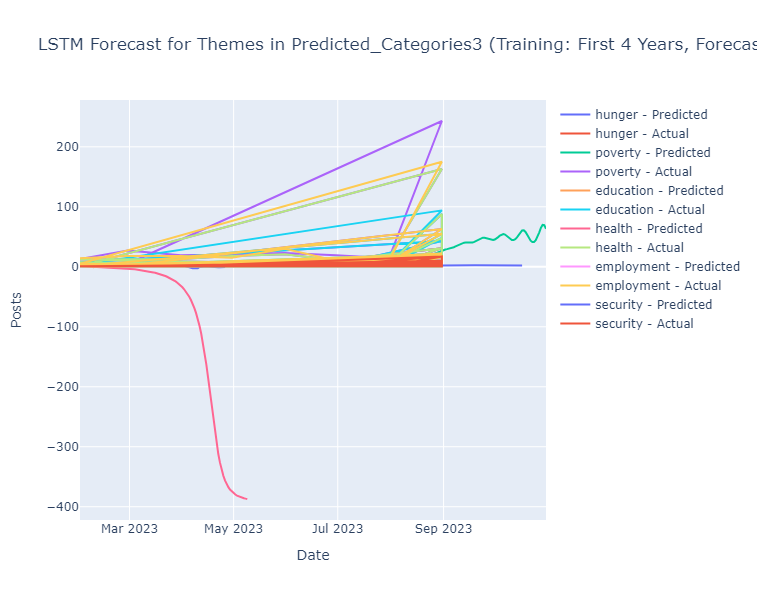

Theme: hunger
Mean Absolute Error (MAE): 4.185497390451254
Mean Squared Error (MSE): 56.601205599571124
Root Mean Squared Error (RMSE): 7.52337727351029
Mean Absolute Percentage Error (MAPE): 152.3174326787291%
R-squared (R2): -0.4885381992095006

Theme: poverty
Mean Absolute Error (MAE): 31.475044988816784
Mean Squared Error (MSE): 1710.5453660210221
Root Mean Squared Error (RMSE): 41.35873989885357
Mean Absolute Percentage Error (MAPE): 1413.3524447337668%
R-squared (R2): -0.7142374477850812

Theme: education
Mean Absolute Error (MAE): 6.564559418994647
Mean Squared Error (MSE): 301.63112803367653
Root Mean Squared Error (RMSE): 17.36753085598746
Mean Absolute Percentage Error (MAPE): 95.16591580514668%
R-squared (R2): -0.10894869265090845

Theme: health
Mean Absolute Error (MAE): 105.26047726686706
Mean Squared Error (MSE): 32401.26772446991
Root Mean Squared Error (RMSE): 180.00352142241528
Mean Absolute Percentage Error (MAPE): 4615.313939565525%
R-squared (R2): -86.85410425019988

In [413]:
import pandas as pd
import numpy as np
import plotly.graph_objects as go
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error, r2_score
import tensorflow as tf

# Assuming 'aggr_df' is loaded correctly
aggr_df = monthly_OS.copy()

# List of themes to include for filtering (update this list as necessary)
themes_to_include = ['hunger', 'poverty', 'education', 'health', 'employment', 'security']

fig = go.Figure()
look_back = 30  # Look back period for LSTM

# Initialize lists to store metrics
mae_list = []
mse_list = []
rmse_list = []
mape_list = []
r2_list = []

for theme in themes_to_include:
    # Filter the DataFrame using contains for multi-label column 'Predicted_Categories3'
    df_subset = aggr_df[aggr_df['Predicted_Categories3'].str.contains(theme, na=False)].reset_index(drop=True)

    # Ensure there are enough data points to proceed
    if len(df_subset) < look_back:
        print(f"Not enough data for training on theme {theme}. Skipping...")
        continue

    df_subset['Date'] = pd.to_datetime(df_subset['Date']).dt.tz_localize(None)

    # Split the data into training (first 4 years) and test (last year)
    train_df = df_subset[df_subset['Date'] < '2023-01-01']  # Training set for first 4 years
    test_df = df_subset[df_subset['Date'] >= '2023-01-01']  # Testing set for 2023

    # Scale the 'Posts' data for LSTM
    scaler = MinMaxScaler()
    train_df['Posts'] = scaler.fit_transform(train_df[['Posts']].values)
    test_df['Posts'] = scaler.transform(test_df[['Posts']].values)

    # Create sequences for LSTM model
    X_train, y_train = [], []
    for i in range(look_back, len(train_df)):
        X_train.append(train_df['Posts'].values[i-look_back:i])
        y_train.append(train_df['Posts'].values[i])

    X_train, y_train = np.array(X_train), np.array(y_train)
    X_train = X_train.reshape((X_train.shape[0], X_train.shape[1], 1))

    # Ensure there is enough training data
    if X_train.shape[0] > 0:
        # Build and train LSTM model
        model = Sequential([
            LSTM(50, input_shape=(look_back, 1)),
            Dense(1)
        ])
        model.compile(optimizer='adam', loss='mean_squared_error')

        print(f'Training model for theme {theme}...')
        print(f'X_train shape: {X_train.shape}, y_train shape: {y_train.shape}')

        # Train the model
        model.fit(X_train, y_train, epochs=50, batch_size=32, verbose=1)

        # Forecasting the next year (same length as test_df)
        future_X = train_df['Posts'].values[-look_back:].reshape(1, look_back, 1)
        future_preds = []
        for _ in range(len(test_df)):
            future_pred = model.predict(future_X)
            future_preds.append(future_pred[0][0])
            future_X = np.append(future_X[:, 1:, :], future_pred.reshape(1, 1, 1), axis=1)

        # Inverse transform the predictions and actual test data back to original scale
        future_preds = scaler.inverse_transform(np.array(future_preds).reshape(-1, 1)).flatten()
        actual_values = scaler.inverse_transform(test_df['Posts'].values.reshape(-1, 1)).flatten()

        # Calculate performance metrics
        mae = mean_absolute_error(actual_values, future_preds)
        mse = mean_squared_error(actual_values, future_preds)
        rmse = np.sqrt(mse)
        mape = mean_absolute_percentage_error(actual_values, future_preds) * 100
        r2 = r2_score(actual_values, future_preds)

        # Store metrics
        mae_list.append(mae)
        mse_list.append(mse)
        rmse_list.append(rmse)
        mape_list.append(mape)
        r2_list.append(r2)

        # Plot predictions
        future_dates = pd.date_range(start=test_df['Date'].iloc[0], periods=len(future_preds), freq='D')
        fig.add_trace(go.Scatter(x=future_dates, y=future_preds, name=f'{theme} - Predicted'))

        # Plot actual data for comparison
        fig.add_trace(go.Scatter(x=test_df['Date'], y=actual_values, name=f'{theme} - Actual'))

    else:
        print(f"Not enough data for theme {theme} after look-back period.")

# Update layout for the graph
fig.update_layout(
    title='LSTM Forecast for Themes in Predicted_Categories3 (Training: First 4 Years, Forecast: 2023)',
    xaxis_title='Date',
    yaxis_title='Posts',
    height=600,
    width=800
)
fig.show()

# Display performance metrics
for i, theme in enumerate(themes_to_include):
    if i < len(mae_list):  # Check if metrics were computed
        print(f'Theme: {theme}')
        print(f'Mean Absolute Error (MAE): {mae_list[i]}')
        print(f'Mean Squared Error (MSE): {mse_list[i]}')
        print(f'Root Mean Squared Error (RMSE): {rmse_list[i]}')
        print(f'Mean Absolute Percentage Error (MAPE): {mape_list[i]}%')
        print(f'R-squared (R2): {r2_list[i]}')
        print()
    else:
        print(f'Insufficient data to compute metrics for theme: {theme}')


100%|██████████| 50/50 [00:03<00:00, 13.03it/s, epoch=10/10, avg_epoch_loss=0.497]


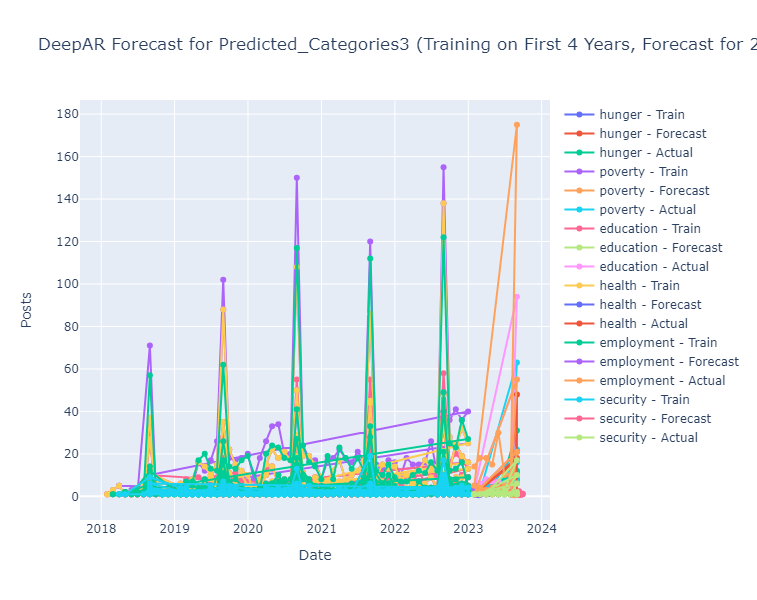

Theme: hunger
MAE: 2.857215491930644
MSE: 42.49445657198539
RMSE: 6.518777229817367
MAPE: 89.99%
R-squared (R2): -0.07366466522216797

Theme: poverty
MAE: 1.153801792860031
MSE: 3.740668295295448
RMSE: 1.9340807364987243
MAPE: 44.45%
R-squared (R2): -0.36853718757629395

Theme: education
MAE: 6.96725191672643
MSE: 277.9408441290271
RMSE: 16.671557939467657
MAPE: 126.64%
R-squared (R2): -0.07571017742156982

Theme: health
MAE: 0.9885821044445038
MSE: 3.0878997991264354
RMSE: 1.7572421003169811
MAPE: 41.58%
R-squared (R2): -0.06847739219665527

Theme: employment
MAE: 2.521651965379715
MSE: 26.744247824904743
RMSE: 5.1714841027411795
MAPE: 71.51%
R-squared (R2): -0.16386163234710693

Theme: security
MAE: 0.9372395515441895
MSE: 2.724136738887131
RMSE: 1.650495906958612
MAPE: 43.18%
R-squared (R2): -0.24075067043304443



In [427]:
import pandas as pd
import numpy as np
from gluonts.dataset.common import ListDataset
from gluonts.mx.model.deepar import DeepAREstimator
from gluonts.mx.trainer import Trainer
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import plotly.graph_objects as go
import plotly.offline as pyo

# Assuming 'aggr_df' is loaded with 'Date', 'Predicted_Categories3', and 'Posts'
# Convert 'Date' to datetime and set it as the index if not already done
aggr_df = monthly_OS.copy()
aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])
aggr_df.set_index('Date', inplace=True)

# Define hyperparameters for the DeepAR model
prediction_length = 30  # Number of time steps to forecast (reduced to 180)
context_length = 90      # Number of time steps to use for context (reduced to 90)
freq = 'D'               # Daily data

# List of themes to include for filtering
themes_to_include = ['hunger', 'poverty', 'education', 'health', 'employment', 'security']

# Initialize lists to store performance metrics
mae_list = []
mse_list = []
rmse_list = []
mape_list = []
r2_list = []

# Initialize a list to store themes for which metrics were calculated
valid_themes = []

# Create a figure for all themes using Plotly
fig = go.Figure()

for theme in themes_to_include:
    # Filter the DataFrame using contains for multi-label column 'Predicted_Categories3'
    df_subset = aggr_df[aggr_df['Predicted_Categories3'].str.contains(theme, na=False)]['Posts'].to_frame()
    df_subset.rename(columns={'Posts': 'y'}, inplace=True)

    # Check if the subset has enough data points for training and testing
    if len(df_subset) < (context_length + prediction_length):
        print(f"Not enough data for theme '{theme}'. Skipping...")
        continue

    # Split the data into training (first 4 years) and testing (last year)
    train_df = df_subset[df_subset.index < '2023-01-01']  # Train on the first four years
    test_df = df_subset[df_subset.index >= '2023-01-01']  # Test on 2023

    # Define the minimum required length (context_length + prediction_length)
    min_required_length = context_length + prediction_length

    if len(df_subset) >= min_required_length:
        # Split data into training and prediction
        train_data = ListDataset(
            [{"start": df_subset.index[0], "target": df_subset.y[:-prediction_length]}],
            freq=freq
        )

        # Define and train the DeepAR estimator
        estimator = DeepAREstimator(
            prediction_length=prediction_length,
            context_length=context_length,
            freq=freq,
            trainer=Trainer(epochs=10)
        )
        predictor = estimator.train(training_data=train_data)

        # Generate forecasts
        test_data = ListDataset(
            [{"start": df_subset.index[-context_length], "target": df_subset.y[-context_length:].tolist()}],
            freq=freq
        )

        forecast = list(predictor.predict(test_data))
        forecast_values = np.array([f.mean for f in forecast]).flatten()
        lower_bound = np.array([f.quantile(0.025) for f in forecast]).flatten()  # 2.5th percentile (lower bound)
        upper_bound = np.array([f.quantile(0.975) for f in forecast]).flatten()  # 97.5th percentile (upper bound)

        # Extract actual values for the prediction period
        actual_values = df_subset.y.values[-prediction_length:]

        # Calculate performance metrics
        mae = mean_absolute_error(actual_values, forecast_values)
        mse = mean_squared_error(actual_values, forecast_values)
        rmse = np.sqrt(mse)
        mape = np.mean(np.abs((actual_values - forecast_values) / actual_values)) * 100
        r2 = r2_score(actual_values, forecast_values)

        # Append metrics to the respective lists
        mae_list.append(mae)
        mse_list.append(mse)
        rmse_list.append(rmse)
        mape_list.append(mape)
        r2_list.append(r2)

        # Append the theme to the valid themes list
        valid_themes.append(theme)

        # Plot the actual and forecasted values using Plotly
        forecast_dates = pd.date_range(start=test_df.index[0], periods=len(forecast_values), freq=freq)
        fig.add_trace(go.Scatter(x=train_df.index, y=train_df['y'], mode='lines+markers', name=f'{theme} - Train'))
        fig.add_trace(go.Scatter(x=forecast_dates, y=forecast_values, mode='lines+markers', name=f'{theme} - Forecast'))
        fig.add_trace(go.Scatter(x=test_df.index[:len(actual_values)], y=test_df['y'][:len(actual_values)], mode='lines+markers', name=f'{theme} - Actual'))

# Update layout for the graph using Plotly
fig.update_layout(
    title='DeepAR Forecast for Predicted_Categories3 (Training on First 4 Years, Forecast for 2023)',
    xaxis_title='Date',
    yaxis_title='Posts',
    height=600,
    width=800,
    showlegend=True
)

# Show the graph using Plotly
pyo.iplot(fig)

# Print the performance metrics for each valid theme
for i, theme in enumerate(valid_themes):
    print(f'Theme: {theme}')
    print(f'MAE: {mae_list[i]}')
    print(f'MSE: {mse_list[i]}')
    print(f'RMSE: {rmse_list[i]}')
    print(f'MAPE: {mape_list[i]:.2f}%')
    print(f'R-squared (R2): {r2_list[i]}')
    print()


In [426]:
aggr_df.shape

(1382, 2)

Not enough data for theme 'hunger' for training or testing. Skipping...


100%|██████████| 50/50 [00:02<00:00, 21.49it/s, epoch=10/10, avg_epoch_loss=2.32]
/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

100%|██████████| 50/50 [00:02<00:00, 21.47it/s, epoch=10/10, avg_epoch_loss=1.87]
/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

100%|██████████| 50/50 [00:02<00:00, 22.11it/s, epoch=10/10, avg_epoch_loss=2.23]
/home/hsibitenda/anaconda3/envs/harriet_env/lib/

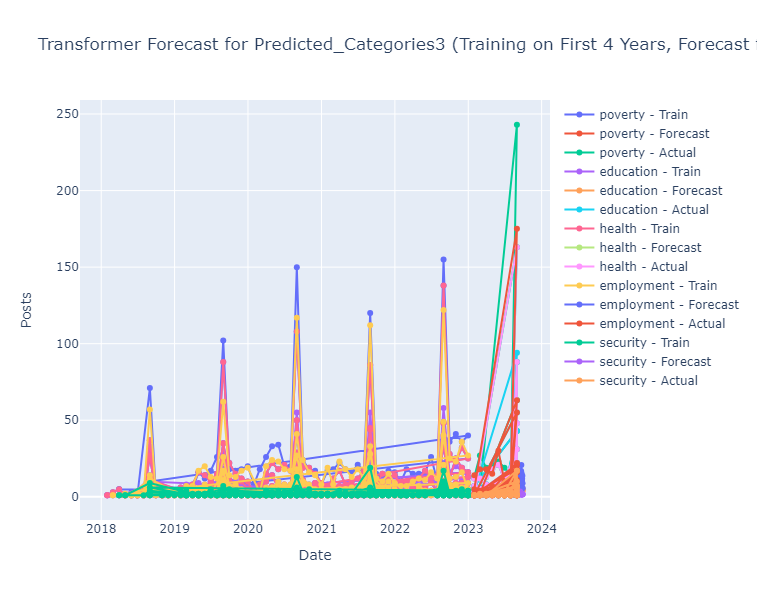

Theme: poverty
MAE: 13.159296488761902
MSE: 1163.5638832857608
RMSE: 34.11105221604518
MAPE: 93.18%
R-squared (R2): -0.13761508464813232

Theme: education
MAE: 8.176434199015299
MSE: 299.41978157844005
RMSE: 17.303750506131323
MAPE: 239.91%
R-squared (R2): -0.05100548267364502

Theme: health
MAE: 13.422059325377147
MSE: 1136.6323856963597
RMSE: 33.71397908429617
MAPE: 104.48%
R-squared (R2): -0.1183704137802124

Theme: employment
MAE: 7.829738259315491
MSE: 80.83846240607569
RMSE: 8.991021210411846
MAPE: 582.43%
R-squared (R2): -3.2149710655212402

Theme: security
MAE: 1.998823889096578
MSE: 11.790370415850752
RMSE: 3.433710881226134
MAPE: 98.81%
R-squared (R2): -0.150404691696167



In [434]:
import pandas as pd
import numpy as np
from gluonts.dataset.common import ListDataset
from gluonts.mx.model.transformer import TransformerEstimator
from gluonts.mx.trainer import Trainer
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import plotly.graph_objects as go
import plotly.offline as pyo

# Assuming 'aggr_df' is loaded with 'Date', 'Predicted_Categories3', and 'Posts'
aggr_df = monthly_OS.copy()
aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])
aggr_df.set_index('Date', inplace=True)

# Define hyperparameters for the Transformer model
prediction_length = 30  # Number of time steps to forecast
context_length = 90     # Number of time steps to use for context
freq = 'D'              # Daily data

# List of themes to include for filtering
themes_to_include = ['hunger', 'poverty', 'education', 'health', 'employment', 'security']

# Initialize lists to store performance metrics
mae_list = []
mse_list = []
rmse_list = []
mape_list = []
r2_list = []

# Initialize a list to store themes for which metrics were calculated
valid_themes = []

# Create a figure for all themes using Plotly
fig = go.Figure()

for theme in themes_to_include:
    # Filter the DataFrame using contains for multi-label column 'Predicted_Categories3'
    df_subset = aggr_df[aggr_df['Predicted_Categories3'].str.contains(theme, na=False)].copy()

    # Reset the index and select the relevant columns
    df_subset.reset_index(inplace=True)
    df_subset = df_subset[['Date', 'Posts']]
    df_subset.columns = ['ds', 'y']

    # Split the data into training (first 4 years) and testing (last year)
    train_df = df_subset[df_subset['ds'] < '2023-01-01']
    test_df = df_subset[df_subset['ds'] >= '2023-01-01']

    if len(train_df) < context_length or len(test_df) < prediction_length:
        print(f"Not enough data for theme '{theme}' for training or testing. Skipping...")
        continue

    valid_themes.append(theme)

    # Create a GluonTS dataset for the training data
    train_data = ListDataset(
        [{"start": train_df['ds'].iloc[0], "target": train_df['y'].values}],
        freq=freq
    )

    # Define and train the Transformer estimator
    estimator = TransformerEstimator(
        prediction_length=prediction_length,
        context_length=context_length,
        freq=freq,
        trainer=Trainer(epochs=10)
    )
    predictor = estimator.train(train_data)

    # Create test data for prediction
    test_data = ListDataset(
        [{"start": test_df['ds'].iloc[0], "target": test_df['y'].values[:-prediction_length]}],
        freq=freq
    )

    # Generate forecasts for the current theme
    forecast_iterator = predictor.predict(test_data)
    forecasts = list(forecast_iterator)

    # Flatten the forecast values to match the length of the actual values
    forecast_values = forecasts[0].mean.flatten()  # Ensure it's a flat array
    if len(forecast_values) != prediction_length:
        print(f"Warning: Forecast length mismatch for theme '{theme}'. Skipping...")
        continue

    mae = mean_absolute_error(test_df['y'][-prediction_length:], forecast_values)
    mse = mean_squared_error(test_df['y'][-prediction_length:], forecast_values)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((test_df['y'][-prediction_length:] - forecast_values) / test_df['y'][-prediction_length:])) * 100
    r2 = r2_score(test_df['y'][-prediction_length:], forecast_values)

    mae_list.append(mae)
    mse_list.append(mse)
    rmse_list.append(rmse)
    mape_list.append(mape)
    r2_list.append(r2)

    forecast_dates = pd.date_range(start=test_df['ds'].iloc[-prediction_length], periods=prediction_length, freq=freq)
    fig.add_trace(go.Scatter(x=train_df['ds'], y=train_df['y'], mode='lines+markers', name=f'{theme} - Train'))
    fig.add_trace(go.Scatter(x=forecast_dates, y=forecast_values, mode='lines+markers', name=f'{theme} - Forecast'))
    fig.add_trace(go.Scatter(x=test_df['ds'], y=test_df['y'], mode='lines+markers', name=f'{theme} - Actual'))

# Update layout for the graph using Plotly
fig.update_layout(
    title='Transformer Forecast for Predicted_Categories3 (Training on First 4 Years, Forecast for Last Year)',
    xaxis_title='Date',
    yaxis_title='Posts',
    height=600,
    width=800,
    showlegend=True
)

# Show the graph using Plotly
pyo.iplot(fig)

# Print the performance metrics for each valid theme
for i, theme in enumerate(valid_themes):
    print(f'Theme: {theme}')
    print(f'MAE: {mae_list[i]}')
    print(f'MSE: {mse_list[i]}')
    print(f'RMSE: {rmse_list[i]}')
    print(f'MAPE: {mape_list[i]:.2f}%')
    print(f'R-squared (R2): {r2_list[i]}')
    print()


In [215]:
import pandas as pd

# Data for the different models and themes
data = {
    "Model": ["Prophet", "Prophet", "Prophet", "Prophet", "Prophet",
              "ARIMA", "ARIMA", "ARIMA", "ARIMA", "ARIMA", "ARIMA",
              "LSTM", "LSTM", "LSTM", "LSTM", "LSTM", "LSTM",
              "DeepAR", "DeepAR", "DeepAR", "DeepAR", "DeepAR", "DeepAR",
              "Transformer", "Transformer", "Transformer", "Transformer", "Transformer"],
    "Theme": ["poverty", "education", "health", "employment", "security",
              "hunger", "poverty", "education", "health", "employment", "security",
              "hunger", "poverty", "education", "health", "employment", "security",
              "hunger", "poverty", "education", "health", "employment", "security",
              "poverty", "education", "health", "employment", "security"],
    "MAE": [10.92, 6.92, 7.53, 10.60, 1.80, 
            2.93, 10.85, 7.13, 6.61, 6.82, 1.87,
            4.19, 31.47, 6.56, 105.26, 6.93, 2.13,
            2.86, 1.15, 6.97, 0.99, 2.52, 0.94,
            13.16, 8.18, 13.42, 7.83, 1.99],
    "MSE": [1045.24, 294.97, 393.31, 556.53, 13.68,
            39.84, 1098.60, 276.43, 405.07, 420.54, 13.24,
            56.60, 1710.55, 301.63, 32401.27, 418.76, 12.90,
            42.49, 3.74, 277.94, 3.09, 26.74, 2.72,
            1163.56, 299.42, 1136.63, 80.84, 11.79],
    "RMSE": [32.33, 17.17, 19.83, 23.59, 3.70,
             6.31, 33.15, 16.63, 20.13, 20.51, 3.64,
             7.52, 41.36, 17.37, 180.00, 20.46, 3.59,
             6.52, 1.93, 16.67, 1.76, 5.17, 1.65,
             34.11, 17.30, 33.71, 8.99, 3.43],
    "MAPE": [199.87, 153.52, 171.08, 281.64, 60.04,
             92.97, 74.23, 205.42, 64.64, 146.06, 74.63,
             152.32, 1413.35, 95.17, 4615.31, 155.87, 105.05,
             89.99, 44.45, 126.64, 41.58, 71.51, 43.18,
             93.18, 239.91, 104.48, 582.43, 98.81],
    "R2": [-0.05, -0.08, -0.07, -0.37, -0.07,
           -0.05, -0.10, -0.02, -0.10, -0.03, -0.03,
           -0.49, -0.71, -0.11, -86.85, -0.03, -0.01,
           -0.07, -0.37, -0.08, -0.07, -0.16, -0.24,
           -0.14, -0.05, -0.12, -3.21, -0.15]
}

# Create the DataFrame
df_metrics = pd.DataFrame(data)

# Exclude the 'Theme' column since it's non-numeric
df_metrics_numeric = df_metrics.drop(columns=['Theme'])

# Group the data by model and compute the mean for each metric
mean_scores = df_metrics_numeric.groupby('Model').mean()

# Display the mean scores
print(mean_scores)


                   MAE          MSE       RMSE         MAPE      R2
Model                                                              
ARIMA         6.035000   375.620000  16.728333   109.658333  -0.055
DeepAR        2.571667    59.453333   5.616667    69.558333  -0.165
LSTM         26.090000  5816.951667  45.050000  1089.511667 -14.700
Prophet       7.554000   460.746000  19.324000   173.230000  -0.128
Transformer   8.916000   538.448000  19.508000   223.762000  -0.734


Automatically calculated weights:
MSE: 0.2019212506557679, MAE: 0.20155097565517052, RMSE: 0.20482610813969157, MAPE: 0.19241549285864112, R2: 0.1992861726907289


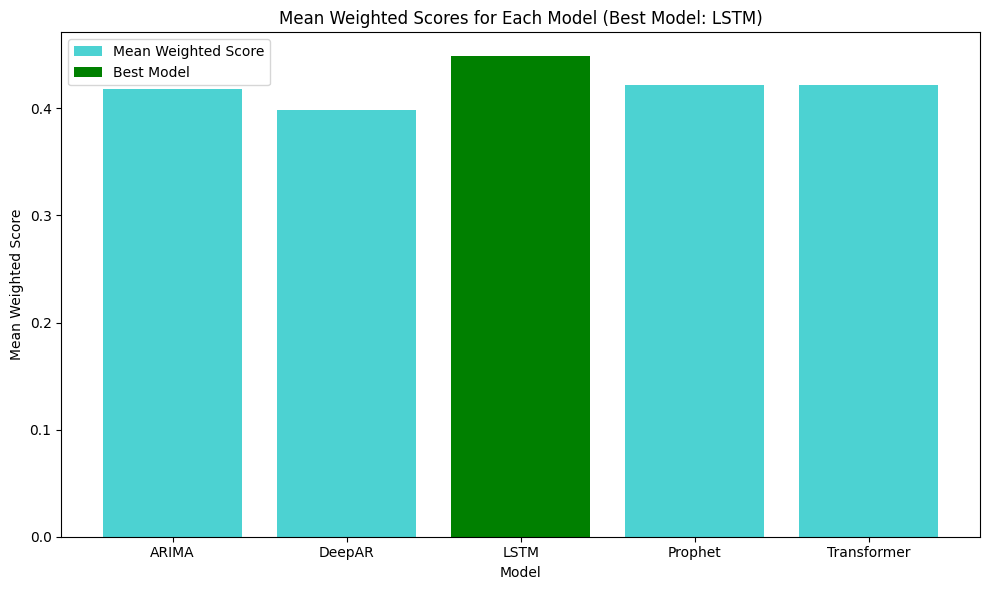

In [216]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Data for the different models and themes
data = {
    "Model": ["Prophet", "Prophet", "Prophet", "Prophet", "Prophet",
              "ARIMA", "ARIMA", "ARIMA", "ARIMA", "ARIMA", "ARIMA",
              "LSTM", "LSTM", "LSTM", "LSTM", "LSTM", "LSTM",
              "DeepAR", "DeepAR", "DeepAR", "DeepAR", "DeepAR", "DeepAR",
              "Transformer", "Transformer", "Transformer", "Transformer", "Transformer"],
    "Theme": ["poverty", "education", "health", "employment", "security",
              "hunger", "poverty", "education", "health", "employment", "security",
              "hunger", "poverty", "education", "health", "employment", "security",
              "hunger", "poverty", "education", "health", "employment", "security",
              "poverty", "education", "health", "employment", "security"],
    "MAE": [10.92, 6.92, 7.53, 10.60, 1.80, 
            2.93, 10.85, 7.13, 6.61, 6.82, 1.87,
            4.19, 31.47, 6.56, 105.26, 6.93, 2.13,
            2.86, 1.15, 6.97, 0.99, 2.52, 0.94,
            13.16, 8.18, 13.42, 7.83, 1.99],
    "MSE": [1045.24, 294.97, 393.31, 556.53, 13.68,
            39.84, 1098.60, 276.43, 405.07, 420.54, 13.24,
            56.60, 1710.55, 301.63, 32401.27, 418.76, 12.90,
            42.49, 3.74, 277.94, 3.09, 26.74, 2.72,
            1163.56, 299.42, 1136.63, 80.84, 11.79],
    "RMSE": [32.33, 17.17, 19.83, 23.59, 3.70,
             6.31, 33.15, 16.63, 20.13, 20.51, 3.64,
             7.52, 41.36, 17.37, 180.00, 20.46, 3.59,
             6.52, 1.93, 16.67, 1.76, 5.17, 1.65,
             34.11, 17.30, 33.71, 8.99, 3.43],
    "MAPE": [199.87, 153.52, 171.08, 281.64, 60.04,
             92.97, 74.23, 205.42, 64.64, 146.06, 74.63,
             152.32, 1413.35, 95.17, 4615.31, 155.87, 105.05,
             89.99, 44.45, 126.64, 41.58, 71.51, 43.18,
             93.18, 239.91, 104.48, 582.43, 98.81],
    "R2": [-0.05, -0.08, -0.07, -0.37, -0.07,
           -0.05, -0.10, -0.02, -0.10, -0.03, -0.03,
           -0.49, -0.71, -0.11, -86.85, -0.03, -0.01,
           -0.07, -0.37, -0.08, -0.07, -0.16, -0.24,
           -0.14, -0.05, -0.12, -3.21, -0.15]
}

# Create the DataFrame
df_metrics = pd.DataFrame(data)

# Normalize the metrics (lower is better for MAE, MSE, RMSE, MAPE; higher is better for R2)
df_metrics['NORMALIZED_MSE'] = (df_metrics['MSE'] - df_metrics['MSE'].min()) / (df_metrics['MSE'].max() - df_metrics['MSE'].min())
df_metrics['NORMALIZED_MAE'] = (df_metrics['MAE'] - df_metrics['MAE'].min()) / (df_metrics['MAE'].max() - df_metrics['MAE'].min())
df_metrics['NORMALIZED_RMSE'] = (df_metrics['RMSE'] - df_metrics['RMSE'].min()) / (df_metrics['RMSE'].max() - df_metrics['RMSE'].min())
df_metrics['NORMALIZED_MAPE'] = (df_metrics['MAPE'] - df_metrics['MAPE'].min()) / (df_metrics['MAPE'].max() - df_metrics['MAPE'].min())
df_metrics['NORMALIZED_R2'] = (df_metrics['R2'] - df_metrics['R2'].min()) / (df_metrics['R2'].max() - df_metrics['R2'].min())

# Calculate the variance of each normalized metric
var_mse = df_metrics['NORMALIZED_MSE'].var()
var_mae = df_metrics['NORMALIZED_MAE'].var()
var_rmse = df_metrics['NORMALIZED_RMSE'].var()
var_mape = df_metrics['NORMALIZED_MAPE'].var()
var_r2 = df_metrics['NORMALIZED_R2'].var()

# Invert variances (lower variance gets higher weight)
inv_var_mse = 1 / var_mse
inv_var_mae = 1 / var_mae
inv_var_rmse = 1 / var_rmse
inv_var_mape = 1 / var_mape
inv_var_r2 = 1 / var_r2

# Normalize the inverted variances to sum to 1
total_inv_var = inv_var_mse + inv_var_mae + inv_var_rmse + inv_var_mape + inv_var_r2

WEIGHT_MSE = inv_var_mse / total_inv_var
WEIGHT_MAE = inv_var_mae / total_inv_var
WEIGHT_RMSE = inv_var_rmse / total_inv_var
WEIGHT_MAPE = inv_var_mape / total_inv_var
WEIGHT_R2 = inv_var_r2 / total_inv_var

# Print the calculated weights for reference
print(f"Automatically calculated weights:\nMSE: {WEIGHT_MSE}, MAE: {WEIGHT_MAE}, RMSE: {WEIGHT_RMSE}, MAPE: {WEIGHT_MAPE}, R2: {WEIGHT_R2}")

# Calculate the weighted score
df_metrics['WEIGHTED_SCORE'] = (
    WEIGHT_MSE * df_metrics['NORMALIZED_MSE'] +
    WEIGHT_MAE * df_metrics['NORMALIZED_MAE'] +
    WEIGHT_RMSE * df_metrics['NORMALIZED_RMSE'] +
    WEIGHT_MAPE * (1 - df_metrics['NORMALIZED_MAPE']) +  # (1 - NORMALIZED_MAPE) because lower MAPE is better
    WEIGHT_R2 * df_metrics['NORMALIZED_R2']
)

# Calculate the mean weighted score for each model
mean_scores = df_metrics.groupby('Model')['WEIGHTED_SCORE'].mean()

# Find the best model based on the highest mean score
best_model = mean_scores.idxmax()

# Plot the mean weighted scores for each model
plt.figure(figsize=(10, 6))
plt.bar(mean_scores.index, mean_scores, color='c', alpha=0.7, label='Mean Weighted Score')

# Highlight the best model with a different color
plt.bar(best_model, mean_scores[best_model], color='g', label='Best Model')

# Set labels and title
plt.xlabel('Model')
plt.ylabel('Mean Weighted Score')
plt.title(f'Mean Weighted Scores for Each Model (Best Model: {best_model})')

# Show the plot
plt.legend()
plt.tight_layout()
plt.show()


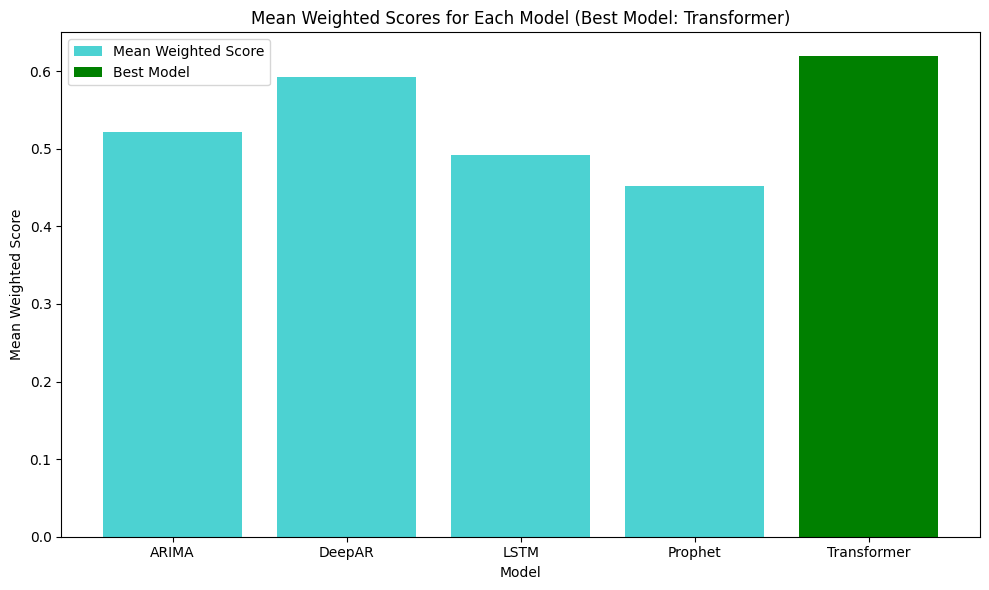

          Model   Category     MAE       MSE    RMSE    MAPE    R2  \
0       Prophet      Theme   10.92   1045.24   32.33  199.87 -0.05   
1         ARIMA      Theme    2.93     39.84    6.31   92.97 -0.05   
2          LSTM      Theme    4.19     56.60    7.52  152.32 -0.49   
3        DeepAR      Theme    2.86     42.49    6.52   89.99 -0.07   
4   Transformer      Theme   13.16   1163.56   34.11   93.18 -0.14   
5       Prophet  Sentiment   21.93   1134.30   33.68  320.68 -1.18   
6         ARIMA  Sentiment   19.06    566.64   23.80  374.47 -0.09   
7          LSTM  Sentiment   20.81    642.35   25.34  304.84 -0.01   
8        DeepAR  Sentiment   18.35    488.56   22.10  216.43  0.10   
9   Transformer  Sentiment   14.16    485.06   22.02  145.04  0.11   
10      Prophet      Topic  136.63  63710.42  252.41  107.09 -0.23   
11        ARIMA      Topic   99.64  28830.21  169.79   84.22 -0.01   
12         LSTM      Topic  106.65  28727.75  169.49   99.21 -0.01   
13       DeepAR     

In [218]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Sample data for topics, sentiments, and themes
# You can replace this with your actual data
data_themes = {
    "Model": ["Prophet", "ARIMA", "LSTM", "DeepAR", "Transformer"],
    "Category": ["Theme"] * 5,
    "MAE": [10.92, 2.93, 4.19, 2.86, 13.16],
    "MSE": [1045.24, 39.84, 56.60, 42.49, 1163.56],
    "RMSE": [32.33, 6.31, 7.52, 6.52, 34.11],
    "MAPE": [199.87, 92.97, 152.32, 89.99, 93.18],
    "R2": [-0.05, -0.05, -0.49, -0.07, -0.14]
}

data_sentiments = {
    "Model": ["Prophet", "ARIMA", "LSTM", "DeepAR", "Transformer"],
    "Category": ["Sentiment"] * 5,
    "MAE": [21.93, 19.06, 20.81, 18.35, 14.16],
    "MSE": [1134.30, 566.64, 642.35, 488.56, 485.06],
    "RMSE": [33.68, 23.80, 25.34, 22.10, 22.02],
    "MAPE": [320.68, 374.47, 304.84, 216.43, 145.04],
    "R2": [-1.18, -0.09, -0.01, 0.10, 0.11]
}

data_topics = {
    "Model": ["Prophet", "ARIMA", "LSTM", "DeepAR", "Transformer"],
    "Category": ["Topic"] * 5,
    "MAE": [136.63, 99.64, 106.65, 191.56, 146.95],
    "MSE": [63710.42, 28830.21, 28727.75, 58074.60, 56499.95],
    "RMSE": [252.41, 169.79, 169.49, 240.99, 237.70],
    "MAPE": [107.09, 84.22, 99.21, 242.39, 139.45],
    "R2": [-0.23, -0.01, -0.01, -0.12, -0.09]
}

# Create separate DataFrames for themes, sentiments, and topics
df_themes = pd.DataFrame(data_themes)
df_sentiments = pd.DataFrame(data_sentiments)
df_topics = pd.DataFrame(data_topics)

# Concatenate the DataFrames for themes, sentiments, and topics
df_joint = pd.concat([df_themes, df_sentiments, df_topics], ignore_index=True)

# Normalize the metrics (lower is better for MAE, MSE, RMSE, MAPE; higher is better for R2)
df_joint['NORMALIZED_MSE'] = (df_joint['MSE'] - df_joint['MSE'].min()) / (df_joint['MSE'].max() - df_joint['MSE'].min())
df_joint['NORMALIZED_MAE'] = (df_joint['MAE'] - df_joint['MAE'].min()) / (df_joint['MAE'].max() - df_joint['MAE'].min())
df_joint['NORMALIZED_RMSE'] = (df_joint['RMSE'] - df_joint['RMSE'].min()) / (df_joint['RMSE'].max() - df_joint['RMSE'].min())
df_joint['NORMALIZED_MAPE'] = (df_joint['MAPE'] - df_joint['MAPE'].min()) / (df_joint['MAPE'].max() - df_joint['MAPE'].min())
df_joint['NORMALIZED_R2'] = (df_joint['R2'] - df_joint['R2'].min()) / (df_joint['R2'].max() - df_joint['R2'].min())

# Calculate the variance of each normalized metric
var_mse = df_joint['NORMALIZED_MSE'].var()
var_mae = df_joint['NORMALIZED_MAE'].var()
var_rmse = df_joint['NORMALIZED_RMSE'].var()
var_mape = df_joint['NORMALIZED_MAPE'].var()
var_r2 = df_joint['NORMALIZED_R2'].var()

# Invert variances (lower variance gets higher weight)
inv_var_mse = 1 / var_mse
inv_var_mae = 1 / var_mae
inv_var_rmse = 1 / var_rmse
inv_var_mape = 1 / var_mape
inv_var_r2 = 1 / var_r2

# Normalize the inverted variances to sum to 1
total_inv_var = inv_var_mse + inv_var_mae + inv_var_rmse + inv_var_mape + inv_var_r2

WEIGHT_MSE = inv_var_mse / total_inv_var
WEIGHT_MAE = inv_var_mae / total_inv_var
WEIGHT_RMSE = inv_var_rmse / total_inv_var
WEIGHT_MAPE = inv_var_mape / total_inv_var
WEIGHT_R2 = inv_var_r2 / total_inv_var

# Calculate the weighted score
df_joint['WEIGHTED_SCORE'] = (
    WEIGHT_MSE * df_joint['NORMALIZED_MSE'] +
    WEIGHT_MAE * df_joint['NORMALIZED_MAE'] +
    WEIGHT_RMSE * df_joint['NORMALIZED_RMSE'] +
    WEIGHT_MAPE * (1 - df_joint['NORMALIZED_MAPE']) +  # (1 - NORMALIZED_MAPE) because lower MAPE is better
    WEIGHT_R2 * df_joint['NORMALIZED_R2']
)

# Calculate the mean weighted score for each model
mean_scores = df_joint.groupby('Model')['WEIGHTED_SCORE'].mean()

# Find the best model based on the highest mean score
best_model = mean_scores.idxmax()

# Plot the mean weighted scores for each model
plt.figure(figsize=(10, 6))
plt.bar(mean_scores.index, mean_scores, color='c', alpha=0.7, label='Mean Weighted Score')

# Highlight the best model with a different color
plt.bar(best_model, mean_scores[best_model], color='g', label='Best Model')

# Set labels and title
plt.xlabel('Model')
plt.ylabel('Mean Weighted Score')
plt.title(f'Mean Weighted Scores for Each Model (Best Model: {best_model})')

# Show the plot
plt.legend()
plt.tight_layout()
plt.show()

# Print the joint DataFrame for inspection
print(df_joint)


In [81]:
aggr_df.shape

(1382, 3)

In [82]:
print(performance_metrics_df)

          Model       Theme        mae         mse       rmse        mape  \
0    Auto-ARIMA     poverty   6.315083  285.551297  16.898263   76.231662   
1       Prophet     poverty  20.067540  712.518598  26.693044  847.552185   
2          LSTM     poverty   7.193244  257.944631  16.060655  231.982134   
3        DeepAR     poverty   7.000000   49.000000   7.000000  100.000000   
4   Transformer     poverty   7.000000   49.000000   7.000000  100.000000   
5    Auto-ARIMA   education   5.679899   74.224901   8.615387  310.384850   
6       Prophet   education  11.525999  259.542335  16.110318  672.722757   
7          LSTM   education   5.103129   72.505526   8.515018  273.425071   
8        DeepAR   education   1.000000    1.000000   1.000000  100.000000   
9   Transformer   education   1.000000    1.000000   1.000000  100.000000   
10   Auto-ARIMA      health   6.239503  282.572833  16.809903   69.050773   
11      Prophet      health   7.947099  270.964802  16.461009  277.983684   

In [83]:
# device

Not enough data for theme 'hunger'. Skipping...


100%|██████████| 50/50 [00:31<00:00,  1.57it/s, epoch=10/10, avg_epoch_loss=2.12]
/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

100%|██████████| 50/50 [00:31<00:00,  1.57it/s, epoch=10/10, avg_epoch_loss=1.77]
/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

100%|██████████| 50/50 [00:31<00:00,  1.59it/s, epoch=10/10, avg_epoch_loss=1.59]
/home/hsibitenda/anaconda3/envs/harriet_env/lib/

Not enough data for theme 'security'. Skipping...


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



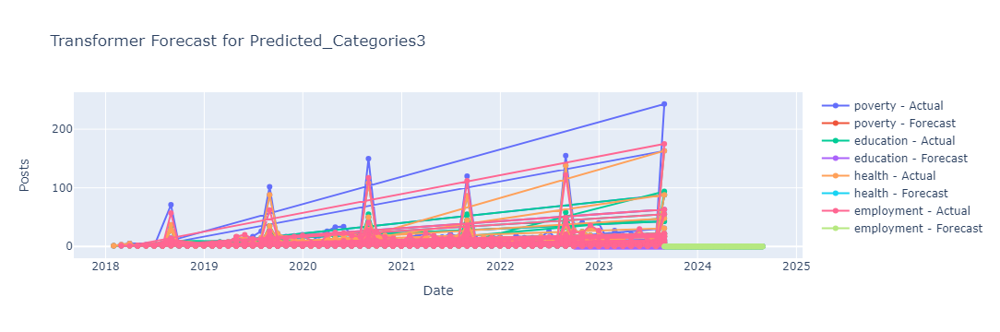

Theme: poverty
MAE: 7.7722908089357
MSE: 392.8065843553229
RMSE: 19.81934873691169
MAPE: 100.00%
R-squared (R2): -0.18173551559448242

Theme: education
MAE: 5.618705035782571
MSE: 125.74100719161466
RMSE: 11.213429769326362
MAPE: 100.00%
R-squared (R2): -0.335239052772522

Theme: health
MAE: 5.517567567478895
MSE: 172.76891891796967
RMSE: 13.144159117949298
MAPE: 100.00%
R-squared (R2): -0.21390104293823242

Theme: employment
MAE: 5.441358024579871
MSE: 186.21913580125516
RMSE: 13.646213240355552
MAPE: 100.00%
R-squared (R2): -0.1890571117401123



In [91]:
import pandas as pd
import numpy as np
from gluonts.dataset.common import ListDataset
from gluonts.mx.model.transformer import TransformerEstimator
from gluonts.mx.trainer import Trainer
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import plotly.graph_objects as go
import plotly.offline as pyo

# Assuming 'aggr_df' is loaded with 'Date', 'Predicted_Categories3', and 'Posts'
aggr_df = monthly_OS.copy()

# Convert 'Date' to datetime and set it as the index if not already done
aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])
aggr_df.set_index('Date', inplace=True)

# Define hyperparameters for the Transformer model
prediction_length = 365  # Number of time steps to forecast
context_length = 365    # Number of time steps to use for context
freq = 'D'  # Daily data

# List of themes to include for filtering
themes_to_include = ['hunger', 'poverty', 'education', 'health', 'employment', 'security']

# Initialize lists to store performance metrics
mae_list = []
mse_list = []
rmse_list = []
mape_list = []
r2_list = []

# Initialize a list to store themes for which metrics were calculated
valid_themes = []

# Create a figure for all themes using Plotly
fig = go.Figure()

for theme in themes_to_include:
    # Filter the DataFrame using contains for multi-label column 'Predicted_Categories3'
    df_subset = aggr_df[aggr_df['Predicted_Categories3'].str.contains(theme, na=False)]

    # Reset the index and select the relevant columns
    df_subset = df_subset.reset_index()[['Date', 'Posts']]
    df_subset.columns = ['ds', 'y']

    # Check if the subset has enough data points
    if len(df_subset) < context_length:
        print(f"Not enough data for theme '{theme}'. Skipping...")
        continue

    # Remove the timezone information from the 'ds' column
    df_subset['ds'] = df_subset['ds'].dt.tz_localize(None)

    # Adding the theme to valid_themes after ensuring enough data
    valid_themes.append(theme)

    # Create a GluonTS dataset with a specified frequency
    train_data = ListDataset(
        [{"start": df_subset['ds'].values[0], "target": df_subset['y'].values}],
        freq=freq
    )

    # Define and train the Transformer estimator
    estimator = TransformerEstimator(
        prediction_length=prediction_length,
        context_length=context_length,
        freq=freq,  # Specify the frequency here
        trainer=Trainer(epochs=10)
    )
    predictor = estimator.train(train_data)

    # Create test data for prediction
    test_data = ListDataset(
        [{"start": df_subset['ds'].values[-context_length], "target": [np.nan] * prediction_length}],
        freq=freq
    )

    # Generate forecasts for the current theme
    forecasts = list(predictor.predict(test_data, num_samples=100))
    forecast_samples = np.array([forecast.samples for forecast in forecasts])

    # Take the mean of the forecasted samples (over the 100 samples)
    forecast_mean = np.mean(forecast_samples, axis=0).flatten()

    # Extract actual values for the last available true data
    target_values = df_subset['y'].values[-len(forecast_mean):]

    # Ensure forecast_mean and target_values have the same length
    forecast_mean = forecast_mean[:len(target_values)]

    # Calculate performance metrics
    mae = mean_absolute_error(target_values, forecast_mean)
    mse = mean_squared_error(target_values, forecast_mean)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((target_values - forecast_mean) / target_values)) * 100
    r2 = r2_score(target_values, forecast_mean)

    # Append metrics to the respective lists
    mae_list.append(mae)
    mse_list.append(mse)
    rmse_list.append(rmse)
    mape_list.append(mape)
    r2_list.append(r2)

    # Plot the actual and forecasted values using Plotly
    fig.add_trace(go.Scatter(x=df_subset['ds'], y=target_values, mode='lines+markers', name=f'{theme} - Actual'))
    fig.add_trace(go.Scatter(x=pd.date_range(start=df_subset['ds'].iloc[-1], periods=prediction_length, freq=freq), 
                             y=forecast_mean, mode='lines+markers', name=f'{theme} - Forecast'))

# Update layout for the graph using Plotly
fig.update_layout(
    title='Transformer Forecast for Predicted_Categories3',
    xaxis_title='Date',
    yaxis_title='Posts',
    showlegend=True
)

# Show the graph using Plotly
pyo.iplot(fig)

# Print the performance metrics for each valid theme
for i, theme in enumerate(valid_themes):
    print(f'Theme: {theme}')
    print(f'MAE: {mae_list[i]}')
    print(f'MSE: {mse_list[i]}')
    print(f'RMSE: {rmse_list[i]}')
    print(f'MAPE: {mape_list[i]:.2f}%')
    print(f'R-squared (R2): {r2_list[i]}')
    print()


Not enough data for theme 'hunger'. Skipping...


100%|██████████| 50/50 [00:31<00:00,  1.58it/s, epoch=10/10, avg_epoch_loss=2.03]
/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

100%|██████████| 50/50 [00:32<00:00,  1.55it/s, epoch=10/10, avg_epoch_loss=1.97]
/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

100%|██████████| 50/50 [00:31<00:00,  1.58it/s, epoch=10/10, avg_epoch_loss=1.58]
/home/hsibitenda/anaconda3/envs/harriet_env/lib/

Not enough data for theme 'security'. Skipping...


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



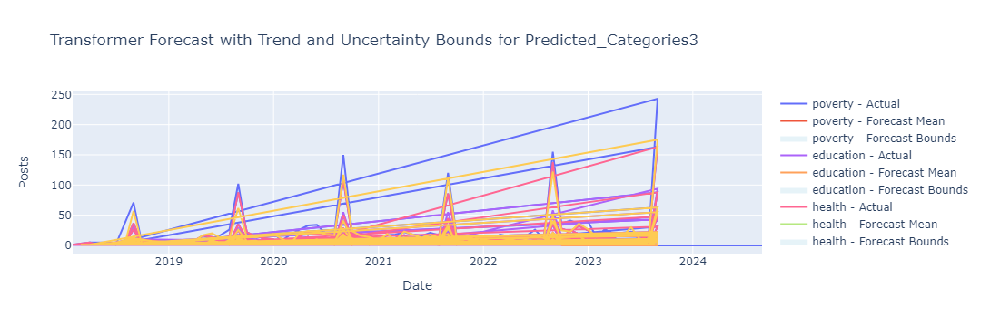

Theme: poverty
MAE: 7.772290808794204
MSE: 392.8065843555991
RMSE: 19.819348736918656
MAPE: 100.00%
R-squared (R2): -0.18173551559448242

Theme: education
MAE: 5.6187050358543615
MSE: 125.74100719294391
RMSE: 11.213429769385632
MAPE: 100.00%
R-squared (R2): -0.335239052772522

Theme: health
MAE: 5.517567567482158
MSE: 172.76891891799943
RMSE: 13.14415911795043
MAPE: 100.00%
R-squared (R2): -0.21390104293823242

Theme: employment
MAE: 5.441358024536125
MSE: 186.21913580021305
RMSE: 13.646213240317369
MAPE: 100.00%
R-squared (R2): -0.1890571117401123



In [92]:
import pandas as pd
import numpy as np
from gluonts.dataset.common import ListDataset
from gluonts.mx.model.transformer import TransformerEstimator
from gluonts.mx.trainer import Trainer
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import plotly.graph_objects as go
import plotly.offline as pyo

# Assuming 'aggr_df' is loaded with 'Date', 'Predicted_Categories3', and 'Posts'
aggr_df = monthly_OS.copy()

# Convert 'Date' to datetime and set it as the index if not already done
aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])
aggr_df.set_index('Date', inplace=True)

# Define hyperparameters for the Transformer model
prediction_length = 365  # Number of time steps to forecast
context_length = 365    # Number of time steps to use for context
freq = 'D'  # Daily data

# List of themes to include for filtering
themes_to_include = ['hunger', 'poverty', 'education', 'health', 'employment', 'security']

# Initialize lists to store performance metrics
mae_list = []
mse_list = []
rmse_list = []
mape_list = []
r2_list = []

# Initialize a list to store themes for which metrics were calculated
valid_themes = []

# Create a figure for all themes using Plotly
fig = go.Figure()

for theme in themes_to_include:
    # Filter the DataFrame using contains for multi-label column 'Predicted_Categories3'
    df_subset = aggr_df[aggr_df['Predicted_Categories3'].str.contains(theme, na=False)]

    # Reset the index and select the relevant columns
    df_subset = df_subset.reset_index()[['Date', 'Posts']]
    df_subset.columns = ['ds', 'y']

    # Check if the subset has enough data points
    if len(df_subset) < context_length:
        print(f"Not enough data for theme '{theme}'. Skipping...")
        continue

    # Remove the timezone information from the 'ds' column
    df_subset['ds'] = df_subset['ds'].dt.tz_localize(None)

    # Adding the theme to valid_themes after ensuring enough data
    valid_themes.append(theme)

    # Create a GluonTS dataset with a specified frequency
    train_data = ListDataset(
        [{"start": df_subset['ds'].values[0], "target": df_subset['y'].values}],
        freq=freq
    )

    # Define and train the Transformer estimator
    estimator = TransformerEstimator(
        prediction_length=prediction_length,
        context_length=context_length,
        freq=freq,  # Specify the frequency here
        trainer=Trainer(epochs=10)
    )
    predictor = estimator.train(train_data)

    # Create test data for prediction
    test_data = ListDataset(
        [{"start": df_subset['ds'].values[-context_length], "target": [np.nan] * prediction_length}],
        freq=freq
    )

    # Generate forecasts for the current theme
    forecasts = list(predictor.predict(test_data, num_samples=100))
    forecast_samples = np.array([forecast.samples for forecast in forecasts])

    # Take the mean of the forecasted samples (over the 100 samples)
    forecast_mean = np.mean(forecast_samples, axis=0).flatten()
    
    # Calculate the upper and lower bounds (5th and 95th percentiles)
    forecast_lower = np.percentile(forecast_samples, 5, axis=0).flatten()
    forecast_upper = np.percentile(forecast_samples, 95, axis=0).flatten()

    # Extract actual values for the last available true data
    target_values = df_subset['y'].values[-len(forecast_mean):]

    # Ensure forecast_mean and target_values have the same length
    forecast_mean = forecast_mean[:len(target_values)]
    forecast_lower = forecast_lower[:len(target_values)]
    forecast_upper = forecast_upper[:len(target_values)]

    # Calculate performance metrics
    mae = mean_absolute_error(target_values, forecast_mean)
    mse = mean_squared_error(target_values, forecast_mean)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((target_values - forecast_mean) / target_values)) * 100
    r2 = r2_score(target_values, forecast_mean)

    # Append metrics to the respective lists
    mae_list.append(mae)
    mse_list.append(mse)
    rmse_list.append(rmse)
    mape_list.append(mape)
    r2_list.append(r2)

    # Plot the actual and forecasted values using Plotly
    fig.add_trace(go.Scatter(x=df_subset['ds'], y=target_values, mode='lines', name=f'{theme} - Actual'))
    
    # Plot the forecast mean line
    future_dates = pd.date_range(start=df_subset['ds'].iloc[-1], periods=prediction_length, freq=freq)
    fig.add_trace(go.Scatter(x=future_dates, y=forecast_mean, mode='lines', name=f'{theme} - Forecast Mean'))

    # Add the upper and lower bound as a filled area
    fig.add_trace(go.Scatter(x=np.concatenate([future_dates, future_dates[::-1]]),
                             y=np.concatenate([forecast_upper, forecast_lower[::-1]]),
                             fill='toself', fillcolor='rgba(173, 216, 230, 0.3)',
                             line=dict(color='rgba(255,255,255,0)'),
                             hoverinfo="skip",
                             name=f'{theme} - Forecast Bounds'))

# Update layout for the graph using Plotly
fig.update_layout(
    title='Transformer Forecast with Trend and Uncertainty Bounds for Predicted_Categories3',
    xaxis_title='Date',
    yaxis_title='Posts',
    showlegend=True
)

# Show the graph using Plotly
pyo.iplot(fig)

# Print the performance metrics for each valid theme
for i, theme in enumerate(valid_themes):
    print(f'Theme: {theme}')
    print(f'MAE: {mae_list[i]}')
    print(f'MSE: {mse_list[i]}')
    print(f'RMSE: {rmse_list[i]}')
    print(f'MAPE: {mape_list[i]:.2f}%')
    print(f'R-squared (R2): {r2_list[i]}')
    print()


Not enough data for theme 'hunger'. Skipping...


100%|██████████| 50/50 [00:31<00:00,  1.59it/s, epoch=10/10, avg_epoch_loss=2.33]
/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

100%|██████████| 50/50 [00:32<00:00,  1.54it/s, epoch=10/10, avg_epoch_loss=1.76]
/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

100%|██████████| 50/50 [00:31<00:00,  1.58it/s, epoch=10/10, avg_epoch_loss=1.94]
/home/hsibitenda/anaconda3/envs/harriet_env/lib/

Not enough data for theme 'security'. Skipping...


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



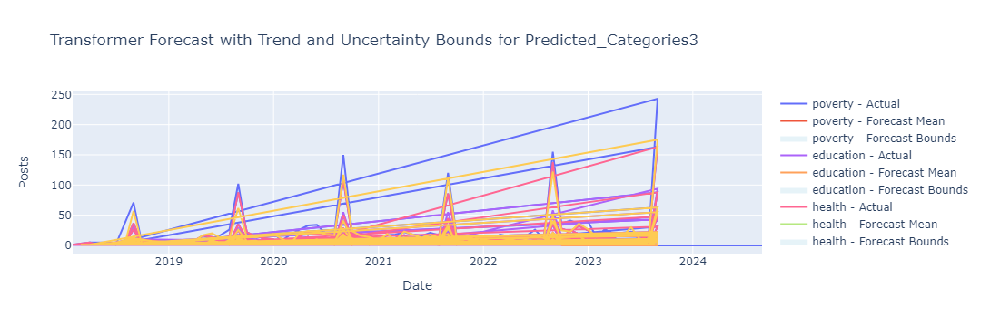

In [93]:
import pandas as pd
import numpy as np
from gluonts.dataset.common import ListDataset
from gluonts.mx.model.transformer import TransformerEstimator
from gluonts.mx.trainer import Trainer
import plotly.graph_objects as go
import plotly.offline as pyo

# Assuming 'aggr_df' is loaded with 'Date', 'Predicted_Categories3', and 'Posts'
aggr_df = monthly_OS.copy()

# Convert 'Date' to datetime and set it as the index if not already done
aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])
aggr_df.set_index('Date', inplace=True)

# Define hyperparameters for the Transformer model
prediction_length = 365  # Number of time steps to forecast
context_length = 365     # Number of time steps to use for context
freq = 'D'               # Daily data

# List of themes to include for filtering
themes_to_include = ['hunger', 'poverty', 'education', 'health', 'employment', 'security']

# Initialize a list to store themes for which forecasts were generated
valid_themes = []

# Create a figure for all themes using Plotly
fig = go.Figure()

for theme in themes_to_include:
    # Filter the DataFrame using contains for multi-label column 'Predicted_Categories3'
    df_subset = aggr_df[aggr_df['Predicted_Categories3'].str.contains(theme, na=False)]

    # Reset the index and select the relevant columns
    df_subset = df_subset.reset_index()[['Date', 'Posts']]
    df_subset.columns = ['ds', 'y']

    # Check if the subset has enough data points
    if len(df_subset) < context_length:
        print(f"Not enough data for theme '{theme}'. Skipping...")
        continue

    # Remove the timezone information from the 'ds' column
    df_subset['ds'] = df_subset['ds'].dt.tz_localize(None)

    # Adding the theme to valid_themes after ensuring enough data
    valid_themes.append(theme)

    # Create a GluonTS dataset with a specified frequency
    train_data = ListDataset(
        [{"start": df_subset['ds'].values[0], "target": df_subset['y'].values}],
        freq=freq
    )

    # Define and train the Transformer estimator
    estimator = TransformerEstimator(
        prediction_length=prediction_length,
        context_length=context_length,
        freq=freq,  # Specify the frequency here
        trainer=Trainer(epochs=10)
    )
    predictor = estimator.train(train_data)

    # Create test data for prediction
    test_data = ListDataset(
        [{"start": df_subset['ds'].values[-context_length], "target": [np.nan] * prediction_length}],
        freq=freq
    )

    # Generate forecasts for the current theme
    forecasts = list(predictor.predict(test_data, num_samples=100))
    forecast_samples = np.array([forecast.samples for forecast in forecasts])

    # Take the mean of the forecasted samples (over the 100 samples)
    forecast_mean = np.mean(forecast_samples, axis=0).flatten()
    
    # Calculate the upper and lower bounds (5th and 95th percentiles)
    forecast_lower = np.percentile(forecast_samples, 5, axis=0).flatten()
    forecast_upper = np.percentile(forecast_samples, 95, axis=0).flatten()

    # Extract actual values for the last available true data
    target_values = df_subset['y'].values[-len(forecast_mean):]

    # Ensure forecast_mean and target_values have the same length
    forecast_mean = forecast_mean[:len(target_values)]
    forecast_lower = forecast_lower[:len(target_values)]
    forecast_upper = forecast_upper[:len(target_values)]

    # Plot the actual and forecasted values using Plotly
    fig.add_trace(go.Scatter(x=df_subset['ds'], y=target_values, mode='lines', name=f'{theme} - Actual'))
    
    # Plot the forecast mean line
    future_dates = pd.date_range(start=df_subset['ds'].iloc[-1], periods=prediction_length, freq=freq)
    fig.add_trace(go.Scatter(x=future_dates, y=forecast_mean, mode='lines', name=f'{theme} - Forecast Mean'))

    # Add the upper and lower bound as a filled area
    fig.add_trace(go.Scatter(x=np.concatenate([future_dates, future_dates[::-1]]),
                             y=np.concatenate([forecast_upper, forecast_lower[::-1]]),
                             fill='toself', fillcolor='rgba(173, 216, 230, 0.3)',
                             line=dict(color='rgba(255,255,255,0)'),
                             hoverinfo="skip",
                             name=f'{theme} - Forecast Bounds'))

# Update layout for the graph using Plotly
fig.update_layout(
    title='Transformer Forecast with Trend and Uncertainty Bounds for Predicted_Categories3',
    xaxis_title='Date',
    yaxis_title='Posts',
    showlegend=True
)

# Show the graph using Plotly
pyo.iplot(fig)


Not enough data for theme 'hunger'. Skipping...


100%|██████████| 50/50 [00:31<00:00,  1.57it/s, epoch=10/10, avg_epoch_loss=2.16]
/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

100%|██████████| 50/50 [00:31<00:00,  1.58it/s, epoch=10/10, avg_epoch_loss=1.78]
/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

100%|██████████| 50/50 [00:31<00:00,  1.58it/s, epoch=10/10, avg_epoch_loss=1.69]
/home/hsibitenda/anaconda3/envs/harriet_env/lib/

Not enough data for theme 'security'. Skipping...


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



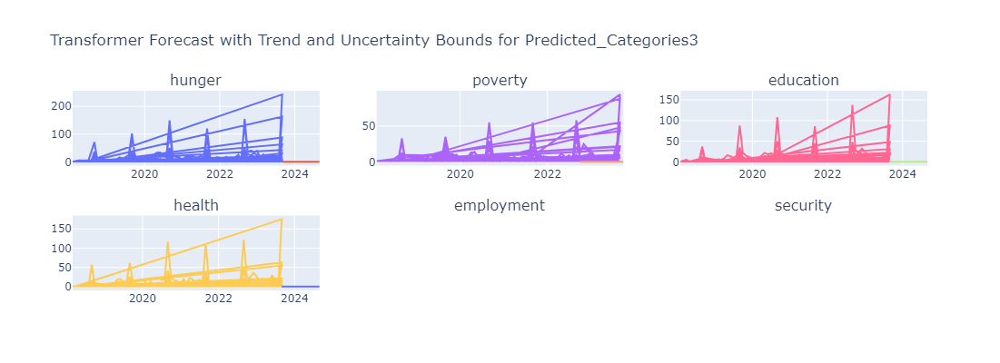

In [107]:
import pandas as pd
import numpy as np
from gluonts.dataset.common import ListDataset
from gluonts.mx.model.transformer import TransformerEstimator
from gluonts.mx.trainer import Trainer
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.offline as pyo

# Assuming 'aggr_df' is loaded with 'Date', 'Predicted_Categories3', and 'Posts'
aggr_df = monthly_OS.copy()

# Convert 'Date' to datetime and set it as the index if not already done
aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])
aggr_df.set_index('Date', inplace=True)

# Define hyperparameters for the Transformer model
prediction_length = 365  # Number of time steps to forecast
context_length = 365     # Number of time steps to use for context
freq = 'D'               # Daily data

# List of themes to include for filtering
themes_to_include = ['hunger', 'poverty', 'education', 'health', 'employment', 'security']

# Initialize a list to store themes for which forecasts were generated
valid_themes = []

# Create subplots: 2 rows and 3 columns (for 6 themes)
fig = make_subplots(rows=2, cols=3, subplot_titles=themes_to_include)

row = 1
col = 1

for theme in themes_to_include:
    # Filter the DataFrame using contains for multi-label column 'Predicted_Categories3'
    df_subset = aggr_df[aggr_df['Predicted_Categories3'].str.contains(theme, na=False)]

    # Reset the index and select the relevant columns
    df_subset = df_subset.reset_index()[['Date', 'Posts']]
    df_subset.columns = ['ds', 'y']

    # Check if the subset has enough data points
    if len(df_subset) < context_length:
        print(f"Not enough data for theme '{theme}'. Skipping...")
        continue

    # Remove the timezone information from the 'ds' column
    df_subset['ds'] = df_subset['ds'].dt.tz_localize(None)

    # Adding the theme to valid_themes after ensuring enough data
    valid_themes.append(theme)

    # Create a GluonTS dataset with a specified frequency
    train_data = ListDataset(
        [{"start": df_subset['ds'].values[0], "target": df_subset['y'].values}],
        freq=freq
    )

    # Define and train the Transformer estimator
    estimator = TransformerEstimator(
        prediction_length=prediction_length,
        context_length=context_length,
        freq=freq,  # Specify the frequency here
        trainer=Trainer(epochs=10)
    )
    predictor = estimator.train(train_data)

    # Create test data for prediction
    test_data = ListDataset(
        [{"start": df_subset['ds'].values[-context_length], "target": [np.nan] * prediction_length}],
        freq=freq
    )

    # Generate forecasts for the current theme
    forecasts = list(predictor.predict(test_data, num_samples=100))
    forecast_samples = np.array([forecast.samples for forecast in forecasts])

    # Take the mean of the forecasted samples (over the 100 samples)
    forecast_mean = np.mean(forecast_samples, axis=0).flatten()
    
    # Calculate the upper and lower bounds (5th and 95th percentiles)
    forecast_lower = np.percentile(forecast_samples, 5, axis=0).flatten()
    forecast_upper = np.percentile(forecast_samples, 95, axis=0).flatten()

    # Extract actual values for the last available true data
    target_values = df_subset['y'].values[-len(forecast_mean):]

    # Ensure forecast_mean and target_values have the same length
    forecast_mean = forecast_mean[:len(target_values)]
    forecast_lower = forecast_lower[:len(target_values)]
    forecast_upper = forecast_upper[:len(target_values)]

    # Create future dates for plotting forecast
    future_dates = pd.date_range(start=df_subset['ds'].iloc[-1], periods=prediction_length, freq=freq)

    # Plot actual values
    fig.add_trace(go.Scatter(x=df_subset['ds'], y=target_values, mode='lines', name=f'{theme} - Actual'),
                  row=row, col=col)
    
    # Plot forecast mean line
    fig.add_trace(go.Scatter(x=future_dates, y=forecast_mean, mode='lines', name=f'{theme} - Forecast Mean'),
                  row=row, col=col)

    # Add the upper and lower bounds as a filled area
    fig.add_trace(go.Scatter(x=np.concatenate([future_dates, future_dates[::-1]]),
                             y=np.concatenate([forecast_upper, forecast_lower[::-1]]),
                             fill='toself', fillcolor='rgba(173, 216, 230, 0.3)',
                             line=dict(color='rgba(255,255,255,0)'),
                             hoverinfo="skip",
                             name=f'{theme} - Forecast Bounds'),
                  row=row, col=col)

    # Move to next subplot
    col += 1
    if col > 3:
        col = 1
        row += 1

# Update layout for the graph using Plotly
fig.update_layout(
    title='Transformer Forecast with Trend and Uncertainty Bounds for Predicted_Categories3',
    height=400, width=800,
    showlegend=False
)

# Show the graph using Plotly
pyo.iplot(fig)


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp_nvt37p3/rz8e9vr7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp_nvt37p3/8p4kv5cs.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=93691', 'data', 'file=/tmp/tmp_nvt37p3/rz8e9vr7.json', 'init=/tmp/tmp_nvt37p3/8p4kv5cs.json', 'output', 'file=/tmp/tmp_nvt37p3/prophet_modelqb0a1vbm/prophet_model-20240911151835.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
15:18:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:18:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


Not enough data for theme 'hunger'. Skipping...


/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp_nvt37p3/7ka6fkge.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp_nvt37p3/xsly02b2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/home/hsibitenda/anaconda3/envs/harriet_env/lib/python3.11/site-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84052', 'data', 'file=/tmp/tmp_nvt37p3/7ka6fkge.json', 'init=/tmp/tmp_nvt37p3/xsly02b2.json', 'output', 'file=/tmp/tmp_nvt37p3/prophet_model93felf5h/prophet_model-20240911151835.csv', 'met

Not enough data for theme 'security'. Skipping...


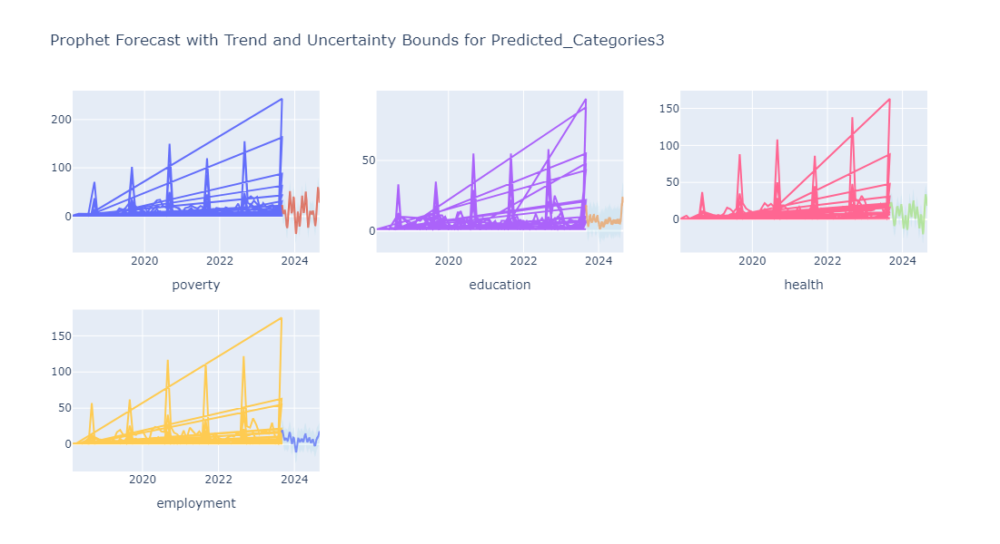

In [106]:
import pandas as pd
import numpy as np
from prophet import Prophet
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.offline as pyo

# Assuming 'aggr_df' is loaded with 'Date', 'Predicted_Categories3', and 'Posts'
aggr_df = monthly_OS.copy()

# Convert 'Date' to datetime and set it as the index if not already done
aggr_df['Date'] = pd.to_datetime(aggr_df['Date'])
aggr_df.set_index('Date', inplace=True)

# List of themes to include for filtering
themes_to_include = ['hunger', 'poverty', 'education', 'health', 'employment', 'security']

# Initialize a list to store themes for which forecasts were generated
valid_themes = []

# Create subplots: dynamically calculate the number of rows based on valid themes
fig = make_subplots(rows=2, cols=3)

row = 1
col = 1

for theme in themes_to_include:
    # Filter the DataFrame using contains for multi-label column 'Predicted_Categories3'
    df_subset = aggr_df[aggr_df['Predicted_Categories3'].str.contains(theme, na=False)]

    # Reset the index and select the relevant columns
    df_subset = df_subset.reset_index()[['Date', 'Posts']]
    df_subset.columns = ['ds', 'y']

    # Check if the subset has enough data points
    if len(df_subset) < 365:
        print(f"Not enough data for theme '{theme}'. Skipping...")
        continue

    # Adding the theme to valid_themes after ensuring enough data
    valid_themes.append(theme)

    # Initialize the Prophet model
    model = Prophet(weekly_seasonality=True)

    # Fit the model
    model.fit(df_subset)

    # Create future dates for prediction (365 days)
    future_dates = model.make_future_dataframe(periods=365)

    # Predict future values
    forecast = model.predict(future_dates)

    # Extract actual values for the last available true data
    target_values = df_subset['y'].values

    # Ensure forecast, actual values, and forecast components have the same length
    forecast_mean = forecast['yhat'].values[-365:]
    forecast_lower = forecast['yhat_lower'].values[-365:]
    forecast_upper = forecast['yhat_upper'].values[-365:]

    # Plot actual values
    fig.add_trace(go.Scatter(x=df_subset['ds'], y=target_values, mode='lines', name=f'{theme} - Actual'),
                  row=row, col=col)
    
    # Plot forecast mean line
    fig.add_trace(go.Scatter(x=forecast['ds'][-365:], y=forecast_mean, mode='lines', name=f'{theme} - Forecast Mean'),
                  row=row, col=col)

    # Add the upper and lower bounds as a filled area
    fig.add_trace(go.Scatter(x=np.concatenate([forecast['ds'][-365:], forecast['ds'][-365:][::-1]]),
                             y=np.concatenate([forecast_upper, forecast_lower[::-1]]),
                             fill='toself', fillcolor='rgba(173, 216, 230, 0.3)',
                             line=dict(color='rgba(255,255,255,0)'),
                             hoverinfo="skip",
                             name=f'{theme} - Forecast Bounds'),
                  row=row, col=col)

    # Add the correct subplot title
    fig.update_xaxes(title_text=theme, row=row, col=col)

    # Move to next subplot
    col += 1
    if col > 3:
        col = 1
        row += 1

# Update layout for the graph using Plotly
fig.update_layout(
    title='Prophet Forecast with Trend and Uncertainty Bounds for Predicted_Categories3',
    height=600, width=1000,
    showlegend=False
)

# Show the graph using Plotly
pyo.iplot(fig)
